In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns


import time
import math
import random
import re
import os
import sys


from utils.util import find_files_with_extension
from utils.util import  get_dataframe_from_filepath,calculate_statistics, extract_unique_mbps_and_ms
from utils.util import remove_outliers_iqr, comma_format, create_directory_if_not_exists,print_rtt_stats,save_rtt_stats,return_rtt_stats

In [3]:
# Load data
mainpth="./Data"

graph_directory = os.path.join(mainpth, "Graphs")
create_directory_if_not_exists(graph_directory)

stats_directory = os.path.join(mainpth, "Stats")
create_directory_if_not_exists(stats_directory)


folderpaths = [mainpth+'./client1_data',mainpth+'./client2_data']
filenames, filepaths, filedict = find_files_with_extension(folderpaths, '.log')


Directory already exists: ./Data\Graphs
Directory already exists: ./Data\Stats


In [4]:
filedict

{'1_fq_codel_10Mbps_0ms_ecn_newreno_src1.siftr.log': './Data./client1_data\\1_fq_codel_10Mbps_0ms_ecn_newreno_src1.siftr.log',
 '1_fq_codel_10Mbps_10ms_ecn_newreno_src1.siftr.log': './Data./client1_data\\1_fq_codel_10Mbps_10ms_ecn_newreno_src1.siftr.log',
 '1_fq_codel_10Mbps_1ms_ecn_newreno_src1.siftr.log': './Data./client1_data\\1_fq_codel_10Mbps_1ms_ecn_newreno_src1.siftr.log',
 '1_fq_codel_10Mbps_20ms_ecn_newreno_src1.siftr.log': './Data./client1_data\\1_fq_codel_10Mbps_20ms_ecn_newreno_src1.siftr.log',
 '1_fq_codel_10Mbps_5ms_ecn_newreno_src1.siftr.log': './Data./client1_data\\1_fq_codel_10Mbps_5ms_ecn_newreno_src1.siftr.log',
 '1_fq_codel_10Mbps_7ms_ecn_newreno_src1.siftr.log': './Data./client1_data\\1_fq_codel_10Mbps_7ms_ecn_newreno_src1.siftr.log',
 '1_fq_codel_20Mbps_0ms_ecn_newreno_src1.siftr.log': './Data./client1_data\\1_fq_codel_20Mbps_0ms_ecn_newreno_src1.siftr.log',
 '1_fq_codel_20Mbps_10ms_ecn_newreno_src1.siftr.log': './Data./client1_data\\1_fq_codel_20Mbps_10ms_ecn_new

In [5]:
folderpaths

['./Data./client1_data', './Data./client2_data']

In [4]:
# Call the function and print unique combinations
unique_combinations = extract_unique_mbps_and_ms(folderpaths)
print("Unique Mbps and ms Combinations:")
for mbps, ms in sorted(unique_combinations):
    print(f'{mbps} Mbps, {ms} ms')


Unique Mbps and ms Combinations:
10 Mbps, 0 ms
10 Mbps, 1 ms
10 Mbps, 10 ms
10 Mbps, 20 ms
10 Mbps, 5 ms
10 Mbps, 7 ms
20 Mbps, 0 ms
20 Mbps, 1 ms
20 Mbps, 10 ms
20 Mbps, 20 ms
20 Mbps, 5 ms
20 Mbps, 7 ms
5 Mbps, 0 ms
5 Mbps, 1 ms
5 Mbps, 10 ms
5 Mbps, 20 ms
5 Mbps, 5 ms
5 Mbps, 7 ms
8 Mbps, 0 ms
8 Mbps, 1 ms
8 Mbps, 10 ms
8 Mbps, 20 ms
8 Mbps, 5 ms
8 Mbps, 7 ms


In [5]:
mbps , ms = list(unique_combinations)[0]
net_settings = f'{mbps}_Mbps_{ms}_ms'
print(net_settings)

8_Mbps_1_ms


In [6]:
df=get_dataframe_from_filepath(filepaths[0])
df['ForeignPort'].unique()

./Data./client1_data\1_fq_codel_10Mbps_0ms_ecn_newreno_src1.siftr.log


array(['54216', '54222', '54218', '5102', '54224', '5101', '54270'],
      dtype=object)

In [7]:
unique_scenarios_dict={}
for index in range(len(filenames)):
    scenario = "_".join(filenames[index].split('_')[:5])
    if "l4s" in scenario:
        scenario = "_".join(filenames[index].split('_')[:4])
    if scenario in unique_scenarios_dict:
        unique_scenarios_dict[scenario].append(filedict[filenames[index]])
    else:
        unique_scenarios_dict[scenario]=[filedict[filenames[index]]]


In [8]:
unique_scenarios_dict

{'1_fq_codel_10Mbps_0ms': ['./Data./client1_data\\1_fq_codel_10Mbps_0ms_ecn_newreno_src1.siftr.log',
  './Data./client2_data\\1_fq_codel_10Mbps_0ms_ecn_dctcp_src2.siftr.log'],
 '1_fq_codel_10Mbps_10ms': ['./Data./client1_data\\1_fq_codel_10Mbps_10ms_ecn_newreno_src1.siftr.log',
  './Data./client2_data\\1_fq_codel_10Mbps_10ms_ecn_dctcp_src2.siftr.log'],
 '1_fq_codel_10Mbps_1ms': ['./Data./client1_data\\1_fq_codel_10Mbps_1ms_ecn_newreno_src1.siftr.log',
  './Data./client2_data\\1_fq_codel_10Mbps_1ms_ecn_dctcp_src2.siftr.log'],
 '1_fq_codel_10Mbps_20ms': ['./Data./client1_data\\1_fq_codel_10Mbps_20ms_ecn_newreno_src1.siftr.log',
  './Data./client2_data\\1_fq_codel_10Mbps_20ms_ecn_dctcp_src2.siftr.log'],
 '1_fq_codel_10Mbps_5ms': ['./Data./client1_data\\1_fq_codel_10Mbps_5ms_ecn_newreno_src1.siftr.log',
  './Data./client2_data\\1_fq_codel_10Mbps_5ms_ecn_dctcp_src2.siftr.log'],
 '1_fq_codel_10Mbps_7ms': ['./Data./client1_data\\1_fq_codel_10Mbps_7ms_ecn_newreno_src1.siftr.log',
  './Data./cl

In [9]:
from utils.plotter import  plot_siftr_graph


Start New Scenario
1_fq_codel_10Mbps_0ms
./Data./client1_data\1_fq_codel_10Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_10Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_10Mbps_0ms:
Statistics for CUBIC:
Median: 35.625
Mean: 38.39266485824292
25th Percentile: 24.062
75th Percentile: 47.187
Minimum: 10.0
Maximum: 303.437
Statistics for NEWRENO:
Median: 38.125
Mean: 42.32473959571938
25th Percentile: 30.937
75th Percentile: 48.125
Minimum: 12.187
Maximum: 303.437
Statistics for DCTCP:
Median: 33.125
Mean: 37.205063138189246
25th Percentile: 26.875
75th Percentile: 42.5
Minimum: 11.875
Maximum: 385.0
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_10Mbps_0ms_rtt_stats.txt



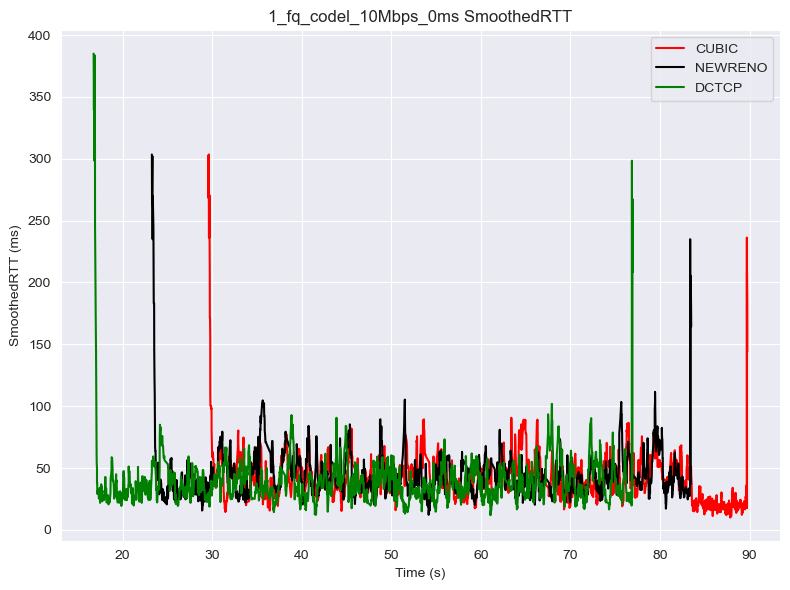

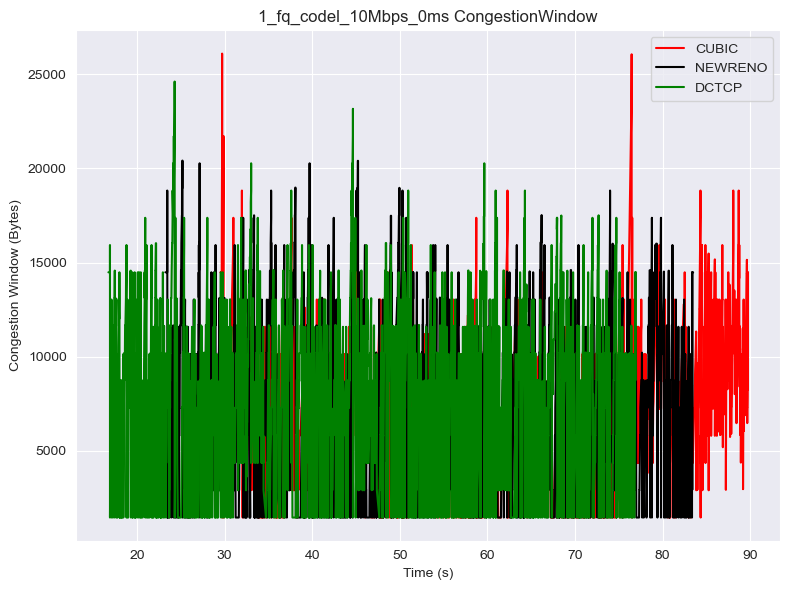


Start New Scenario
1_fq_codel_10Mbps_10ms
./Data./client1_data\1_fq_codel_10Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_10Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_10Mbps_10ms:
Statistics for CUBIC:
Median: 186.25
Mean: 189.37210743575721
25th Percentile: 160.937
75th Percentile: 213.75
Minimum: 35.0
Maximum: 321.875
Statistics for NEWRENO:
Median: 184.375
Mean: 190.29454462381966
25th Percentile: 160.0
75th Percentile: 215.312
Minimum: 35.0
Maximum: 338.437
Statistics for DCTCP:
Median: 358.5935
Mean: 369.82308793230317
25th Percentile: 251.875
75th Percentile: 476.01525000000004
Minimum: 64.687
Maximum: 706.25
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_10Mbps_10ms_rtt_stats.txt



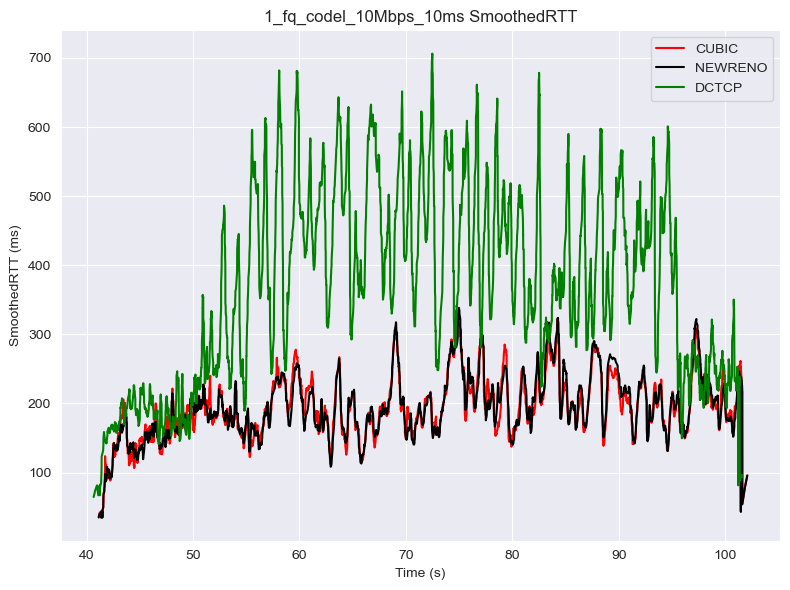

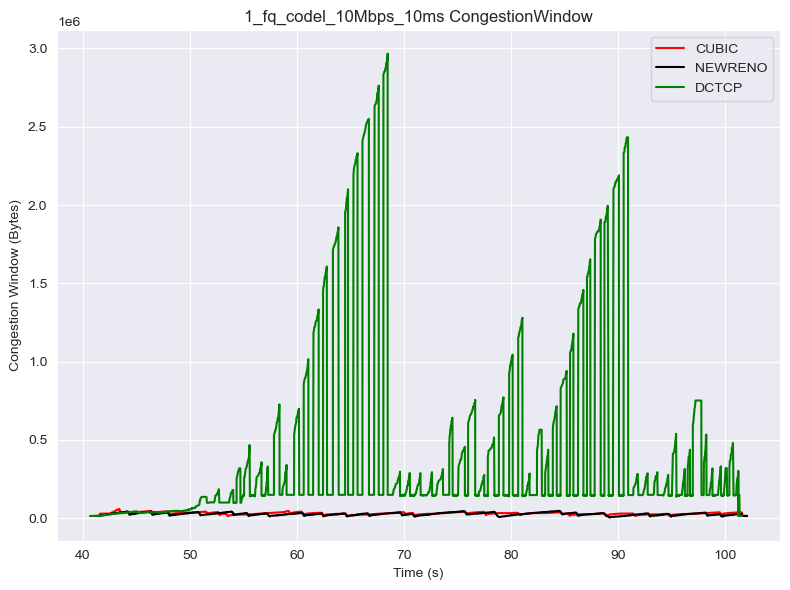


Start New Scenario
1_fq_codel_10Mbps_1ms
./Data./client1_data\1_fq_codel_10Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_10Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_10Mbps_1ms:
Statistics for CUBIC:
Median: 37.5
Mean: 41.29572737430168
25th Percentile: 29.062
75th Percentile: 49.375
Minimum: 11.25
Maximum: 159.687
Statistics for NEWRENO:
Median: 39.375
Mean: 42.81471197343848
25th Percentile: 31.25
75th Percentile: 50.625
Minimum: 15.625
Maximum: 146.875
Statistics for DCTCP:
Median: 32.187
Mean: 35.64587187964953
25th Percentile: 24.687
75th Percentile: 42.812
Minimum: 11.562
Maximum: 195.0
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_10Mbps_1ms_rtt_stats.txt



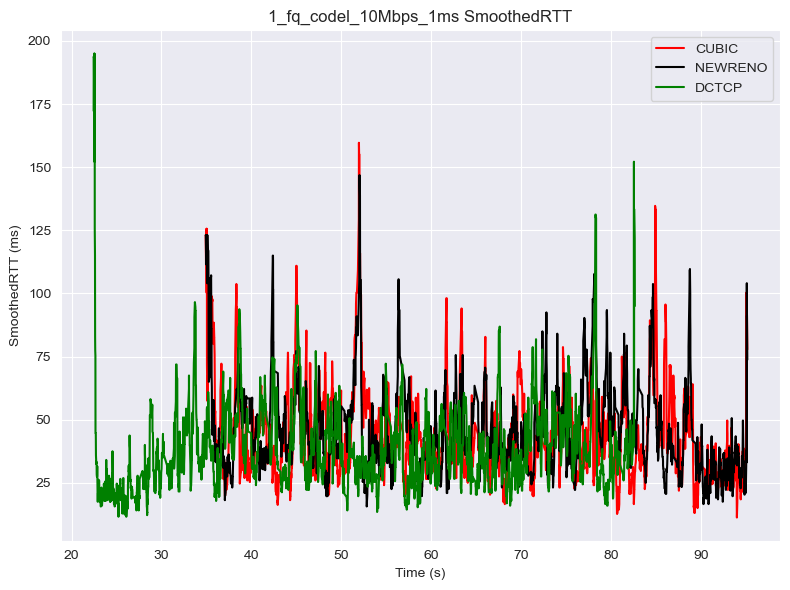

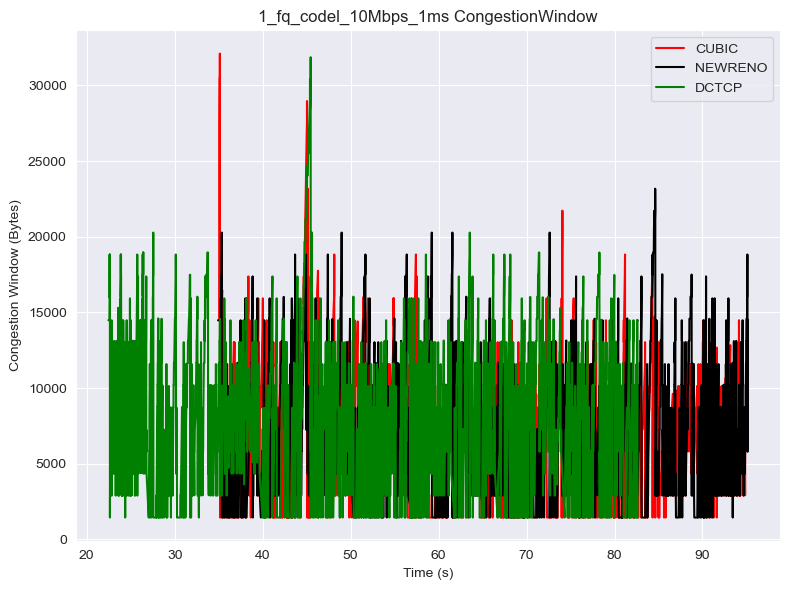


Start New Scenario
1_fq_codel_10Mbps_20ms
./Data./client1_data\1_fq_codel_10Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_10Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_10Mbps_20ms:
Statistics for CUBIC:
Median: 318.906
Mean: 2263.9282103752757
25th Percentile: 235.937
75th Percentile: 4900.937
Minimum: 112.5
Maximum: 7141.25
Statistics for NEWRENO:
Median: 239.375
Mean: 240.40197367615548
25th Percentile: 209.687
75th Percentile: 268.125
Minimum: 111.25
Maximum: 504.687
Statistics for DCTCP:
Median: 466.8745
Mean: 459.5879202576632
25th Percentile: 309.062
75th Percentile: 603.125
Minimum: 121.562
Maximum: 809.375
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_10Mbps_20ms_rtt_stats.txt



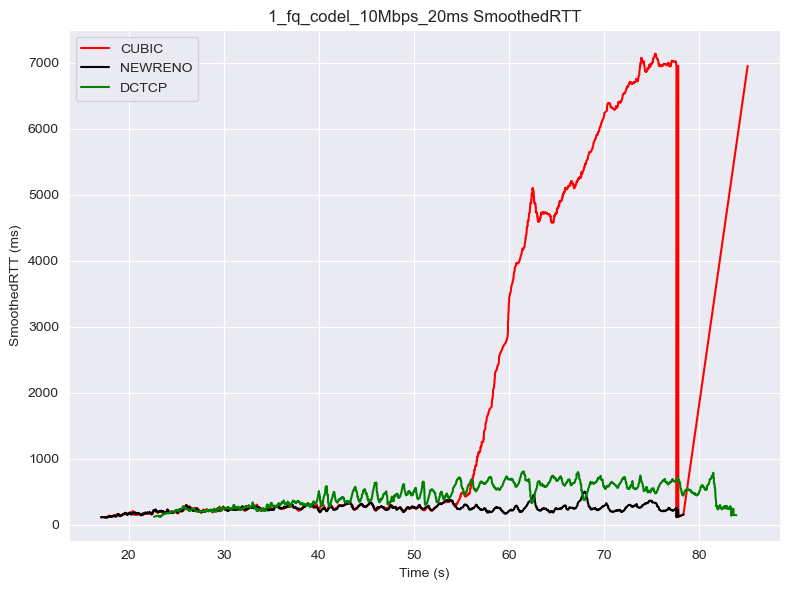

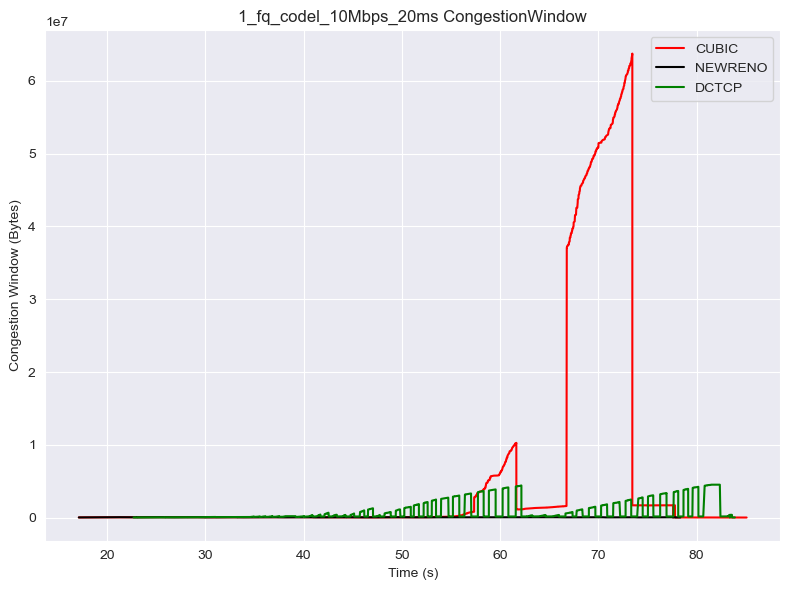


Start New Scenario
1_fq_codel_10Mbps_5ms
./Data./client1_data\1_fq_codel_10Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_10Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_10Mbps_5ms:
Statistics for CUBIC:
Median: 38.437
Mean: 41.028458141321046
25th Percentile: 31.562
75th Percentile: 47.812
Minimum: 9.687
Maximum: 96.25
Statistics for NEWRENO:
Median: 39.687
Mean: 42.98483739673585
25th Percentile: 32.187
75th Percentile: 49.375
Minimum: 15.312
Maximum: 166.562
Statistics for DCTCP:
Median: 37.5
Mean: 40.57901227573182
25th Percentile: 30.312
75th Percentile: 47.812
Minimum: 11.25
Maximum: 116.25
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_10Mbps_5ms_rtt_stats.txt



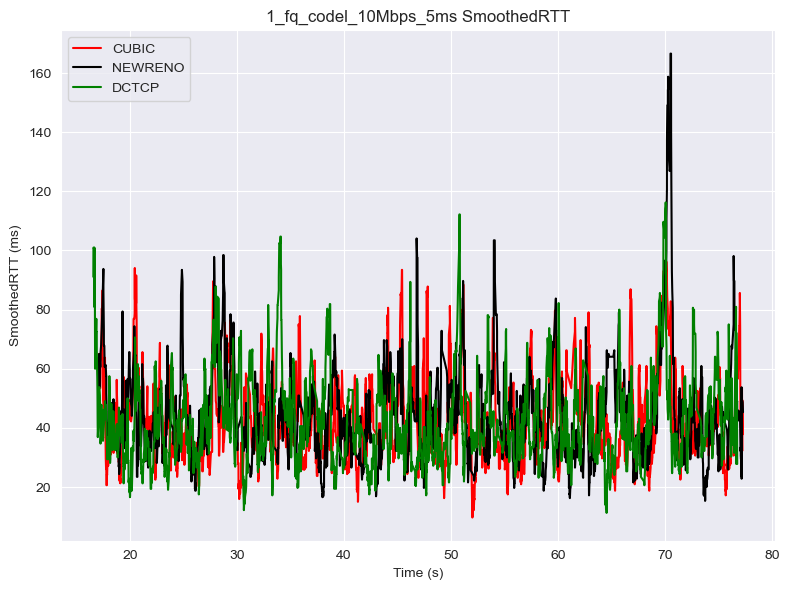

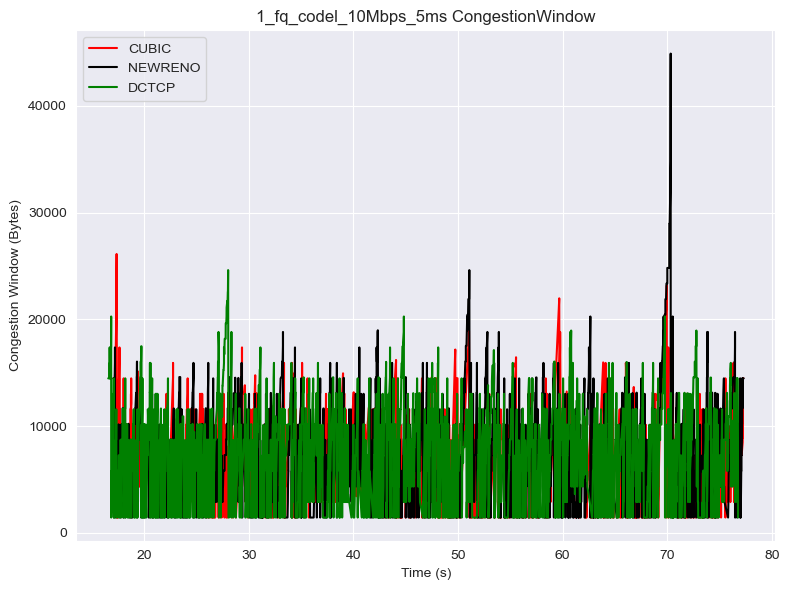


Start New Scenario
1_fq_codel_10Mbps_7ms
./Data./client1_data\1_fq_codel_10Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_10Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_10Mbps_7ms:
Statistics for CUBIC:
Median: 39.687
Mean: 42.290731395779346
25th Percentile: 30.937
75th Percentile: 50.312
Minimum: 10.937
Maximum: 125.937
Statistics for NEWRENO:
Median: 40.937
Mean: 43.343134877679155
25th Percentile: 32.812
75th Percentile: 51.562
Minimum: 17.812
Maximum: 121.875
Statistics for DCTCP:
Median: 35.312
Mean: 37.928801154817755
25th Percentile: 28.125
75th Percentile: 44.062
Minimum: 13.437
Maximum: 111.562
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_10Mbps_7ms_rtt_stats.txt



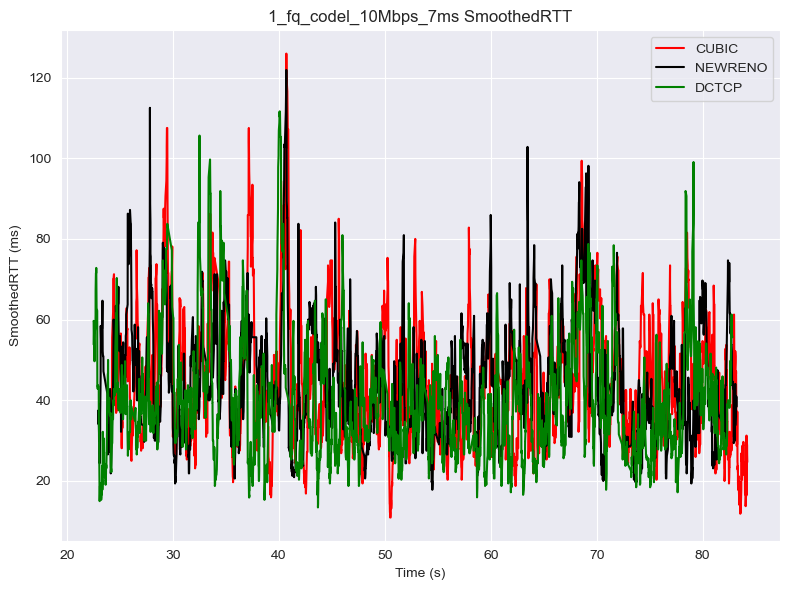

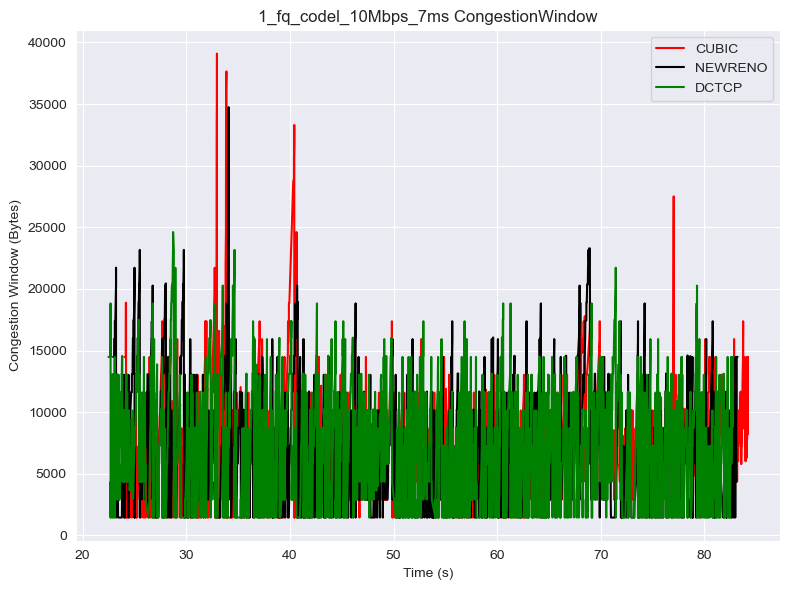


Start New Scenario
1_fq_codel_20Mbps_0ms
./Data./client1_data\1_fq_codel_20Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_20Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_20Mbps_0ms:
Statistics for CUBIC:
Median: 21.562
Mean: 23.63276789510985
25th Percentile: 17.812
75th Percentile: 26.562
Minimum: 8.75
Maximum: 153.437
Statistics for NEWRENO:
Median: 21.875
Mean: 23.275504980199212
25th Percentile: 17.5
75th Percentile: 27.187
Minimum: 6.875
Maximum: 149.687
Statistics for DCTCP:
Median: 20.0
Mean: 21.844341986698133
25th Percentile: 16.25
75th Percentile: 24.687
Minimum: 6.875
Maximum: 284.375
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_20Mbps_0ms_rtt_stats.txt



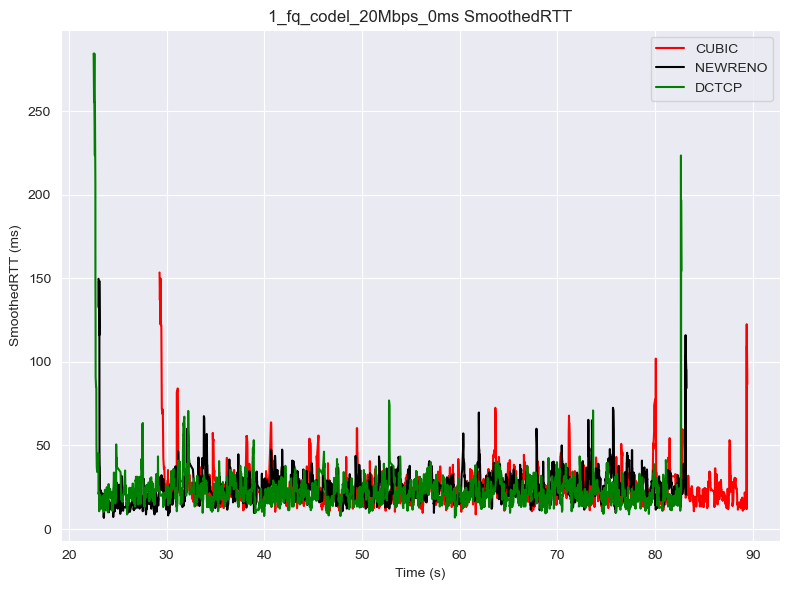

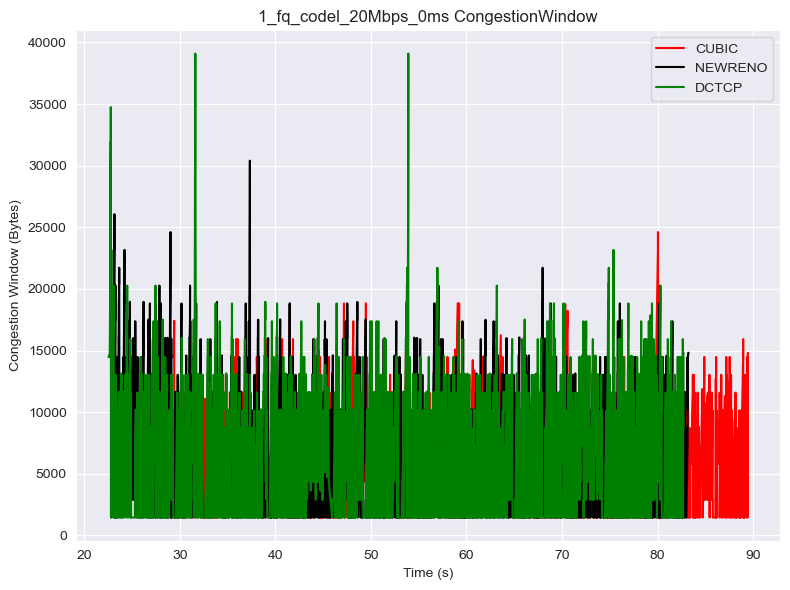


Start New Scenario
1_fq_codel_20Mbps_10ms
./Data./client1_data\1_fq_codel_20Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_20Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_20Mbps_10ms:
Statistics for CUBIC:
Median: 486.875
Mean: 526.7246047527997
25th Percentile: 437.5
75th Percentile: 575.937
Minimum: 43.75
Maximum: 992.812
Statistics for NEWRENO:
Median: 484.375
Mean: 518.608201655629
25th Percentile: 440.312
75th Percentile: 568.437
Minimum: 45.0
Maximum: 1010.625
Statistics for DCTCP:
Median: 475.0
Mean: 479.3984458088628
25th Percentile: 376.406
75th Percentile: 573.125
Minimum: 41.875
Maximum: 1166.875
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_20Mbps_10ms_rtt_stats.txt



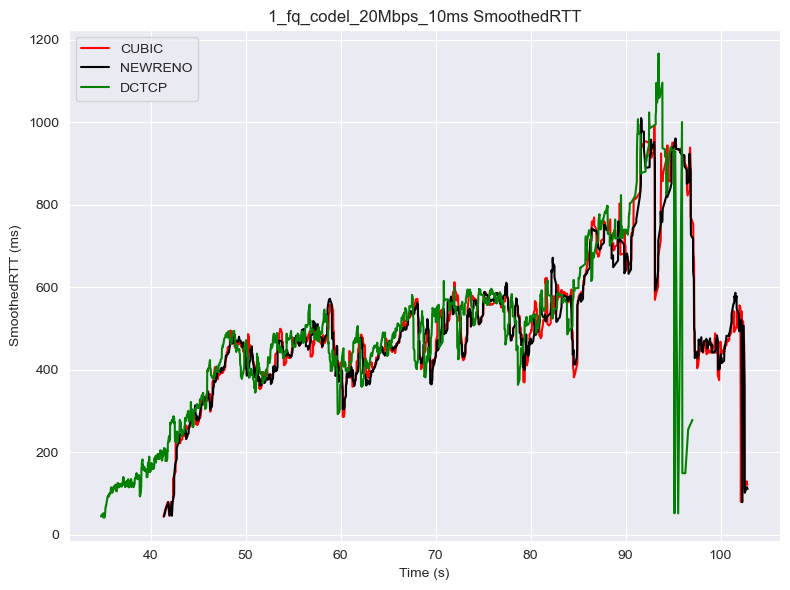

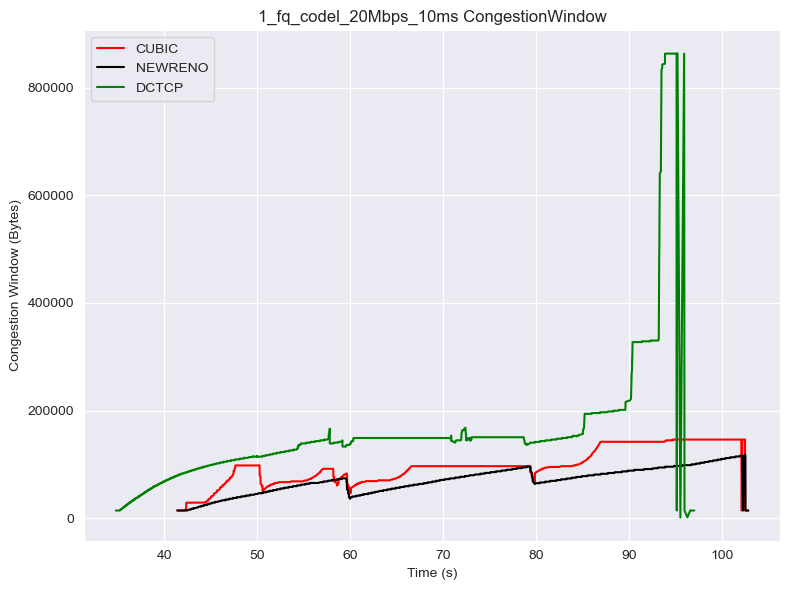


Start New Scenario
1_fq_codel_20Mbps_1ms
./Data./client1_data\1_fq_codel_20Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_20Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_20Mbps_1ms:
Statistics for CUBIC:
Median: 24.375
Mean: 26.973896618985698
25th Percentile: 19.375
75th Percentile: 30.937
Minimum: 9.375
Maximum: 142.187
Statistics for NEWRENO:
Median: 23.75
Mean: 26.691670108770484
25th Percentile: 19.375
75th Percentile: 30.312
Minimum: 6.562
Maximum: 154.375
Statistics for DCTCP:
Median: 21.875
Mean: 23.632851592205327
25th Percentile: 17.42175
75th Percentile: 27.5
Minimum: 5.625
Maximum: 145.625
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_20Mbps_1ms_rtt_stats.txt



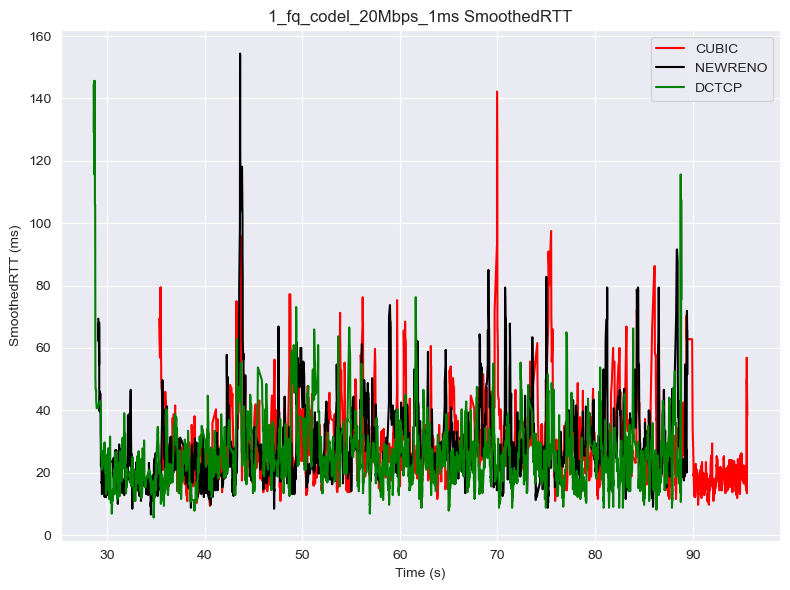

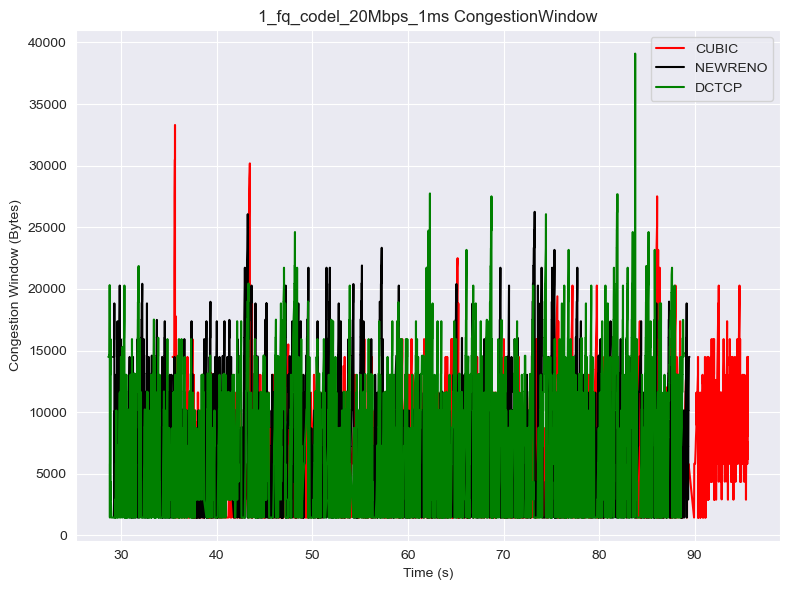


Start New Scenario
1_fq_codel_20Mbps_20ms
./Data./client1_data\1_fq_codel_20Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_20Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_20Mbps_20ms:
Statistics for CUBIC:
Median: 599.062
Mean: 606.1815924465656
25th Percentile: 483.125
75th Percentile: 767.9685
Minimum: 145.0
Maximum: 1030.0
Statistics for NEWRENO:
Median: 557.812
Mean: 551.9139179586563
25th Percentile: 396.562
75th Percentile: 646.8745
Minimum: 135.0
Maximum: 1006.875
Statistics for DCTCP:
Median: 655.312
Mean: 646.7317915545436
25th Percentile: 514.375
75th Percentile: 820.781
Minimum: 162.5
Maximum: 1068.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_20Mbps_20ms_rtt_stats.txt



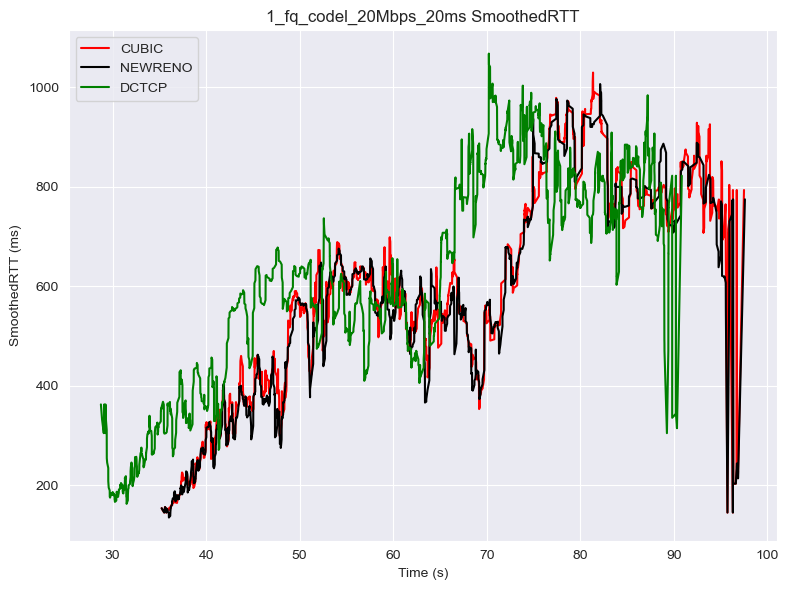

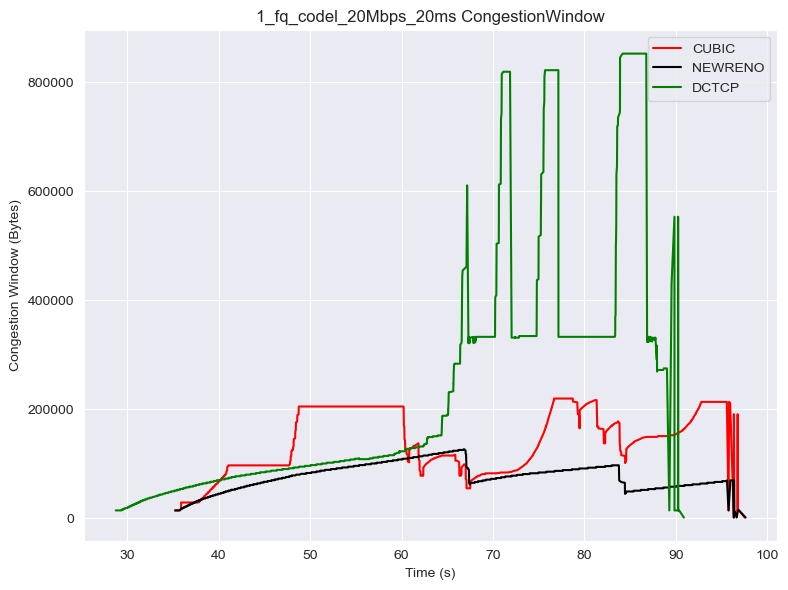


Start New Scenario
1_fq_codel_20Mbps_5ms
./Data./client1_data\1_fq_codel_20Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_20Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_20Mbps_5ms:
Statistics for CUBIC:
Median: 22.5
Mean: 24.954894109055502
25th Percentile: 18.125
75th Percentile: 28.75
Minimum: 5.625
Maximum: 131.875
Statistics for NEWRENO:
Median: 23.75
Mean: 25.809436711493138
25th Percentile: 19.062
75th Percentile: 29.687
Minimum: 5.625
Maximum: 131.25
Statistics for DCTCP:
Median: 19.062
Mean: 20.636754453588917
25th Percentile: 15.312
75th Percentile: 23.75
Minimum: 5.625
Maximum: 116.875
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_20Mbps_5ms_rtt_stats.txt



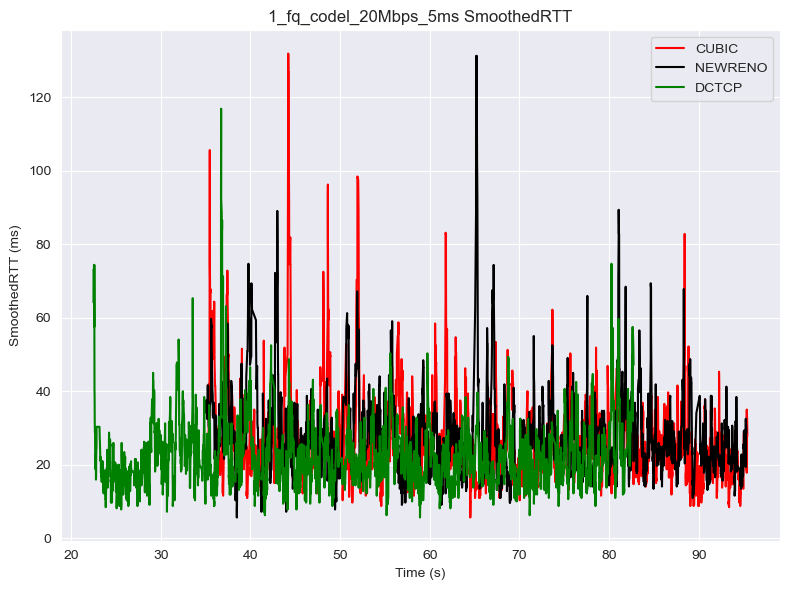

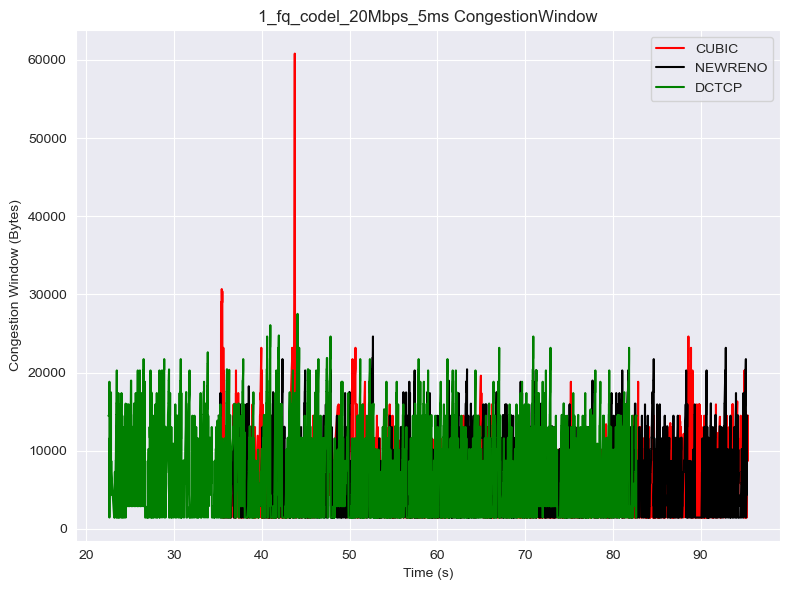


Start New Scenario
1_fq_codel_20Mbps_7ms
./Data./client1_data\1_fq_codel_20Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_20Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_20Mbps_7ms:
Statistics for CUBIC:
Median: 25.312
Mean: 28.428208408242295
25th Percentile: 20.937
75th Percentile: 31.562
Minimum: 8.75
Maximum: 178.437
Statistics for NEWRENO:
Median: 26.562
Mean: 28.749057320135915
25th Percentile: 21.25
75th Percentile: 32.5
Minimum: 10.937
Maximum: 112.5
Statistics for DCTCP:
Median: 22.5
Mean: 24.995771909187162
25th Percentile: 17.812
75th Percentile: 28.437
Minimum: 6.25
Maximum: 204.687
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_20Mbps_7ms_rtt_stats.txt



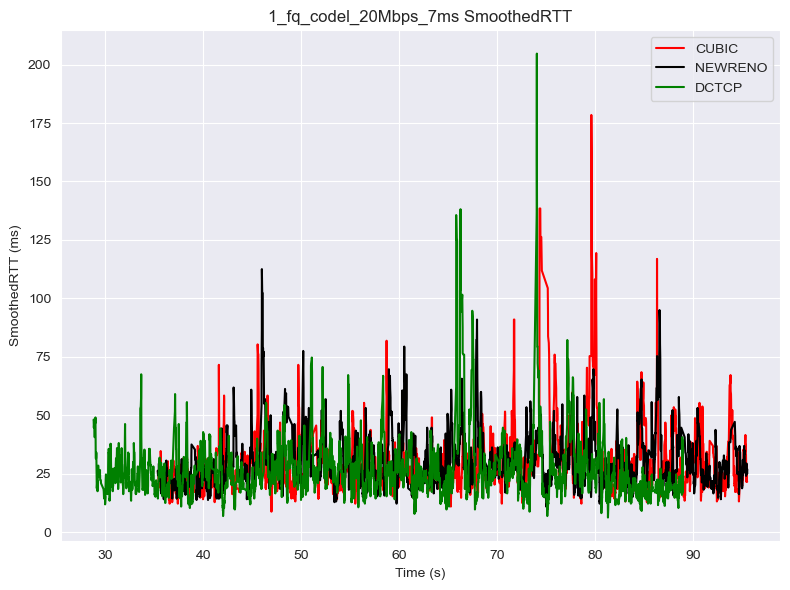

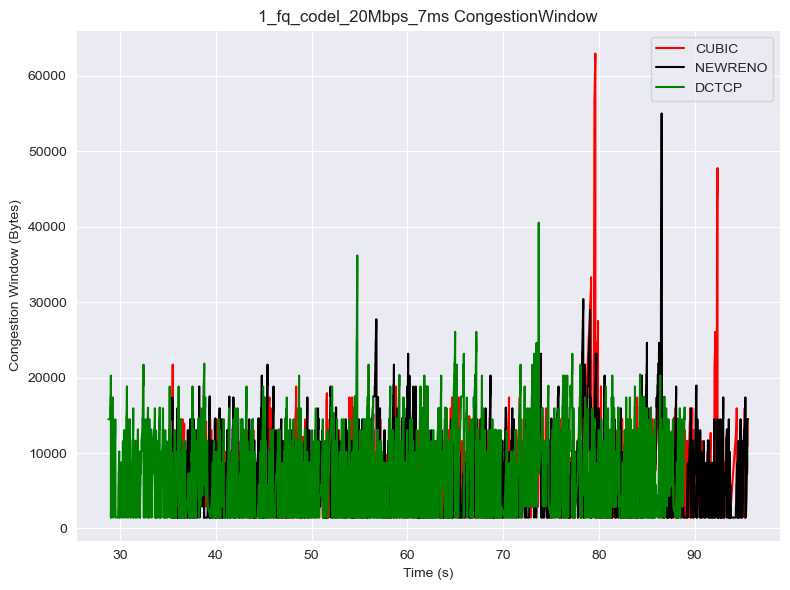


Start New Scenario
1_fq_codel_5Mbps_0ms
./Data./client1_data\1_fq_codel_5Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_5Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_5Mbps_0ms:
Statistics for CUBIC:
Median: 88.75
Mean: 93.9504446515095
25th Percentile: 84.062
75th Percentile: 95.937
Minimum: 43.437
Maximum: 890.625
Statistics for NEWRENO:
Median: 3647.187
Mean: 2872.4564323866043
25th Percentile: 106.875
75th Percentile: 4926.25
Minimum: 71.25
Maximum: 5050.0
Statistics for DCTCP:
Median: 108.437
Mean: 109.02691167775313
25th Percentile: 100.937
75th Percentile: 114.687
Minimum: 75.0
Maximum: 219.062
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_5Mbps_0ms_rtt_stats.txt



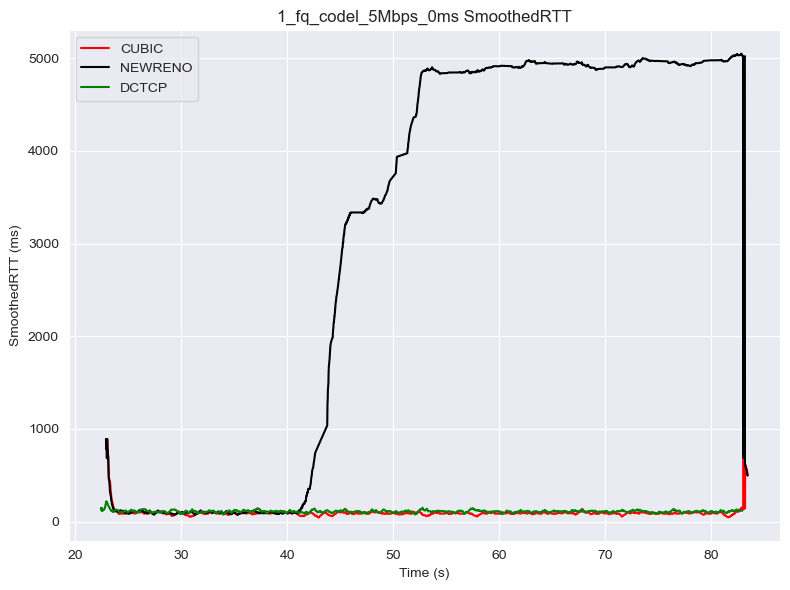

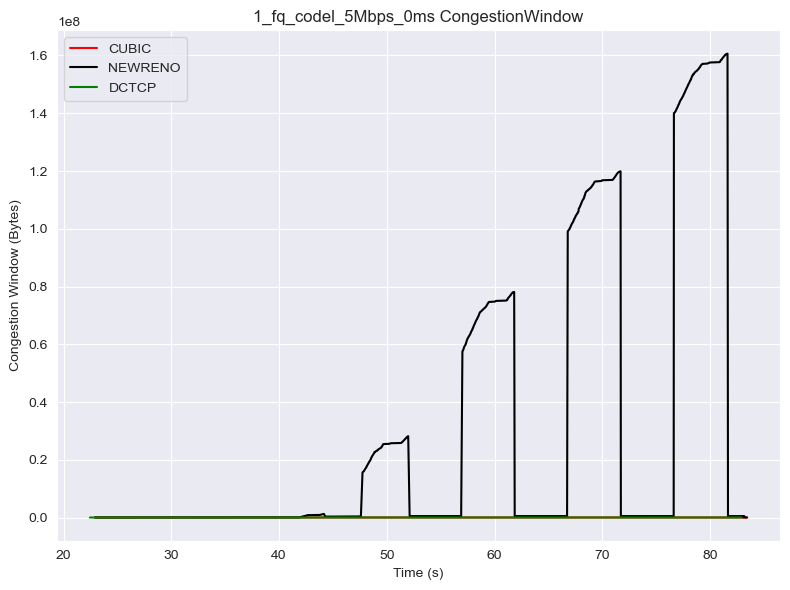


Start New Scenario
1_fq_codel_5Mbps_10ms
./Data./client1_data\1_fq_codel_5Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_5Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_5Mbps_10ms:
Statistics for CUBIC:
Median: 120.625
Mean: 122.30738033319788
25th Percentile: 110.937
75th Percentile: 131.25
Minimum: 89.375
Maximum: 224.062
Statistics for NEWRENO:
Median: 129.375
Mean: 132.00673891437307
25th Percentile: 121.25
75th Percentile: 140.312
Minimum: 99.062
Maximum: 226.562
Statistics for DCTCP:
Median: 147.187
Mean: 237.7680988643954
25th Percentile: 128.75
75th Percentile: 230.859
Minimum: 77.812
Maximum: 651.875
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_5Mbps_10ms_rtt_stats.txt



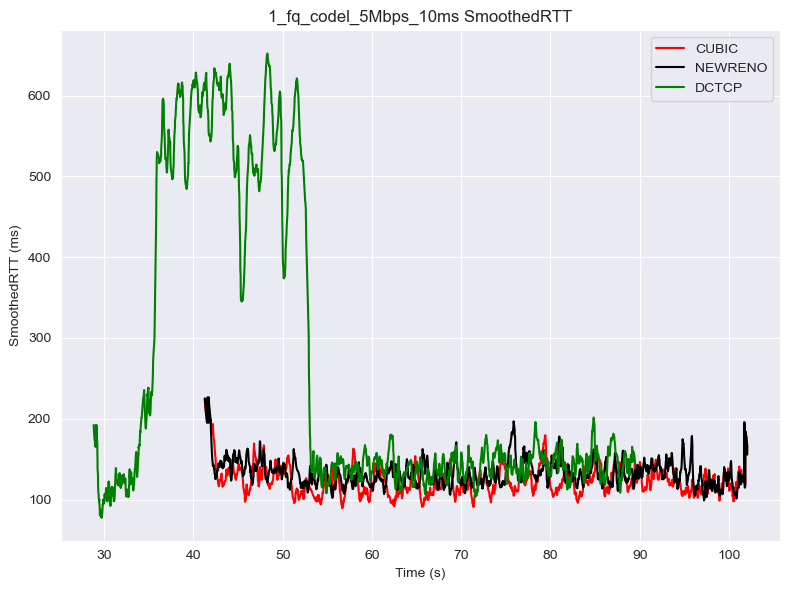

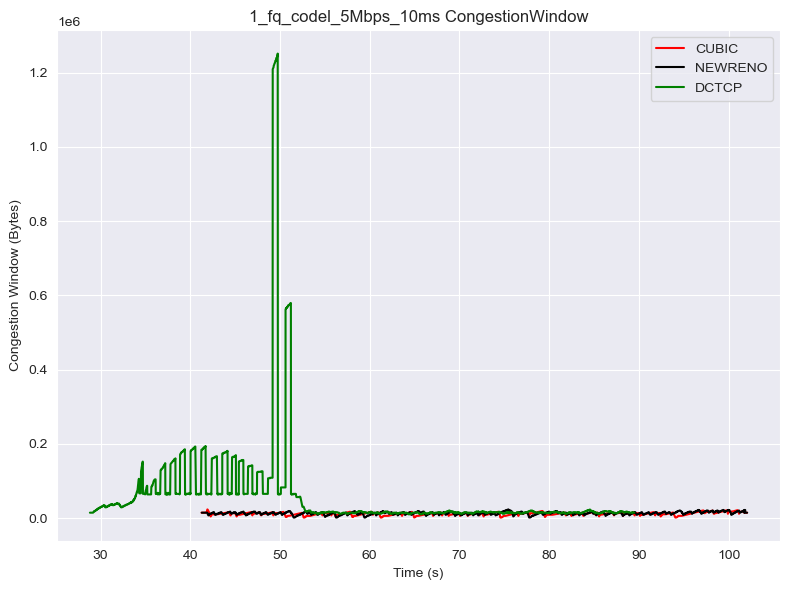


Start New Scenario
1_fq_codel_5Mbps_1ms
./Data./client1_data\1_fq_codel_5Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_5Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_5Mbps_1ms:
Statistics for CUBIC:
Median: 7163.437
Mean: 5137.282642693191
25th Percentile: 1664.062
75th Percentile: 7295.5467499999995
Minimum: 25.937
Maximum: 7484.062
Statistics for NEWRENO:
Median: 99.375
Mean: 106.12080965682362
25th Percentile: 92.187
75th Percentile: 107.187
Minimum: 67.812
Maximum: 943.437
Statistics for DCTCP:
Median: 112.5
Mean: 111.87336069193962
25th Percentile: 103.437
75th Percentile: 120.625
Minimum: 32.187
Maximum: 160.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_5Mbps_1ms_rtt_stats.txt



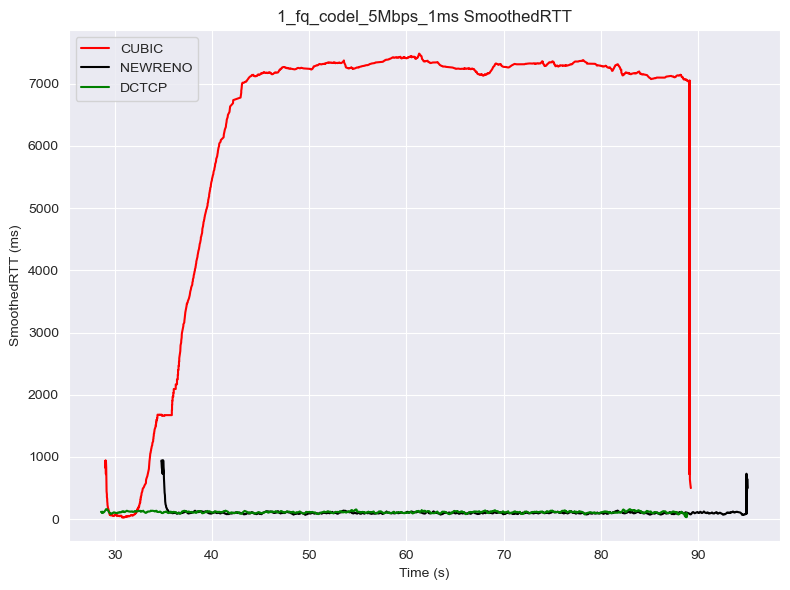

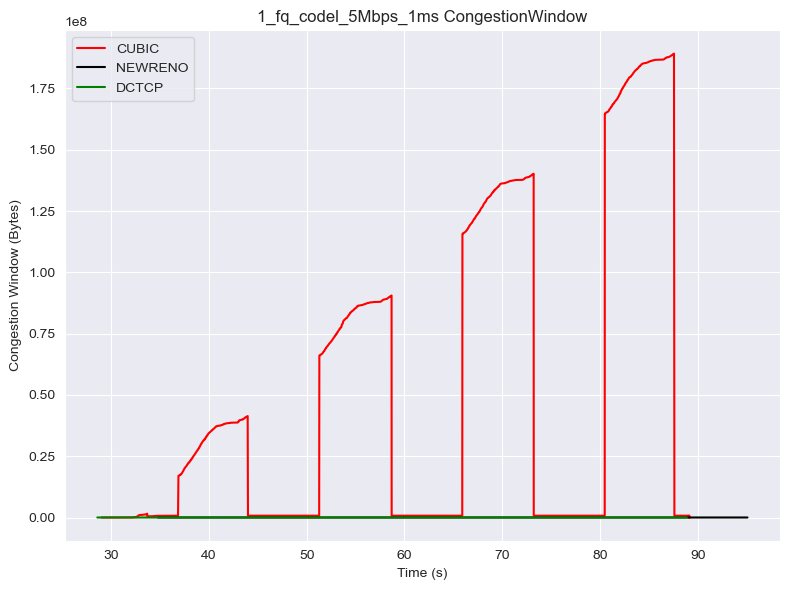


Start New Scenario
1_fq_codel_5Mbps_20ms
./Data./client1_data\1_fq_codel_5Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_5Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_5Mbps_20ms:
Statistics for CUBIC:
Median: 176.25
Mean: 175.73668093865788
25th Percentile: 165.312
75th Percentile: 186.25
Minimum: 128.437
Maximum: 231.875
Statistics for NEWRENO:
Median: 175.625
Mean: 171.48454332356636
25th Percentile: 154.687
75th Percentile: 187.812
Minimum: 119.687
Maximum: 262.187
Statistics for DCTCP:
Median: 503.437
Mean: 451.7063870844477
25th Percentile: 384.062
75th Percentile: 555.937
Minimum: 139.687
Maximum: 632.812
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_5Mbps_20ms_rtt_stats.txt



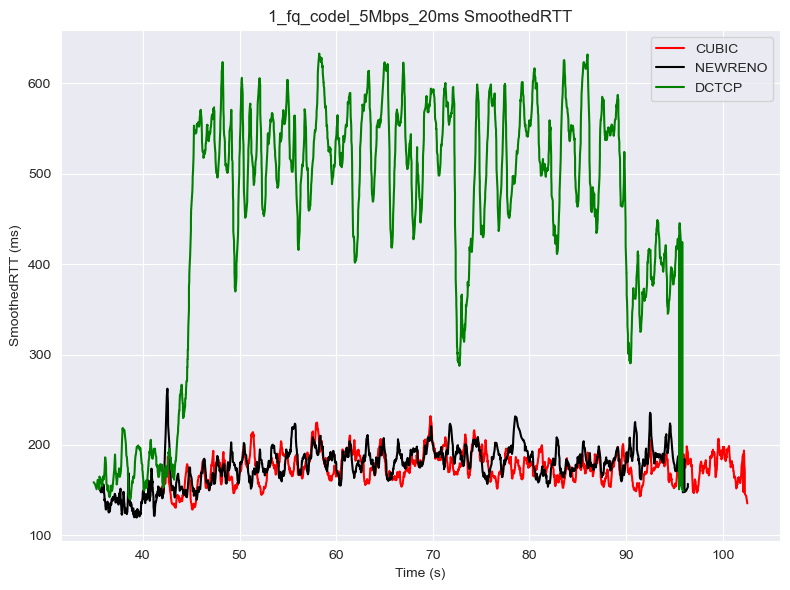

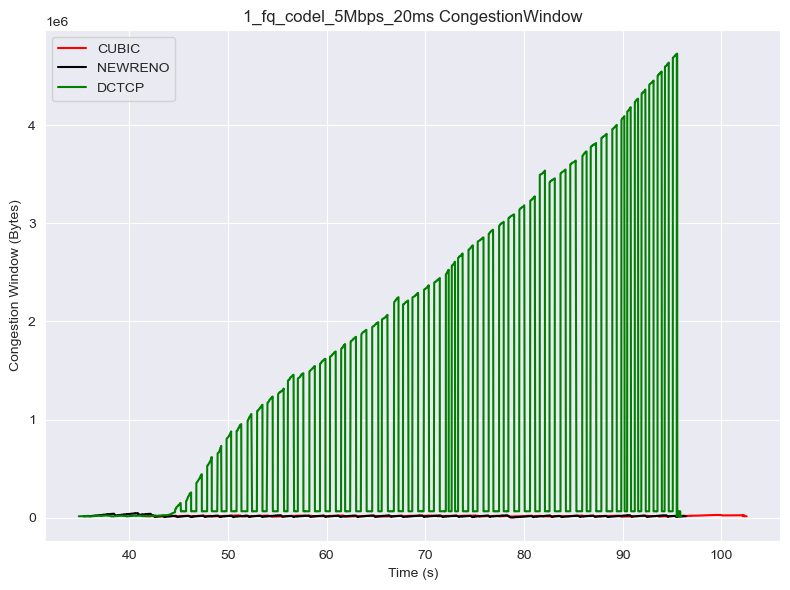


Start New Scenario
1_fq_codel_5Mbps_5ms
./Data./client1_data\1_fq_codel_5Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_5Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_5Mbps_5ms:
Statistics for CUBIC:
Median: 88.125
Mean: 92.3381017811705
25th Percentile: 82.5
75th Percentile: 96.25
Minimum: 43.437
Maximum: 793.125
Statistics for NEWRENO:
Median: 3257.812
Mean: 2453.797778378378
25th Percentile: 1105.625
75th Percentile: 3289.375
Minimum: 25.937
Maximum: 3369.375
Statistics for DCTCP:
Median: 105.0
Mean: 105.50521976026153
25th Percentile: 97.812
75th Percentile: 112.5
Minimum: 67.187
Maximum: 159.375
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_5Mbps_5ms_rtt_stats.txt



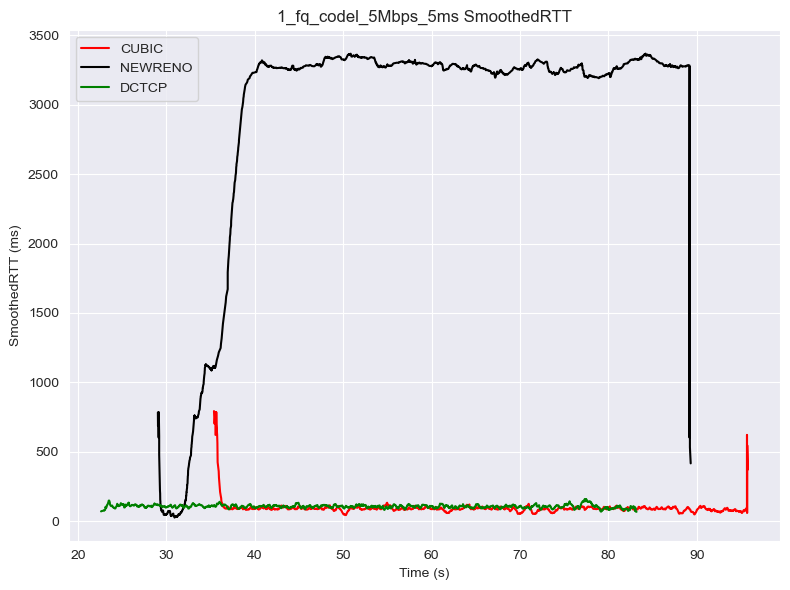

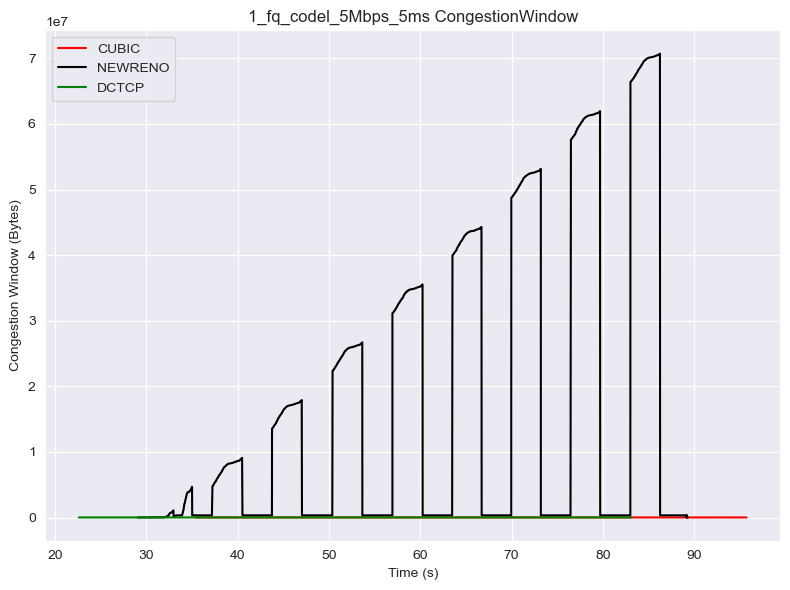


Start New Scenario
1_fq_codel_5Mbps_7ms
./Data./client1_data\1_fq_codel_5Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_5Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_5Mbps_7ms:
Statistics for CUBIC:
Median: 88.437
Mean: 90.04185058737151
25th Percentile: 82.187
75th Percentile: 96.562
Minimum: 43.125
Maximum: 489.062
Statistics for NEWRENO:
Median: 94.687
Mean: 98.59842092840283
25th Percentile: 89.375
75th Percentile: 101.875
Minimum: 71.875
Maximum: 490.312
Statistics for DCTCP:
Median: 618.125
Mean: 579.5901707523245
25th Percentile: 589.375
75th Percentile: 634.687
Minimum: 55.937
Maximum: 675.625
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_5Mbps_7ms_rtt_stats.txt



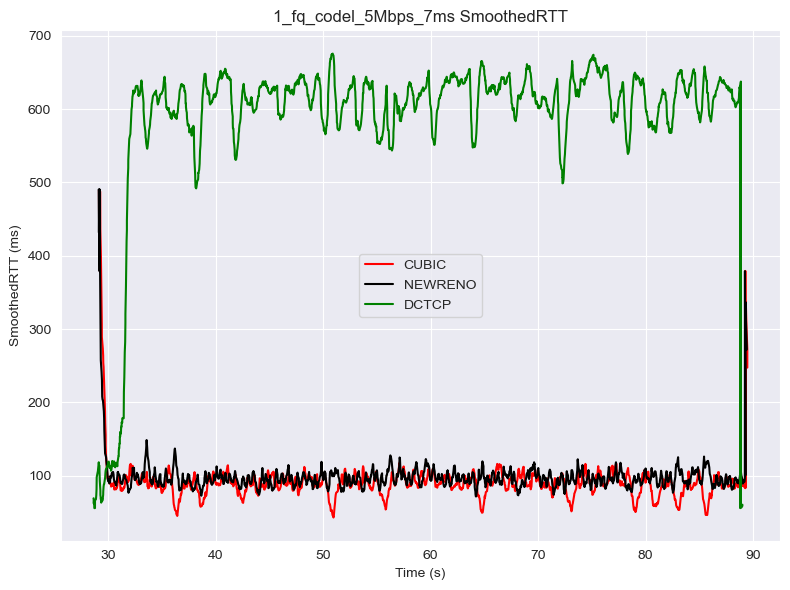

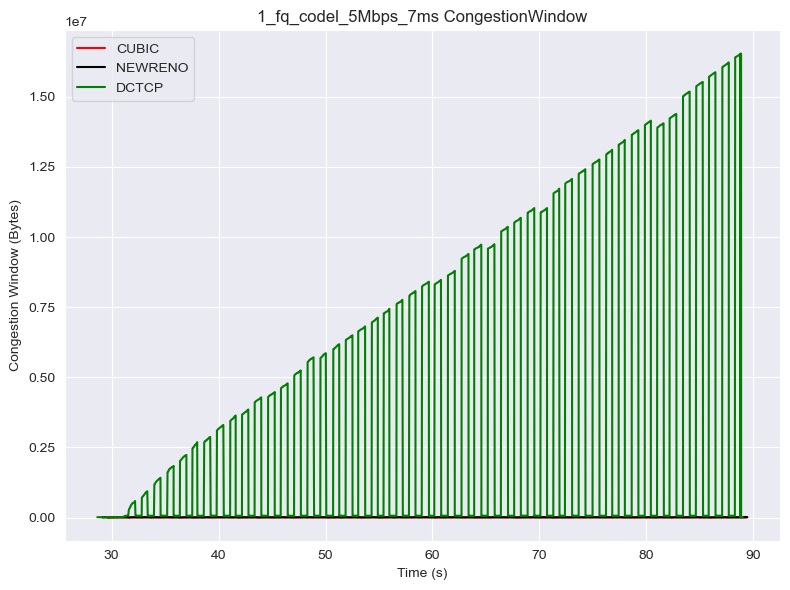


Start New Scenario
1_fq_codel_8Mbps_0ms
./Data./client1_data\1_fq_codel_8Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_8Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_8Mbps_0ms:
Statistics for CUBIC:
Median: 597.9685
Mean: 441.9740633370535
25th Percentile: 130.937
75th Percentile: 616.562
Minimum: 23.75
Maximum: 711.25
Statistics for NEWRENO:
Median: 598.75
Mean: 454.6226176136363
25th Percentile: 343.75
75th Percentile: 616.25
Minimum: 15.312
Maximum: 705.312
Statistics for DCTCP:
Median: 585.0
Mean: 356.7806550348953
25th Percentile: 43.437
75th Percentile: 612.187
Minimum: 13.437
Maximum: 687.187
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_8Mbps_0ms_rtt_stats.txt



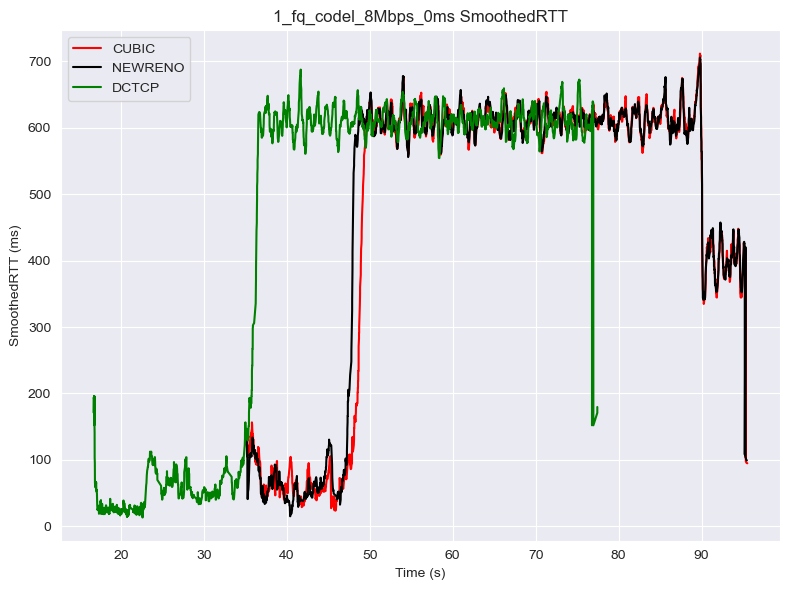

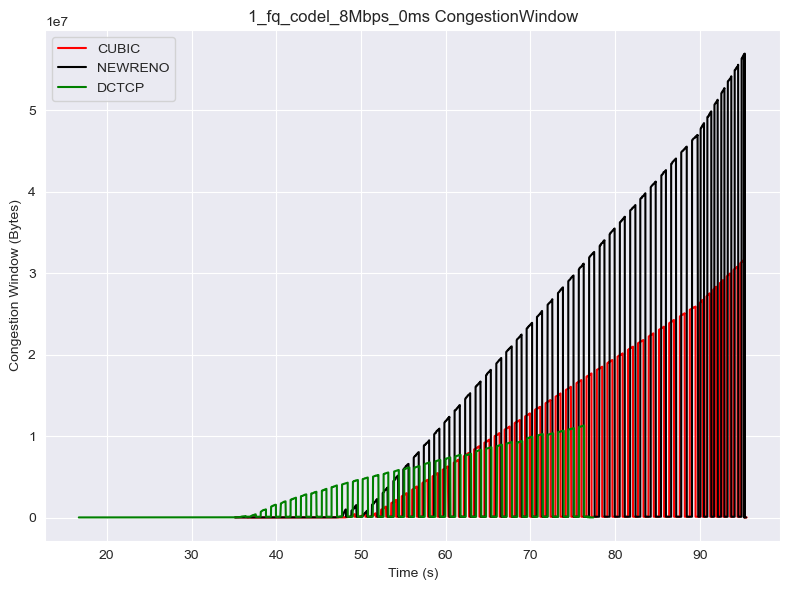


Start New Scenario
1_fq_codel_8Mbps_10ms
./Data./client1_data\1_fq_codel_8Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_8Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_8Mbps_10ms:
Statistics for CUBIC:
Median: 154.375
Mean: 150.402230853692
25th Percentile: 135.312
75th Percentile: 170.0
Minimum: 77.187
Maximum: 221.25
Statistics for NEWRENO:
Median: 160.937
Mean: 161.73534836188756
25th Percentile: 146.25
75th Percentile: 176.875
Minimum: 71.25
Maximum: 227.187
Statistics for DCTCP:
Median: 173.125
Mean: 174.19735985832347
25th Percentile: 155.625
75th Percentile: 190.625
Minimum: 110.312
Maximum: 281.562
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_8Mbps_10ms_rtt_stats.txt



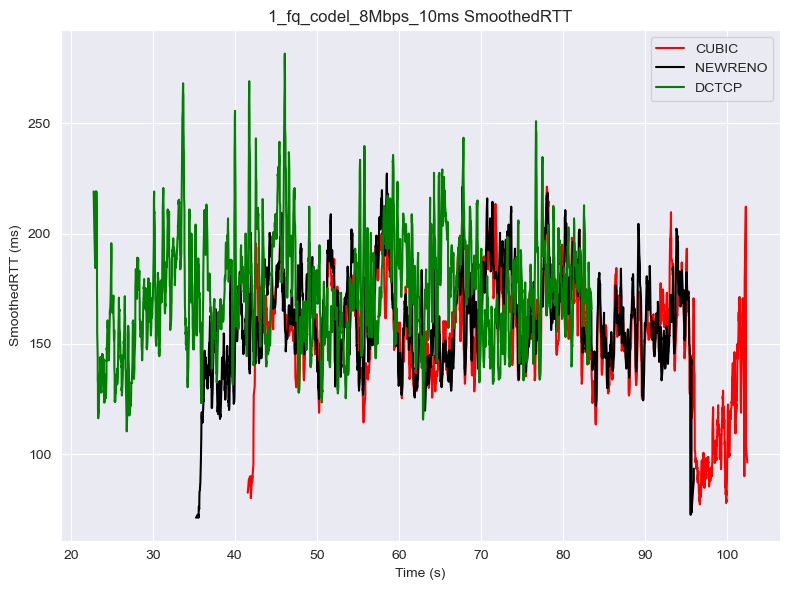

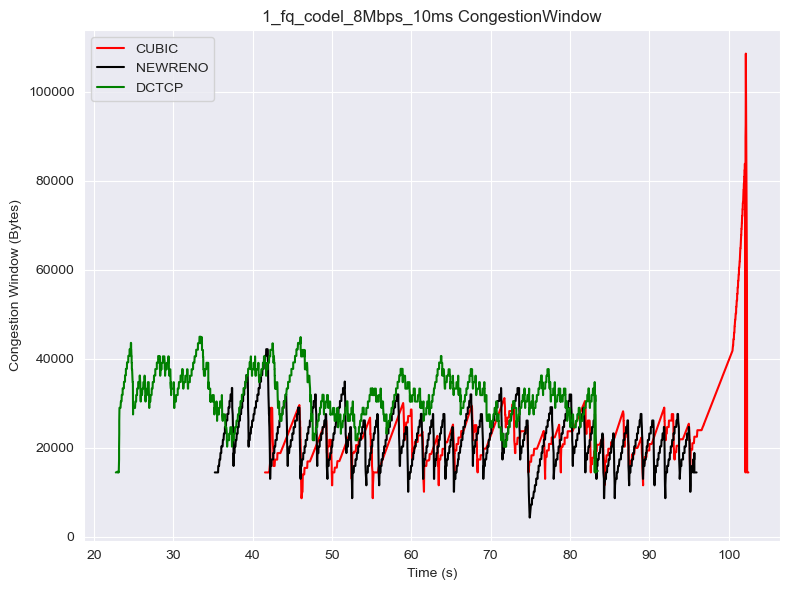


Start New Scenario
1_fq_codel_8Mbps_1ms
./Data./client1_data\1_fq_codel_8Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_8Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_8Mbps_1ms:
Statistics for CUBIC:
Median: 390.0
Mean: 299.3508935483871
25th Percentile: 122.5
75th Percentile: 408.125
Minimum: 20.312
Maximum: 485.0
Statistics for NEWRENO:
Median: 390.0
Mean: 283.9437949098097
25th Percentile: 49.687
75th Percentile: 407.5
Minimum: 12.812
Maximum: 476.562
Statistics for DCTCP:
Median: 392.187
Mean: 307.15685023487146
25th Percentile: 121.5625
75th Percentile: 409.375
Minimum: 17.5
Maximum: 470.625
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_8Mbps_1ms_rtt_stats.txt



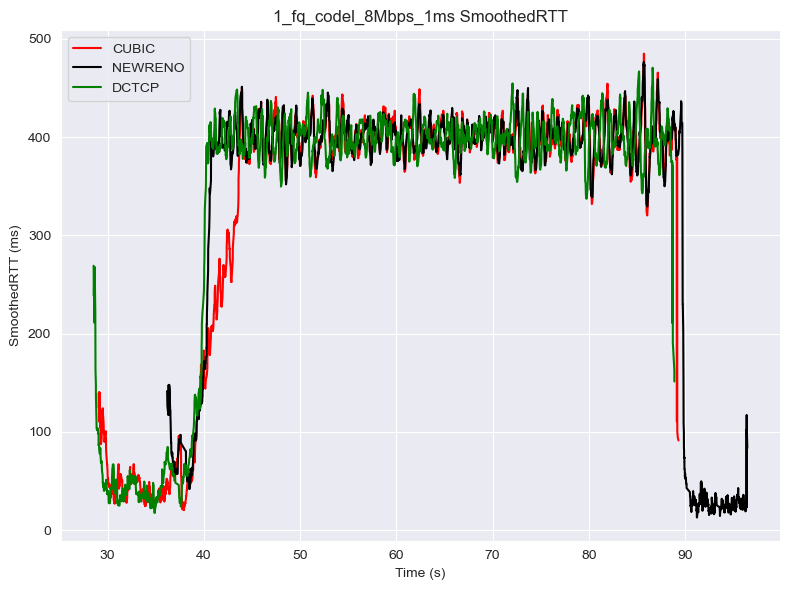

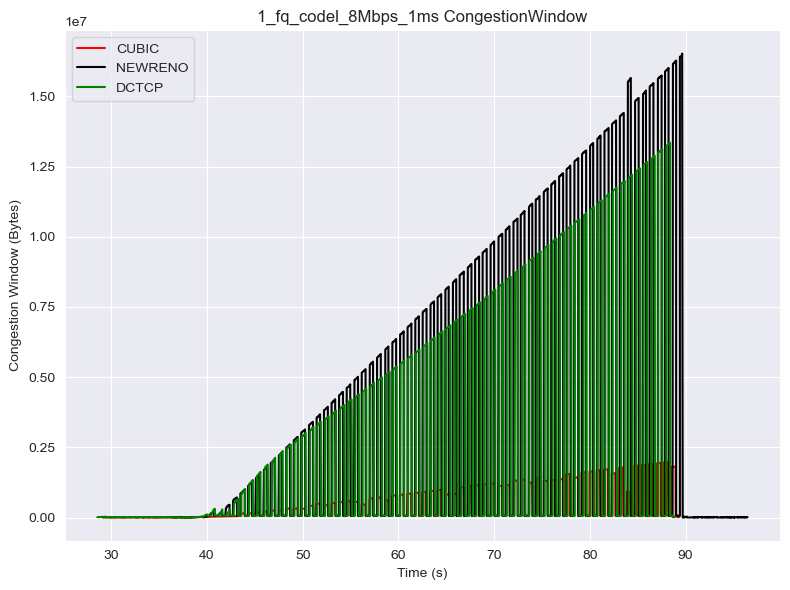


Start New Scenario
1_fq_codel_8Mbps_20ms
./Data./client1_data\1_fq_codel_8Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_8Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_8Mbps_20ms:
Statistics for CUBIC:
Median: 218.437
Mean: 218.64886547811994
25th Percentile: 202.812
75th Percentile: 235.0
Minimum: 112.187
Maximum: 296.25
Statistics for NEWRENO:
Median: 220.625
Mean: 220.0294102223697
25th Percentile: 204.062
75th Percentile: 236.875
Minimum: 108.437
Maximum: 290.0
Statistics for DCTCP:
Median: 255.625
Mean: 347.41812384288215
25th Percentile: 215.625
75th Percentile: 444.375
Minimum: 153.75
Maximum: 788.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_8Mbps_20ms_rtt_stats.txt



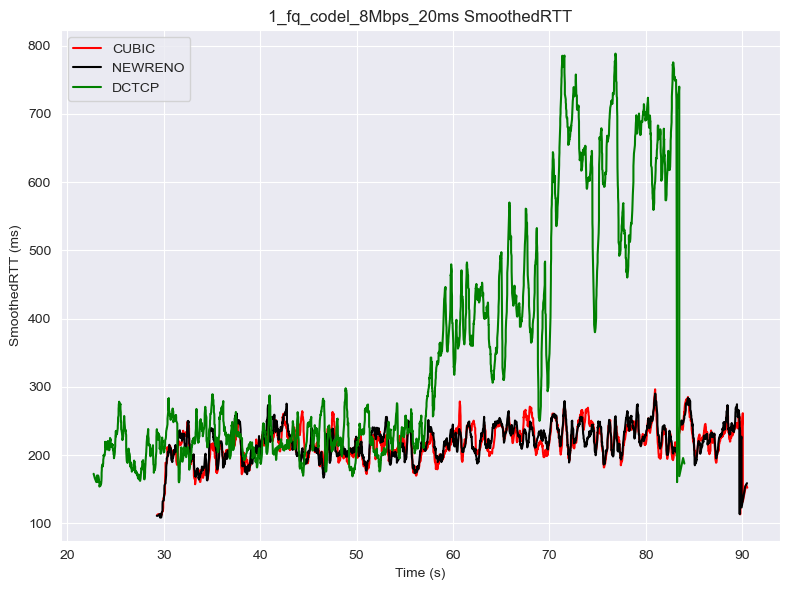

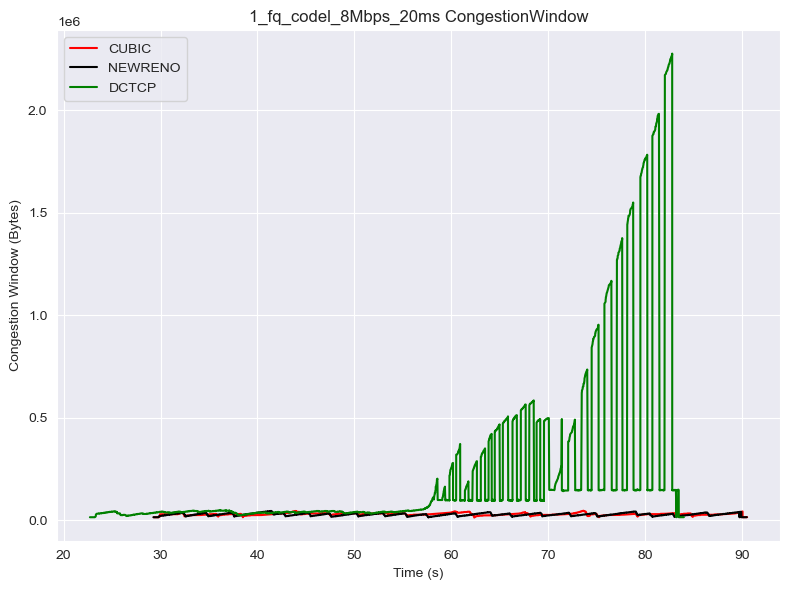


Start New Scenario
1_fq_codel_8Mbps_5ms
./Data./client1_data\1_fq_codel_8Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_8Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_8Mbps_5ms:
Statistics for CUBIC:
Median: 131.875
Mean: 160.12303703703702
25th Percentile: 62.812
75th Percentile: 257.812
Minimum: 12.187
Maximum: 418.75
Statistics for NEWRENO:
Median: 91.25
Mean: 288.4656254910519
25th Percentile: 57.812
75th Percentile: 358.437
Minimum: 30.937
Maximum: 21900.0
Statistics for DCTCP:
Median: 97.5
Mean: 248.78973302971153
25th Percentile: 40.937
75th Percentile: 430.625
Minimum: 15.312
Maximum: 633.437
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_8Mbps_5ms_rtt_stats.txt



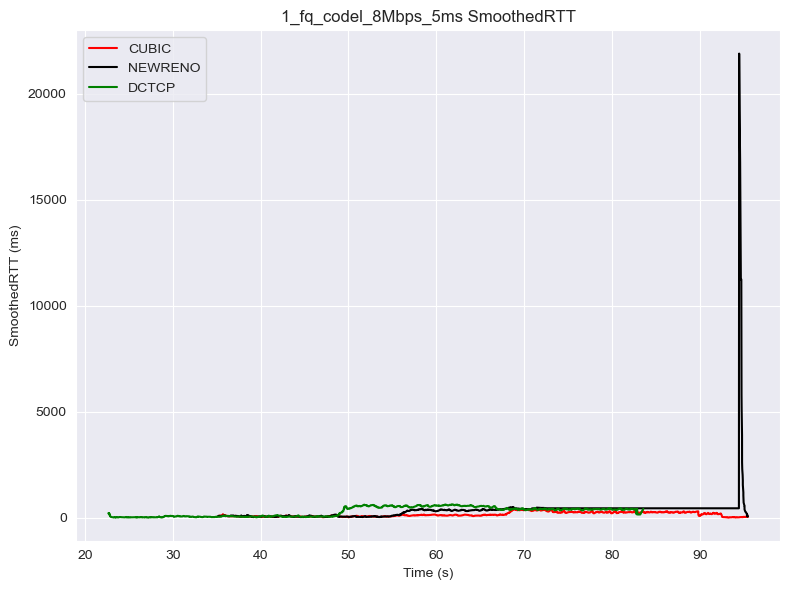

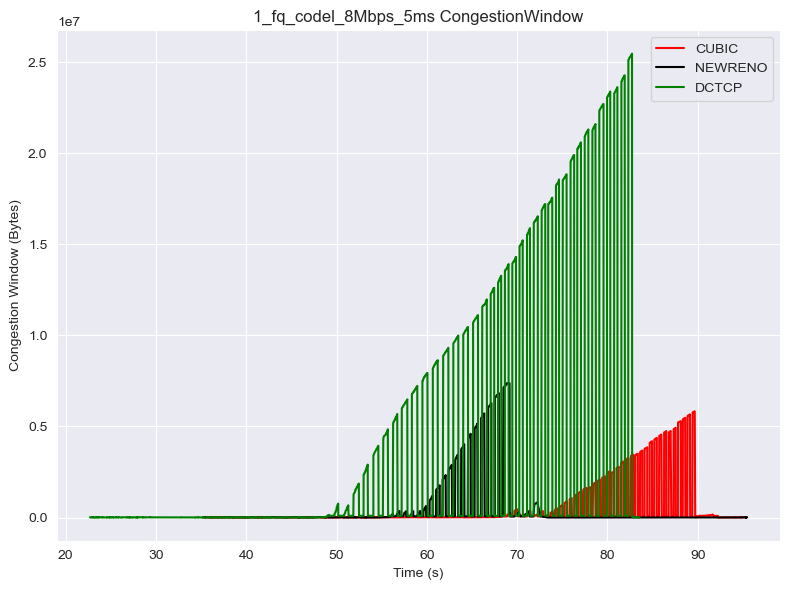


Start New Scenario
1_fq_codel_8Mbps_7ms
./Data./client1_data\1_fq_codel_8Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_codel_8Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_codel_8Mbps_7ms:
Statistics for CUBIC:
Median: 366.562
Mean: 307.8660854881266
25th Percentile: 318.828
75th Percentile: 388.437
Minimum: 17.5
Maximum: 444.375
Statistics for NEWRENO:
Median: 104.687
Mean: 90.33632967581045
25th Percentile: 37.812
75th Percentile: 116.562
Minimum: 13.125
Maximum: 177.812
Statistics for DCTCP:
Median: 364.687
Mean: 305.706430214323
25th Percentile: 312.187
75th Percentile: 388.75
Minimum: 22.187
Maximum: 452.5
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_codel_8Mbps_7ms_rtt_stats.txt



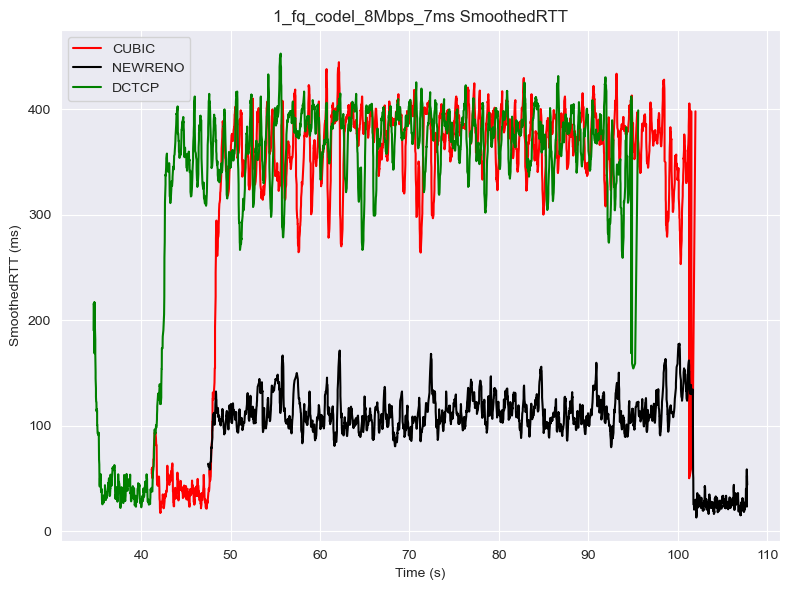

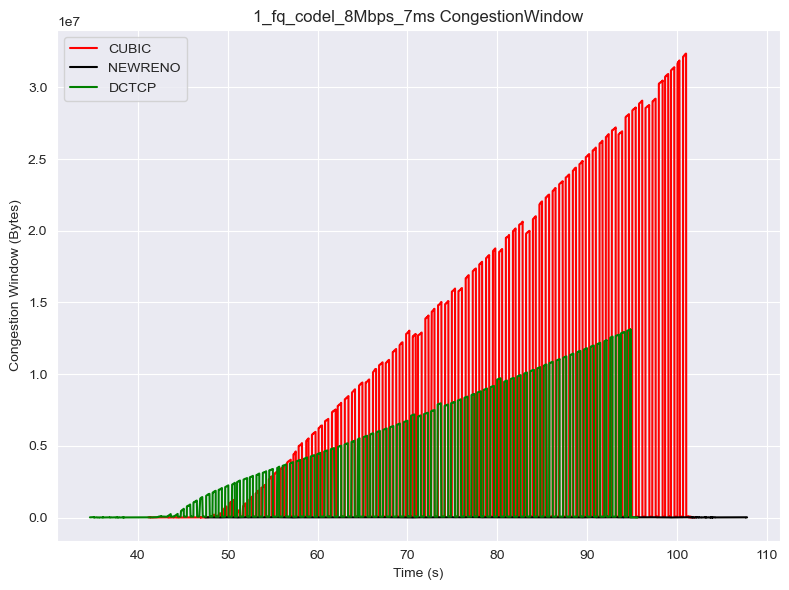


Start New Scenario
1_fq_pie_10Mbps_0ms
./Data./client1_data\1_fq_pie_10Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_10Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_10Mbps_0ms:
Statistics for CUBIC:
Median: 67.187
Mean: 89.9127227626459
25th Percentile: 54.062
75th Percentile: 98.125
Minimum: 18.75
Maximum: 789.062
Statistics for NEWRENO:
Median: 68.125
Mean: 84.36599757785467
25th Percentile: 53.125
75th Percentile: 85.625
Minimum: 20.312
Maximum: 782.812
Statistics for DCTCP:
Median: 62.187
Mean: 75.40502376302084
25th Percentile: 48.437
75th Percentile: 83.437
Minimum: 19.062
Maximum: 385.0
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_10Mbps_0ms_rtt_stats.txt



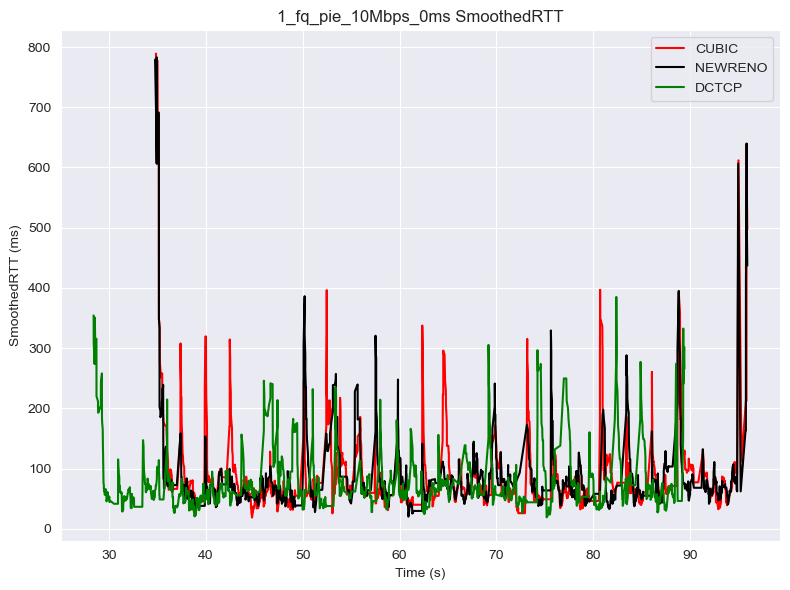

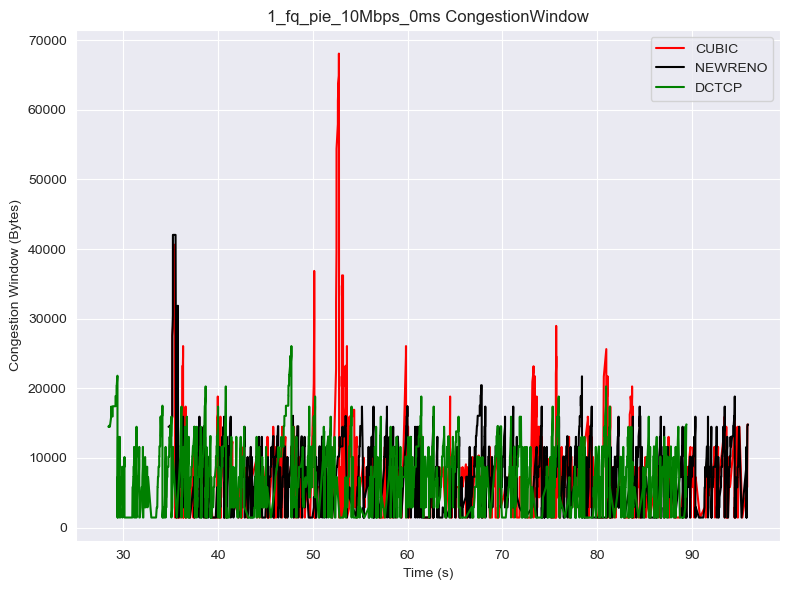


Start New Scenario
1_fq_pie_10Mbps_10ms
./Data./client1_data\1_fq_pie_10Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_10Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_10Mbps_10ms:
Statistics for CUBIC:
Median: 967.187
Mean: 888.6148903707655
25th Percentile: 683.437
75th Percentile: 1085.0
Minimum: 105.625
Maximum: 1882.187
Statistics for NEWRENO:
Median: 811.562
Mean: 795.4522791533545
25th Percentile: 609.9995
75th Percentile: 983.203
Minimum: 105.625
Maximum: 2200.937
Statistics for DCTCP:
Median: 743.125
Mean: 743.9896843065693
25th Percentile: 488.5155
75th Percentile: 927.187
Minimum: 217.5
Maximum: 2248.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_10Mbps_10ms_rtt_stats.txt



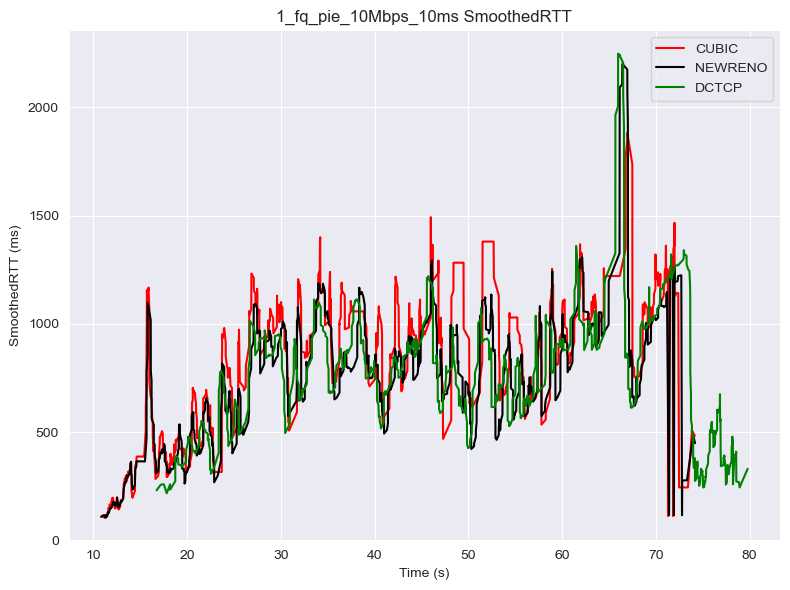

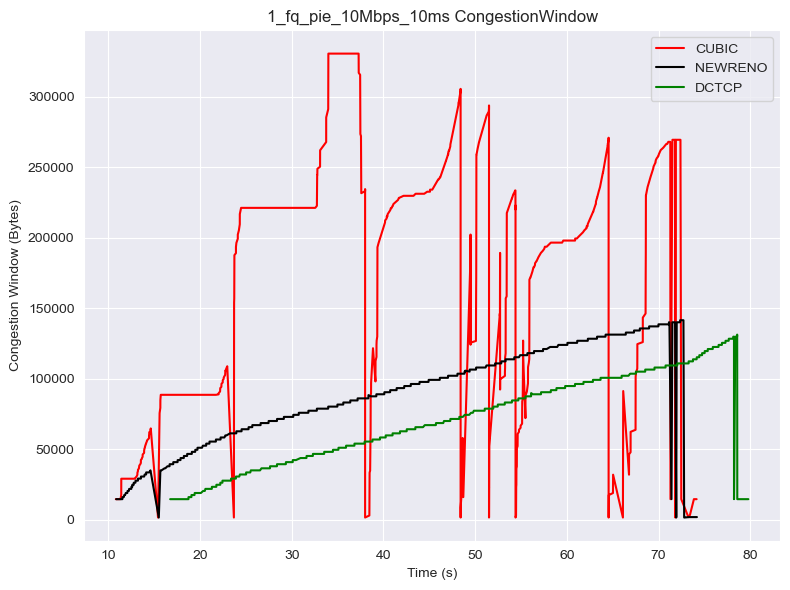


Start New Scenario
1_fq_pie_10Mbps_1ms
./Data./client1_data\1_fq_pie_10Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_10Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_10Mbps_1ms:
Statistics for CUBIC:
Median: 63.125
Mean: 85.68294317817015
25th Percentile: 49.062
75th Percentile: 88.75
Minimum: 20.937
Maximum: 477.812
Statistics for NEWRENO:
Median: 65.625
Mean: 85.33226399190829
25th Percentile: 49.062
75th Percentile: 88.75
Minimum: 20.937
Maximum: 520.625
Statistics for DCTCP:
Median: 52.187
Mean: 66.55835878284924
25th Percentile: 38.437
75th Percentile: 73.125
Minimum: 15.312
Maximum: 403.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_10Mbps_1ms_rtt_stats.txt



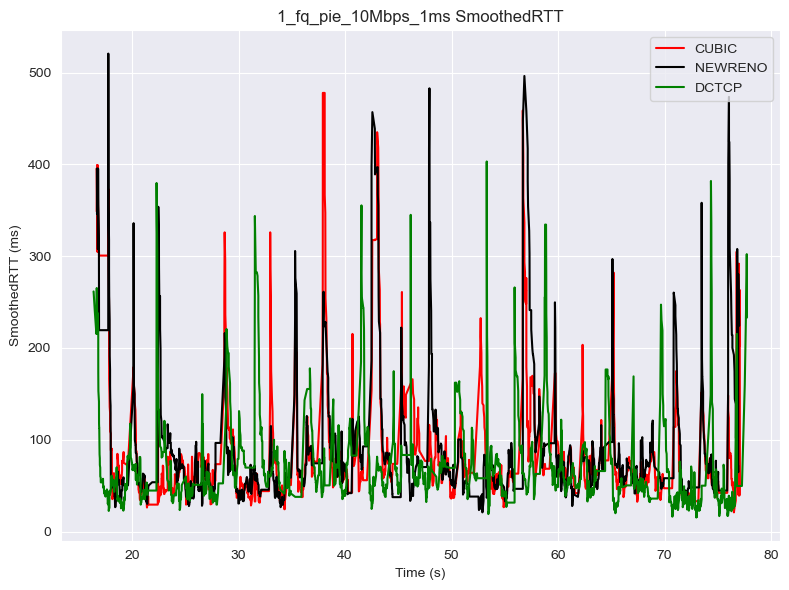

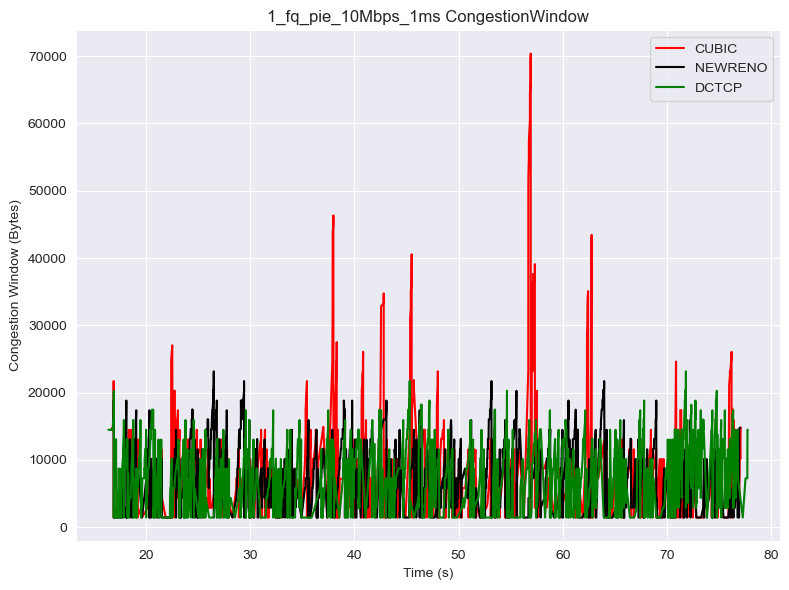


Start New Scenario
1_fq_pie_10Mbps_20ms
./Data./client1_data\1_fq_pie_10Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_10Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_10Mbps_20ms:
Statistics for CUBIC:
Median: 647.5
Mean: 671.4627591537835
25th Percentile: 487.5
75th Percentile: 861.25
Minimum: 393.125
Maximum: 861.25
Statistics for NEWRENO:
Median: 548.125
Mean: 591.3362125313283
25th Percentile: 486.562
75th Percentile: 612.187
Minimum: 390.937
Maximum: 1189.375
Statistics for DCTCP:
Median: 585.312
Mean: 685.2902658836091
25th Percentile: 511.875
75th Percentile: 875.625
Minimum: 243.75
Maximum: 1233.437
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_10Mbps_20ms_rtt_stats.txt



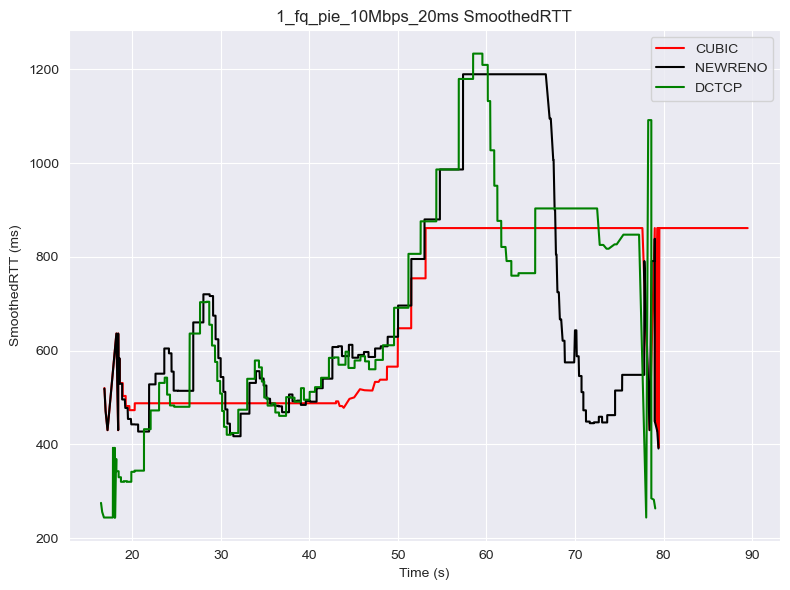

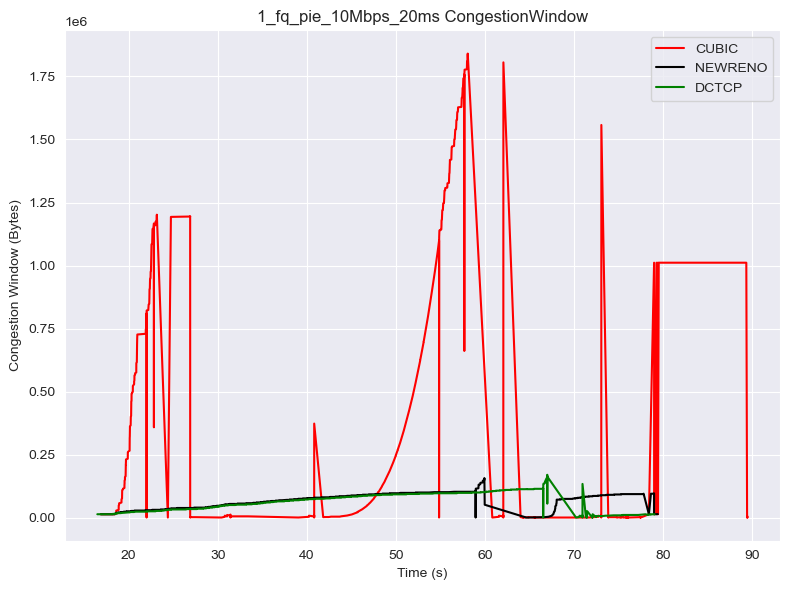


Start New Scenario
1_fq_pie_10Mbps_5ms
./Data./client1_data\1_fq_pie_10Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_10Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_10Mbps_5ms:
Statistics for CUBIC:
Median: 55.312
Mean: 66.86267587872283
25th Percentile: 41.25
75th Percentile: 77.031
Minimum: 13.437
Maximum: 371.562
Statistics for NEWRENO:
Median: 61.875
Mean: 76.41216199872692
25th Percentile: 48.437
75th Percentile: 81.875
Minimum: 22.812
Maximum: 426.562
Statistics for DCTCP:
Median: 54.062
Mean: 67.60266904500548
25th Percentile: 40.625
75th Percentile: 75.625
Minimum: 15.625
Maximum: 475.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_10Mbps_5ms_rtt_stats.txt



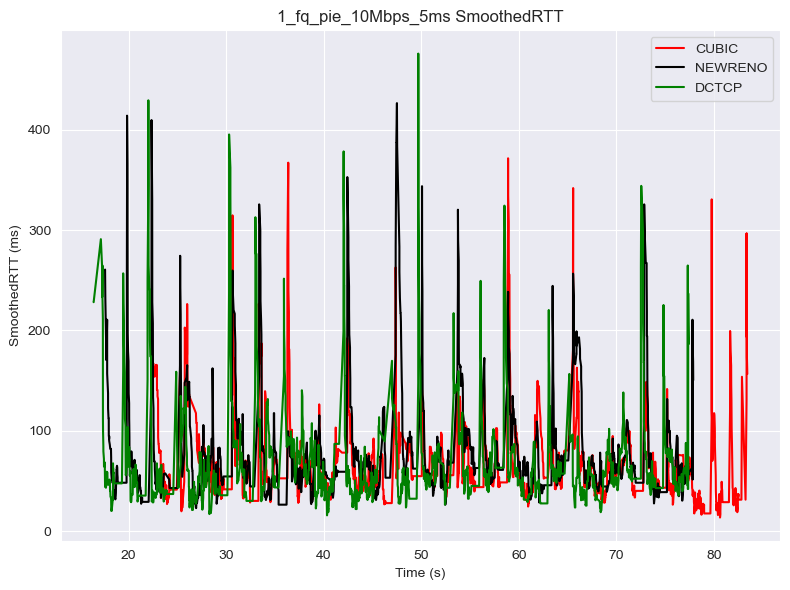

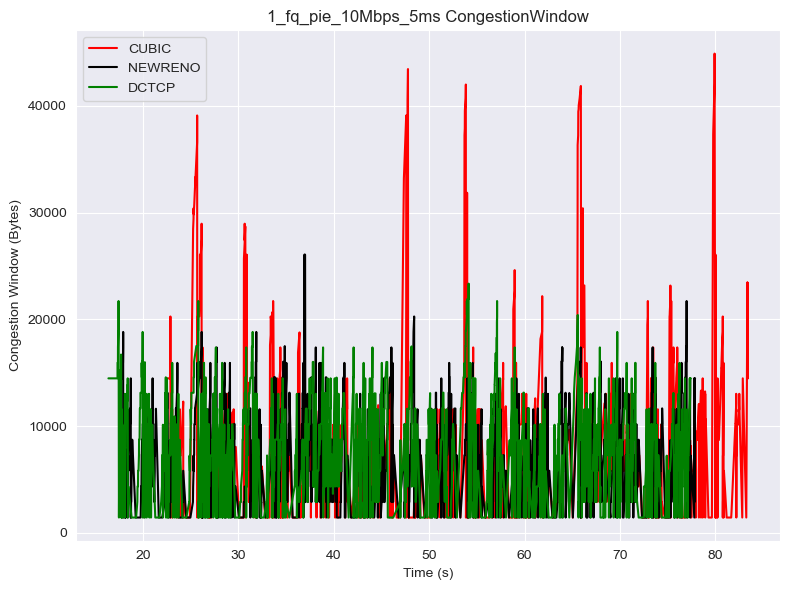


Start New Scenario
1_fq_pie_10Mbps_7ms
./Data./client1_data\1_fq_pie_10Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_10Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_10Mbps_7ms:
Statistics for CUBIC:
Median: 60.937
Mean: 82.13732927553446
25th Percentile: 49.375
75th Percentile: 86.25
Minimum: 17.5
Maximum: 390.625
Statistics for NEWRENO:
Median: 63.437
Mean: 79.6393005952381
25th Percentile: 50.625
75th Percentile: 87.187
Minimum: 22.187
Maximum: 439.687
Statistics for DCTCP:
Median: 58.75
Mean: 73.29168812632857
25th Percentile: 46.562
75th Percentile: 80.625
Minimum: 17.5
Maximum: 530.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_10Mbps_7ms_rtt_stats.txt



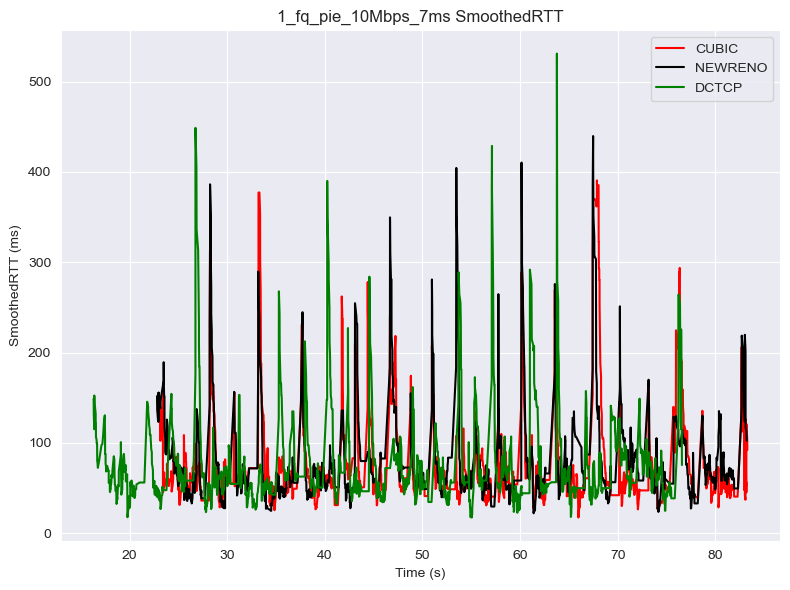

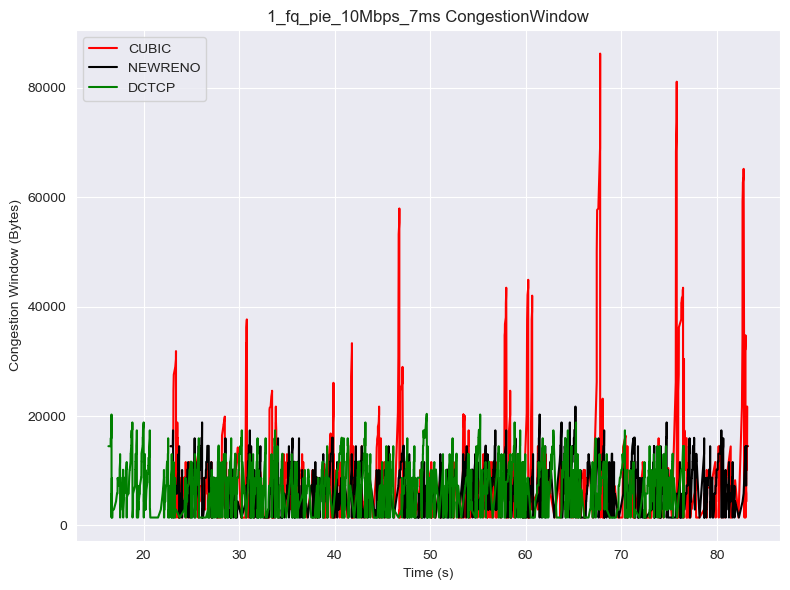


Start New Scenario
1_fq_pie_20Mbps_0ms
./Data./client1_data\1_fq_pie_20Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_20Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_20Mbps_0ms:
Statistics for CUBIC:
Median: 47.187
Mean: 65.65835161290322
25th Percentile: 36.562
75th Percentile: 65.312
Minimum: 15.625
Maximum: 750.0
Statistics for NEWRENO:
Median: 47.5
Mean: 63.5615785077951
25th Percentile: 35.312
75th Percentile: 66.25
Minimum: 13.75
Maximum: 750.0
Statistics for DCTCP:
Median: 43.75
Mean: 57.565598034274196
25th Percentile: 32.812
75th Percentile: 61.875
Minimum: 15.0
Maximum: 443.437
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_20Mbps_0ms_rtt_stats.txt



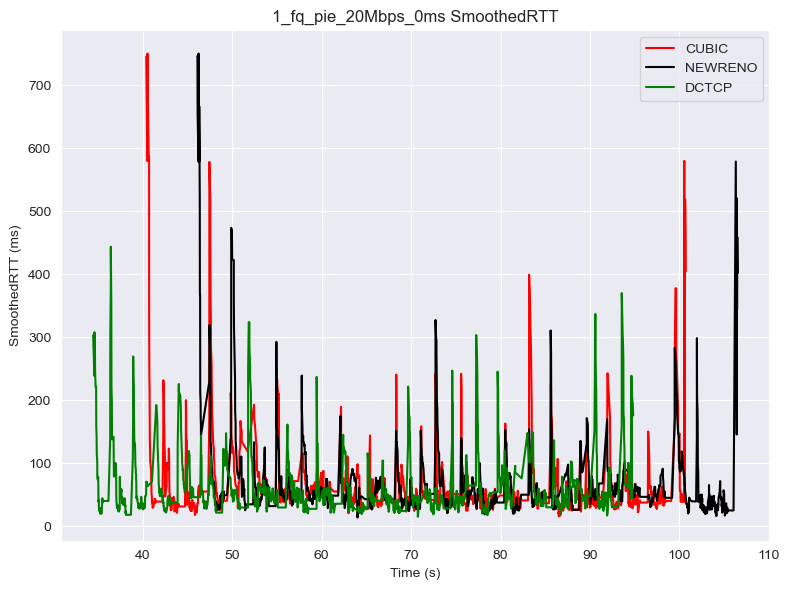

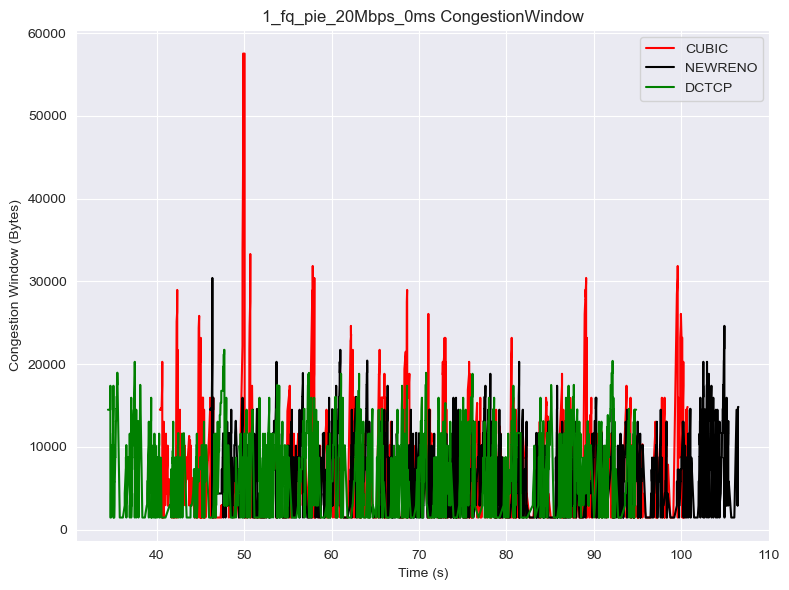


Start New Scenario
1_fq_pie_20Mbps_10ms
./Data./client1_data\1_fq_pie_20Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_20Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_20Mbps_10ms:
Statistics for CUBIC:
Median: 590.937
Mean: 637.6005839017736
25th Percentile: 477.578
75th Percentile: 763.67175
Minimum: 78.125
Maximum: 1615.937
Statistics for NEWRENO:
Median: 531.25
Mean: 523.3060418660286
25th Percentile: 259.53075
75th Percentile: 678.437
Minimum: 68.125
Maximum: 1658.437
Statistics for DCTCP:
Median: 604.062
Mean: 650.0385091790786
25th Percentile: 496.875
75th Percentile: 767.812
Minimum: 72.5
Maximum: 1669.375
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_20Mbps_10ms_rtt_stats.txt



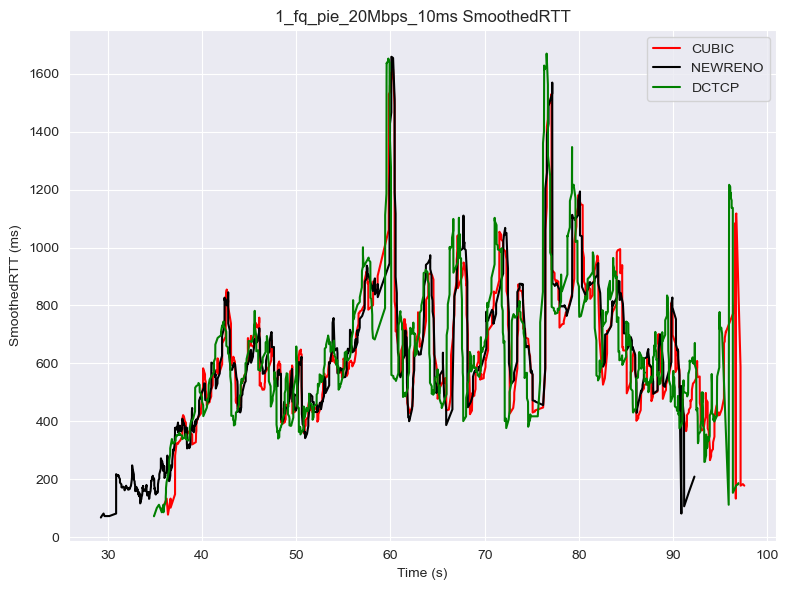

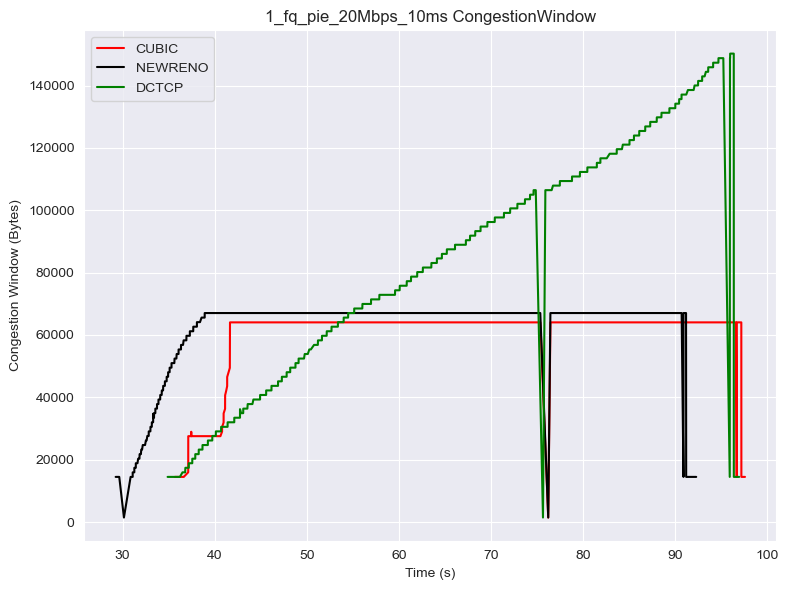


Start New Scenario
1_fq_pie_20Mbps_1ms
./Data./client1_data\1_fq_pie_20Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_20Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_20Mbps_1ms:
Statistics for CUBIC:
Median: 51.562
Mean: 70.03090115136197
25th Percentile: 40.312
75th Percentile: 71.875
Minimum: 20.0
Maximum: 927.812
Statistics for NEWRENO:
Median: 50.937
Mean: 67.37469332493703
25th Percentile: 39.062
75th Percentile: 68.125
Minimum: 14.375
Maximum: 656.562
Statistics for DCTCP:
Median: 45.0
Mean: 60.54769518855656
25th Percentile: 35.625
75th Percentile: 60.312
Minimum: 12.187
Maximum: 564.687
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_20Mbps_1ms_rtt_stats.txt



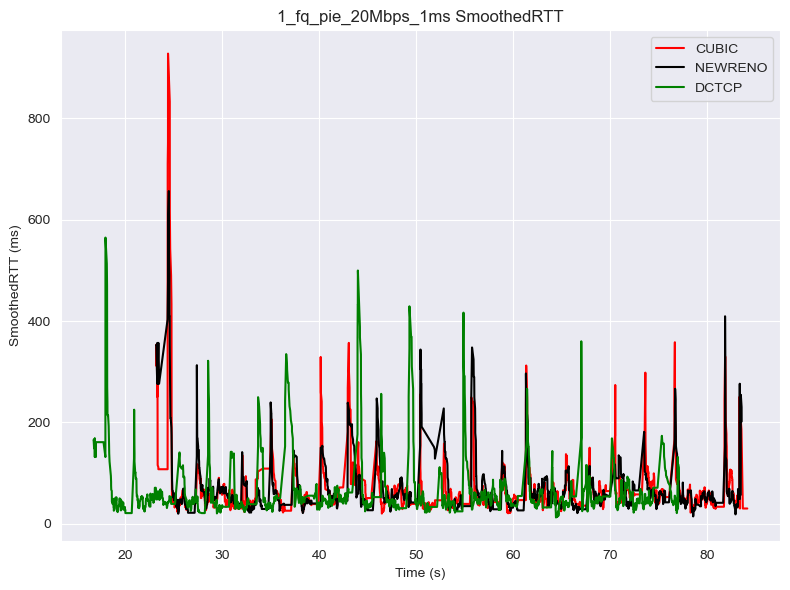

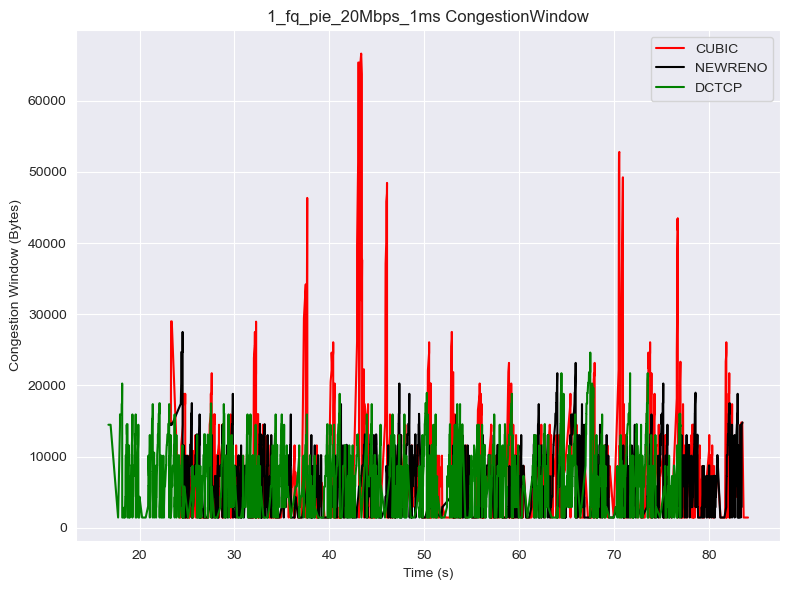


Start New Scenario
1_fq_pie_20Mbps_20ms
./Data./client1_data\1_fq_pie_20Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_20Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_20Mbps_20ms:
Statistics for CUBIC:
Median: 635.0
Mean: 655.8972876076871
25th Percentile: 413.437
75th Percentile: 809.687
Minimum: 182.5
Maximum: 1860.0
Statistics for NEWRENO:
Median: 715.4685
Mean: 750.3964610281923
25th Percentile: 575.85925
75th Percentile: 890.46825
Minimum: 246.562
Maximum: 1905.625
Statistics for DCTCP:
Median: 735.0
Mean: 775.3426613333332
25th Percentile: 586.25
75th Percentile: 945.234
Minimum: 291.875
Maximum: 1923.437
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_20Mbps_20ms_rtt_stats.txt



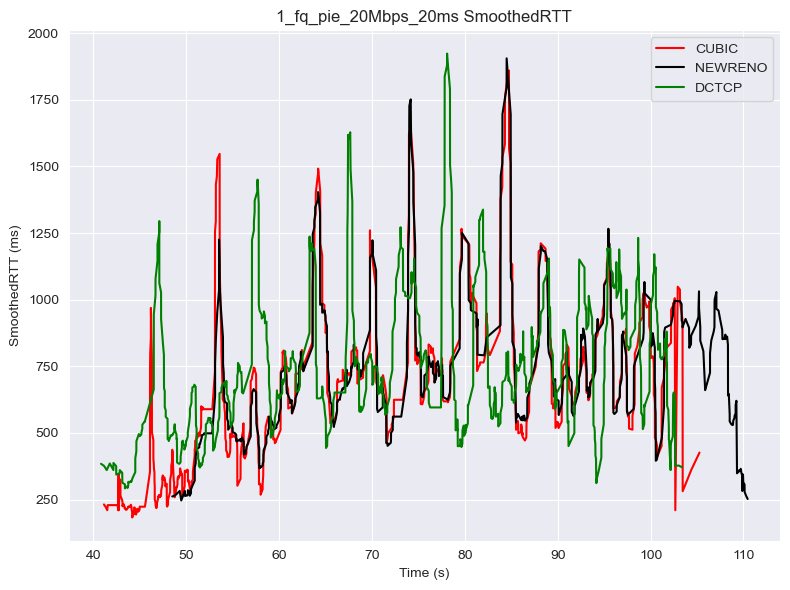

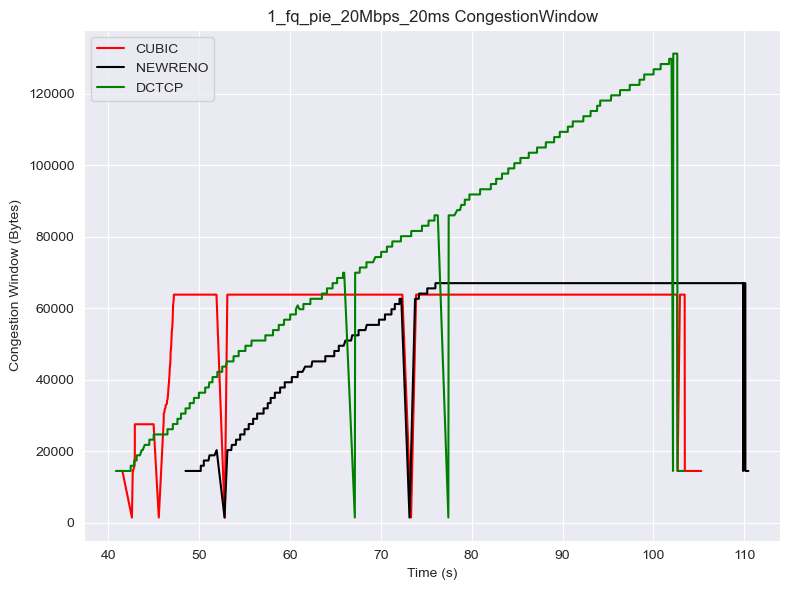


Start New Scenario
1_fq_pie_20Mbps_5ms
./Data./client1_data\1_fq_pie_20Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_20Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_20Mbps_5ms:
Statistics for CUBIC:
Median: 47.812
Mean: 65.93964685501066
25th Percentile: 37.187
75th Percentile: 69.687
Minimum: 15.0
Maximum: 504.687
Statistics for NEWRENO:
Median: 47.812
Mean: 66.26690846338536
25th Percentile: 36.875
75th Percentile: 67.812
Minimum: 17.5
Maximum: 500.937
Statistics for DCTCP:
Median: 42.812
Mean: 61.938345980366144
25th Percentile: 32.187
75th Percentile: 63.125
Minimum: 13.125
Maximum: 641.562
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_20Mbps_5ms_rtt_stats.txt



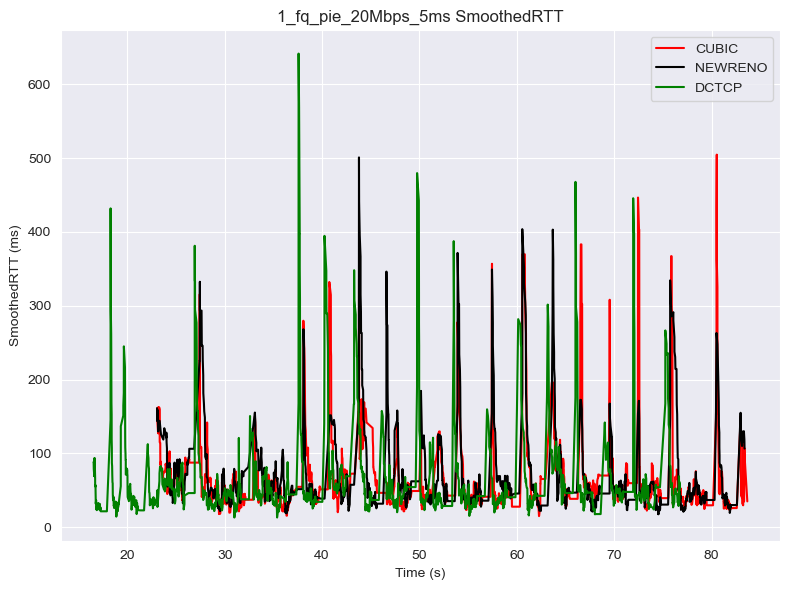

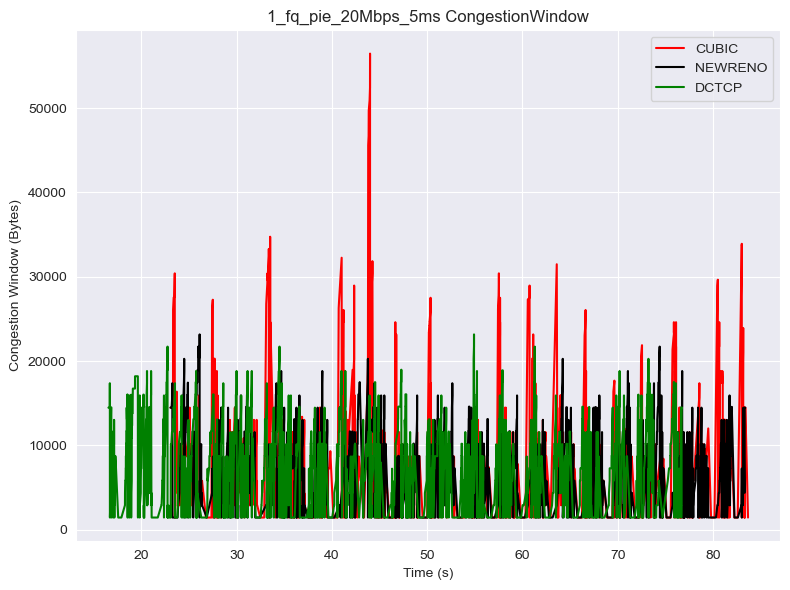


Start New Scenario
1_fq_pie_20Mbps_7ms
./Data./client1_data\1_fq_pie_20Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_20Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_20Mbps_7ms:
Statistics for CUBIC:
Median: 53.437
Mean: 68.36683772056696
25th Percentile: 41.562
75th Percentile: 69.687
Minimum: 13.437
Maximum: 486.875
Statistics for NEWRENO:
Median: 49.687
Mean: 67.71985804701627
25th Percentile: 38.75
75th Percentile: 72.187
Minimum: 14.687
Maximum: 491.25
Statistics for DCTCP:
Median: 47.812
Mean: 63.329936857142854
25th Percentile: 36.875
75th Percentile: 65.937
Minimum: 16.25
Maximum: 466.25
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_20Mbps_7ms_rtt_stats.txt



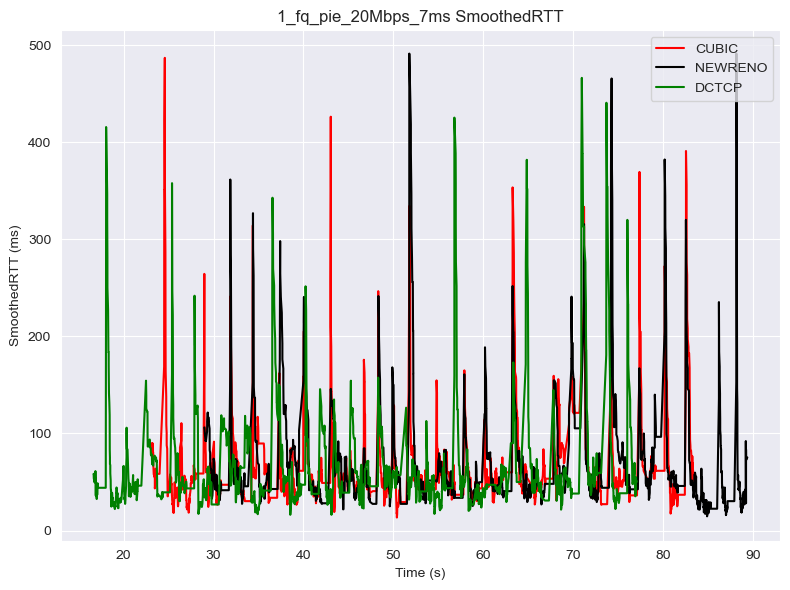

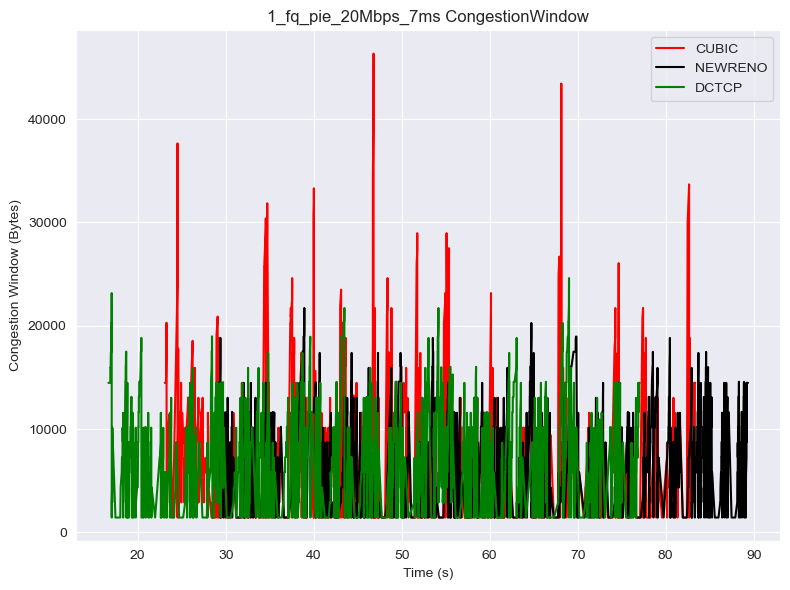


Start New Scenario
1_fq_pie_5Mbps_0ms
./Data./client1_data\1_fq_pie_5Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_5Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_5Mbps_0ms:
Statistics for CUBIC:
Median: 118.281
Mean: 135.3868359040274
25th Percentile: 95.312
75th Percentile: 149.687
Minimum: 34.062
Maximum: 457.812
Statistics for NEWRENO:
Median: 125.312
Mean: 140.9940635129216
25th Percentile: 102.812
75th Percentile: 160.0
Minimum: 43.437
Maximum: 484.375
Statistics for DCTCP:
Median: 121.25
Mean: 133.98607100085545
25th Percentile: 97.187
75th Percentile: 152.187
Minimum: 36.875
Maximum: 550.0
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_5Mbps_0ms_rtt_stats.txt



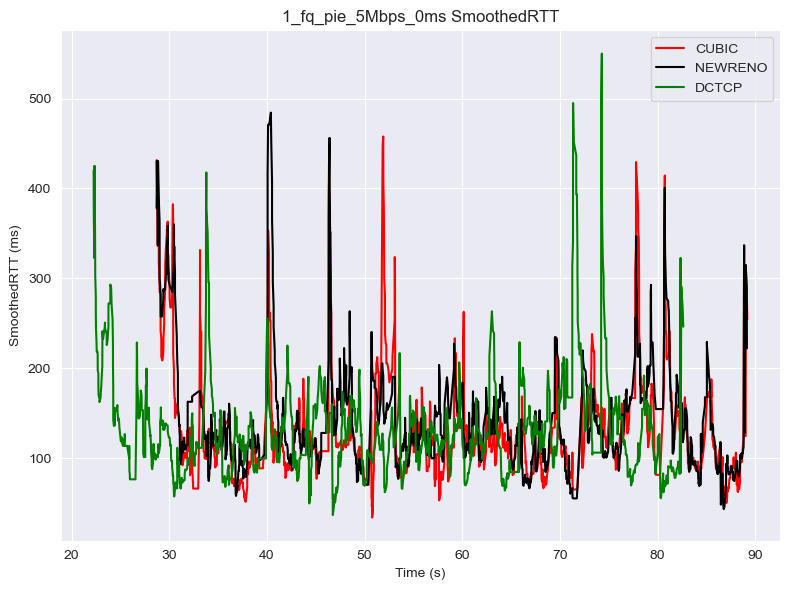

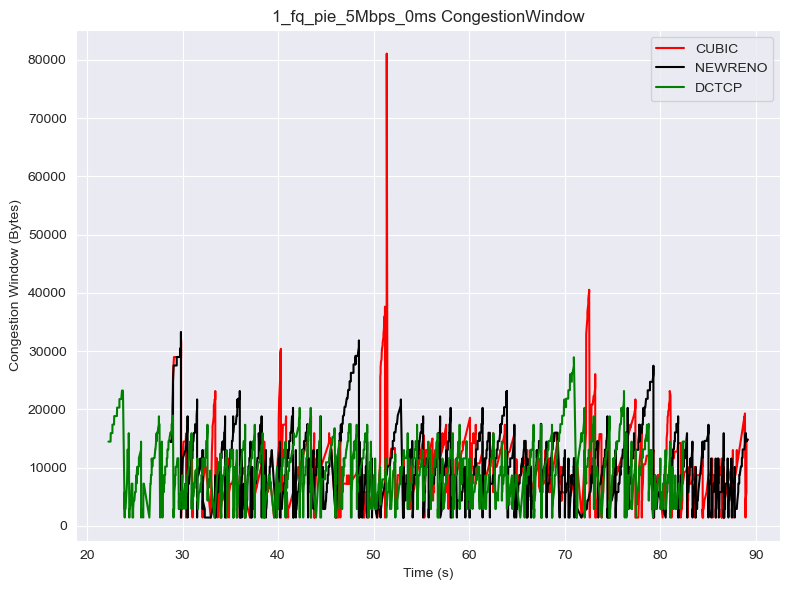


Start New Scenario
1_fq_pie_5Mbps_10ms
./Data./client1_data\1_fq_pie_5Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_5Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_5Mbps_10ms:
Statistics for CUBIC:
Median: 615.937
Mean: 624.4258204625637
25th Percentile: 408.7495
75th Percentile: 815.4685
Minimum: 129.375
Maximum: 1231.875
Statistics for NEWRENO:
Median: 562.812
Mean: 570.1069844504021
25th Percentile: 460.937
75th Percentile: 670.312
Minimum: 123.125
Maximum: 1528.437
Statistics for DCTCP:
Median: 570.781
Mean: 568.5966348788198
25th Percentile: 480.625
75th Percentile: 659.062
Minimum: 174.687
Maximum: 1505.312
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_5Mbps_10ms_rtt_stats.txt



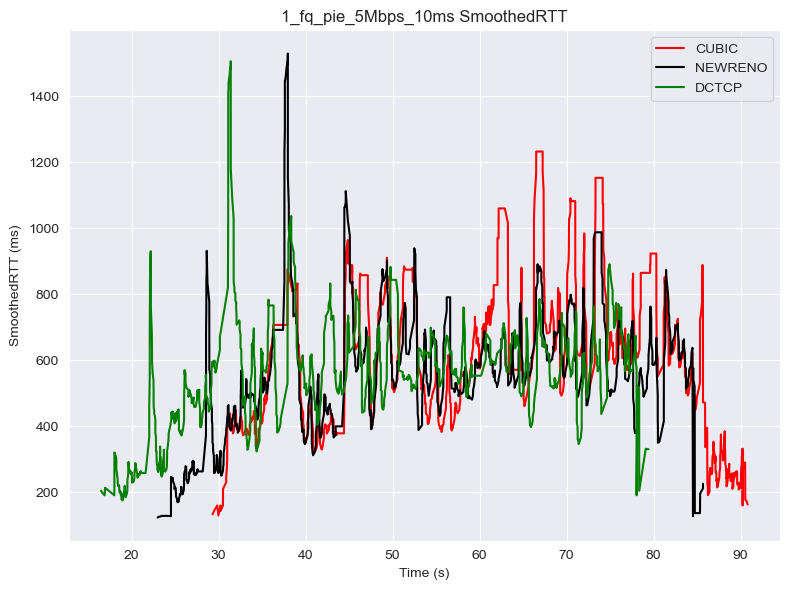

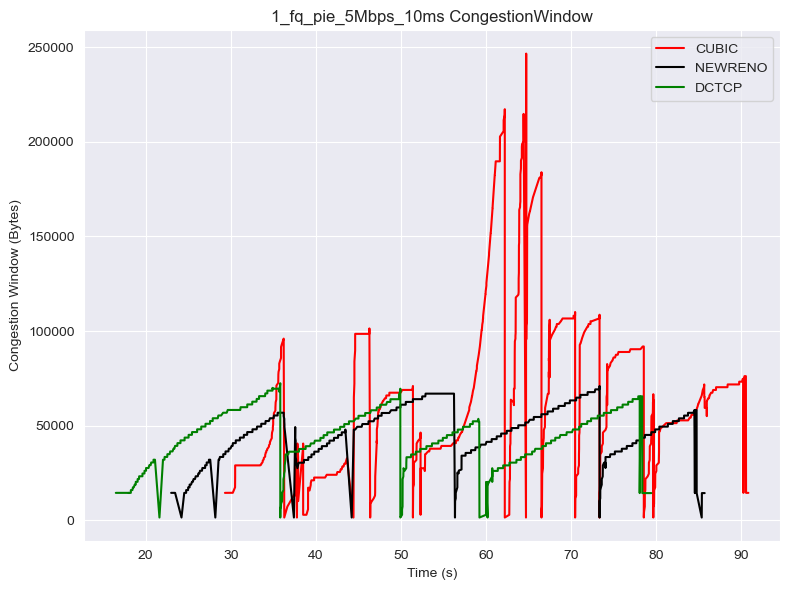


Start New Scenario
1_fq_pie_5Mbps_1ms
./Data./client1_data\1_fq_pie_5Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_5Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_5Mbps_1ms:
Statistics for CUBIC:
Median: 110.937
Mean: 121.15644724770642
25th Percentile: 82.812
75th Percentile: 148.203
Minimum: 23.75
Maximum: 568.125
Statistics for NEWRENO:
Median: 117.187
Mean: 128.34194395410415
25th Percentile: 89.375
75th Percentile: 146.875
Minimum: 48.125
Maximum: 649.687
Statistics for DCTCP:
Median: 112.5
Mean: 126.98750660592258
25th Percentile: 89.8435
75th Percentile: 148.437
Minimum: 43.75
Maximum: 649.375
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_5Mbps_1ms_rtt_stats.txt



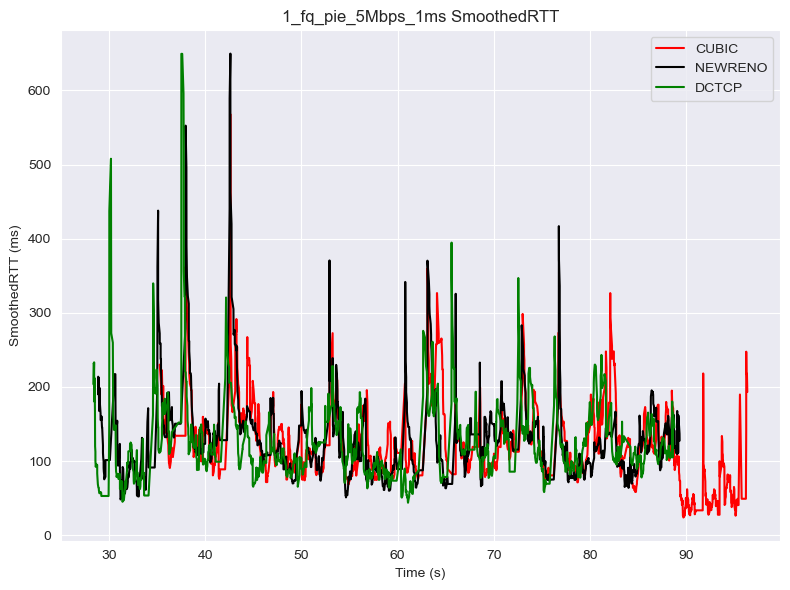

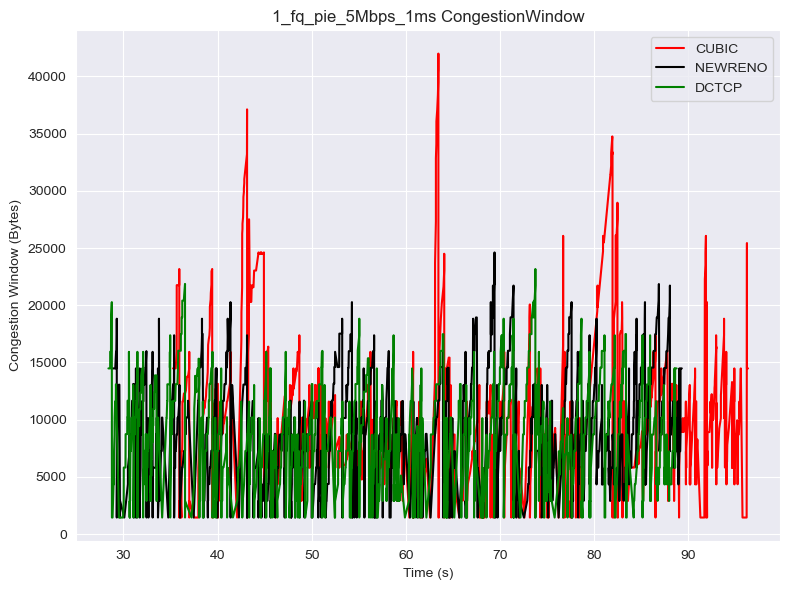


Start New Scenario
1_fq_pie_5Mbps_20ms
./Data./client1_data\1_fq_pie_5Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_5Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_5Mbps_20ms:
Statistics for CUBIC:
Median: 811.25
Mean: 866.1595388026607
25th Percentile: 629.375
75th Percentile: 1026.562
Minimum: 188.437
Maximum: 1840.312
Statistics for NEWRENO:
Median: 680.3125
Mean: 707.4758534183081
25th Percentile: 563.125
75th Percentile: 828.437
Minimum: 191.25
Maximum: 1862.5
Statistics for DCTCP:
Median: 725.156
Mean: 742.7370848115298
25th Percentile: 582.34375
75th Percentile: 885.78125
Minimum: 271.25
Maximum: 1829.062
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_5Mbps_20ms_rtt_stats.txt



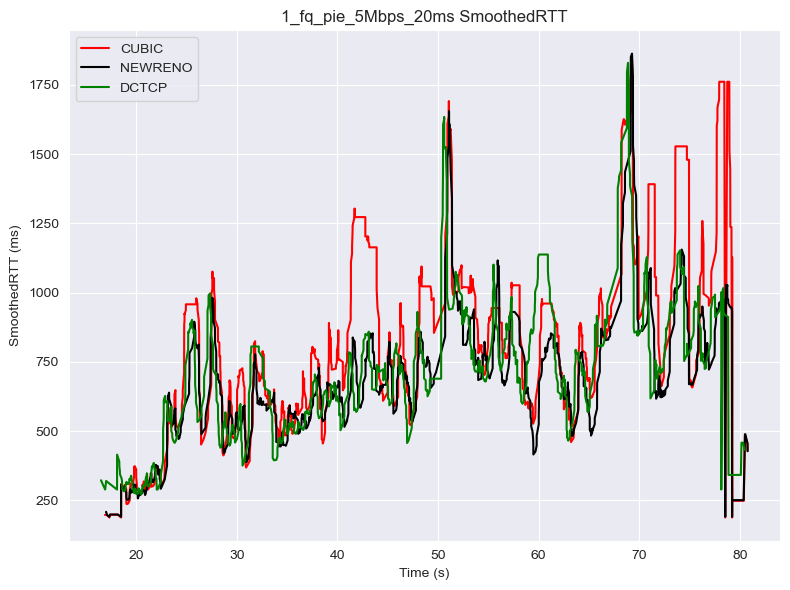

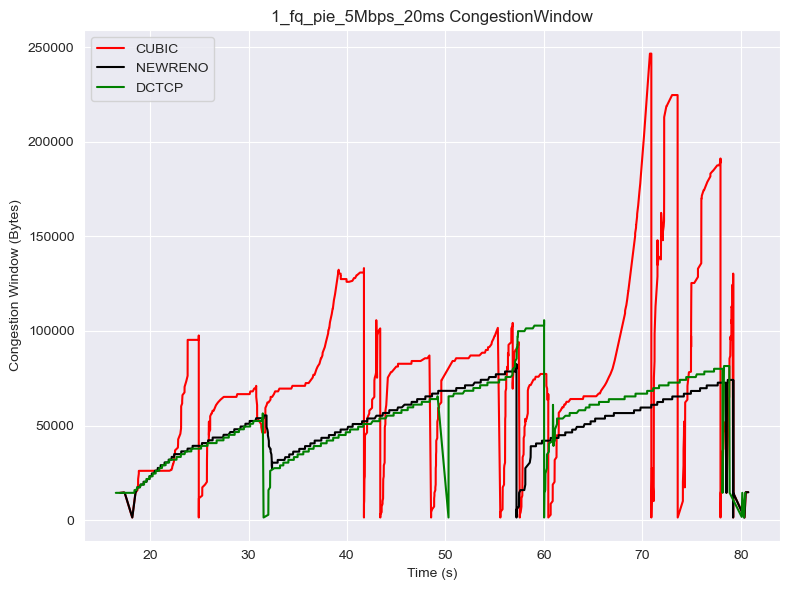


Start New Scenario
1_fq_pie_5Mbps_5ms
./Data./client1_data\1_fq_pie_5Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_5Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_5Mbps_5ms:
Statistics for CUBIC:
Median: 126.406
Mean: 166.29562106768347
25th Percentile: 97.812
75th Percentile: 206.562
Minimum: 32.187
Maximum: 567.5
Statistics for NEWRENO:
Median: 128.437
Mean: 154.5125925110132
25th Percentile: 100.859
75th Percentile: 189.062
Minimum: 53.125
Maximum: 782.812
Statistics for DCTCP:
Median: 122.5
Mean: 152.89679505468376
25th Percentile: 94.375
75th Percentile: 183.906
Minimum: 47.187
Maximum: 736.562
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_5Mbps_5ms_rtt_stats.txt



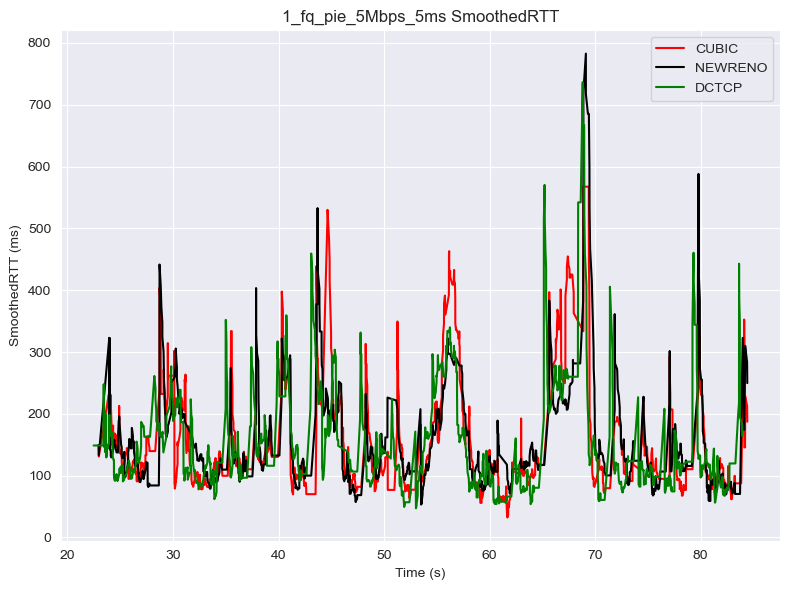

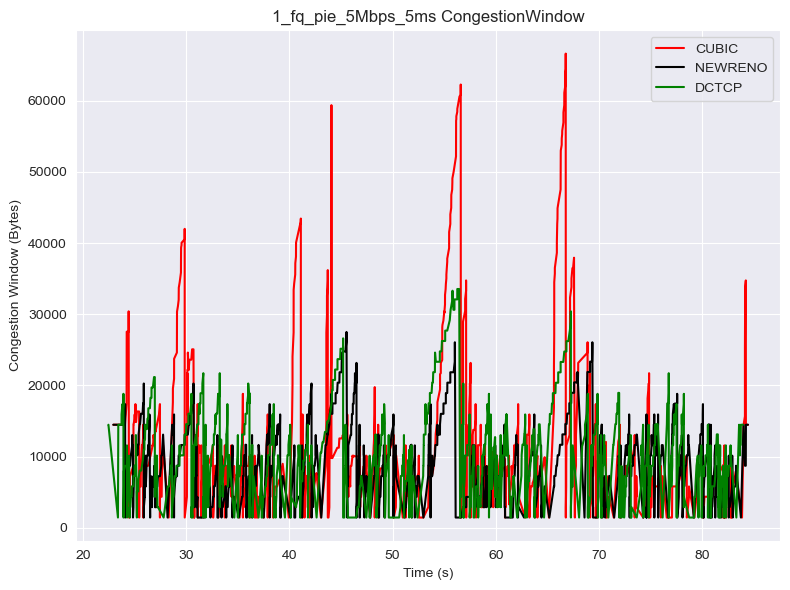


Start New Scenario
1_fq_pie_5Mbps_7ms
./Data./client1_data\1_fq_pie_5Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_5Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_5Mbps_7ms:
Statistics for CUBIC:
Median: 118.125
Mean: 157.07948506224068
25th Percentile: 88.75
75th Percentile: 183.125
Minimum: 23.75
Maximum: 628.75
Statistics for NEWRENO:
Median: 125.937
Mean: 152.62615164123903
25th Percentile: 99.062
75th Percentile: 173.125
Minimum: 56.875
Maximum: 743.75
Statistics for DCTCP:
Median: 106.25
Mean: 129.2636158913133
25th Percentile: 82.5
75th Percentile: 140.0
Minimum: 32.5
Maximum: 878.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_5Mbps_7ms_rtt_stats.txt



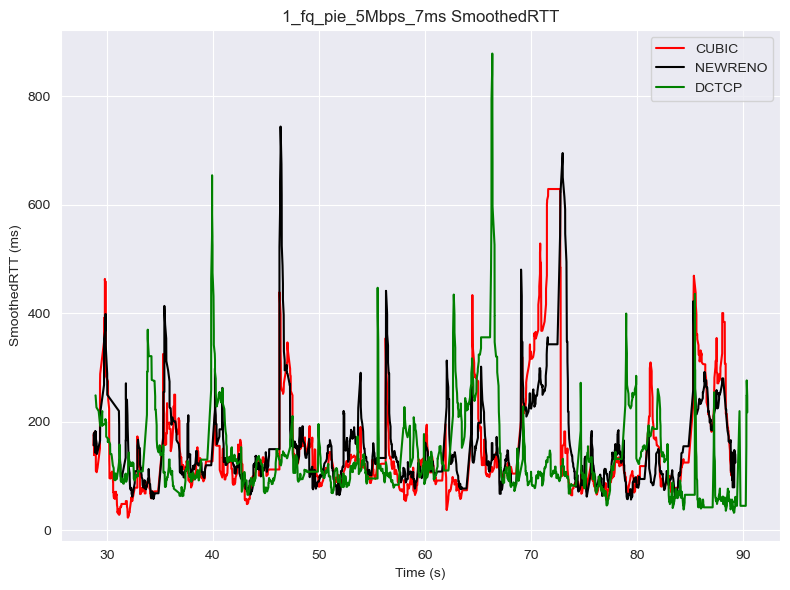

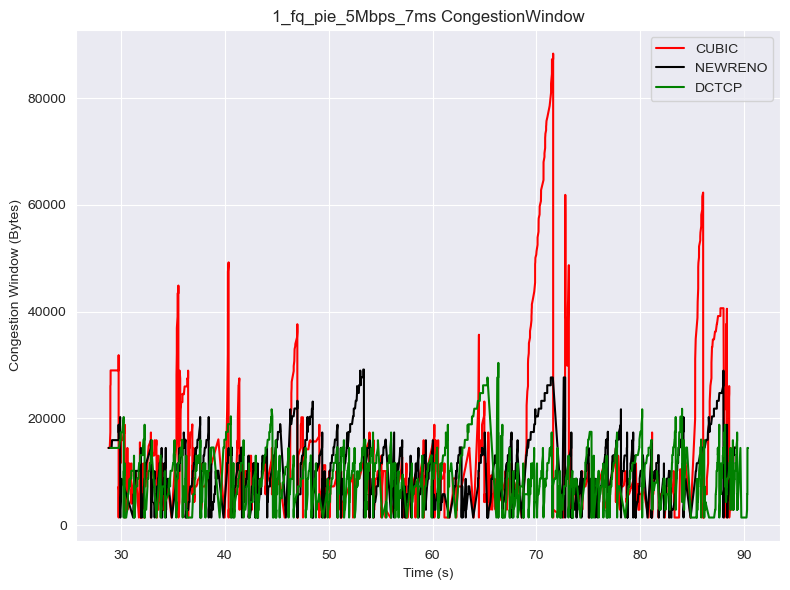


Start New Scenario
1_fq_pie_8Mbps_0ms
./Data./client1_data\1_fq_pie_8Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_8Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_8Mbps_0ms:
Statistics for CUBIC:
Median: 68.437
Mean: 85.51205724953329
25th Percentile: 52.187
75th Percentile: 96.25
Minimum: 15.625
Maximum: 461.25
Statistics for NEWRENO:
Median: 72.5
Mean: 89.24095522910109
25th Percentile: 56.875
75th Percentile: 96.406
Minimum: 24.375
Maximum: 536.875
Statistics for DCTCP:
Median: 64.687
Mean: 79.42440719114936
25th Percentile: 48.828
75th Percentile: 86.562
Minimum: 20.312
Maximum: 721.562
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_8Mbps_0ms_rtt_stats.txt



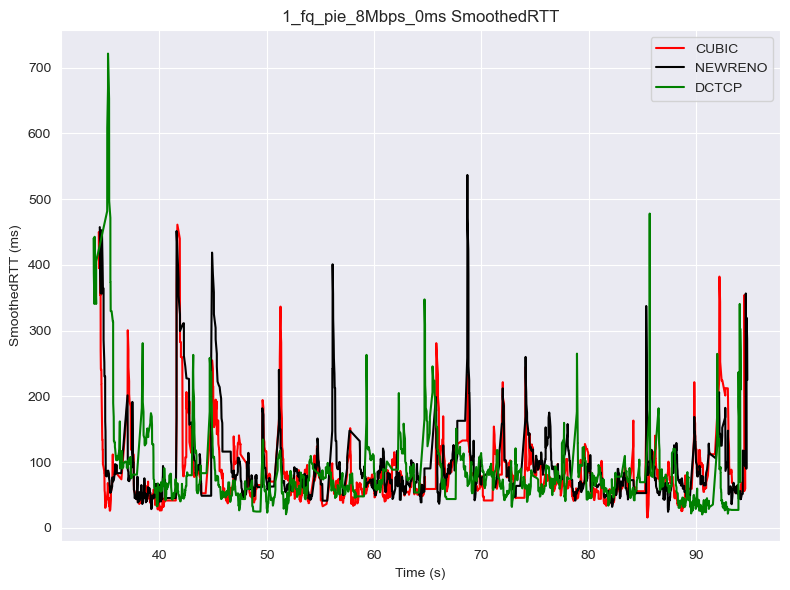

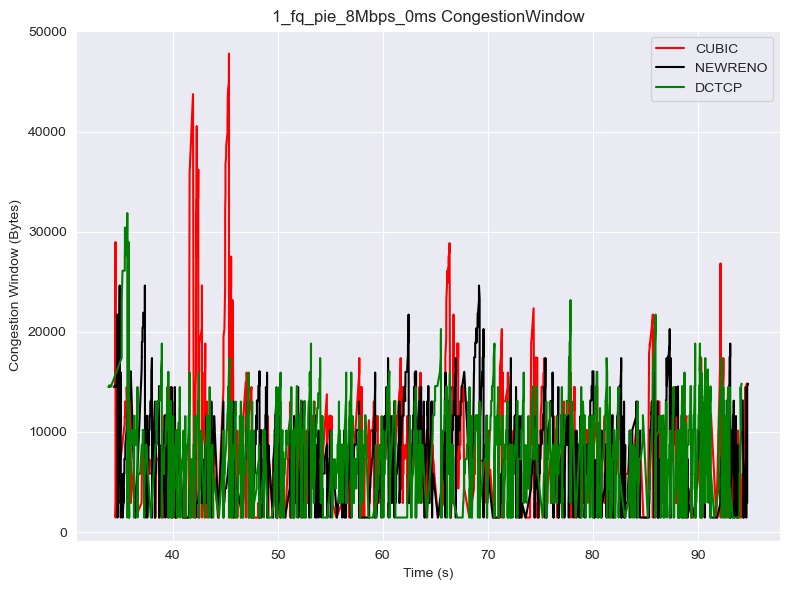


Start New Scenario
1_fq_pie_8Mbps_10ms
./Data./client1_data\1_fq_pie_8Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_8Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_8Mbps_10ms:
Statistics for CUBIC:
Median: 1090.625
Mean: 1152.7150056369783
25th Percentile: 640.625
75th Percentile: 1605.937
Minimum: 85.937
Maximum: 2682.812
Statistics for NEWRENO:
Median: 936.25
Mean: 993.2634234777838
25th Percentile: 588.4375
75th Percentile: 1294.062
Minimum: 85.937
Maximum: 2487.812
Statistics for DCTCP:
Median: 828.125
Mean: 872.3776931886678
25th Percentile: 409.9995
75th Percentile: 1094.2185
Minimum: 114.375
Maximum: 2515.0
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_8Mbps_10ms_rtt_stats.txt



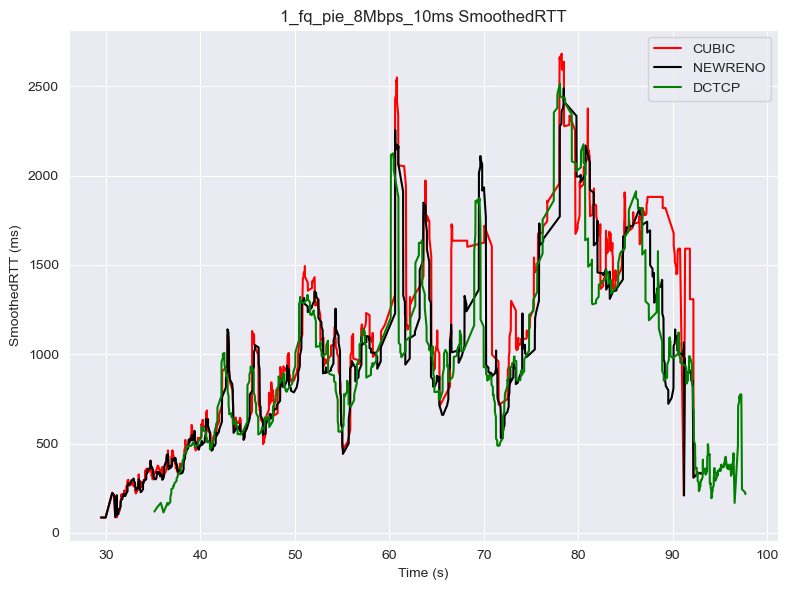

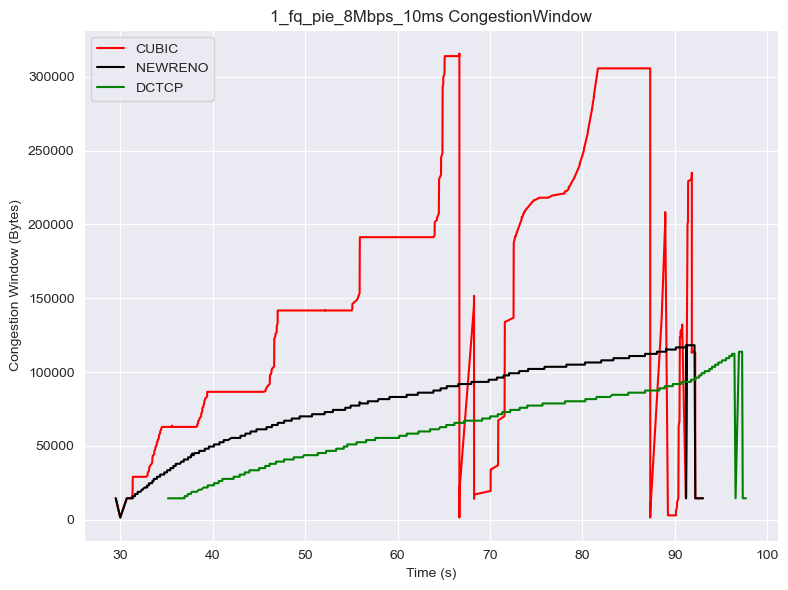


Start New Scenario
1_fq_pie_8Mbps_1ms
./Data./client1_data\1_fq_pie_8Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_8Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_8Mbps_1ms:
Statistics for CUBIC:
Median: 76.875
Mean: 97.22022510181414
25th Percentile: 58.75
75th Percentile: 109.062
Minimum: 25.625
Maximum: 475.937
Statistics for NEWRENO:
Median: 74.687
Mean: 88.88082169332813
25th Percentile: 58.125
75th Percentile: 100.0
Minimum: 27.5
Maximum: 444.687
Statistics for DCTCP:
Median: 73.75
Mean: 89.93217015242821
25th Percentile: 53.125
75th Percentile: 99.687
Minimum: 18.75
Maximum: 512.5
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_8Mbps_1ms_rtt_stats.txt



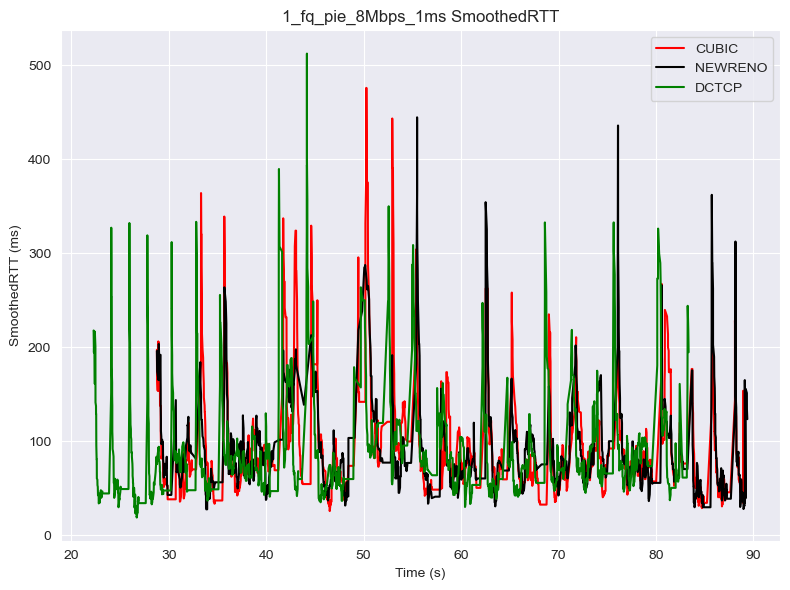

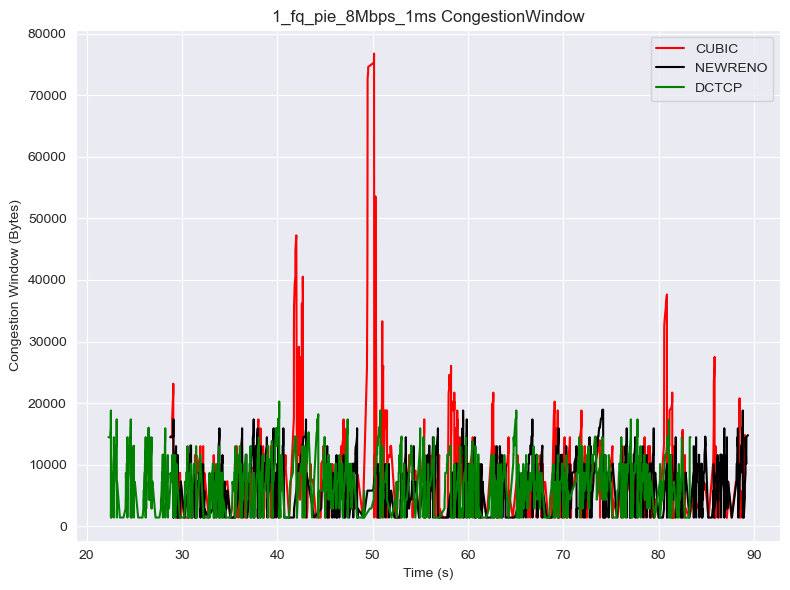


Start New Scenario
1_fq_pie_8Mbps_20ms
./Data./client1_data\1_fq_pie_8Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_8Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_8Mbps_20ms:
Statistics for CUBIC:
Median: 1032.812
Mean: 1042.744333956969
25th Percentile: 754.062
75th Percentile: 1240.156
Minimum: 237.812
Maximum: 2630.0
Statistics for NEWRENO:
Median: 891.875
Mean: 943.1183788791108
25th Percentile: 636.25
75th Percentile: 1187.656
Minimum: 262.187
Maximum: 2328.125
Statistics for DCTCP:
Median: 902.5
Mean: 900.012818290496
25th Percentile: 533.437
75th Percentile: 1174.687
Minimum: 300.312
Maximum: 2323.75
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_8Mbps_20ms_rtt_stats.txt



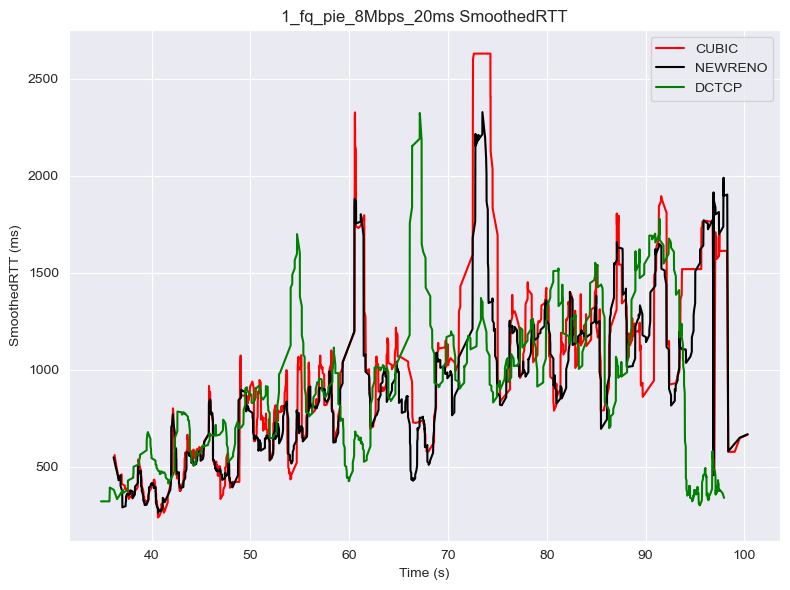

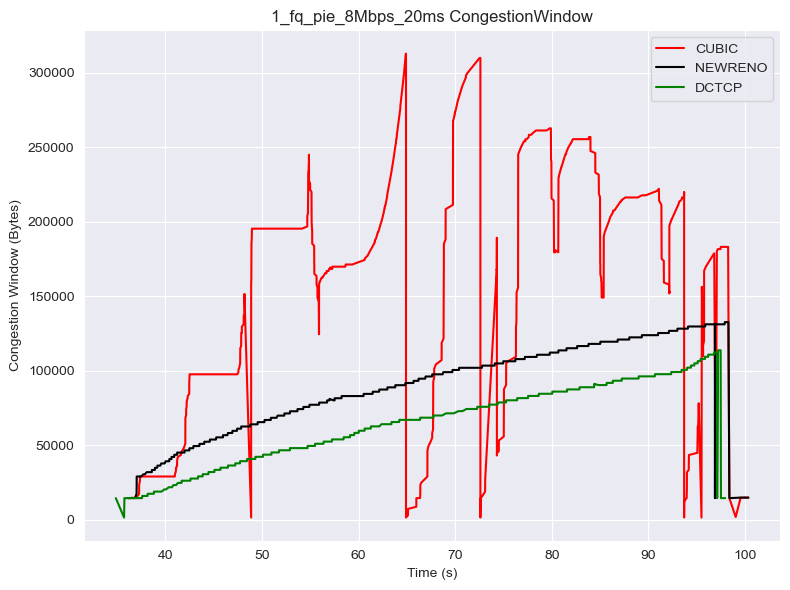


Start New Scenario
1_fq_pie_8Mbps_5ms
./Data./client1_data\1_fq_pie_8Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_8Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_8Mbps_5ms:
Statistics for CUBIC:
Median: 76.562
Mean: 97.00845454545454
25th Percentile: 58.983999999999995
75th Percentile: 107.812
Minimum: 28.75
Maximum: 560.0
Statistics for NEWRENO:
Median: 74.687
Mean: 92.37844112967383
25th Percentile: 60.937
75th Percentile: 99.062
Minimum: 30.625
Maximum: 602.5
Statistics for DCTCP:
Median: 68.75
Mean: 88.28471681711801
25th Percentile: 53.125
75th Percentile: 98.125
Minimum: 22.187
Maximum: 640.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_8Mbps_5ms_rtt_stats.txt



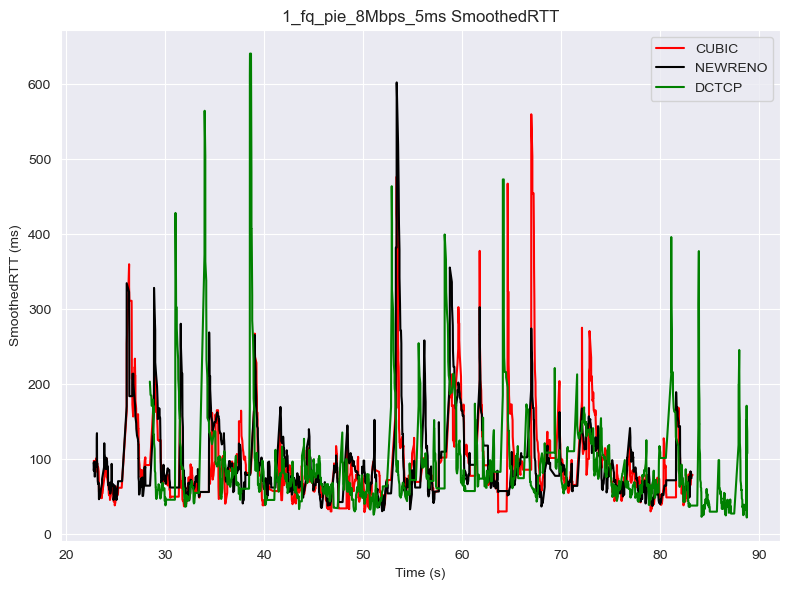

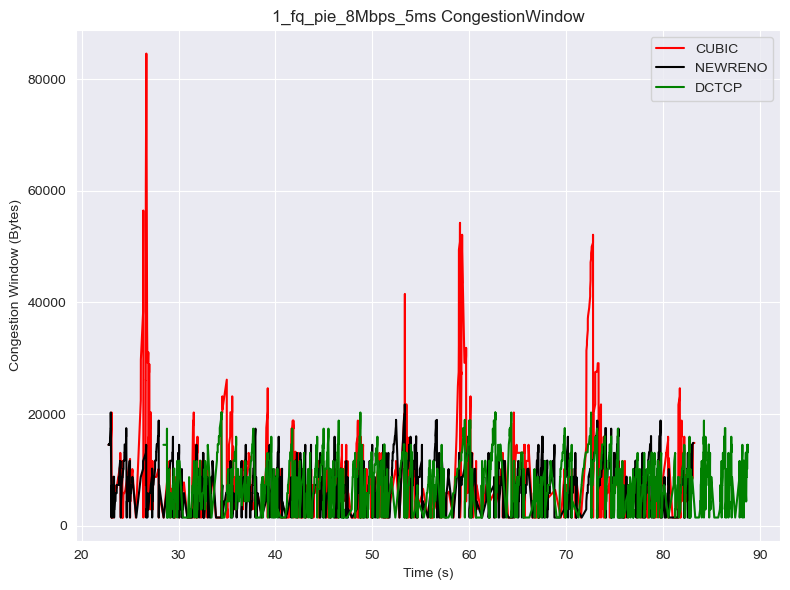


Start New Scenario
1_fq_pie_8Mbps_7ms
./Data./client1_data\1_fq_pie_8Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_fq_pie_8Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_fq_pie_8Mbps_7ms:
Statistics for CUBIC:
Median: 77.812
Mean: 89.76676786389415
25th Percentile: 60.937
75th Percentile: 101.562
Minimum: 23.125
Maximum: 498.125
Statistics for NEWRENO:
Median: 72.5
Mean: 88.64055863983344
25th Percentile: 54.375
75th Percentile: 99.687
Minimum: 29.375
Maximum: 475.625
Statistics for DCTCP:
Median: 72.812
Mean: 89.92067117437722
25th Percentile: 56.875
75th Percentile: 98.437
Minimum: 25.312
Maximum: 643.75
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_fq_pie_8Mbps_7ms_rtt_stats.txt



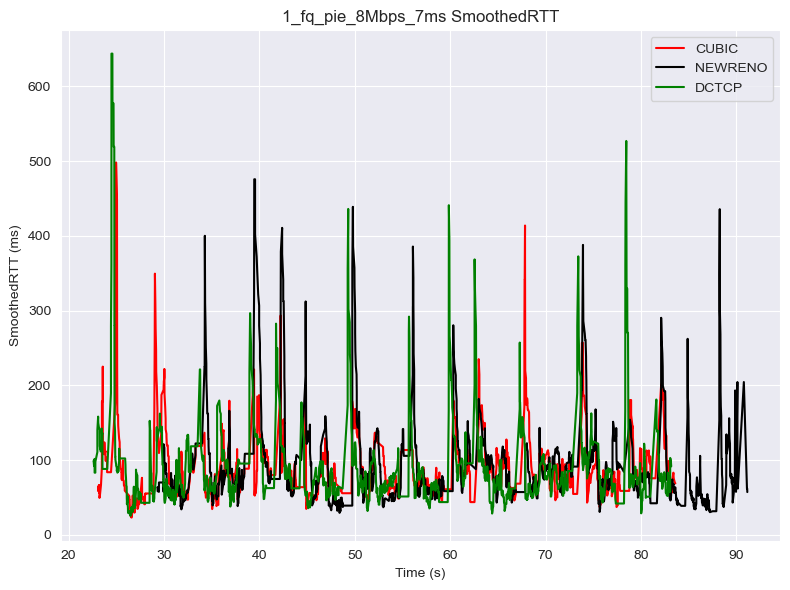

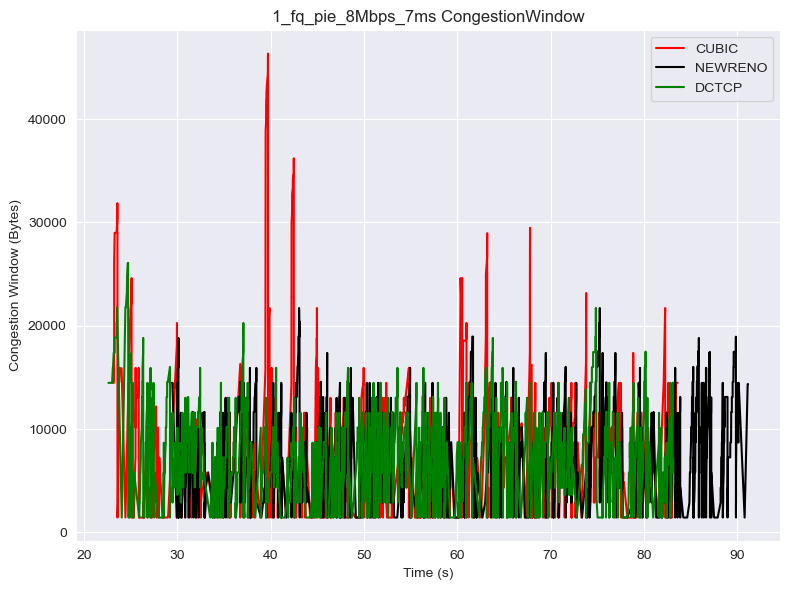


Start New Scenario
1_l4s_10Mbps_0ms
./Data./client1_data\1_l4s_10Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_10Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_10Mbps_0ms:
Statistics for CUBIC:
Median: 85.0
Mean: 111.36189187024428
25th Percentile: 65.625
75th Percentile: 117.5
Minimum: 20.0
Maximum: 879.375
Statistics for NEWRENO:
Median: 86.875
Mean: 106.3593610871441
25th Percentile: 65.703
75th Percentile: 115.625
Minimum: 20.0
Maximum: 529.687
Statistics for DCTCP:
Median: 63.75
Mean: 75.49593946863872
25th Percentile: 47.5
75th Percentile: 88.125
Minimum: 17.5
Maximum: 340.0
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_10Mbps_0ms_rtt_stats.txt



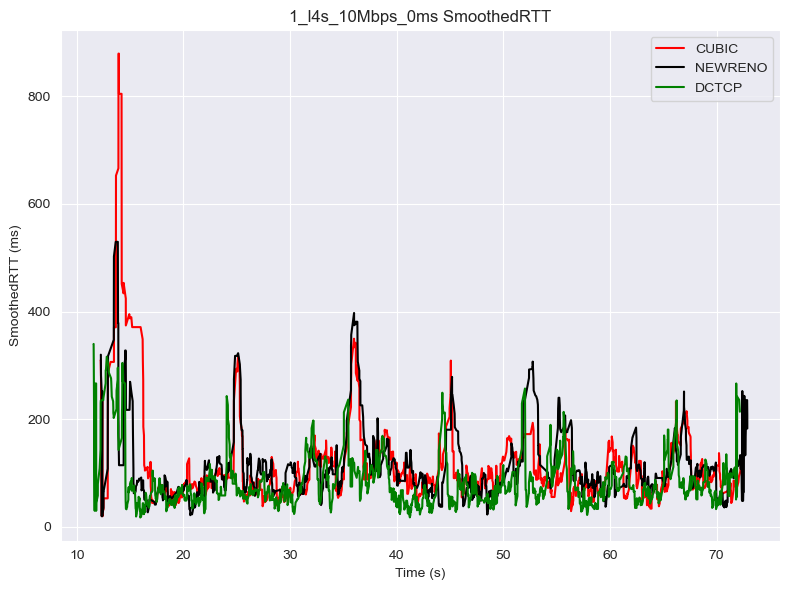

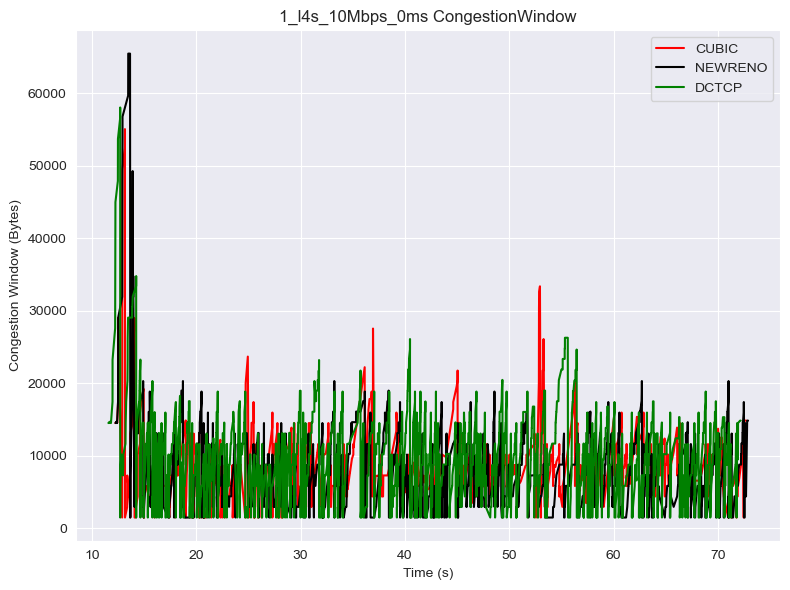


Start New Scenario
1_l4s_10Mbps_10ms
./Data./client1_data\1_l4s_10Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_10Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_10Mbps_10ms:
Statistics for CUBIC:
Median: 1137.812
Mean: 1145.341605591748
25th Percentile: 913.59325
75th Percentile: 1382.812
Minimum: 62.812
Maximum: 2127.187
Statistics for NEWRENO:
Median: 1103.125
Mean: 1070.0288558803536
25th Percentile: 782.9685
75th Percentile: 1307.656
Minimum: 61.562
Maximum: 2116.562
Statistics for DCTCP:
Median: 1000.156
Mean: 975.6318560606059
25th Percentile: 724.062
75th Percentile: 1216.01525
Minimum: 81.875
Maximum: 2063.437
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_10Mbps_10ms_rtt_stats.txt



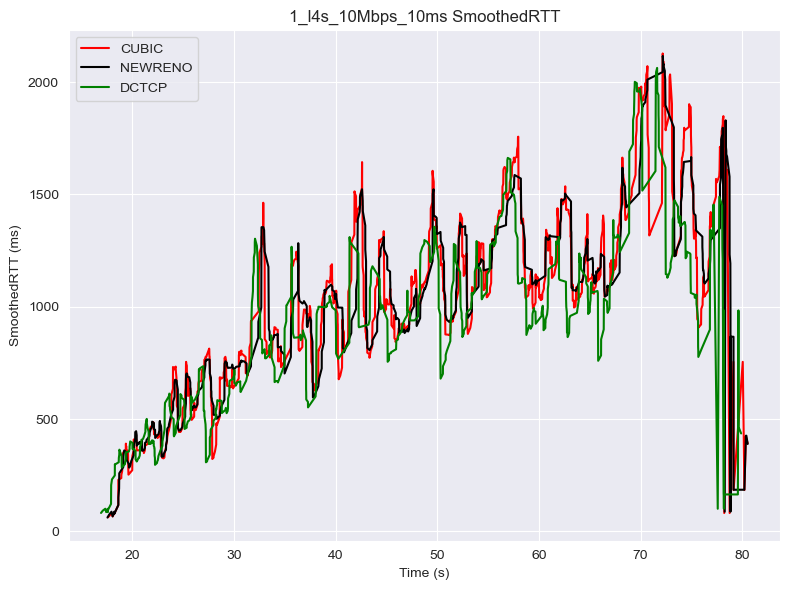

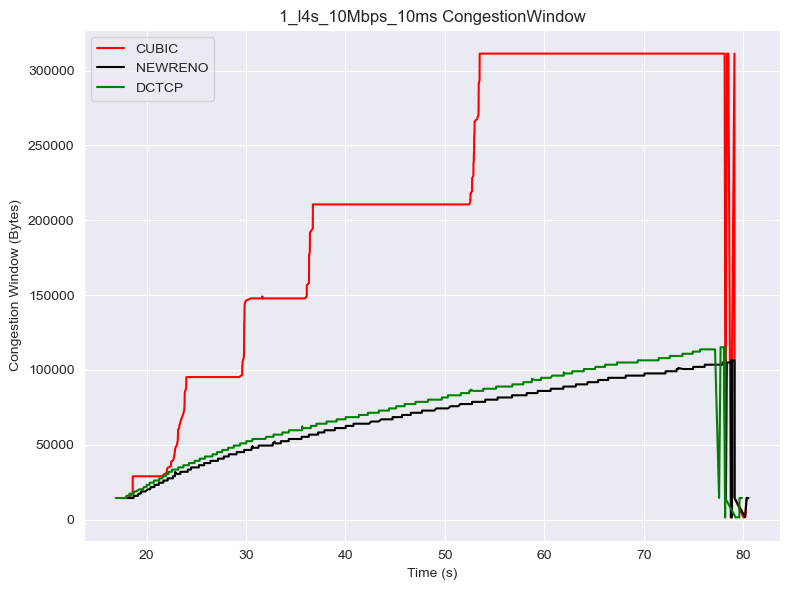


Start New Scenario
1_l4s_10Mbps_1ms
./Data./client1_data\1_l4s_10Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_10Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_10Mbps_1ms:
Statistics for CUBIC:
Median: 81.25
Mean: 90.49261410635155
25th Percentile: 60.0
75th Percentile: 108.125
Minimum: 23.75
Maximum: 403.125
Statistics for NEWRENO:
Median: 88.437
Mean: 98.11610682865522
25th Percentile: 70.0
75th Percentile: 114.375
Minimum: 24.375
Maximum: 361.562
Statistics for DCTCP:
Median: 64.687
Mean: 70.50195002730749
25th Percentile: 48.125
75th Percentile: 83.984
Minimum: 18.125
Maximum: 265.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_10Mbps_1ms_rtt_stats.txt



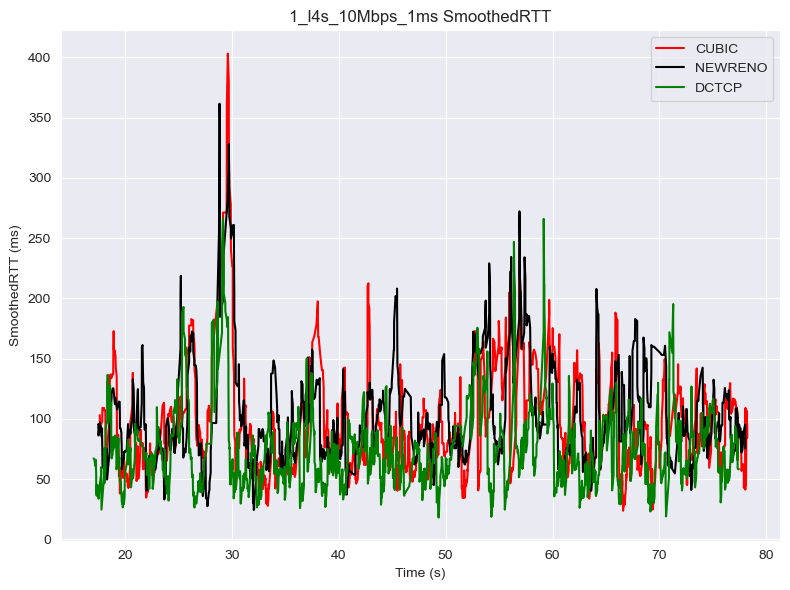

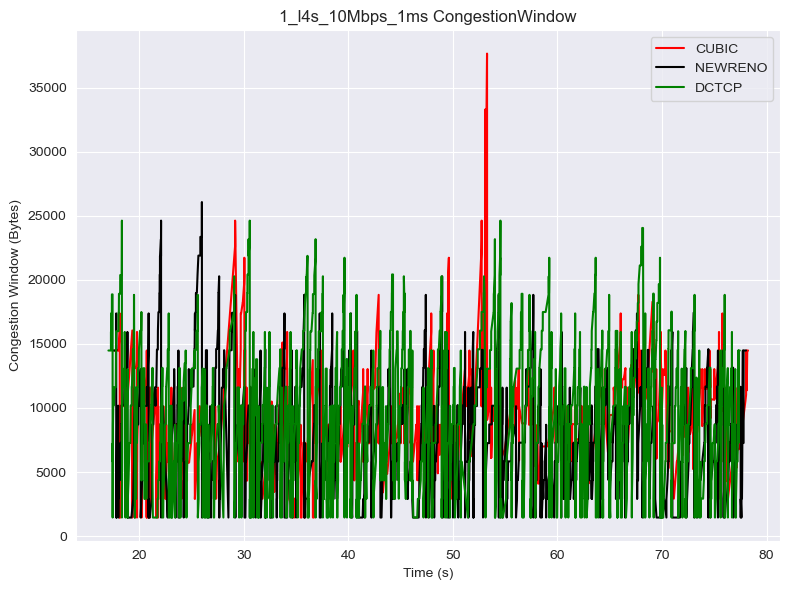


Start New Scenario
1_l4s_10Mbps_20ms
./Data./client1_data\1_l4s_10Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_10Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_10Mbps_20ms:
Statistics for CUBIC:
Median: 1135.0
Mean: 1207.1369392912975
25th Percentile: 908.125
75th Percentile: 1416.17175
Minimum: 380.625
Maximum: 2668.437
Statistics for NEWRENO:
Median: 1062.4995
Mean: 1110.033831060606
25th Percentile: 823.75
75th Percentile: 1322.34375
Minimum: 419.062
Maximum: 2675.625
Statistics for DCTCP:
Median: 935.0
Mean: 988.6119589457679
25th Percentile: 745.625
75th Percentile: 1156.25
Minimum: 314.687
Maximum: 2294.687
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_10Mbps_20ms_rtt_stats.txt



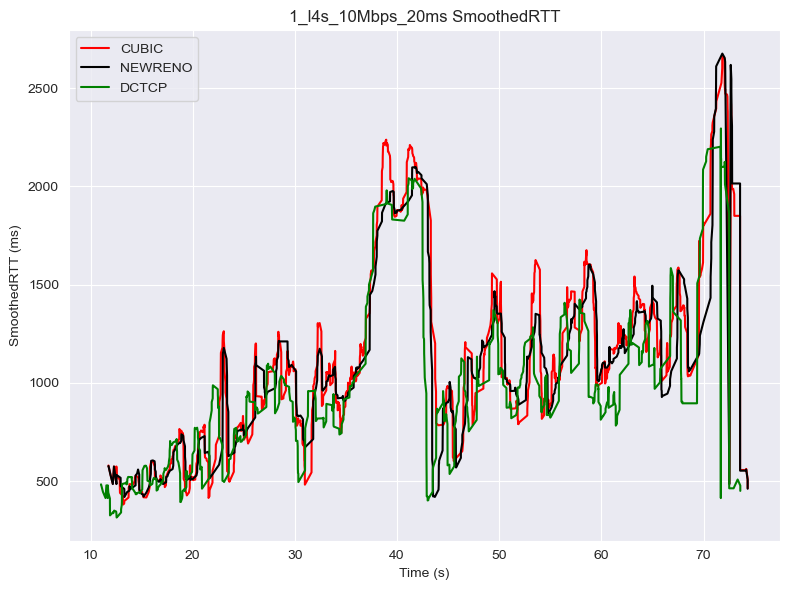

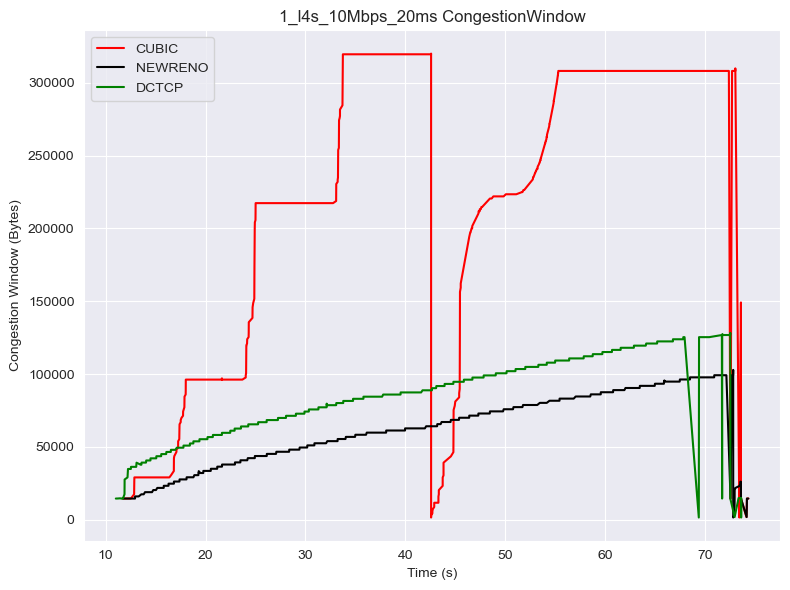


Start New Scenario
1_l4s_10Mbps_5ms
./Data./client1_data\1_l4s_10Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_10Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_10Mbps_5ms:
Statistics for CUBIC:
Median: 81.25
Mean: 86.8861829753381
25th Percentile: 62.187
75th Percentile: 107.187
Minimum: 26.562
Maximum: 220.937
Statistics for NEWRENO:
Median: 77.5
Mean: 83.94492310356772
25th Percentile: 51.562
75th Percentile: 108.75
Minimum: 18.125
Maximum: 274.062
Statistics for DCTCP:
Median: 68.75
Mean: 72.53367455963037
25th Percentile: 54.062
75th Percentile: 88.125
Minimum: 19.687
Maximum: 233.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_10Mbps_5ms_rtt_stats.txt



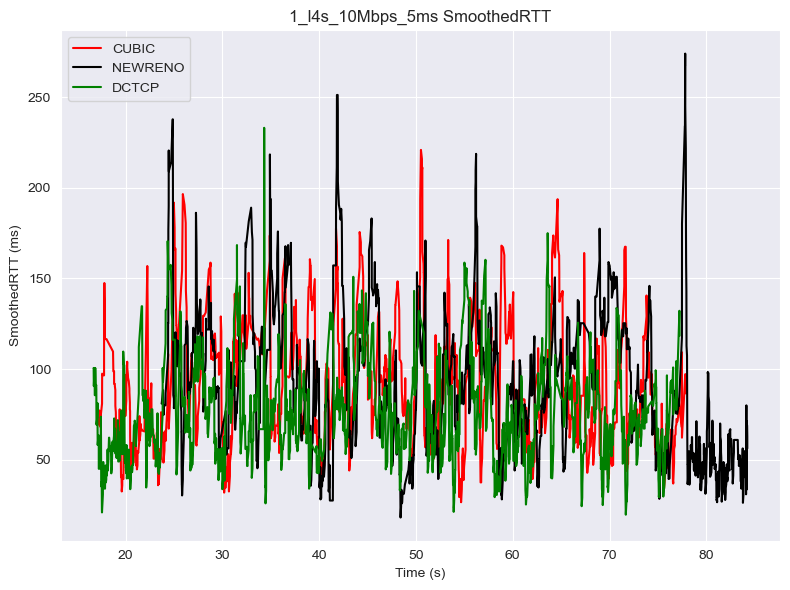

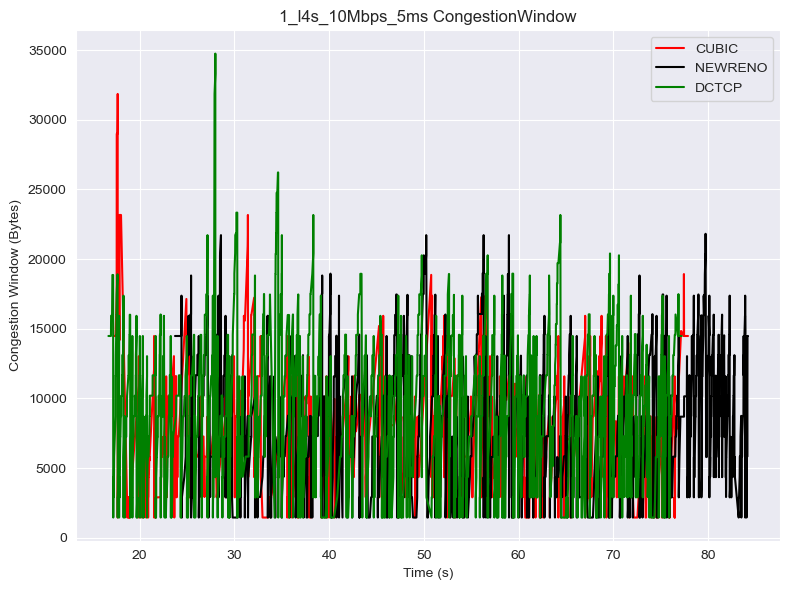


Start New Scenario
1_l4s_10Mbps_7ms
./Data./client1_data\1_l4s_10Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_10Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_10Mbps_7ms:
Statistics for CUBIC:
Median: 87.5
Mean: 95.6264954760879
25th Percentile: 67.812
75th Percentile: 116.562
Minimum: 23.437
Maximum: 323.125
Statistics for NEWRENO:
Median: 82.187
Mean: 91.67235193304107
25th Percentile: 61.875
75th Percentile: 111.25
Minimum: 20.625
Maximum: 372.5
Statistics for DCTCP:
Median: 66.25
Mean: 72.71894122562675
25th Percentile: 50.937
75th Percentile: 86.25
Minimum: 16.562
Maximum: 265.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_10Mbps_7ms_rtt_stats.txt



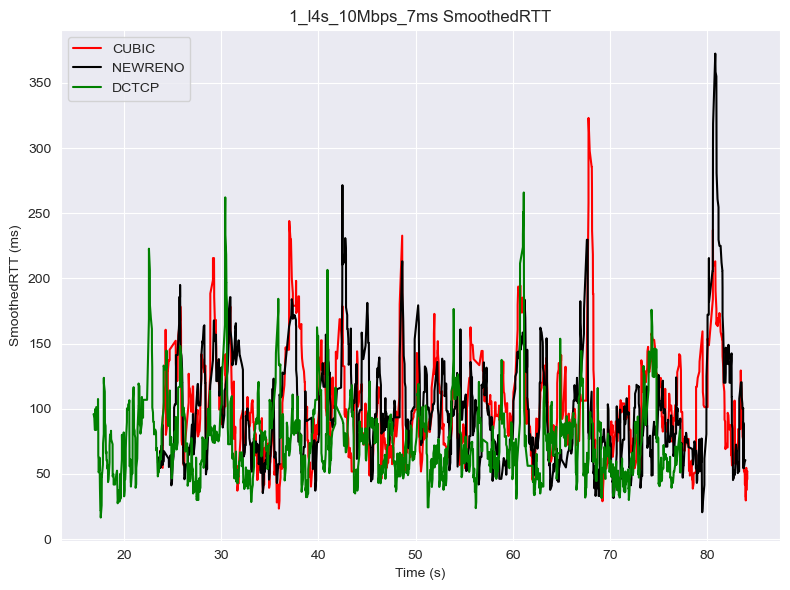

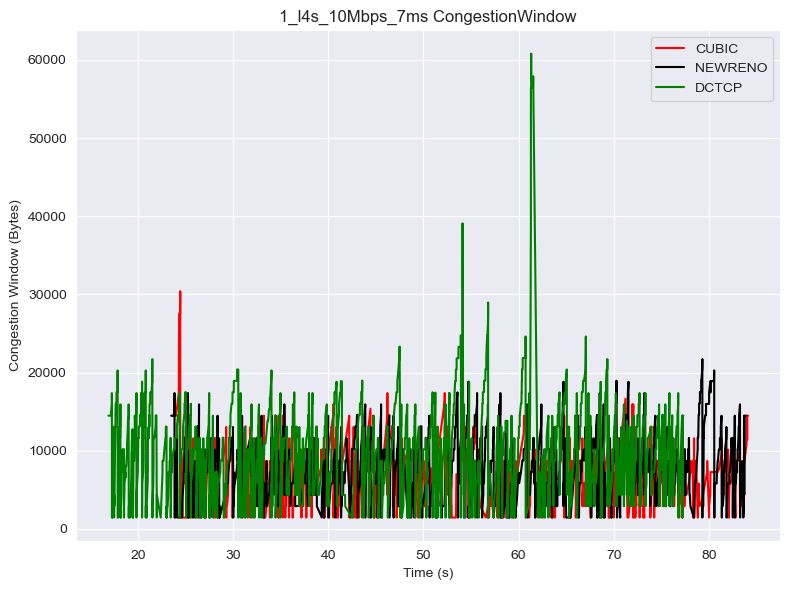


Start New Scenario
1_l4s_20Mbps_0ms
./Data./client1_data\1_l4s_20Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_20Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_20Mbps_0ms:
Statistics for CUBIC:
Median: 60.625
Mean: 71.89111680270196
25th Percentile: 47.5
75th Percentile: 78.437
Minimum: 18.437
Maximum: 649.687
Statistics for NEWRENO:
Median: 62.187
Mean: 74.27526116136563
25th Percentile: 47.5
75th Percentile: 84.375
Minimum: 19.375
Maximum: 650.937
Statistics for DCTCP:
Median: 46.562
Mean: 57.42595633096531
25th Percentile: 35.937
75th Percentile: 62.187
Minimum: 14.687
Maximum: 700.625
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_20Mbps_0ms_rtt_stats.txt



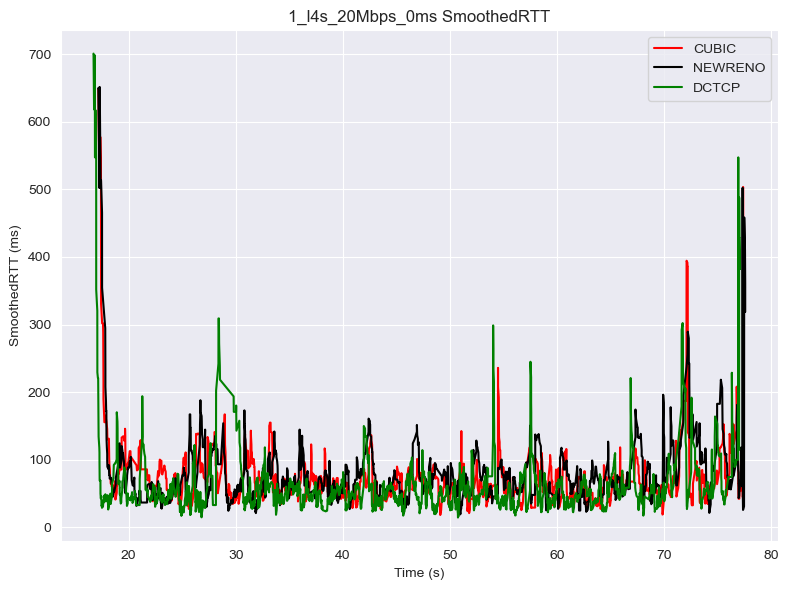

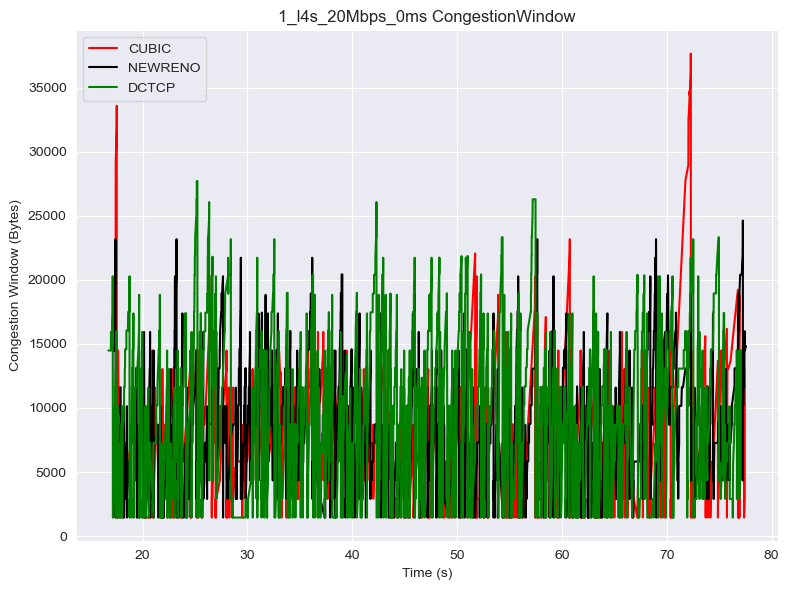


Start New Scenario
1_l4s_20Mbps_10ms
./Data./client1_data\1_l4s_20Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_20Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_20Mbps_10ms:
Statistics for CUBIC:
Median: 867.031
Mean: 898.469564405113
25th Percentile: 637.5
75th Percentile: 1124.062
Minimum: 60.312
Maximum: 1909.062
Statistics for NEWRENO:
Median: 823.281
Mean: 828.4195173812282
25th Percentile: 545.078
75th Percentile: 1101.32775
Minimum: 61.562
Maximum: 1889.062
Statistics for DCTCP:
Median: 784.062
Mean: 805.2703547284465
25th Percentile: 546.25
75th Percentile: 1037.5
Minimum: 90.312
Maximum: 1840.625
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_20Mbps_10ms_rtt_stats.txt



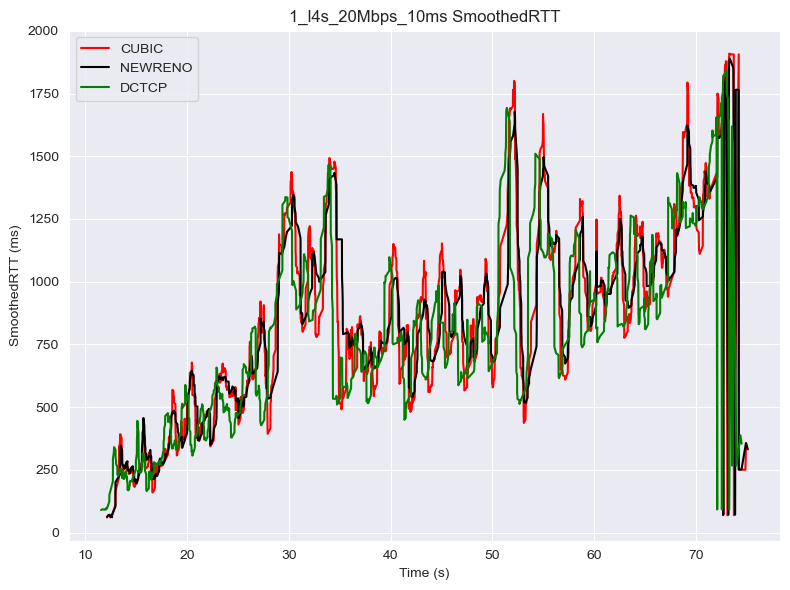

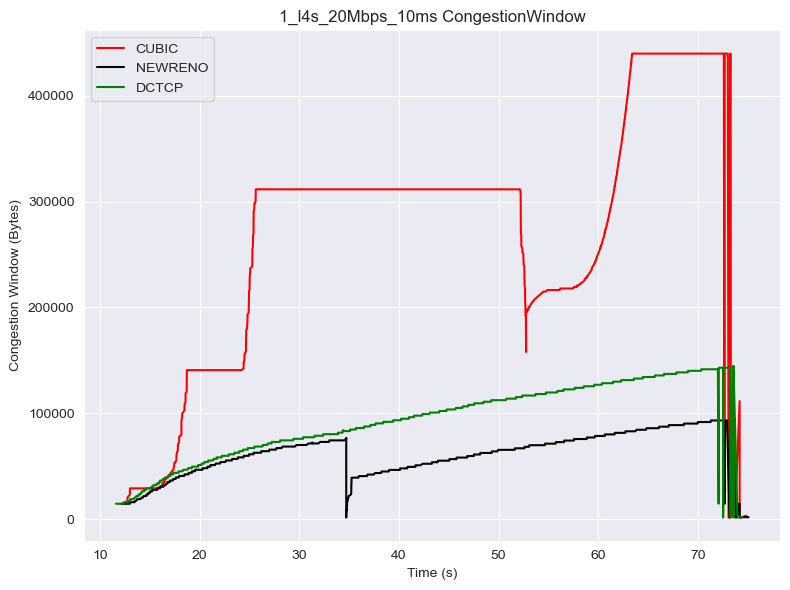


Start New Scenario
1_l4s_20Mbps_1ms
./Data./client1_data\1_l4s_20Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_20Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_20Mbps_1ms:
Statistics for CUBIC:
Median: 58.75
Mean: 65.20788069476082
25th Percentile: 45.312
75th Percentile: 74.687
Minimum: 16.562
Maximum: 232.812
Statistics for NEWRENO:
Median: 54.062
Mean: 62.85103908106681
25th Percentile: 43.125
75th Percentile: 73.437
Minimum: 15.937
Maximum: 440.0
Statistics for DCTCP:
Median: 45.312
Mean: 51.56315815835099
25th Percentile: 36.562
75th Percentile: 57.187
Minimum: 14.687
Maximum: 399.375
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_20Mbps_1ms_rtt_stats.txt



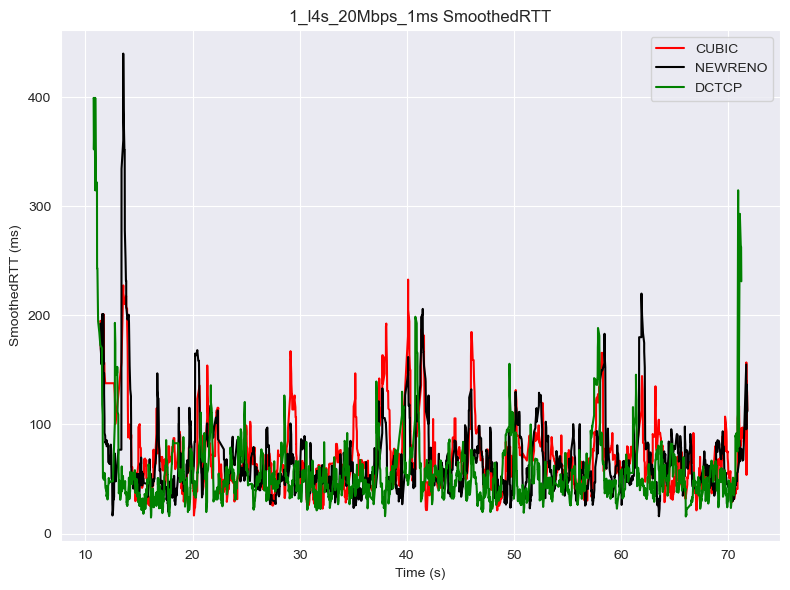

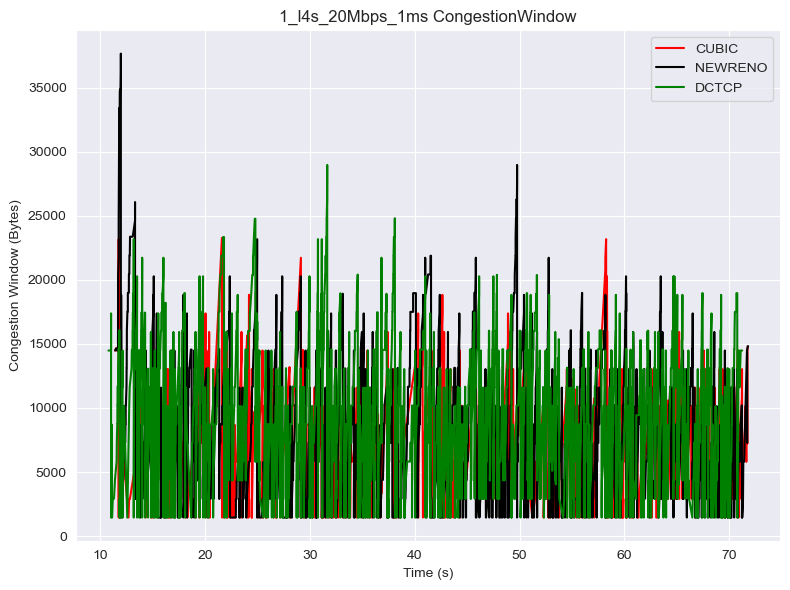


Start New Scenario
1_l4s_20Mbps_20ms
./Data./client1_data\1_l4s_20Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_20Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_20Mbps_20ms:
Statistics for CUBIC:
Median: 1037.5
Mean: 1080.0046320941487
25th Percentile: 861.484
75th Percentile: 1259.062
Minimum: 255.0
Maximum: 2212.812
Statistics for NEWRENO:
Median: 942.9685
Mean: 919.8416412849496
25th Percentile: 670.625
75th Percentile: 1126.71875
Minimum: 226.25
Maximum: 2081.562
Statistics for DCTCP:
Median: 752.187
Mean: 682.2488305709023
25th Percentile: 275.0
75th Percentile: 980.312
Minimum: 187.5
Maximum: 2114.062
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_20Mbps_20ms_rtt_stats.txt



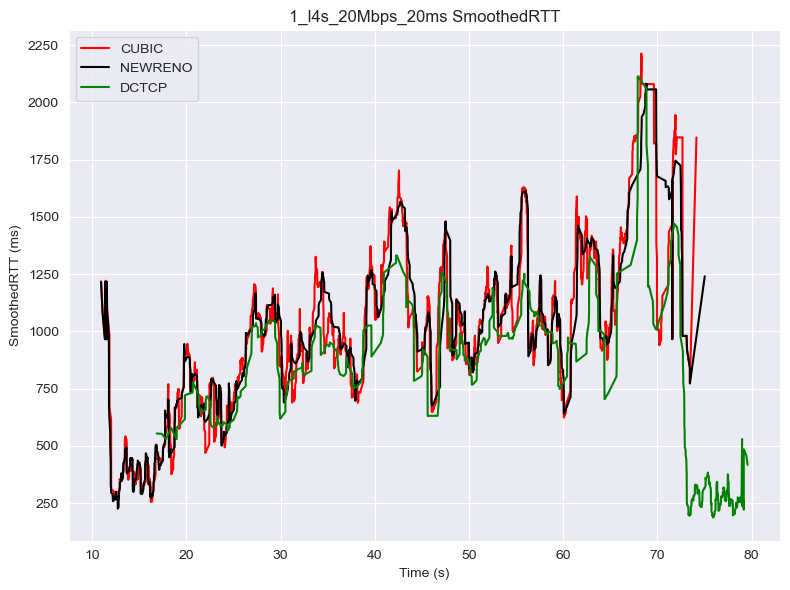

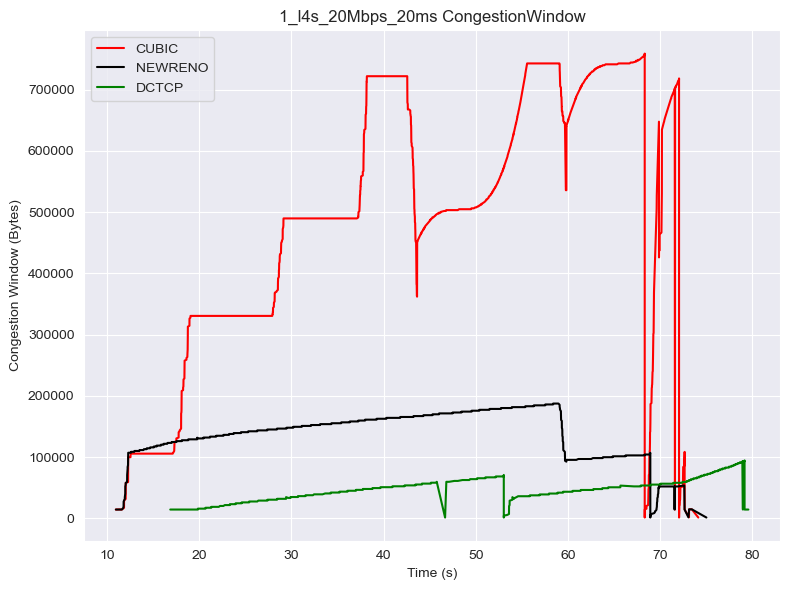


Start New Scenario
1_l4s_20Mbps_5ms
./Data./client1_data\1_l4s_20Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_20Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_20Mbps_5ms:
Statistics for CUBIC:
Median: 59.062
Mean: 66.55449439701174
25th Percentile: 47.187
75th Percentile: 77.187
Minimum: 22.187
Maximum: 235.937
Statistics for NEWRENO:
Median: 60.937
Mean: 67.00625364006989
25th Percentile: 48.75
75th Percentile: 80.0
Minimum: 20.937
Maximum: 204.375
Statistics for DCTCP:
Median: 47.5
Mean: 52.87811001211143
25th Percentile: 38.125
75th Percentile: 61.562
Minimum: 15.312
Maximum: 215.312
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_20Mbps_5ms_rtt_stats.txt



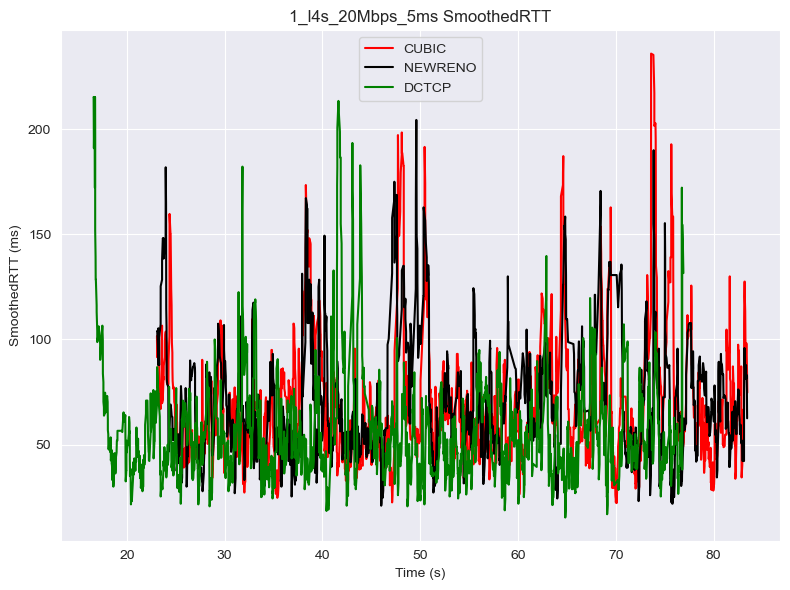

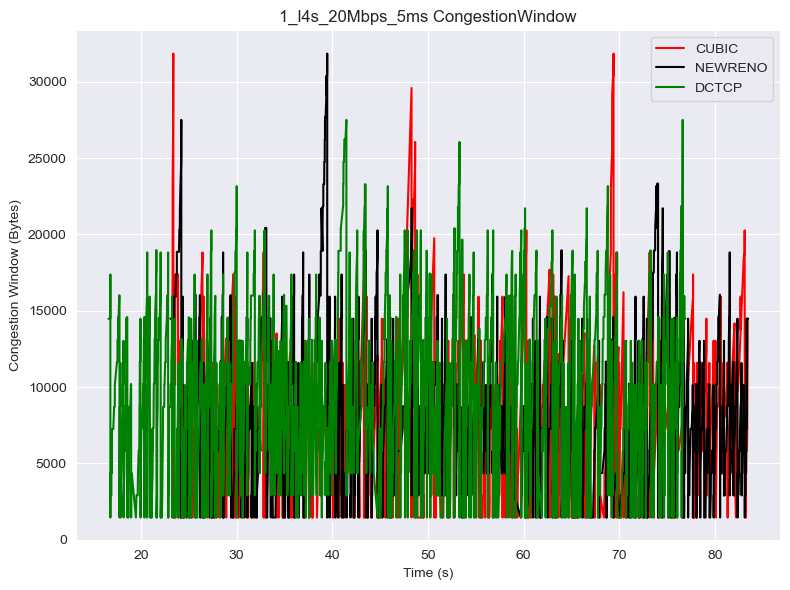


Start New Scenario
1_l4s_20Mbps_7ms
./Data./client1_data\1_l4s_20Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_20Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_20Mbps_7ms:
Statistics for CUBIC:
Median: 62.187
Mean: 67.33460370038794
25th Percentile: 49.062
75th Percentile: 79.062
Minimum: 22.187
Maximum: 243.125
Statistics for NEWRENO:
Median: 67.5
Mean: 74.69386970474967
25th Percentile: 54.375
75th Percentile: 86.562
Minimum: 15.937
Maximum: 367.812
Statistics for DCTCP:
Median: 49.687
Mean: 55.54062926723202
25th Percentile: 39.062
75th Percentile: 62.187
Minimum: 14.687
Maximum: 320.312
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_20Mbps_7ms_rtt_stats.txt



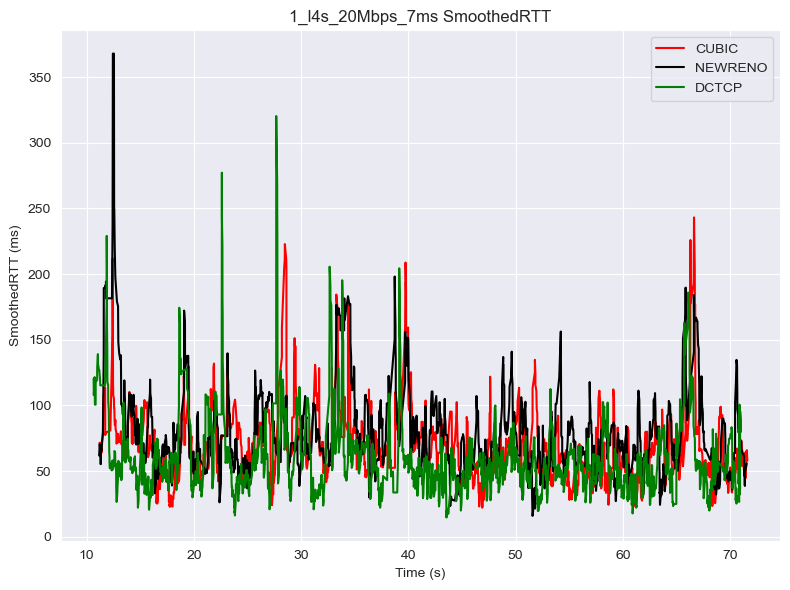

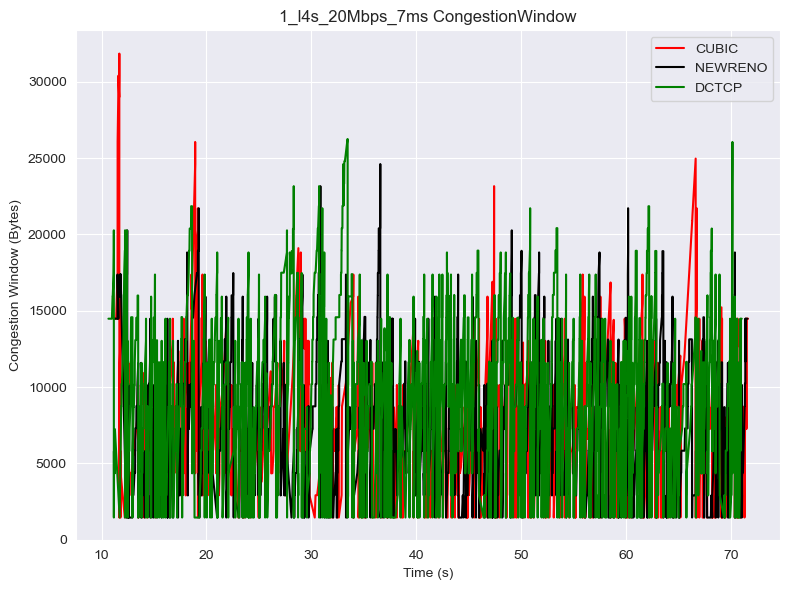


Start New Scenario
1_l4s_5Mbps_0ms
./Data./client1_data\1_l4s_5Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_5Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_5Mbps_0ms:
Statistics for CUBIC:
Median: 139.062
Mean: 153.30066647597252
25th Percentile: 110.312
75th Percentile: 169.453
Minimum: 51.25
Maximum: 652.187
Statistics for NEWRENO:
Median: 149.375
Mean: 165.45998499061915
25th Percentile: 124.375
75th Percentile: 191.875
Minimum: 55.0
Maximum: 660.937
Statistics for DCTCP:
Median: 111.562
Mean: 124.43570499569338
25th Percentile: 87.812
75th Percentile: 140.0
Minimum: 35.312
Maximum: 633.437
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_5Mbps_0ms_rtt_stats.txt



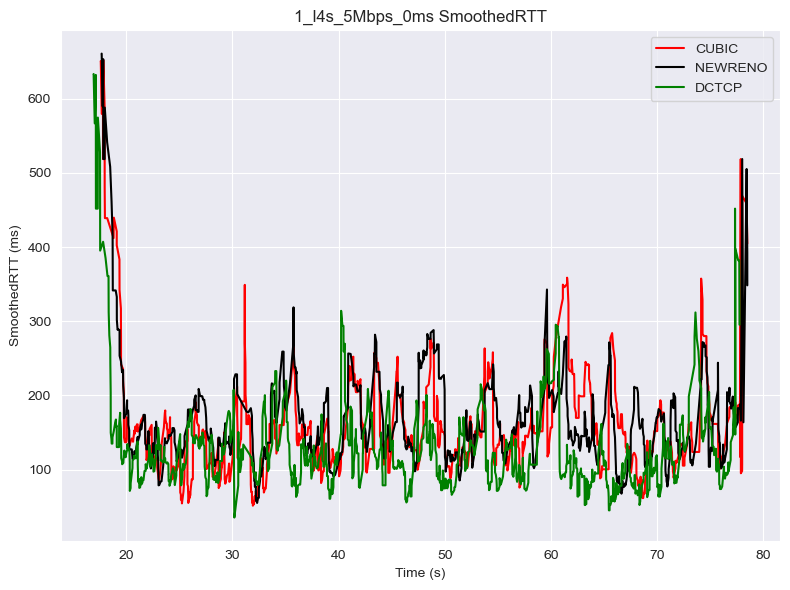

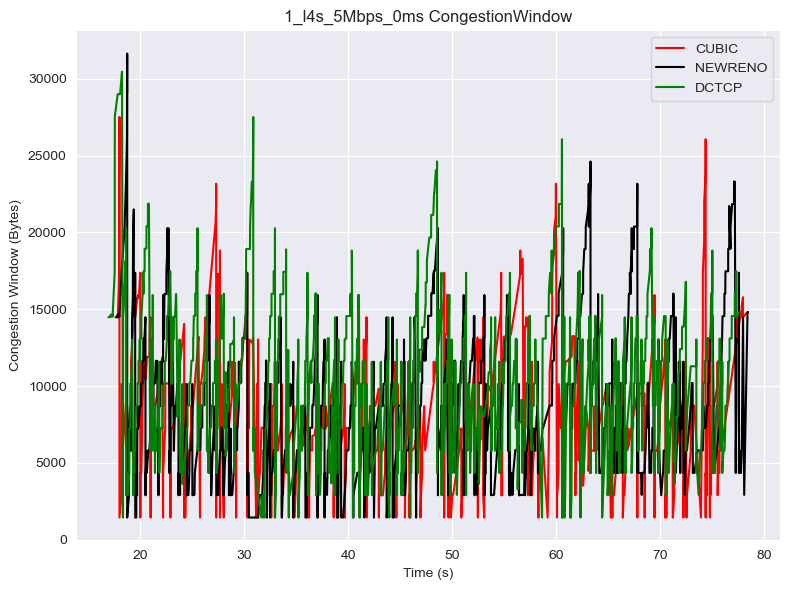


Start New Scenario
1_l4s_5Mbps_10ms
./Data./client1_data\1_l4s_5Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_5Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_5Mbps_10ms:
Statistics for CUBIC:
Median: 1088.75
Mean: 1109.001359131025
25th Percentile: 824.687
75th Percentile: 1388.125
Minimum: 101.25
Maximum: 2159.375
Statistics for NEWRENO:
Median: 1055.625
Mean: 1091.8080095902353
25th Percentile: 824.062
75th Percentile: 1353.1245
Minimum: 103.75
Maximum: 2043.125
Statistics for DCTCP:
Median: 957.812
Mean: 964.6922848297214
25th Percentile: 737.187
75th Percentile: 1168.906
Minimum: 134.062
Maximum: 1754.687
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_5Mbps_10ms_rtt_stats.txt



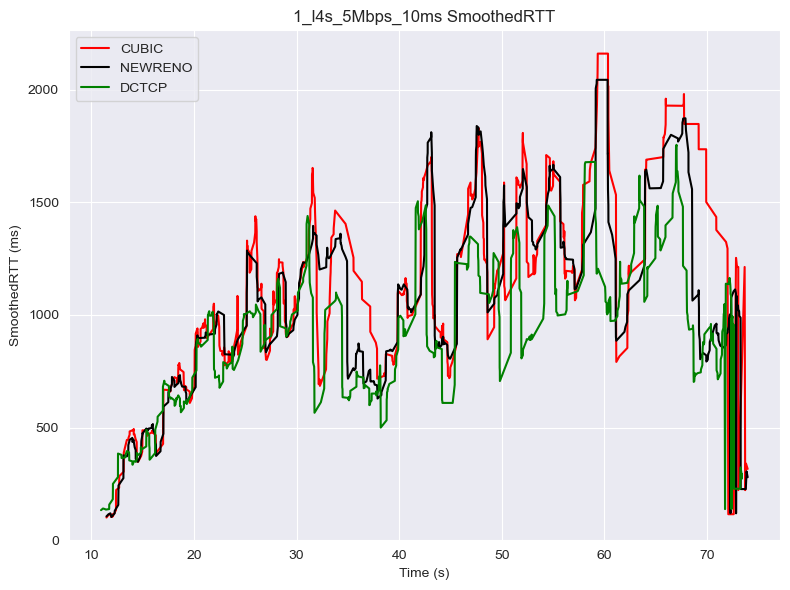

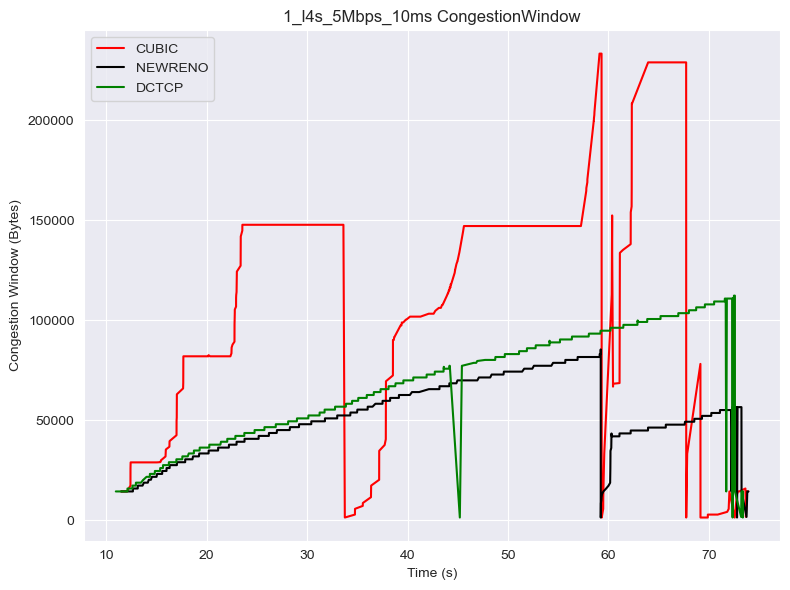


Start New Scenario
1_l4s_5Mbps_1ms
./Data./client1_data\1_l4s_5Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_5Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_5Mbps_1ms:
Statistics for CUBIC:
Median: 140.312
Mean: 155.31512113232387
25th Percentile: 105.937
75th Percentile: 188.437
Minimum: 51.25
Maximum: 401.25
Statistics for NEWRENO:
Median: 164.062
Mean: 171.9090475493782
25th Percentile: 130.625
75th Percentile: 206.0935
Minimum: 72.187
Maximum: 431.875
Statistics for DCTCP:
Median: 116.25
Mean: 124.04550025037555
25th Percentile: 91.875
75th Percentile: 143.437
Minimum: 41.25
Maximum: 434.375
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_5Mbps_1ms_rtt_stats.txt



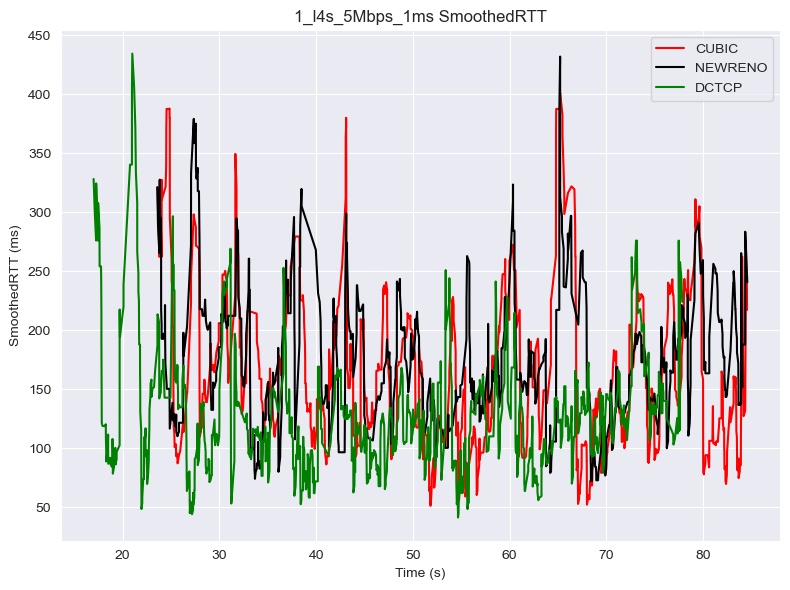

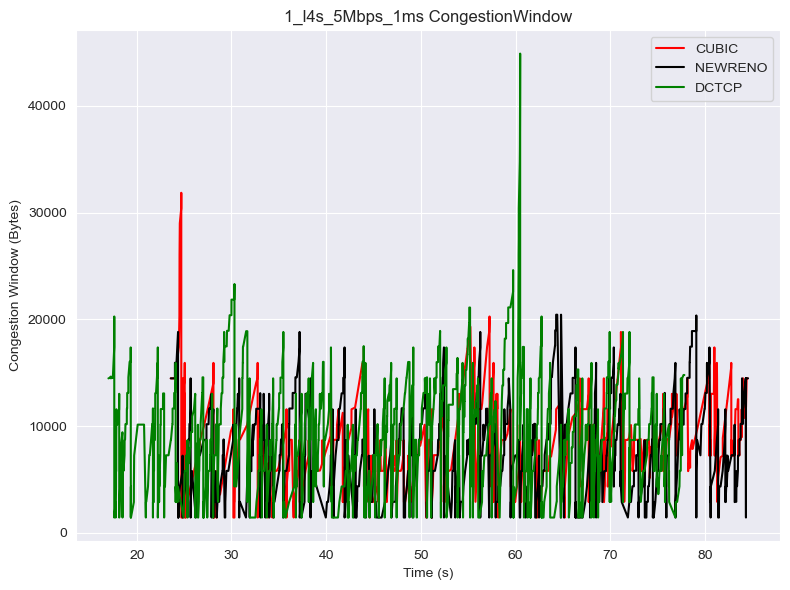


Start New Scenario
1_l4s_5Mbps_20ms
./Data./client1_data\1_l4s_5Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_5Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_5Mbps_20ms:
Statistics for CUBIC:
Median: 1301.0935
Mean: 1238.845132488479
25th Percentile: 1009.609
75th Percentile: 1502.187
Minimum: 326.875
Maximum: 2238.437
Statistics for NEWRENO:
Median: 1178.75
Mean: 1131.6304173160172
25th Percentile: 803.5935
75th Percentile: 1414.375
Minimum: 305.937
Maximum: 2171.562
Statistics for DCTCP:
Median: 1104.531
Mean: 1034.5222805194805
25th Percentile: 836.09375
75th Percentile: 1248.51525
Minimum: 294.375
Maximum: 1820.625
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_5Mbps_20ms_rtt_stats.txt



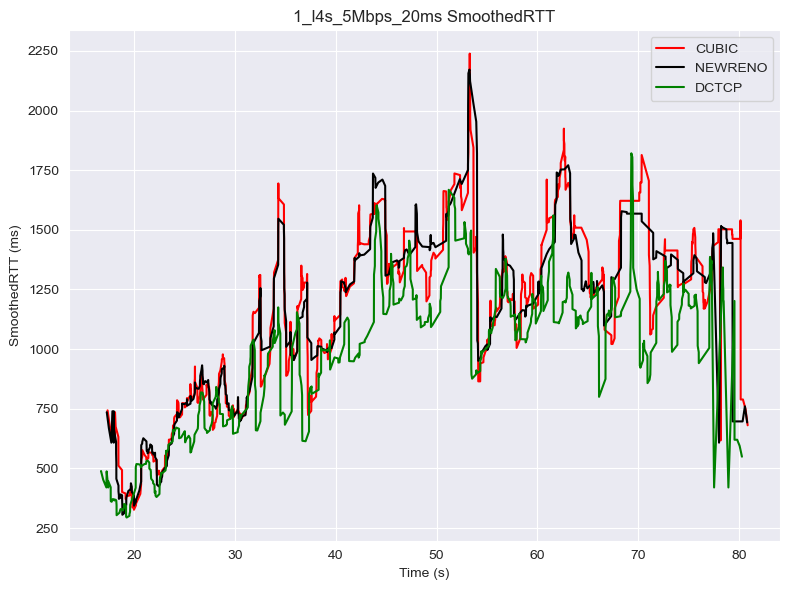

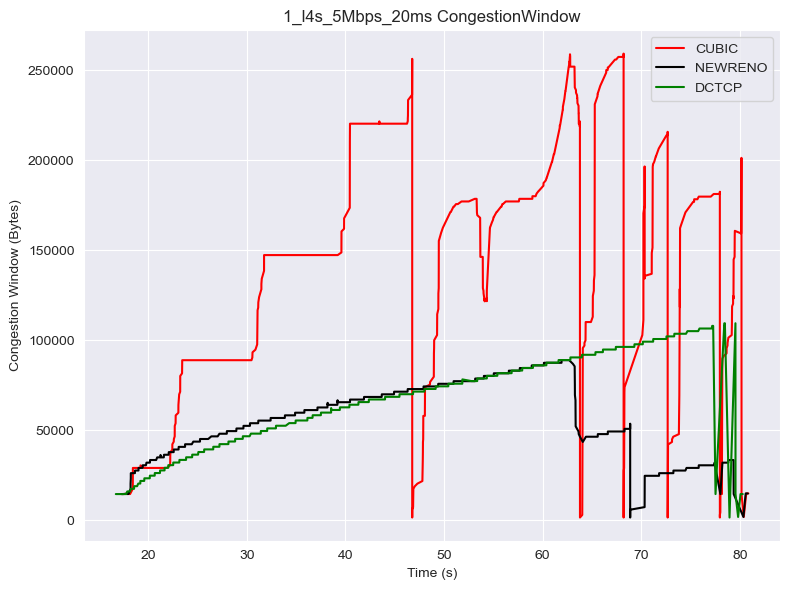


Start New Scenario
1_l4s_5Mbps_5ms
./Data./client1_data\1_l4s_5Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_5Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_5Mbps_5ms:
Statistics for CUBIC:
Median: 145.937
Mean: 156.03900119688808
25th Percentile: 112.812
75th Percentile: 182.9685
Minimum: 45.937
Maximum: 387.5
Statistics for NEWRENO:
Median: 142.187
Mean: 145.6415543478261
25th Percentile: 103.125
75th Percentile: 177.812
Minimum: 54.062
Maximum: 352.187
Statistics for DCTCP:
Median: 103.437
Mean: 116.30012653406688
25th Percentile: 78.125
75th Percentile: 136.0935
Minimum: 36.562
Maximum: 532.812
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_5Mbps_5ms_rtt_stats.txt



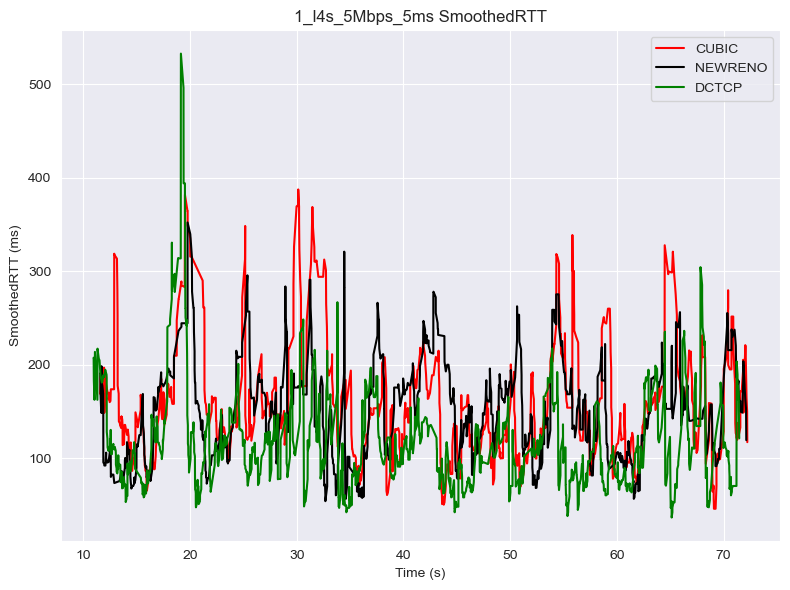

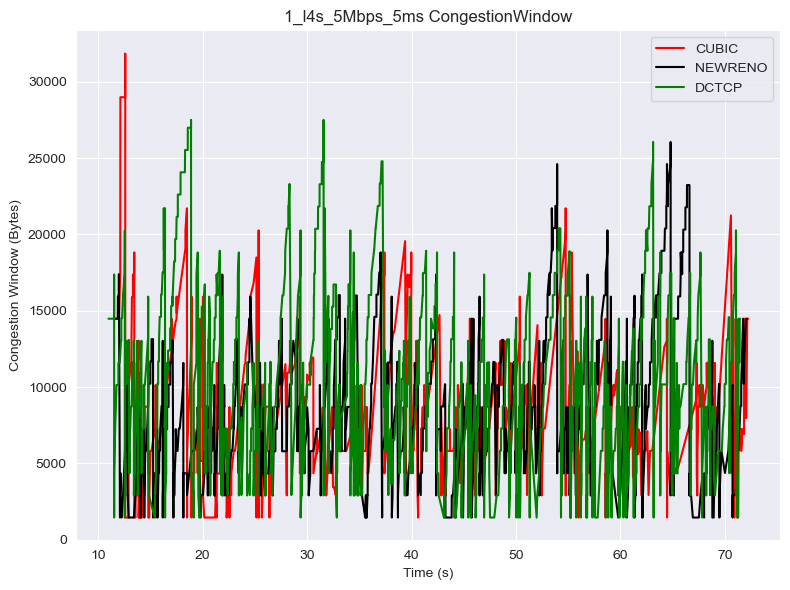


Start New Scenario
1_l4s_5Mbps_7ms
./Data./client1_data\1_l4s_5Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_5Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_5Mbps_7ms:
Statistics for CUBIC:
Median: 118.75
Mean: 123.56640083217754
25th Percentile: 80.781
75th Percentile: 157.812
Minimum: 28.125
Maximum: 346.25
Statistics for NEWRENO:
Median: 127.812
Mean: 136.63550574018126
25th Percentile: 102.812
75th Percentile: 163.5935
Minimum: 45.937
Maximum: 337.5
Statistics for DCTCP:
Median: 96.562
Mean: 105.88939805036554
25th Percentile: 75.0
75th Percentile: 128.437
Minimum: 38.437
Maximum: 416.25
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_5Mbps_7ms_rtt_stats.txt



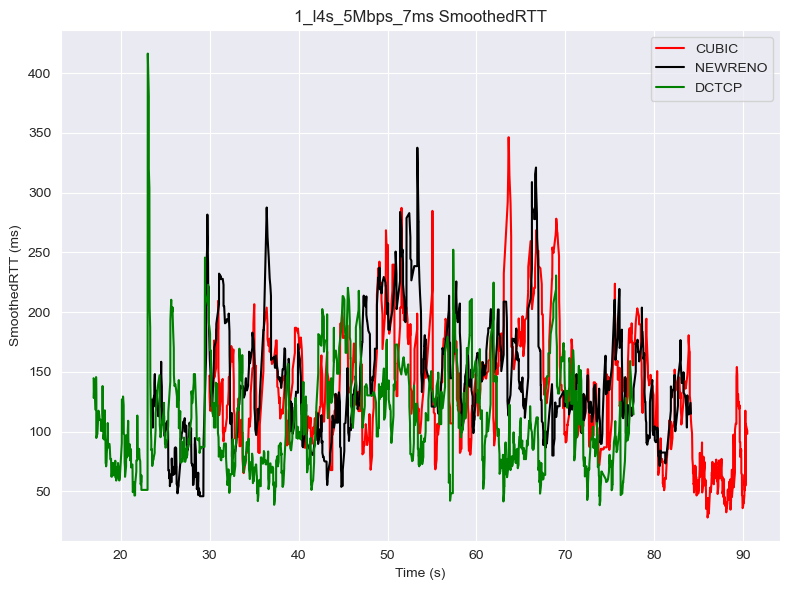

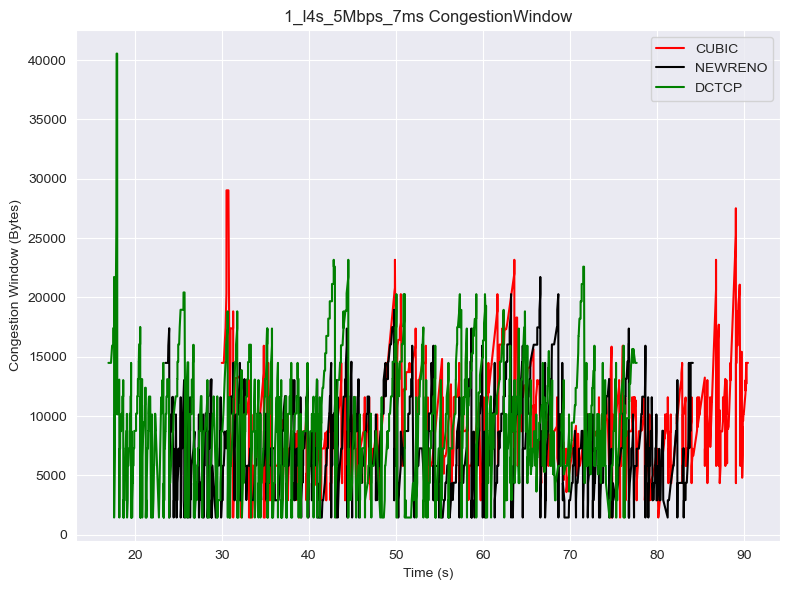


Start New Scenario
1_l4s_8Mbps_0ms
./Data./client1_data\1_l4s_8Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_8Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_8Mbps_0ms:
Statistics for CUBIC:
Median: 93.437
Mean: 108.34401307723743
25th Percentile: 70.312
75th Percentile: 114.687
Minimum: 24.375
Maximum: 1087.187
Statistics for NEWRENO:
Median: 94.375
Mean: 106.67768629807692
25th Percentile: 71.25
75th Percentile: 117.812
Minimum: 28.437
Maximum: 1090.937
Statistics for DCTCP:
Median: 69.375
Mean: 78.44565612998522
25th Percentile: 54.062
75th Percentile: 91.562
Minimum: 23.125
Maximum: 705.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_8Mbps_0ms_rtt_stats.txt



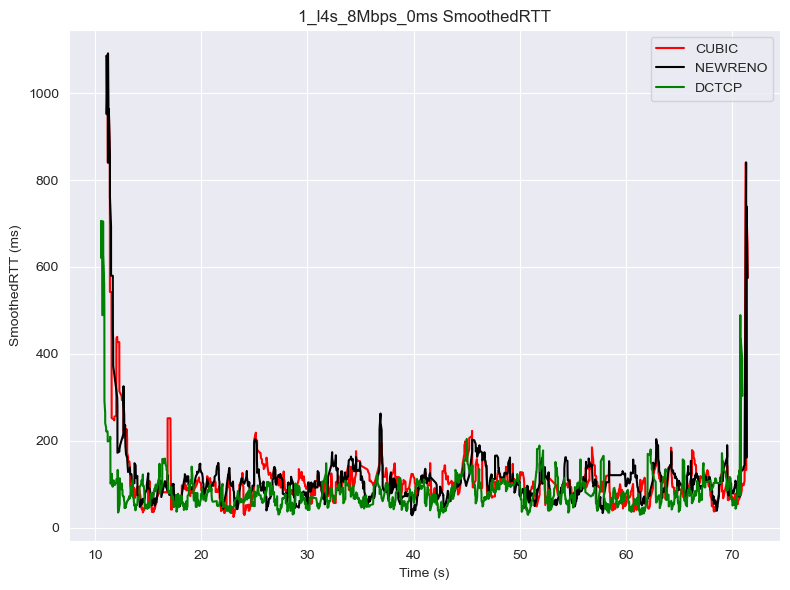

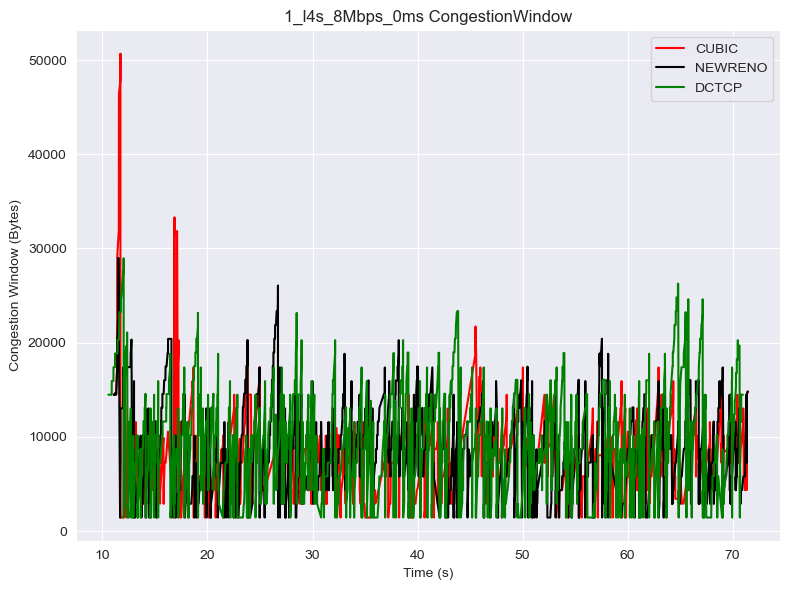


Start New Scenario
1_l4s_8Mbps_10ms
./Data./client1_data\1_l4s_8Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_8Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_8Mbps_10ms:
Statistics for CUBIC:
Median: 1184.687
Mean: 1199.3725266868073
25th Percentile: 883.125
75th Percentile: 1454.375
Minimum: 111.25
Maximum: 2516.25
Statistics for NEWRENO:
Median: 1077.9685
Mean: 1040.0004601123594
25th Percentile: 506.40625
75th Percentile: 1406.01525
Minimum: 91.25
Maximum: 2391.875
Statistics for DCTCP:
Median: 993.437
Mean: 943.048562595033
25th Percentile: 512.5
75th Percentile: 1239.375
Minimum: 88.437
Maximum: 2443.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_8Mbps_10ms_rtt_stats.txt



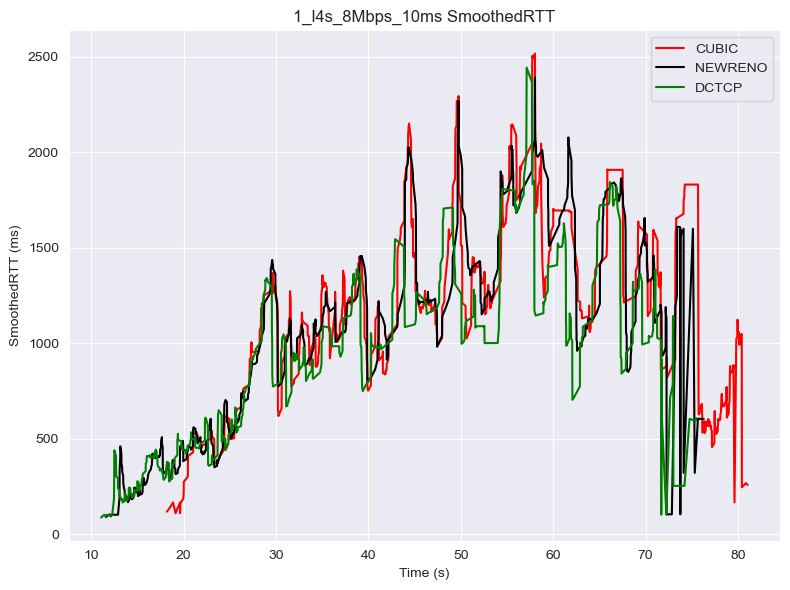

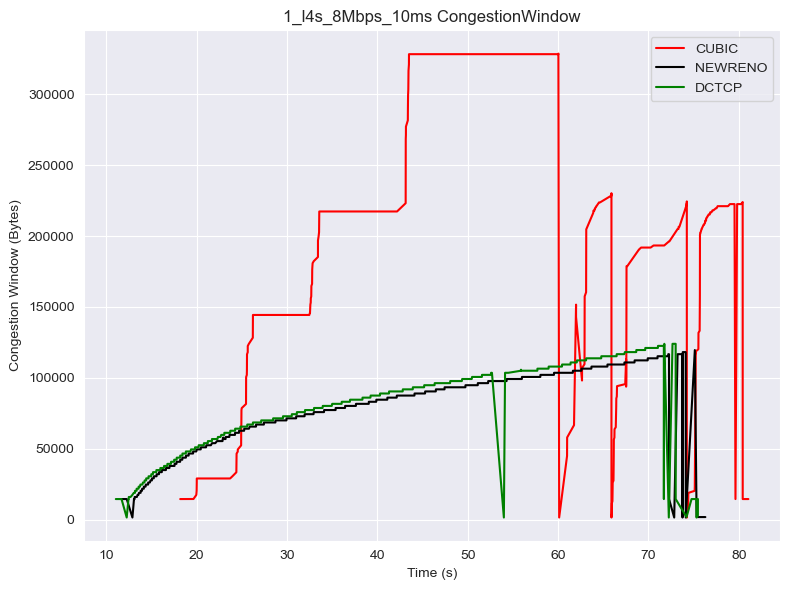


Start New Scenario
1_l4s_8Mbps_1ms
./Data./client1_data\1_l4s_8Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_8Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_8Mbps_1ms:
Statistics for CUBIC:
Median: 98.75
Mean: 105.17165356991973
25th Percentile: 75.625
75th Percentile: 127.187
Minimum: 30.937
Maximum: 452.812
Statistics for NEWRENO:
Median: 95.312
Mean: 102.21306934931506
25th Percentile: 71.875
75th Percentile: 123.125
Minimum: 34.062
Maximum: 451.562
Statistics for DCTCP:
Median: 73.75
Mean: 78.38649454545454
25th Percentile: 57.108999999999995
75th Percentile: 93.437
Minimum: 25.312
Maximum: 293.75
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_8Mbps_1ms_rtt_stats.txt



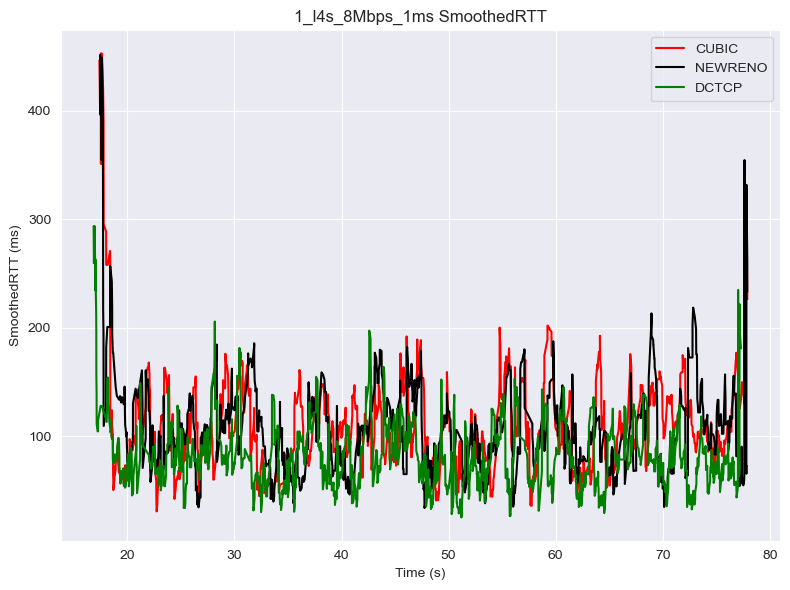

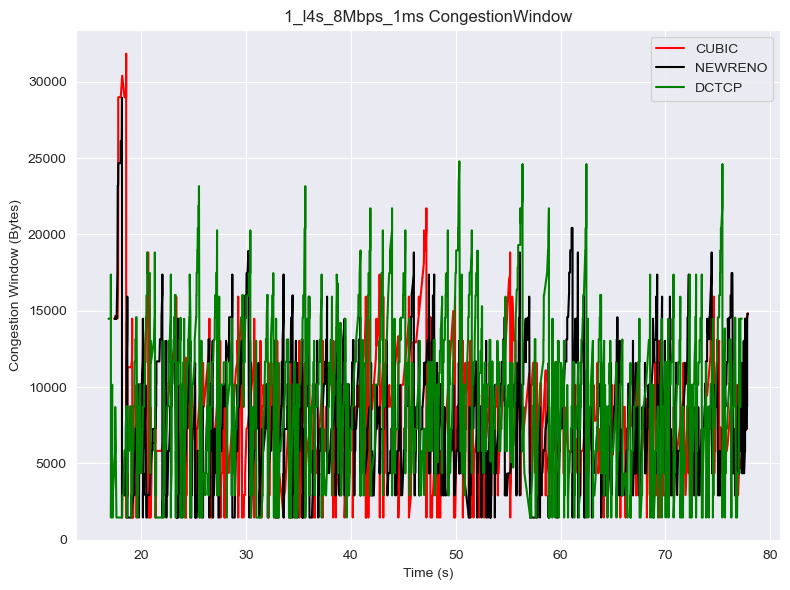


Start New Scenario
1_l4s_8Mbps_20ms
./Data./client1_data\1_l4s_8Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_8Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_8Mbps_20ms:
Statistics for CUBIC:
Median: 1203.125
Mean: 1218.8333542435423
25th Percentile: 984.14025
75th Percentile: 1437.5
Minimum: 330.312
Maximum: 2285.0
Statistics for NEWRENO:
Median: 1079.687
Mean: 1062.7136205323193
25th Percentile: 791.406
75th Percentile: 1359.2185
Minimum: 234.687
Maximum: 2002.5
Statistics for DCTCP:
Median: 1015.0
Mean: 993.5568793846154
25th Percentile: 821.875
75th Percentile: 1179.375
Minimum: 286.562
Maximum: 1798.437
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_8Mbps_20ms_rtt_stats.txt



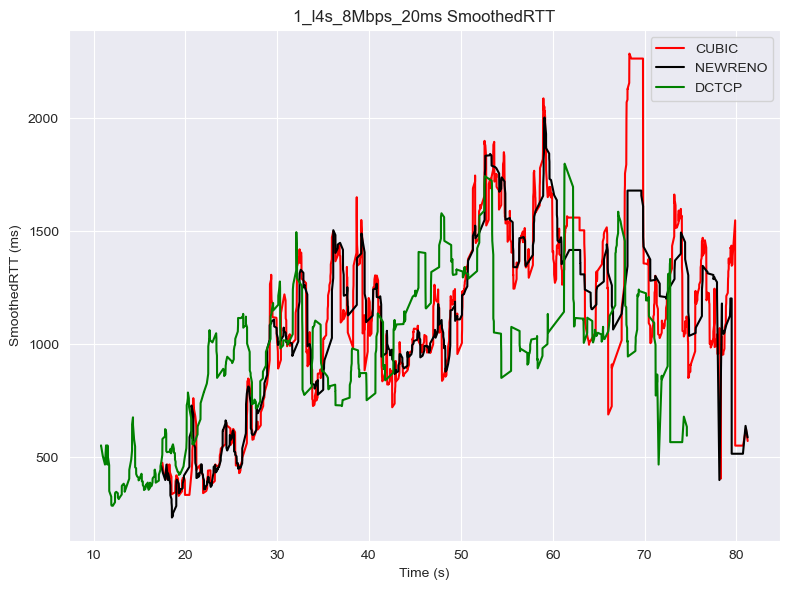

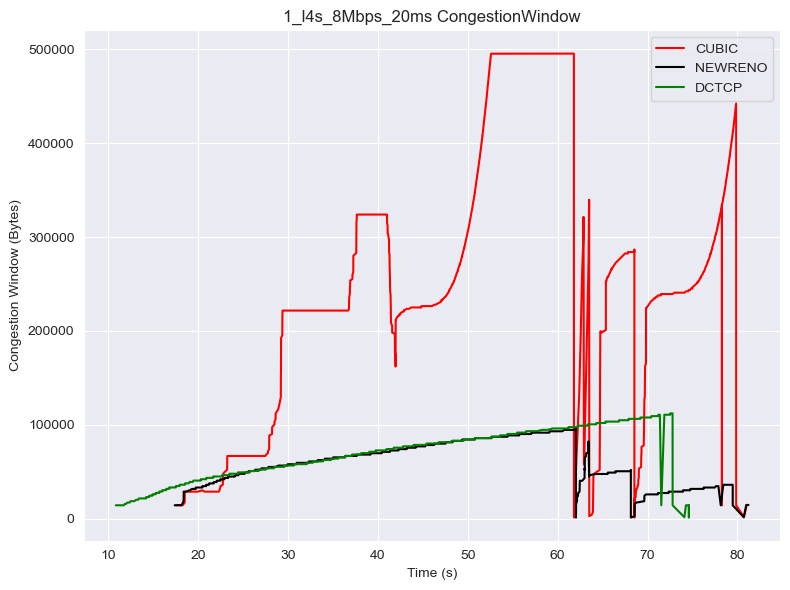


Start New Scenario
1_l4s_8Mbps_5ms
./Data./client1_data\1_l4s_8Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_8Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_8Mbps_5ms:
Statistics for CUBIC:
Median: 95.312
Mean: 102.84550564726325
25th Percentile: 73.125
75th Percentile: 124.687
Minimum: 35.312
Maximum: 289.375
Statistics for NEWRENO:
Median: 92.812
Mean: 95.55141718043568
25th Percentile: 73.437
75th Percentile: 113.75
Minimum: 26.562
Maximum: 244.062
Statistics for DCTCP:
Median: 71.562
Mean: 74.78821775184275
25th Percentile: 53.437
75th Percentile: 91.562
Minimum: 20.625
Maximum: 210.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_8Mbps_5ms_rtt_stats.txt



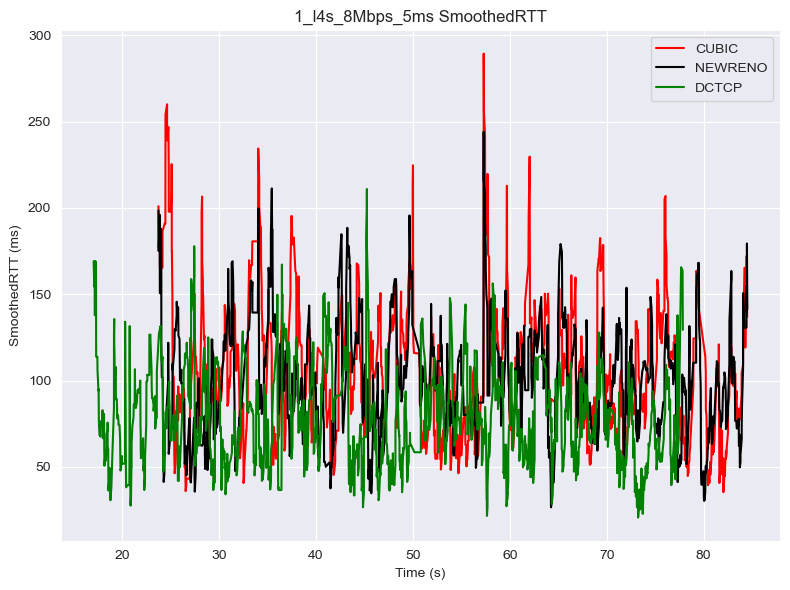

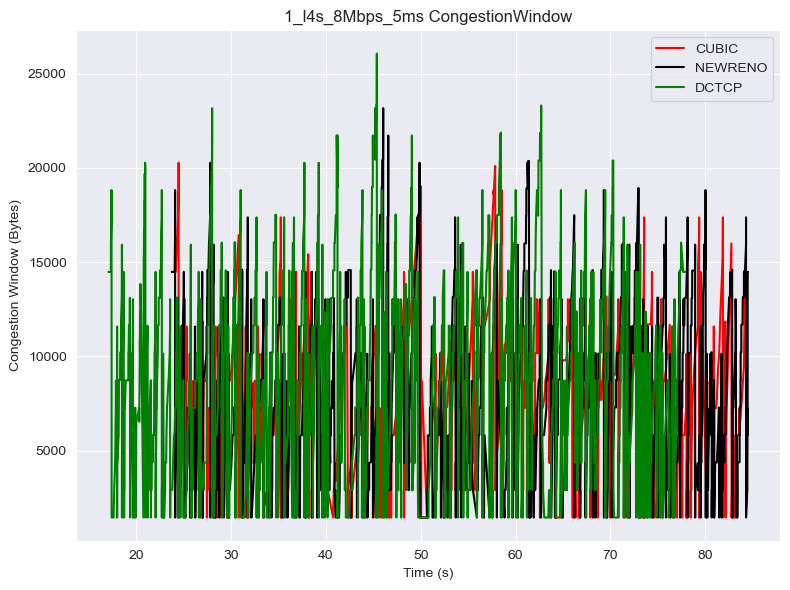


Start New Scenario
1_l4s_8Mbps_7ms
./Data./client1_data\1_l4s_8Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\1_l4s_8Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 1_l4s_8Mbps_7ms:
Statistics for CUBIC:
Median: 88.437
Mean: 98.29762395309884
25th Percentile: 68.125
75th Percentile: 118.828
Minimum: 25.937
Maximum: 273.125
Statistics for NEWRENO:
Median: 91.875
Mean: 99.72011392931394
25th Percentile: 68.75
75th Percentile: 121.562
Minimum: 17.812
Maximum: 350.312
Statistics for DCTCP:
Median: 68.125
Mean: 74.24090822510823
25th Percentile: 51.25
75th Percentile: 89.062
Minimum: 23.125
Maximum: 328.75
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_1_l4s_8Mbps_7ms_rtt_stats.txt



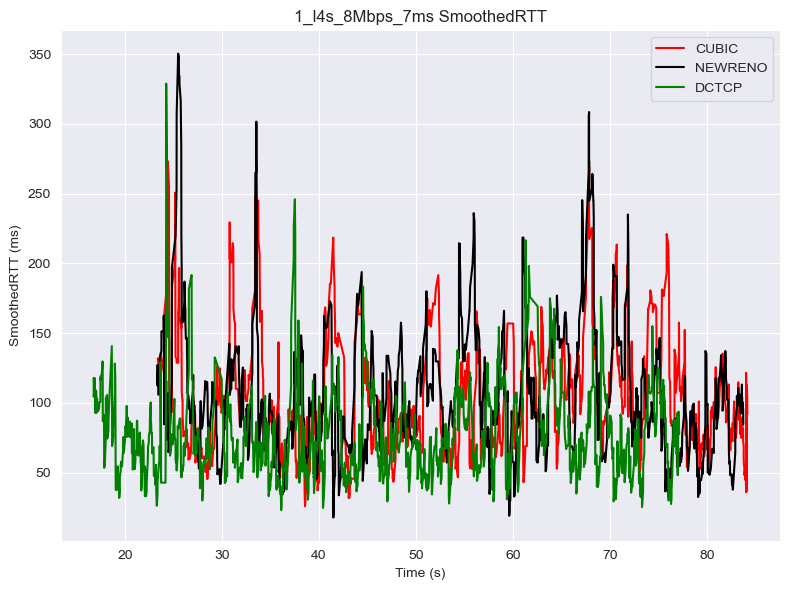

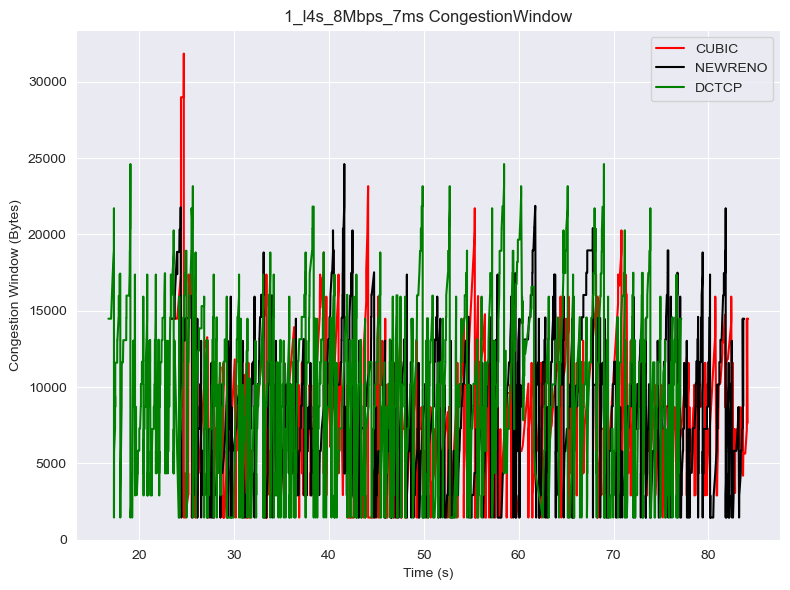


Start New Scenario
2_fq_codel_10Mbps_0ms
./Data./client1_data\2_fq_codel_10Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_10Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_10Mbps_0ms:
Statistics for CUBIC:
Median: 37.187
Mean: 41.43813980617372
25th Percentile: 26.875
75th Percentile: 49.687
Minimum: 11.875
Maximum: 415.0
Statistics for NEWRENO:
Median: 41.25
Mean: 45.54698696537678
25th Percentile: 33.125
75th Percentile: 51.875
Minimum: 15.312
Maximum: 411.25
Statistics for DCTCP:
Median: 37.187
Mean: 41.28044468468468
25th Percentile: 29.687
75th Percentile: 47.187
Minimum: 11.562
Maximum: 403.437
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_10Mbps_0ms_rtt_stats.txt



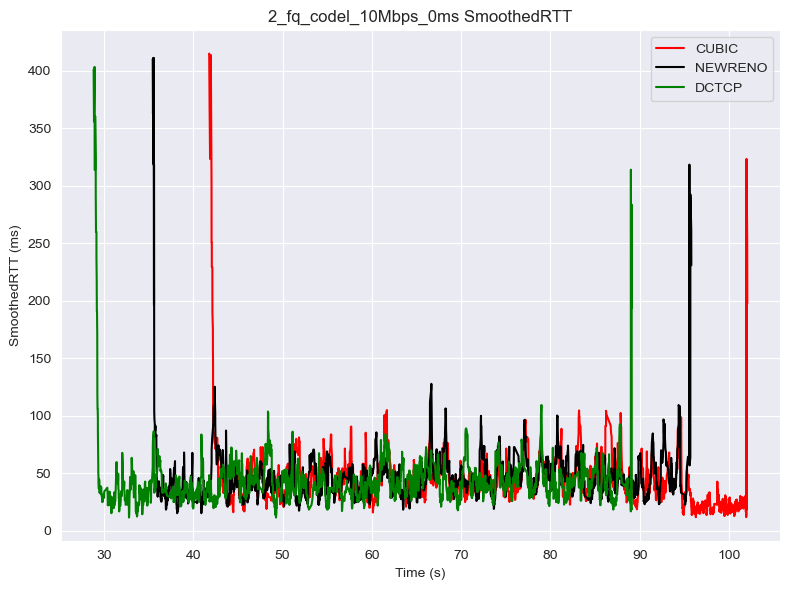

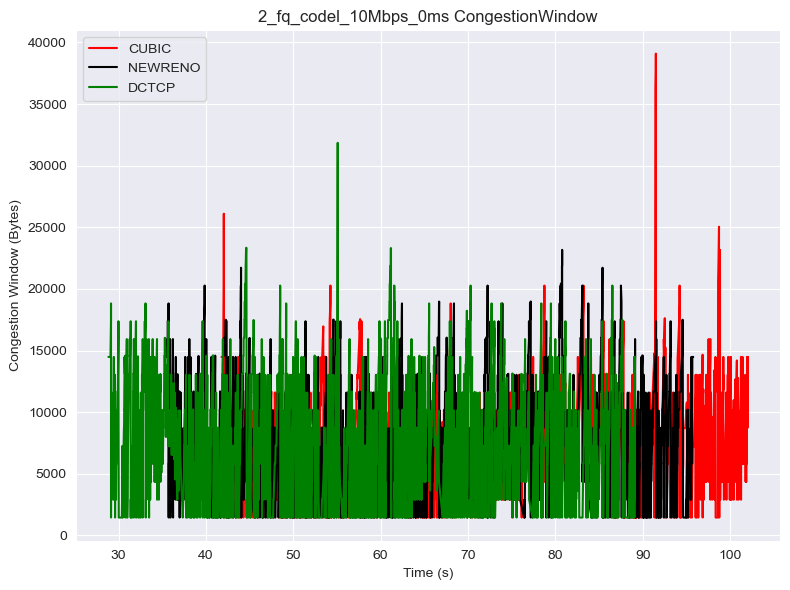


Start New Scenario
2_fq_codel_10Mbps_10ms
./Data./client1_data\2_fq_codel_10Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_10Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_10Mbps_10ms:
Statistics for CUBIC:
Median: 219.062
Mean: 223.6350428116864
25th Percentile: 198.125
75th Percentile: 250.0
Minimum: 46.875
Maximum: 359.375
Statistics for NEWRENO:
Median: 220.312
Mean: 222.666986770428
25th Percentile: 197.187
75th Percentile: 247.187
Minimum: 58.125
Maximum: 343.437
Statistics for DCTCP:
Median: 231.875
Mean: 234.4077699757869
25th Percentile: 207.812
75th Percentile: 260.312
Minimum: 59.375
Maximum: 403.75
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_10Mbps_10ms_rtt_stats.txt



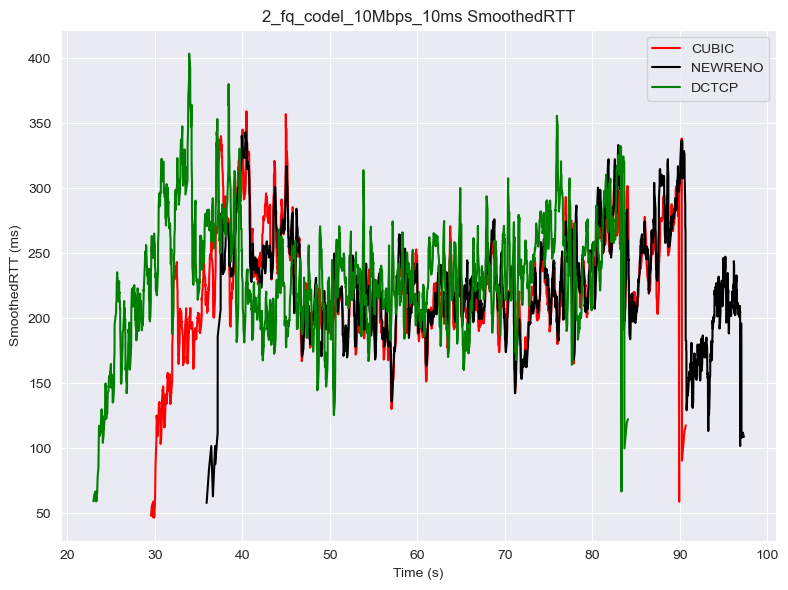

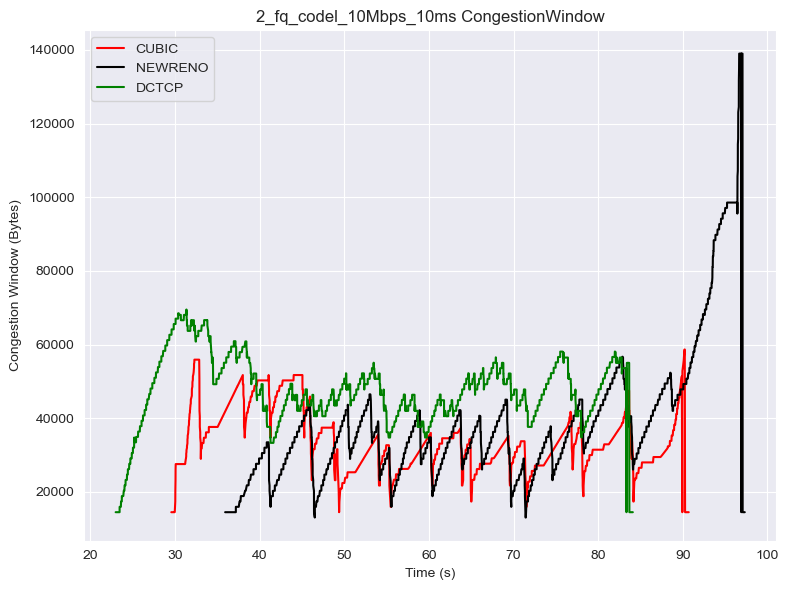


Start New Scenario
2_fq_codel_10Mbps_1ms
./Data./client1_data\2_fq_codel_10Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_10Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_10Mbps_1ms:
Statistics for CUBIC:
Median: 39.062
Mean: 41.27972785646837
25th Percentile: 31.25
75th Percentile: 48.125
Minimum: 11.875
Maximum: 171.875
Statistics for NEWRENO:
Median: 40.312
Mean: 43.657939648117846
25th Percentile: 32.812
75th Percentile: 50.625
Minimum: 18.437
Maximum: 180.625
Statistics for DCTCP:
Median: 34.375
Mean: 37.08721404857592
25th Percentile: 25.625
75th Percentile: 44.062
Minimum: 13.75
Maximum: 191.562
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_10Mbps_1ms_rtt_stats.txt



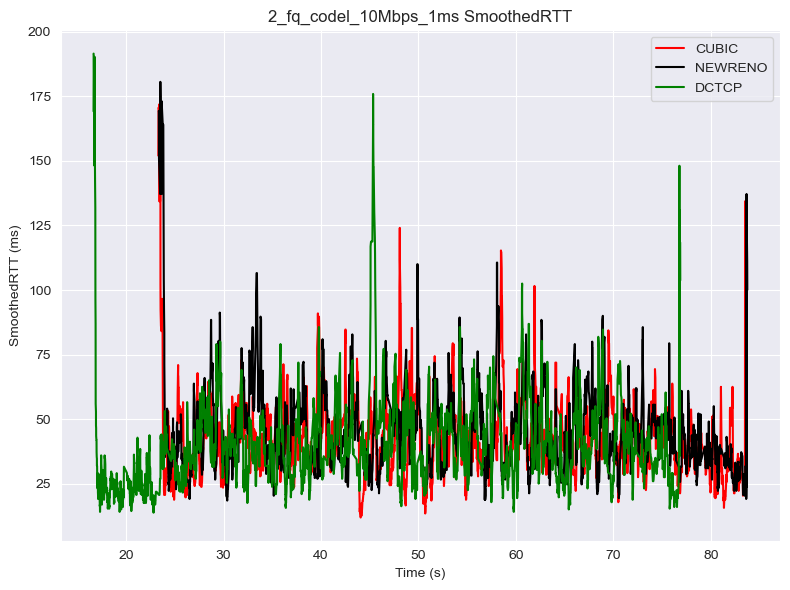

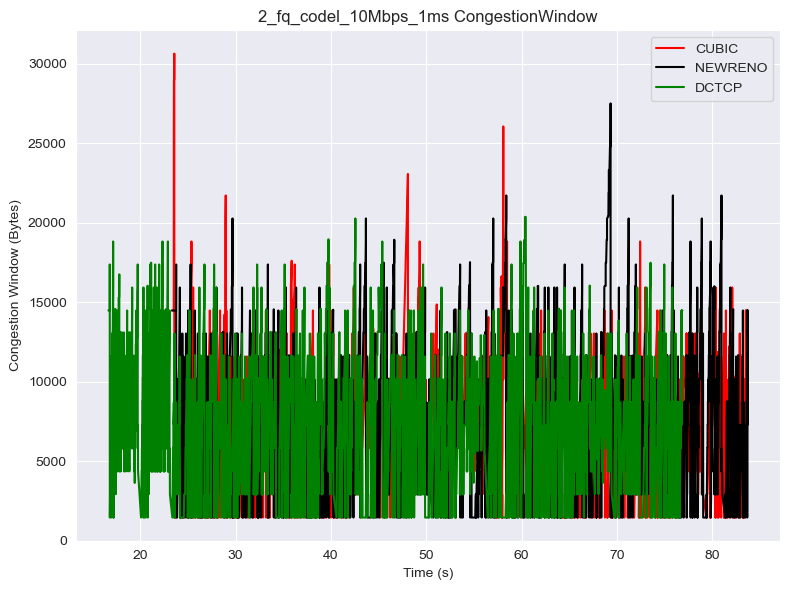


Start New Scenario
2_fq_codel_10Mbps_20ms
./Data./client1_data\2_fq_codel_10Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_10Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_10Mbps_20ms:
Statistics for CUBIC:
Median: 460.312
Mean: 464.8658505452212
25th Percentile: 375.625
75th Percentile: 559.687
Minimum: 127.5
Maximum: 746.25
Statistics for NEWRENO:
Median: 389.375
Mean: 399.26338457921946
25th Percentile: 313.437
75th Percentile: 475.156
Minimum: 125.937
Maximum: 717.187
Statistics for DCTCP:
Median: 658.437
Mean: 628.6188025239542
25th Percentile: 477.9685
75th Percentile: 798.437
Minimum: 142.812
Maximum: 1050.625
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_10Mbps_20ms_rtt_stats.txt



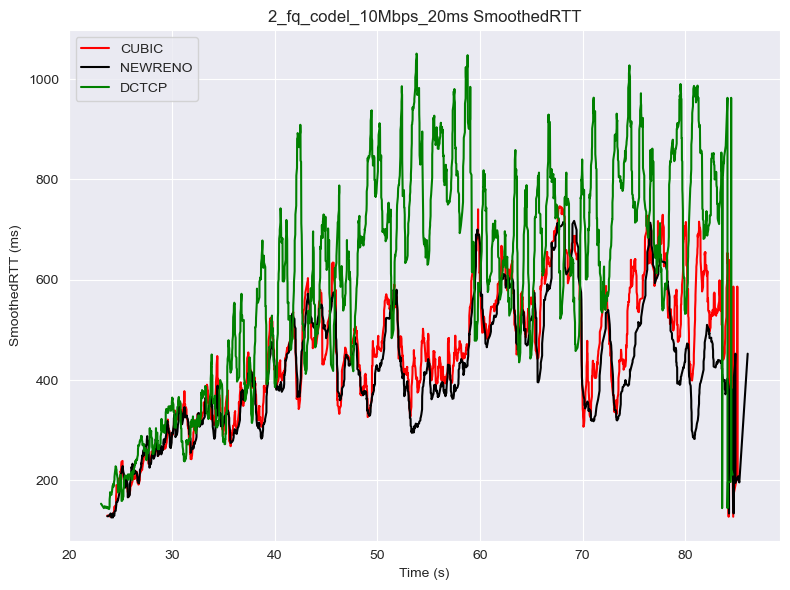

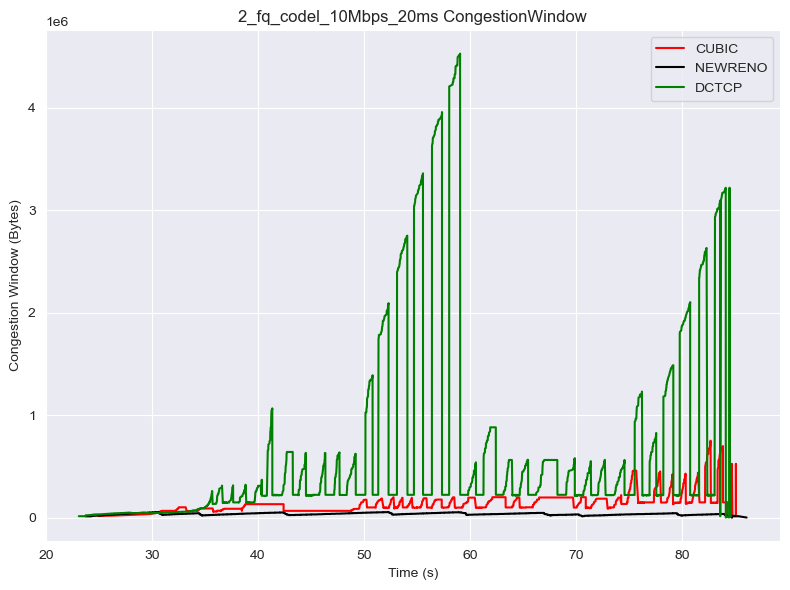


Start New Scenario
2_fq_codel_10Mbps_5ms
./Data./client1_data\2_fq_codel_10Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_10Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_10Mbps_5ms:
Statistics for CUBIC:
Median: 41.875
Mean: 44.04934320884624
25th Percentile: 33.75
75th Percentile: 51.25
Minimum: 13.125
Maximum: 148.75
Statistics for NEWRENO:
Median: 42.187
Mean: 45.09278971061093
25th Percentile: 34.062
75th Percentile: 53.125
Minimum: 14.375
Maximum: 124.062
Statistics for DCTCP:
Median: 37.812
Mean: 40.56577646617951
25th Percentile: 29.375
75th Percentile: 49.062
Minimum: 11.562
Maximum: 129.375
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_10Mbps_5ms_rtt_stats.txt



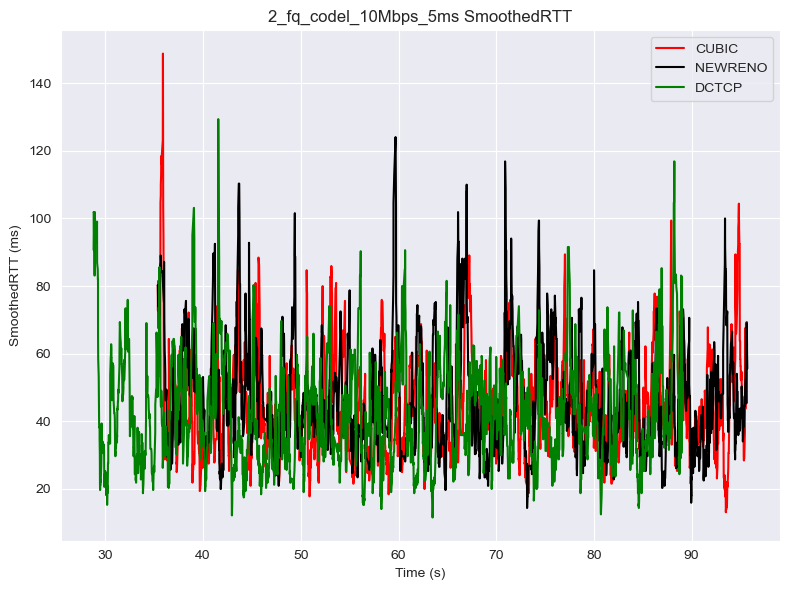

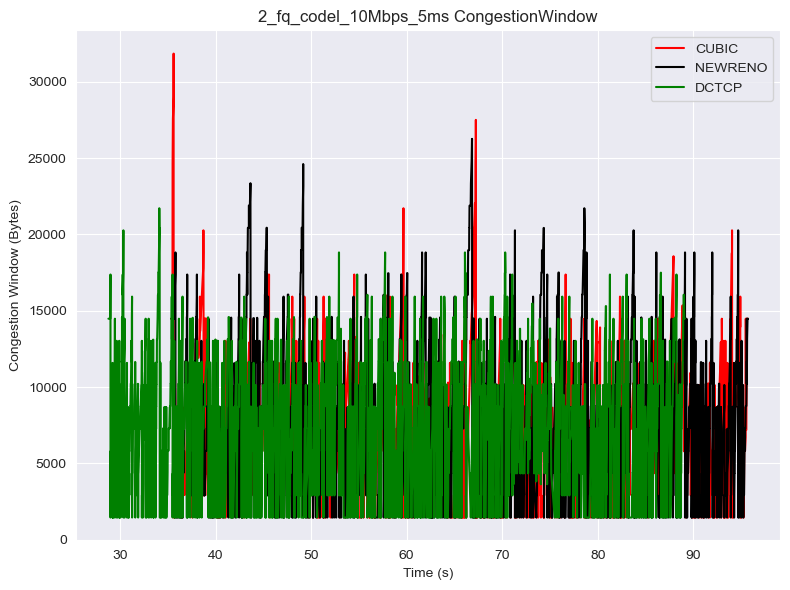


Start New Scenario
2_fq_codel_10Mbps_7ms
./Data./client1_data\2_fq_codel_10Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_10Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_10Mbps_7ms:
Statistics for CUBIC:
Median: 39.375
Mean: 42.873987352270376
25th Percentile: 31.562
75th Percentile: 49.687
Minimum: 17.812
Maximum: 168.437
Statistics for NEWRENO:
Median: 41.25
Mean: 43.81697073578596
25th Percentile: 33.125
75th Percentile: 50.312
Minimum: 16.25
Maximum: 160.312
Statistics for DCTCP:
Median: 37.187
Mean: 39.95835130910512
25th Percentile: 29.062
75th Percentile: 48.125
Minimum: 13.437
Maximum: 110.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_10Mbps_7ms_rtt_stats.txt



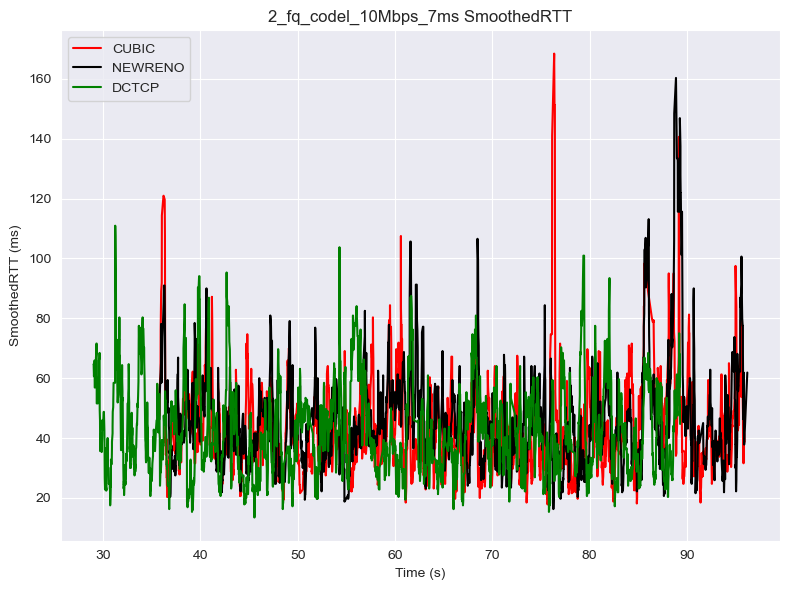

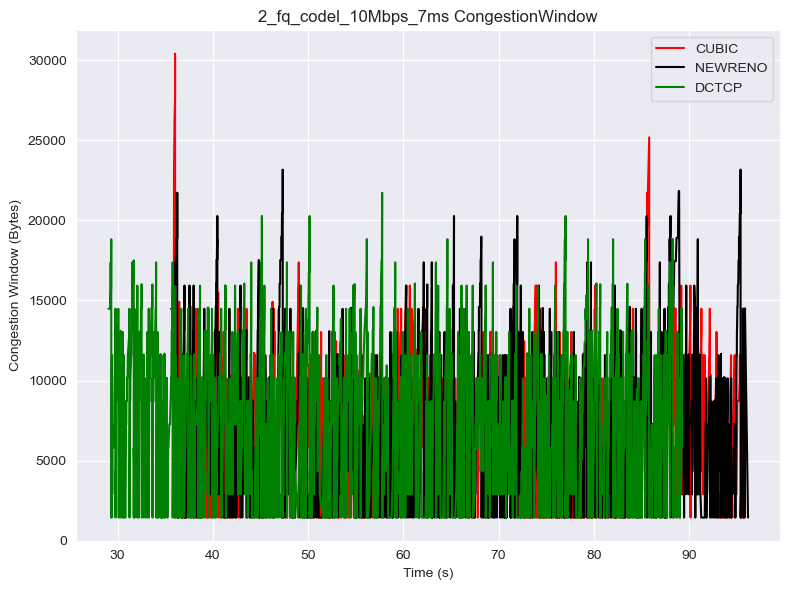


Start New Scenario
2_fq_codel_20Mbps_0ms
./Data./client1_data\2_fq_codel_20Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_20Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_20Mbps_0ms:
Statistics for CUBIC:
Median: 30.937
Mean: 35.91175535377763
25th Percentile: 25.312
75th Percentile: 40.625
Minimum: 10.0
Maximum: 242.5
Statistics for NEWRENO:
Median: 30.625
Mean: 34.95996733243061
25th Percentile: 25.0
75th Percentile: 39.375
Minimum: 8.125
Maximum: 263.75
Statistics for DCTCP:
Median: 26.875
Mean: 30.662992651970608
25th Percentile: 21.875
75th Percentile: 34.375
Minimum: 6.875
Maximum: 300.0
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_20Mbps_0ms_rtt_stats.txt



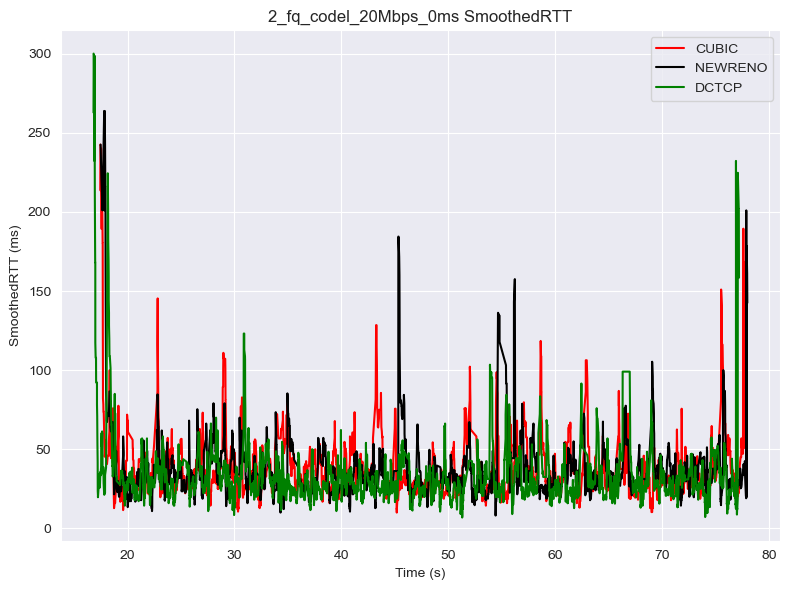

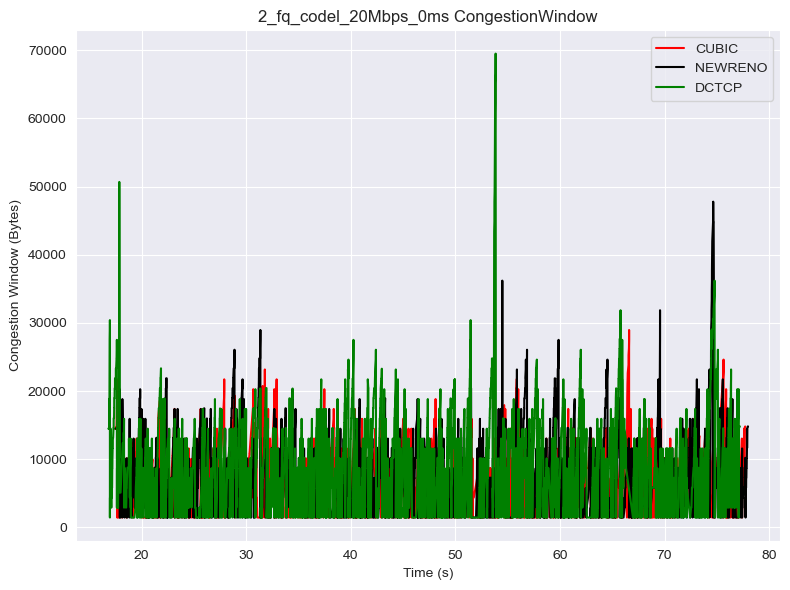


Start New Scenario
2_fq_codel_20Mbps_10ms
./Data./client1_data\2_fq_codel_20Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_20Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_20Mbps_10ms:
Statistics for CUBIC:
Median: 530.937
Mean: 482.3953379821958
25th Percentile: 219.062
75th Percentile: 660.0
Minimum: 62.5
Maximum: 828.437
Statistics for NEWRENO:
Median: 551.875
Mean: 524.3774883268483
25th Percentile: 419.687
75th Percentile: 663.437
Minimum: 41.25
Maximum: 815.937
Statistics for DCTCP:
Median: 599.3745
Mean: 562.8747224352828
25th Percentile: 481.875
75th Percentile: 698.437
Minimum: 39.375
Maximum: 872.812
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_20Mbps_10ms_rtt_stats.txt



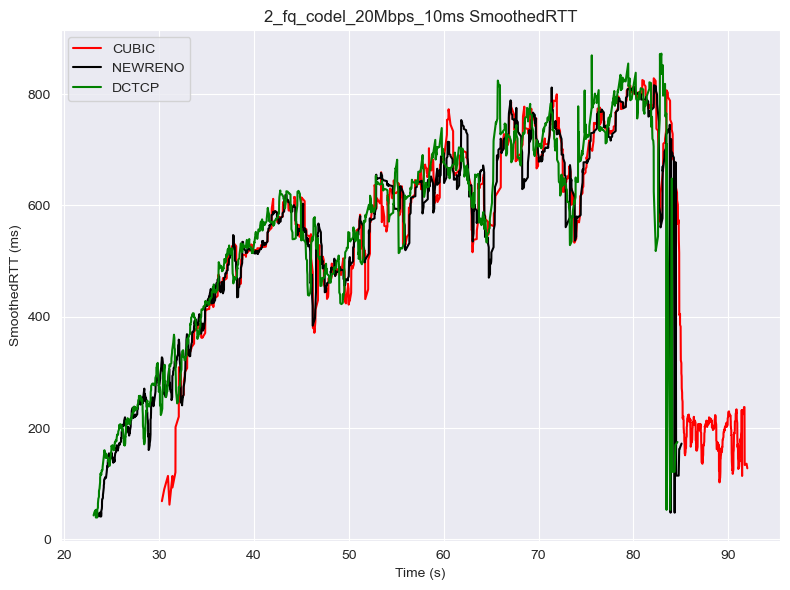

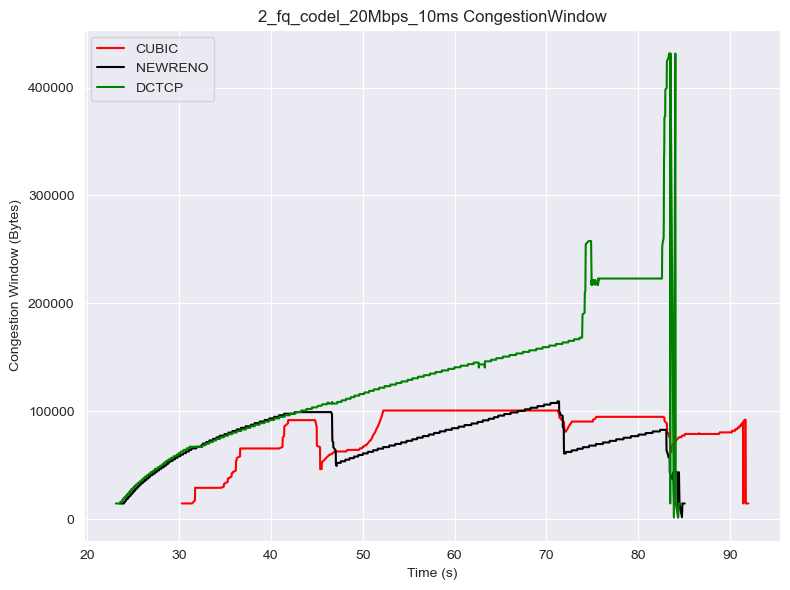


Start New Scenario
2_fq_codel_20Mbps_1ms
./Data./client1_data\2_fq_codel_20Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_20Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_20Mbps_1ms:
Statistics for CUBIC:
Median: 30.625
Mean: 34.25105656632484
25th Percentile: 23.75
75th Percentile: 40.312
Minimum: 8.75
Maximum: 210.0
Statistics for NEWRENO:
Median: 31.875
Mean: 36.96051553205552
25th Percentile: 25.0
75th Percentile: 43.125
Minimum: 9.687
Maximum: 191.25
Statistics for DCTCP:
Median: 25.312
Mean: 28.855837408149636
25th Percentile: 19.687
75th Percentile: 33.75
Minimum: 7.812
Maximum: 219.687
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_20Mbps_1ms_rtt_stats.txt



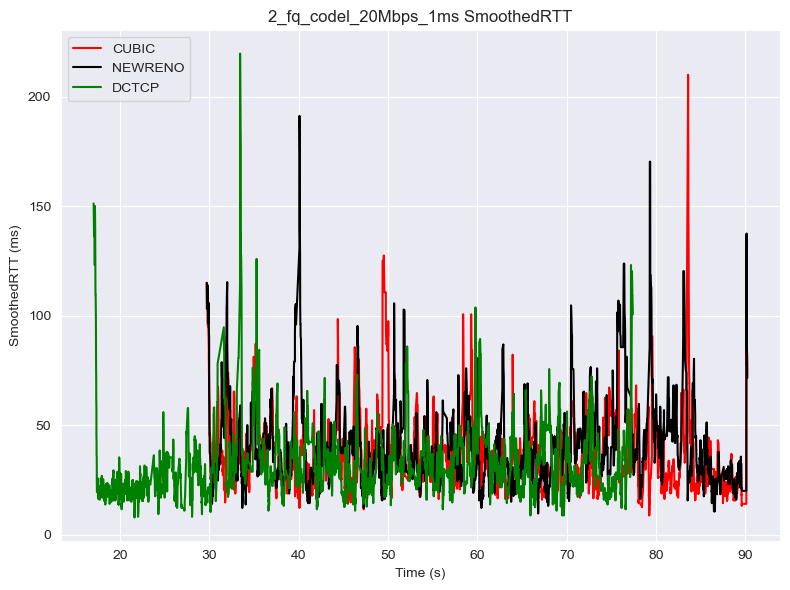

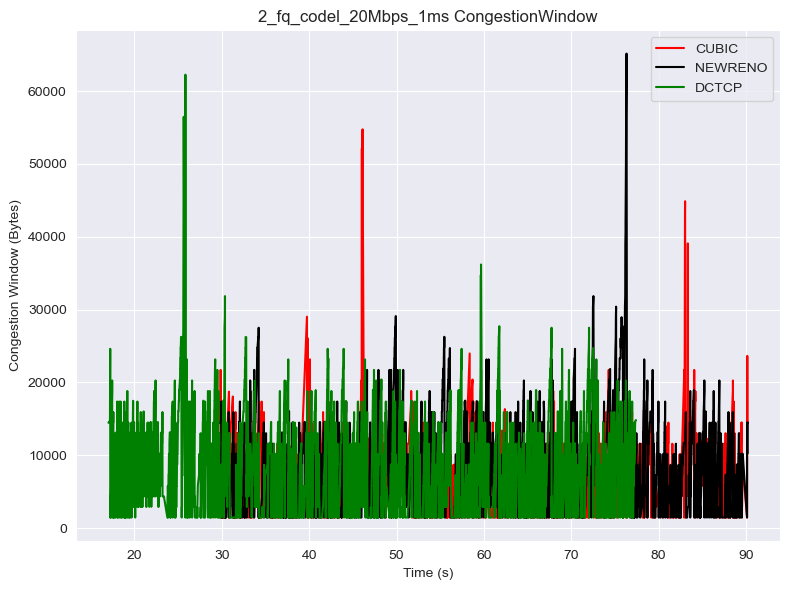


Start New Scenario
2_fq_codel_20Mbps_20ms
./Data./client1_data\2_fq_codel_20Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_20Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_20Mbps_20ms:
Statistics for CUBIC:
Median: 758.437
Mean: 814.7945404538162
25th Percentile: 535.625
75th Percentile: 1130.4685
Minimum: 151.562
Maximum: 1298.125
Statistics for NEWRENO:
Median: 588.75
Mean: 698.0649440909091
25th Percentile: 483.04675
75th Percentile: 1061.01525
Minimum: 160.0
Maximum: 1343.75
Statistics for DCTCP:
Median: 625.312
Mean: 757.089607256076
25th Percentile: 507.031
75th Percentile: 1092.9685
Minimum: 177.187
Maximum: 1231.562
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_20Mbps_20ms_rtt_stats.txt



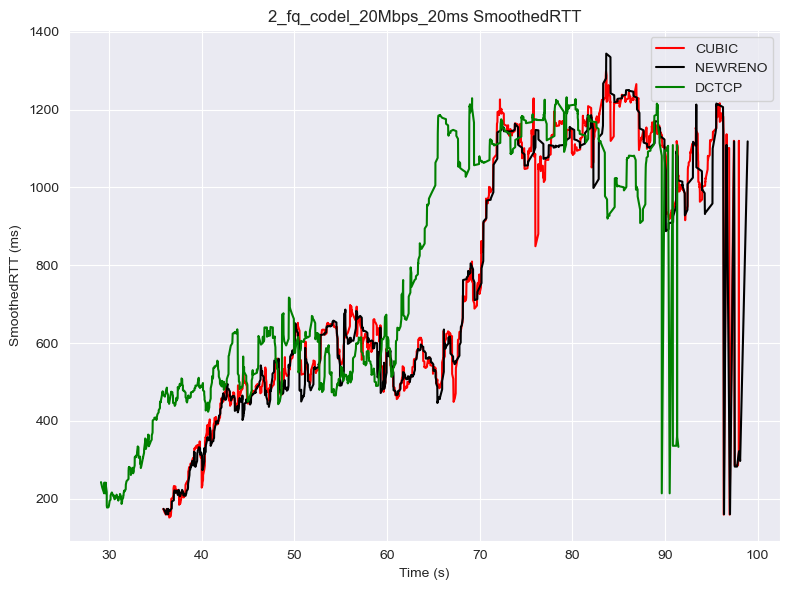

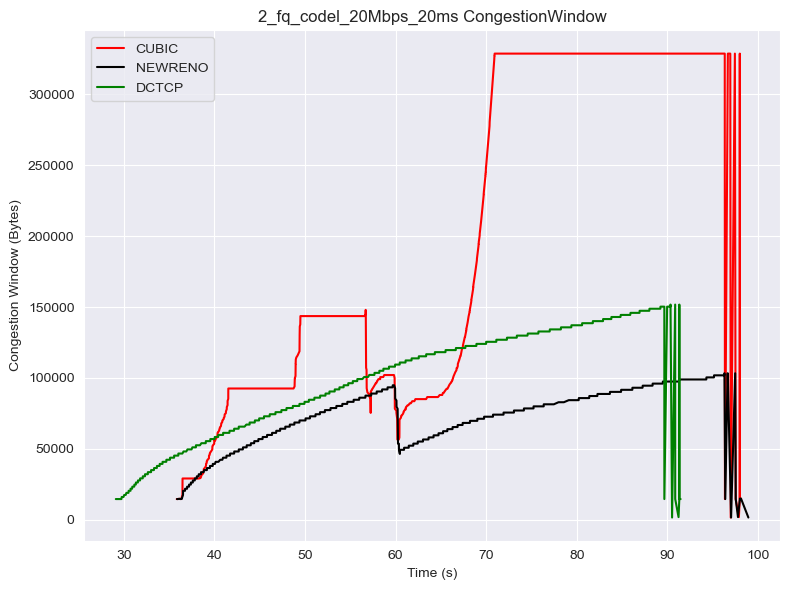


Start New Scenario
2_fq_codel_20Mbps_5ms
./Data./client1_data\2_fq_codel_20Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_20Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_20Mbps_5ms:
Statistics for CUBIC:
Median: 27.812
Mean: 30.101389000863808
25th Percentile: 22.187
75th Percentile: 35.0
Minimum: 9.375
Maximum: 120.0
Statistics for NEWRENO:
Median: 30.312
Mean: 33.176535134239316
25th Percentile: 24.062
75th Percentile: 38.437
Minimum: 9.375
Maximum: 175.312
Statistics for DCTCP:
Median: 26.562
Mean: 29.64170785714286
25th Percentile: 20.859
75th Percentile: 35.312
Minimum: 7.812
Maximum: 120.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_20Mbps_5ms_rtt_stats.txt



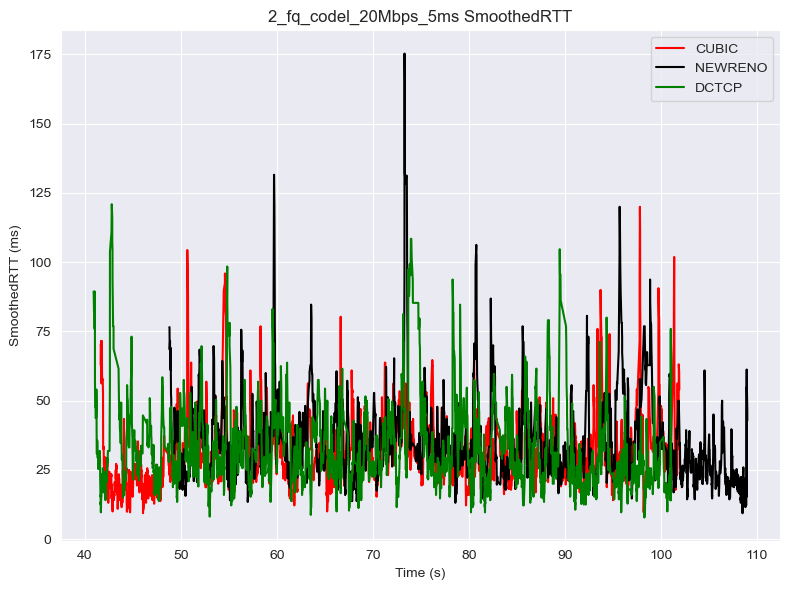

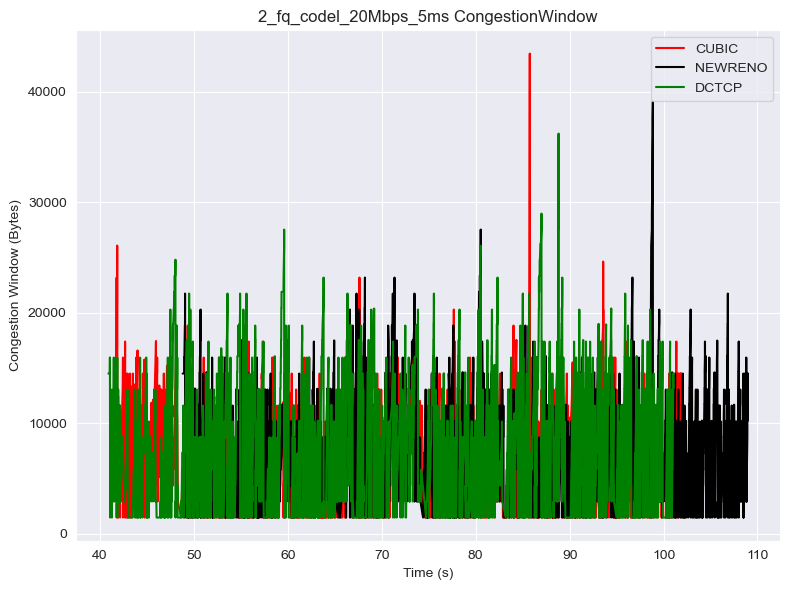


Start New Scenario
2_fq_codel_20Mbps_7ms
./Data./client1_data\2_fq_codel_20Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_20Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_20Mbps_7ms:
Statistics for CUBIC:
Median: 29.687
Mean: 34.4359411294193
25th Percentile: 23.437
75th Percentile: 38.75
Minimum: 8.75
Maximum: 210.312
Statistics for NEWRENO:
Median: 27.5
Mean: 31.239845805672907
25th Percentile: 20.937
75th Percentile: 37.5
Minimum: 8.437
Maximum: 164.062
Statistics for DCTCP:
Median: 25.625
Mean: 30.15785046983522
25th Percentile: 20.625
75th Percentile: 34.687
Minimum: 8.75
Maximum: 255.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_20Mbps_7ms_rtt_stats.txt



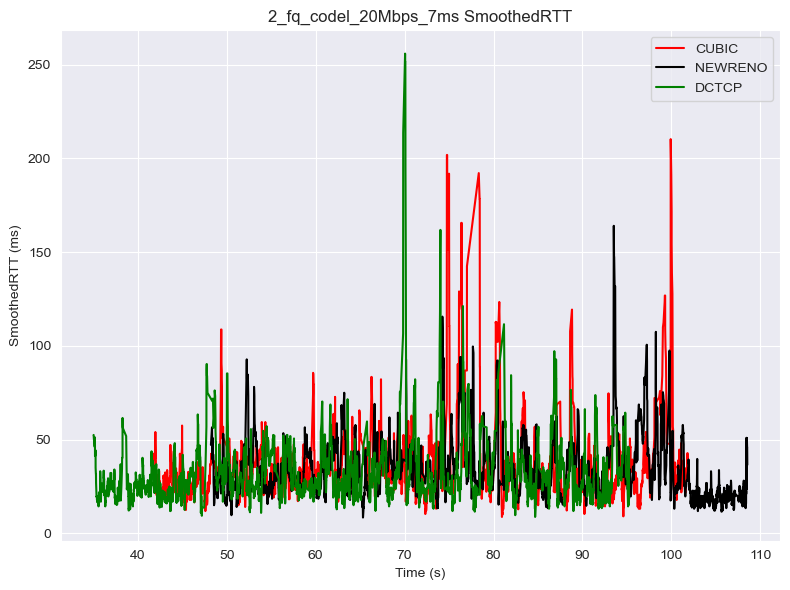

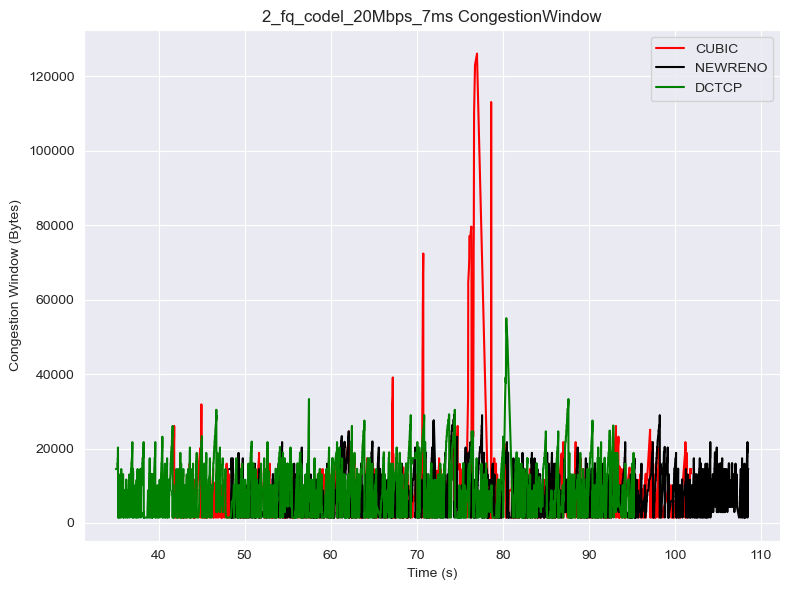


Start New Scenario
2_fq_codel_5Mbps_0ms
./Data./client1_data\2_fq_codel_5Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_5Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_5Mbps_0ms:
Statistics for CUBIC:
Median: 90.312
Mean: 82.213690029615
25th Percentile: 62.812
75th Percentile: 100.937
Minimum: 23.75
Maximum: 223.125
Statistics for NEWRENO:
Median: 104.062
Mean: 105.05341453982986
25th Percentile: 95.625
75th Percentile: 112.5
Minimum: 74.687
Maximum: 220.625
Statistics for DCTCP:
Median: 581.875
Mean: 534.9831061339789
25th Percentile: 510.0
75th Percentile: 610.625
Minimum: 76.875
Maximum: 661.875
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_5Mbps_0ms_rtt_stats.txt



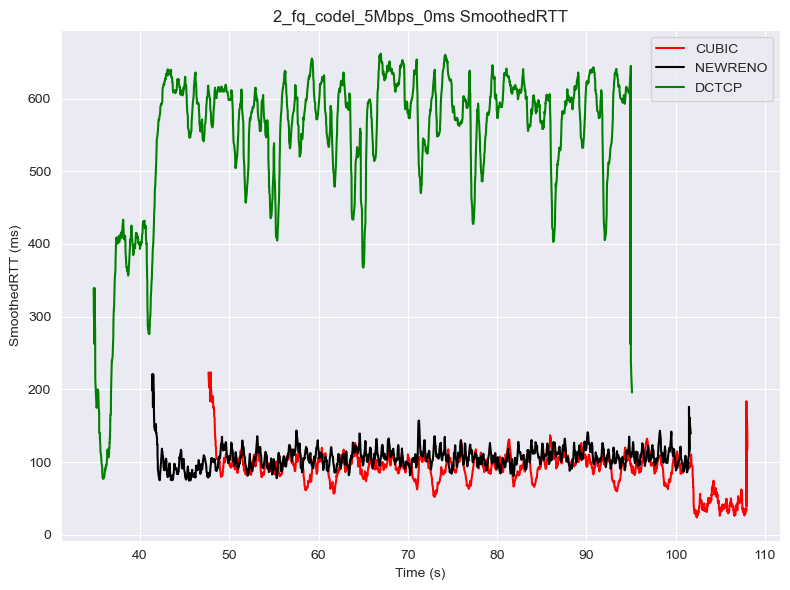

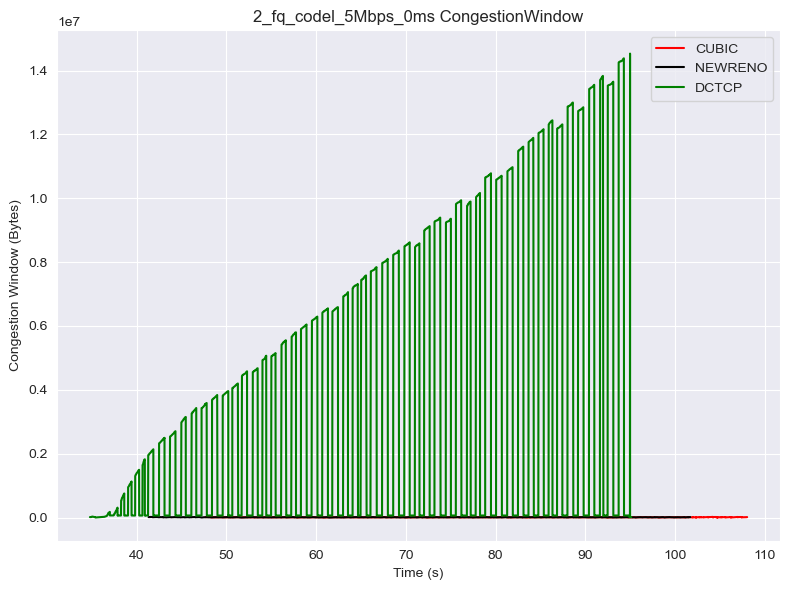


Start New Scenario
2_fq_codel_5Mbps_10ms
./Data./client1_data\2_fq_codel_5Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_5Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_5Mbps_10ms:
Statistics for CUBIC:
Median: 121.875
Mean: 127.95584515664386
25th Percentile: 108.437
75th Percentile: 133.437
Minimum: 76.562
Maximum: 1111.562
Statistics for NEWRENO:
Median: 131.875
Mean: 141.55206
25th Percentile: 123.75
75th Percentile: 140.312
Minimum: 100.0
Maximum: 1107.812
Statistics for DCTCP:
Median: 143.125
Mean: 144.9007654494382
25th Percentile: 130.937
75th Percentile: 156.875
Minimum: 95.625
Maximum: 235.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_5Mbps_10ms_rtt_stats.txt



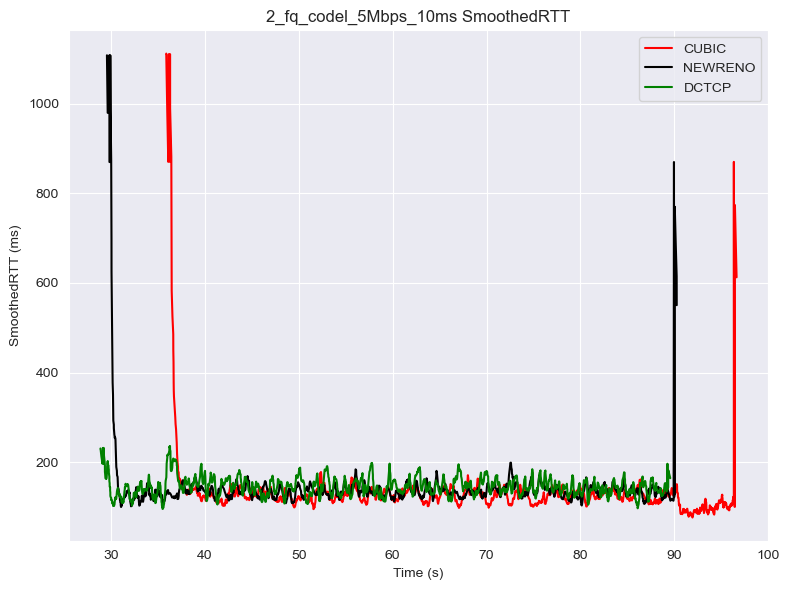

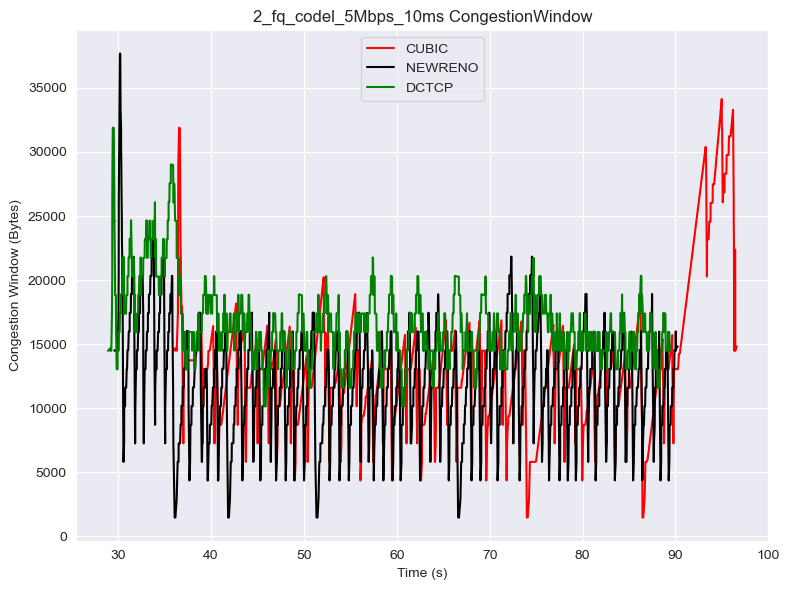


Start New Scenario
2_fq_codel_5Mbps_1ms
./Data./client1_data\2_fq_codel_5Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_5Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_5Mbps_1ms:
Statistics for CUBIC:
Median: 95.937
Mean: 95.64565065334358
25th Percentile: 88.125
75th Percentile: 103.437
Minimum: 58.437
Maximum: 144.687
Statistics for NEWRENO:
Median: 104.687
Mean: 104.9612394366197
25th Percentile: 96.562
75th Percentile: 112.187
Minimum: 76.25
Maximum: 148.75
Statistics for DCTCP:
Median: 591.875
Mean: 500.55733168316834
25th Percentile: 513.67175
75th Percentile: 619.687
Minimum: 72.5
Maximum: 660.312
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_5Mbps_1ms_rtt_stats.txt



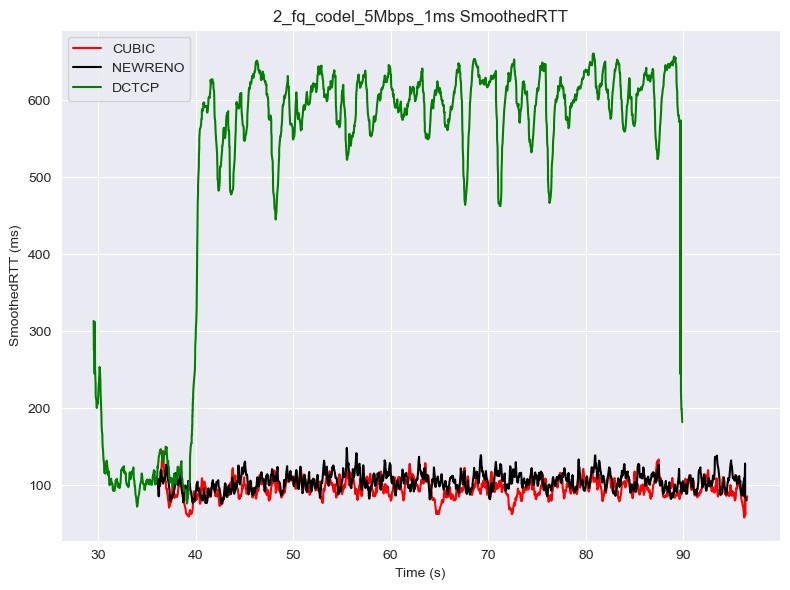

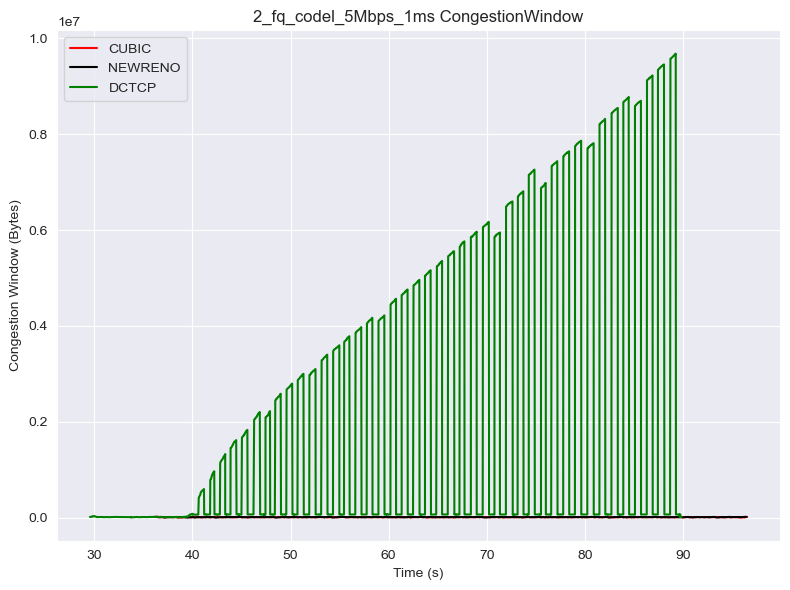


Start New Scenario
2_fq_codel_5Mbps_20ms
./Data./client1_data\2_fq_codel_5Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_5Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_5Mbps_20ms:
Statistics for CUBIC:
Median: 175.937
Mean: 179.46273195441114
25th Percentile: 165.937
75th Percentile: 187.812
Minimum: 135.937
Maximum: 493.75
Statistics for NEWRENO:
Median: 178.125
Mean: 181.03680430013162
25th Percentile: 169.375
75th Percentile: 188.437
Minimum: 142.812
Maximum: 493.75
Statistics for DCTCP:
Median: 321.25
Mean: 351.53995859429364
25th Percentile: 194.375
75th Percentile: 514.92175
Minimum: 142.187
Maximum: 636.562
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_5Mbps_20ms_rtt_stats.txt



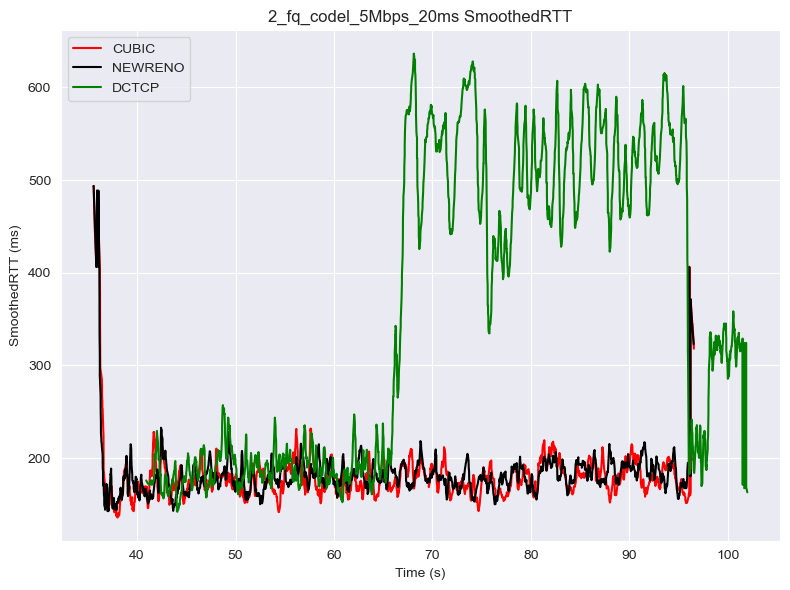

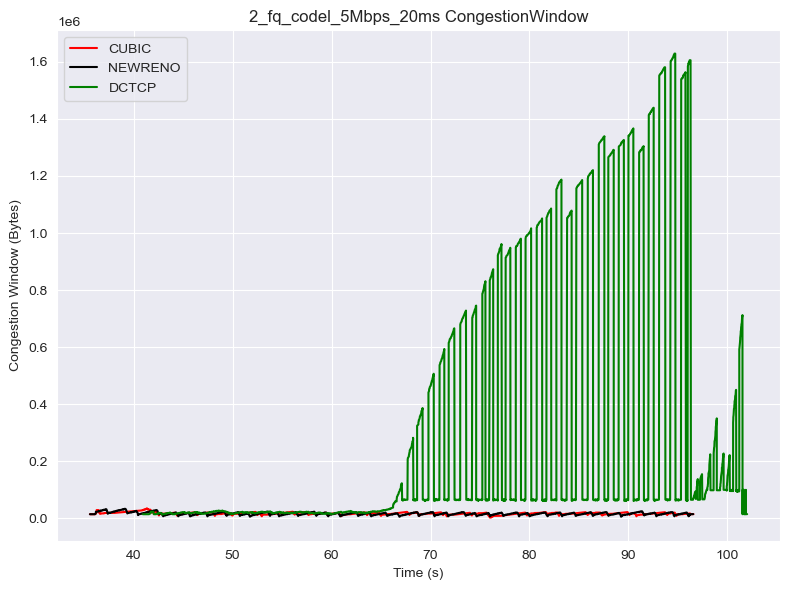


Start New Scenario
2_fq_codel_5Mbps_5ms
./Data./client1_data\2_fq_codel_5Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_5Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_5Mbps_5ms:
Statistics for CUBIC:
Median: 6900.937
Mean: 7305.580213785047
25th Percentile: 2196.562
75th Percentile: 11815.39025
Minimum: 46.25
Maximum: 16914.062
Statistics for NEWRENO:
Median: 4976.875
Mean: 6325.413966129699
25th Percentile: 1464.687
75th Percentile: 11140.312
Minimum: 36.875
Maximum: 15773.437
Statistics for DCTCP:
Median: 118.281
Mean: 126.06022698907957
25th Percentile: 111.562
75th Percentile: 129.062
Minimum: 91.25
Maximum: 295.625
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_5Mbps_5ms_rtt_stats.txt



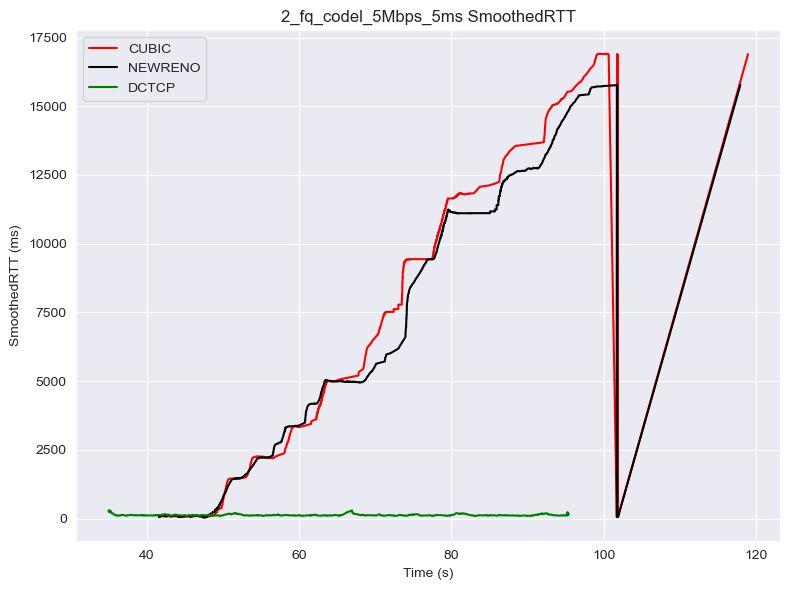

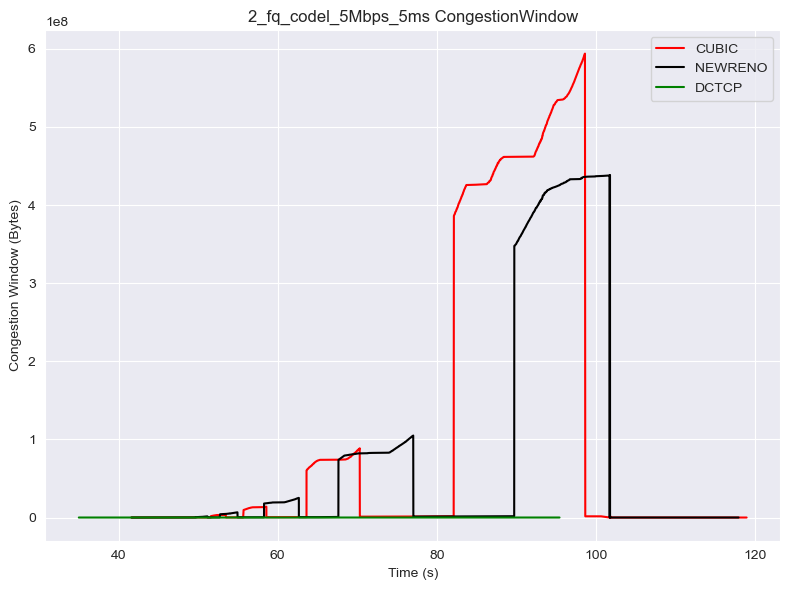


Start New Scenario
2_fq_codel_5Mbps_7ms
./Data./client1_data\2_fq_codel_5Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_5Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_5Mbps_7ms:
Statistics for CUBIC:
Median: 91.562
Mean: 110.93224393882878
25th Percentile: 84.375
75th Percentile: 99.687
Minimum: 52.5
Maximum: 2756.875
Statistics for NEWRENO:
Median: 97.812
Mean: 121.05235666666667
25th Percentile: 90.625
75th Percentile: 105.312
Minimum: 75.312
Maximum: 2754.375
Statistics for DCTCP:
Median: 588.125
Mean: 489.6794261689909
25th Percentile: 516.71825
75th Percentile: 610.312
Minimum: 78.75
Maximum: 646.562
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_5Mbps_7ms_rtt_stats.txt



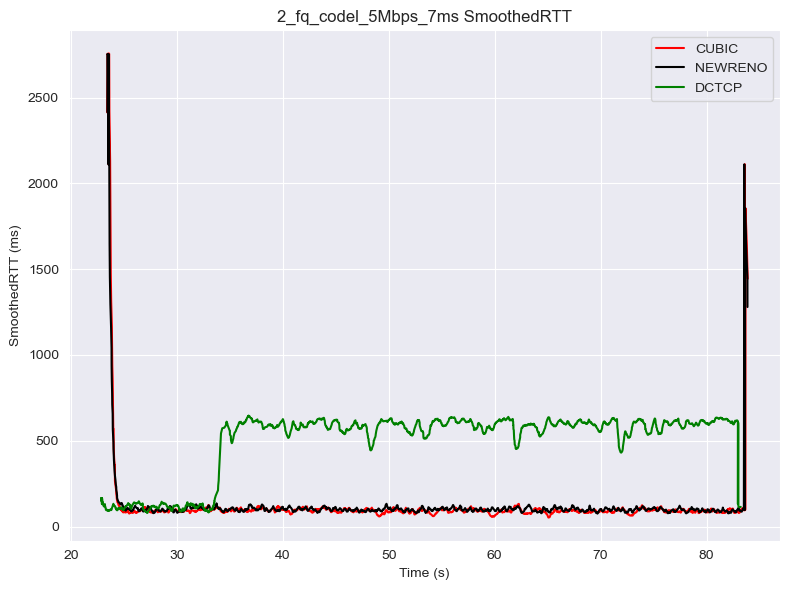

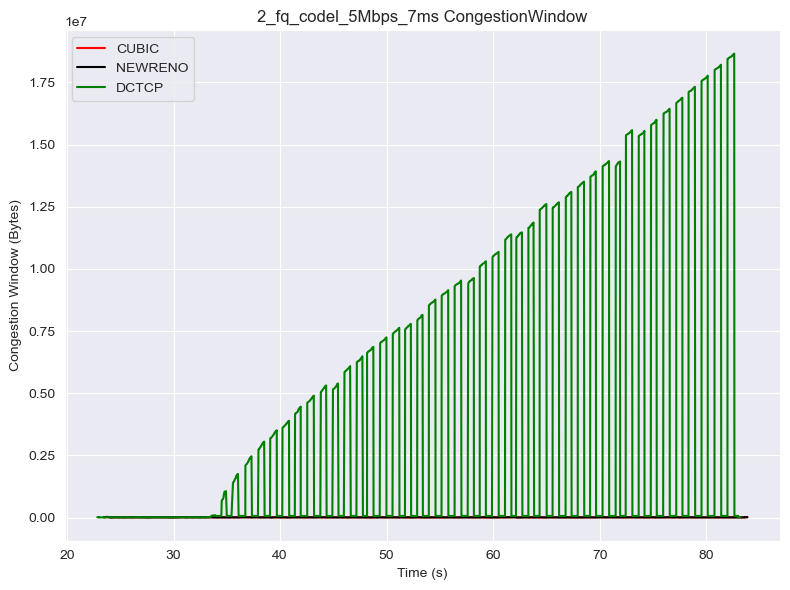


Start New Scenario
2_fq_codel_8Mbps_0ms
./Data./client1_data\2_fq_codel_8Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_8Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_8Mbps_0ms:
Statistics for CUBIC:
Median: 1952.187
Mean: 1412.1967356580426
25th Percentile: 175.937
75th Percentile: 2009.14025
Minimum: 23.437
Maximum: 2103.125
Statistics for NEWRENO:
Median: 110.0
Mean: 105.08024571126946
25th Percentile: 92.5
75th Percentile: 123.437
Minimum: 28.75
Maximum: 269.687
Statistics for DCTCP:
Median: 369.062
Mean: 289.3709942471235
25th Percentile: 144.453
75th Percentile: 396.25
Minimum: 14.687
Maximum: 509.687
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_8Mbps_0ms_rtt_stats.txt



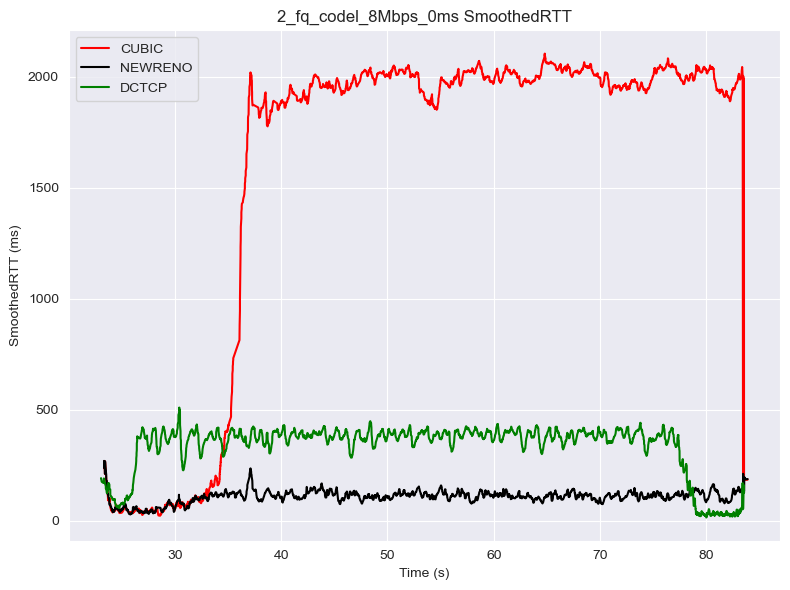

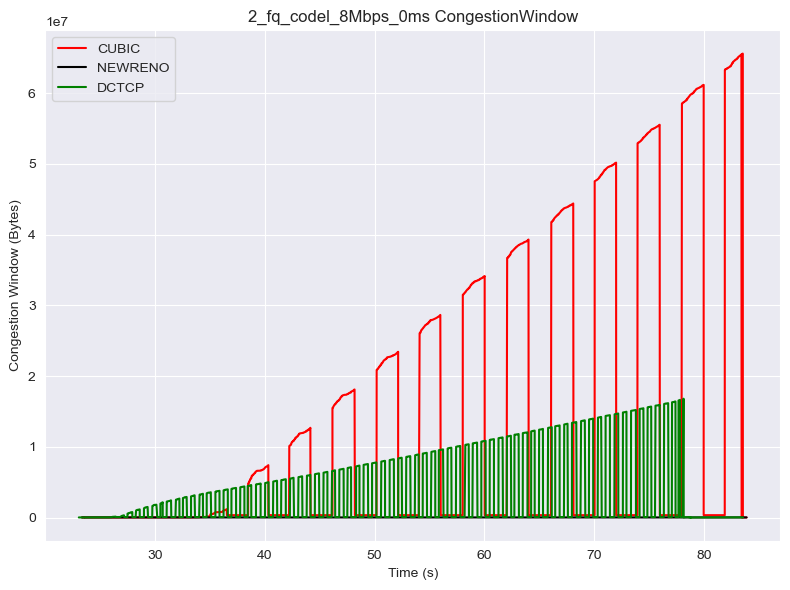


Start New Scenario
2_fq_codel_8Mbps_10ms
./Data./client1_data\2_fq_codel_8Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_8Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_8Mbps_10ms:
Statistics for CUBIC:
Median: 381.25
Mean: 375.7474562438544
25th Percentile: 262.5
75th Percentile: 481.25
Minimum: 89.375
Maximum: 699.375
Statistics for NEWRENO:
Median: 258.437
Mean: 270.136554088586
25th Percentile: 209.062
75th Percentile: 317.96825
Minimum: 90.937
Maximum: 540.625
Statistics for DCTCP:
Median: 624.062
Mean: 574.6458040712467
25th Percentile: 369.687
75th Percentile: 757.5
Minimum: 113.125
Maximum: 1015.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_8Mbps_10ms_rtt_stats.txt



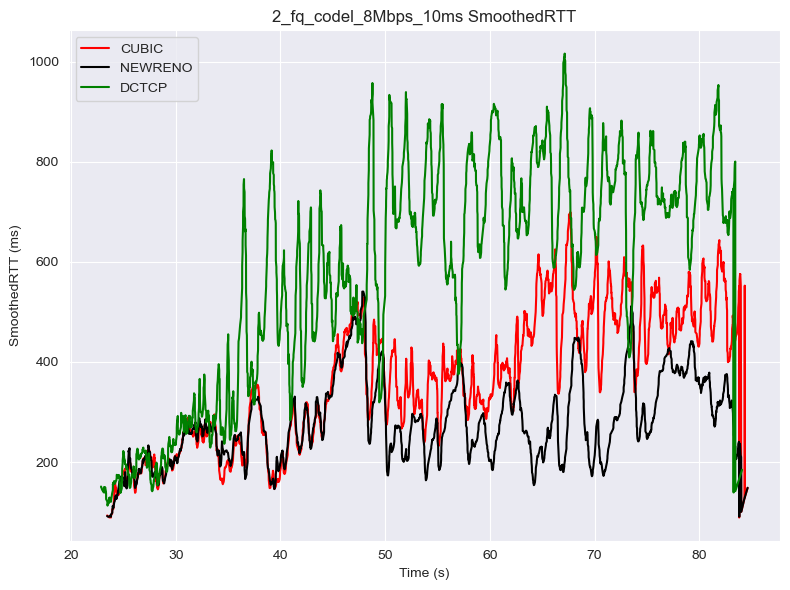

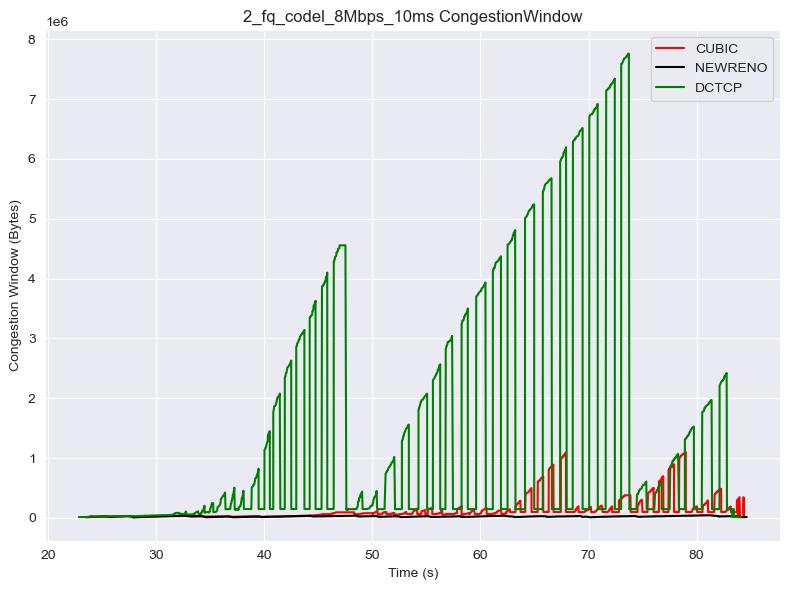


Start New Scenario
2_fq_codel_8Mbps_1ms
./Data./client1_data\2_fq_codel_8Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_8Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_8Mbps_1ms:
Statistics for CUBIC:
Median: 73.75
Mean: 320.1492897928247
25th Percentile: 52.812
75th Percentile: 784.375
Minimum: 15.0
Maximum: 1034.687
Statistics for NEWRENO:
Median: 57.187
Mean: 72.57085348673398
25th Percentile: 39.687
75th Percentile: 87.031
Minimum: 15.937
Maximum: 367.187
Statistics for DCTCP:
Median: 65.0
Mean: 144.8120038119441
25th Percentile: 48.437
75th Percentile: 271.0935
Minimum: 23.75
Maximum: 453.75
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_8Mbps_1ms_rtt_stats.txt



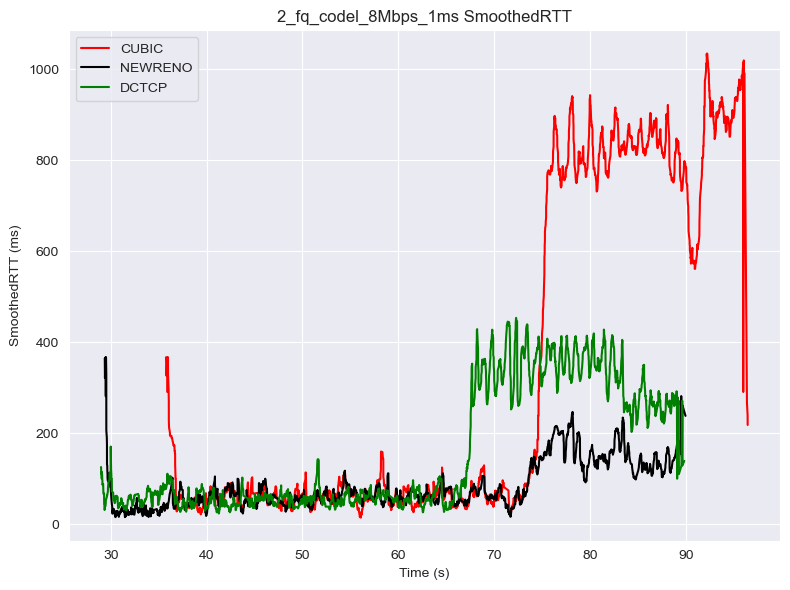

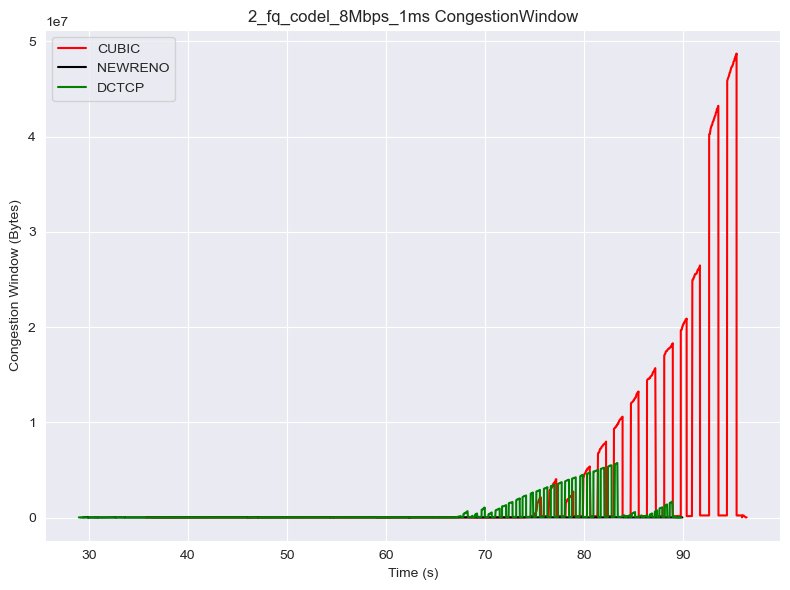


Start New Scenario
2_fq_codel_8Mbps_20ms
./Data./client1_data\2_fq_codel_8Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_8Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_8Mbps_20ms:
Statistics for CUBIC:
Median: 310.781
Mean: 318.8197022980501
25th Percentile: 210.937
75th Percentile: 400.39025000000004
Minimum: 130.625
Maximum: 620.312
Statistics for NEWRENO:
Median: 348.437
Mean: 357.1848385391639
25th Percentile: 294.375
75th Percentile: 411.562
Minimum: 181.875
Maximum: 661.25
Statistics for DCTCP:
Median: 640.625
Mean: 630.1200599197923
25th Percentile: 490.156
75th Percentile: 774.687
Minimum: 170.312
Maximum: 1190.0
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_8Mbps_20ms_rtt_stats.txt



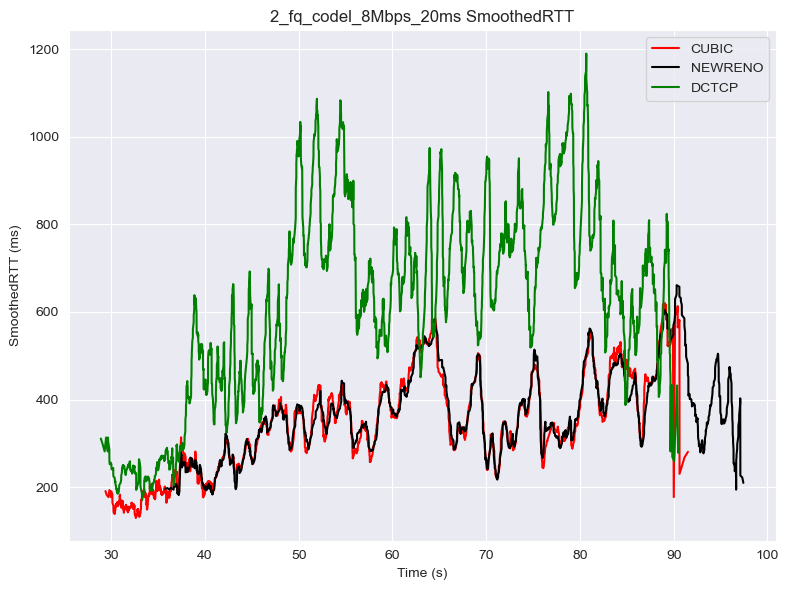

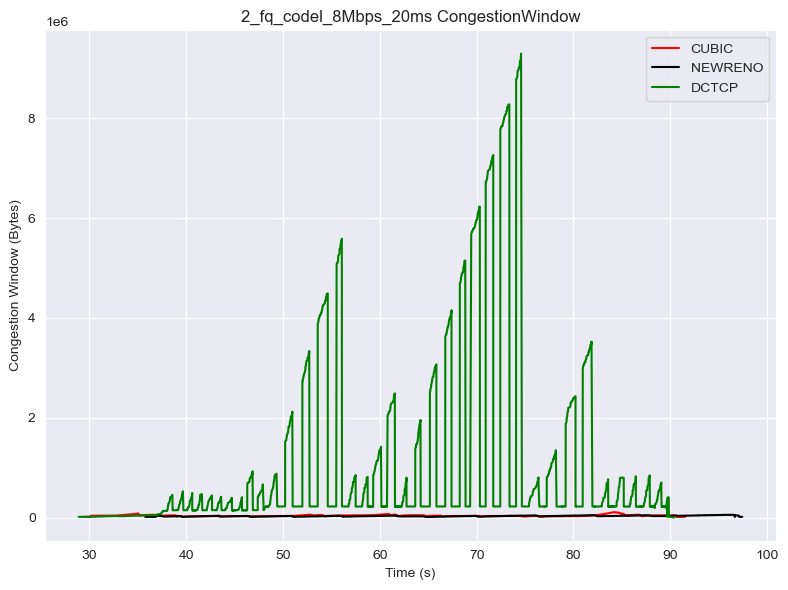


Start New Scenario
2_fq_codel_8Mbps_5ms
./Data./client1_data\2_fq_codel_8Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_8Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_8Mbps_5ms:
Statistics for CUBIC:
Median: 52.5
Mean: 57.74423550973654
25th Percentile: 33.437
75th Percentile: 69.687
Minimum: 12.187
Maximum: 286.25
Statistics for NEWRENO:
Median: 59.687
Mean: 64.00609568527919
25th Percentile: 46.875
75th Percentile: 74.375
Minimum: 17.812
Maximum: 271.25
Statistics for DCTCP:
Median: 56.25
Mean: 61.15642024965326
25th Percentile: 41.875
75th Percentile: 73.75
Minimum: 14.687
Maximum: 205.625
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_8Mbps_5ms_rtt_stats.txt



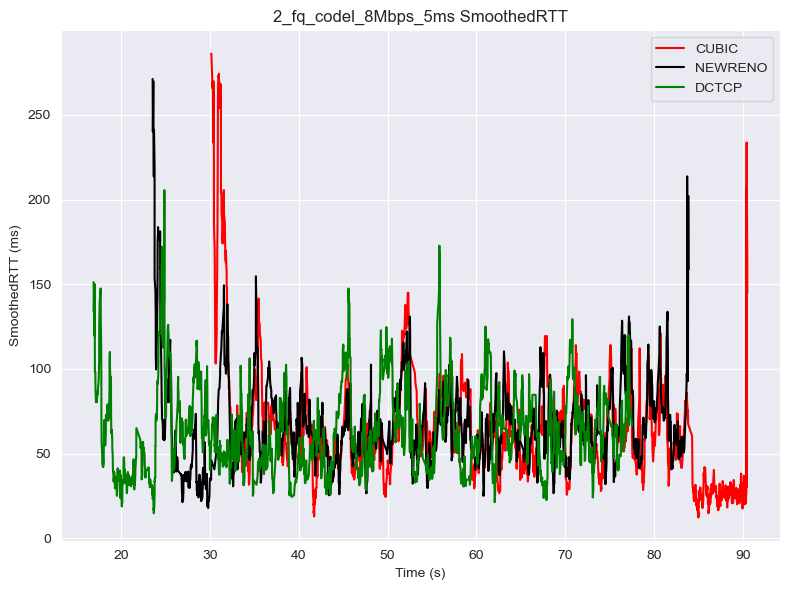

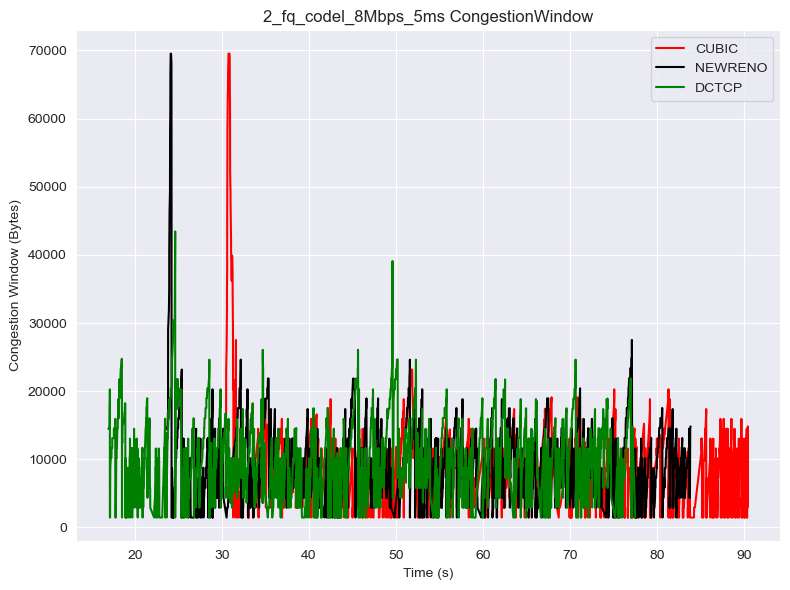


Start New Scenario
2_fq_codel_8Mbps_7ms
./Data./client1_data\2_fq_codel_8Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_codel_8Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_codel_8Mbps_7ms:
Statistics for CUBIC:
Median: 51.562
Mean: 57.17305778839887
25th Percentile: 34.687
75th Percentile: 70.625
Minimum: 12.812
Maximum: 261.875
Statistics for NEWRENO:
Median: 57.812
Mean: 68.33353564547205
25th Percentile: 43.75
75th Percentile: 73.125
Minimum: 17.812
Maximum: 595.0
Statistics for DCTCP:
Median: 55.312
Mean: 60.85282528574761
25th Percentile: 42.5
75th Percentile: 71.875
Minimum: 17.187
Maximum: 392.187
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_codel_8Mbps_7ms_rtt_stats.txt



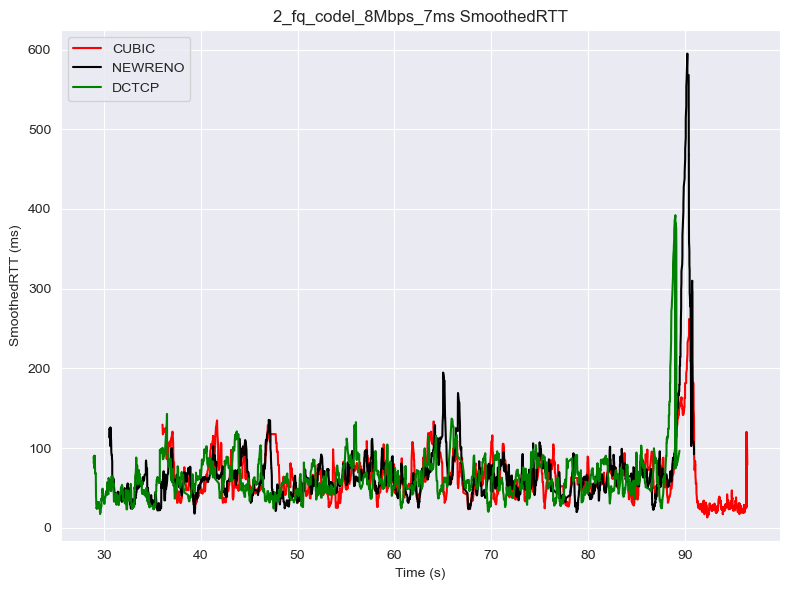

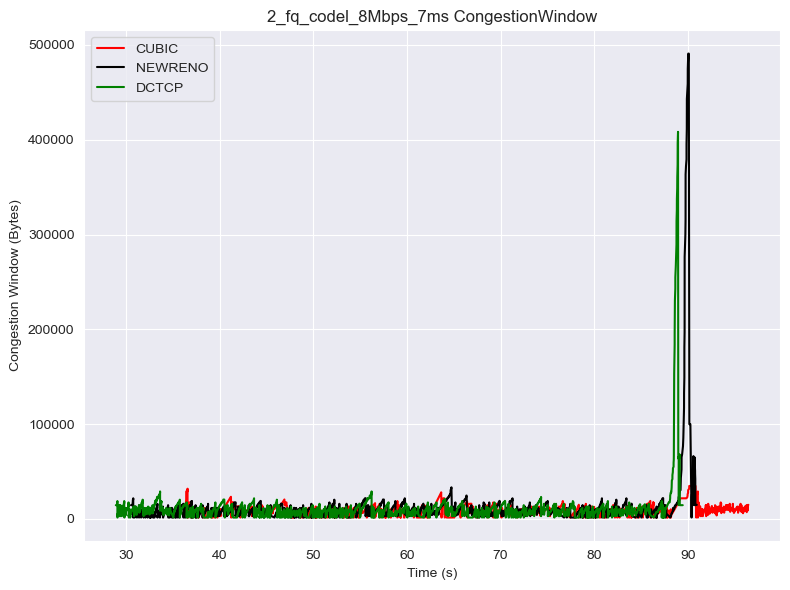


Start New Scenario
2_fq_pie_10Mbps_0ms
./Data./client1_data\2_fq_pie_10Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_10Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_10Mbps_0ms:
Statistics for CUBIC:
Median: 65.625
Mean: 88.5242037586548
25th Percentile: 52.187
75th Percentile: 90.625
Minimum: 25.312
Maximum: 855.937
Statistics for NEWRENO:
Median: 64.062
Mean: 82.50382170283807
25th Percentile: 47.812
75th Percentile: 88.75
Minimum: 20.625
Maximum: 806.562
Statistics for DCTCP:
Median: 60.312
Mean: 82.38325408
25th Percentile: 47.5
75th Percentile: 83.437
Minimum: 24.687
Maximum: 856.875
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_10Mbps_0ms_rtt_stats.txt



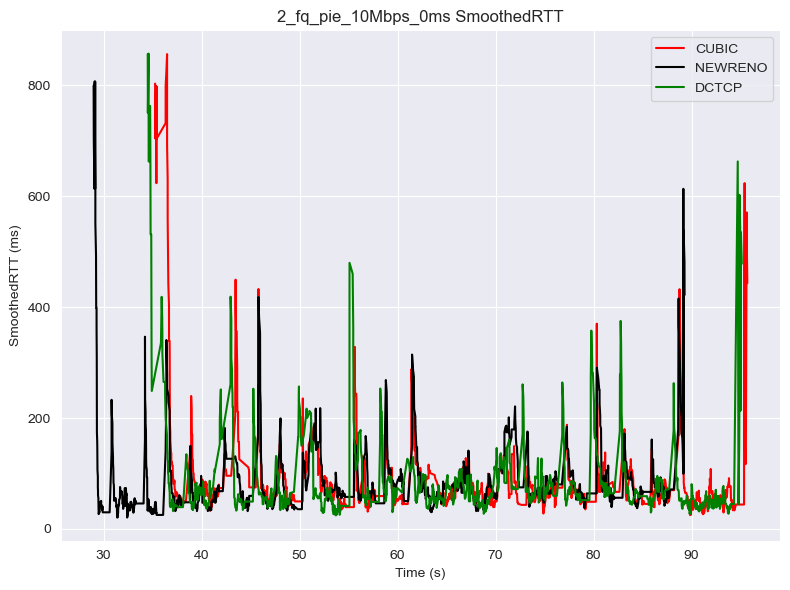

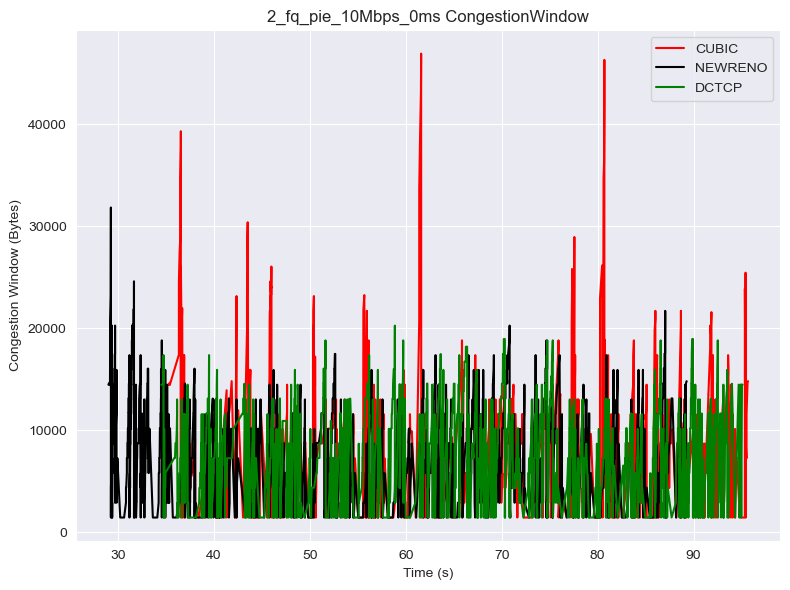


Start New Scenario
2_fq_pie_10Mbps_10ms
./Data./client1_data\2_fq_pie_10Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_10Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_10Mbps_10ms:
Statistics for CUBIC:
Median: 946.0935
Mean: 977.0289203821654
25th Percentile: 768.20275
75th Percentile: 1122.578
Minimum: 131.875
Maximum: 2058.437
Statistics for NEWRENO:
Median: 787.5
Mean: 814.713682214249
25th Percentile: 618.5935
75th Percentile: 957.5
Minimum: 129.375
Maximum: 1880.625
Statistics for DCTCP:
Median: 782.812
Mean: 763.3820251489078
25th Percentile: 507.5
75th Percentile: 1003.359
Minimum: 116.875
Maximum: 2071.562
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_10Mbps_10ms_rtt_stats.txt



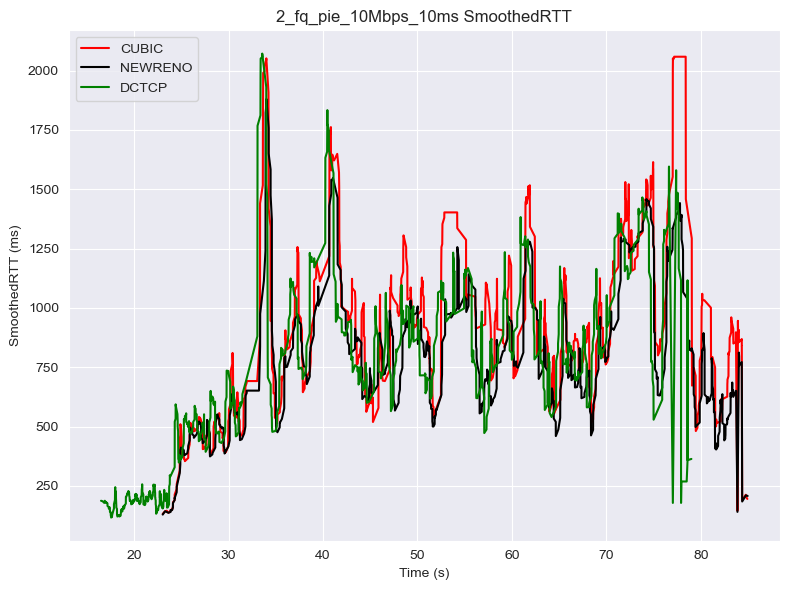

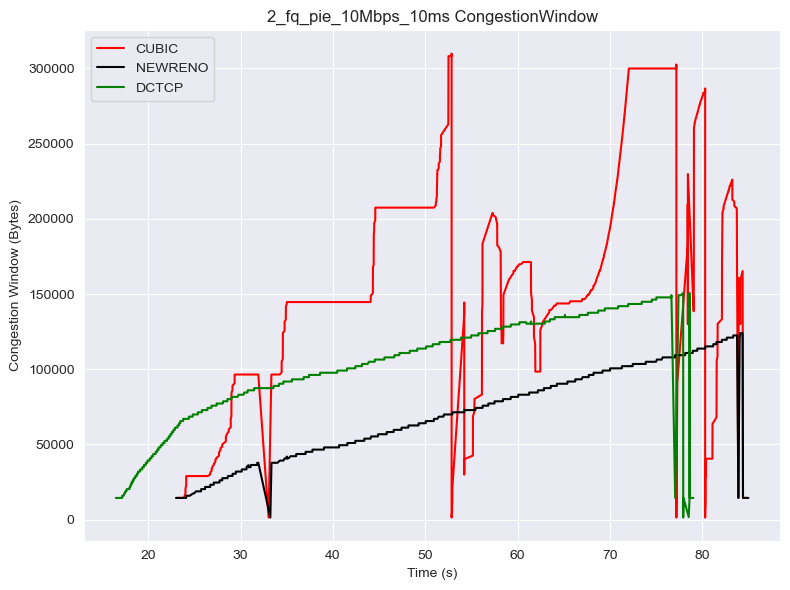


Start New Scenario
2_fq_pie_10Mbps_1ms
./Data./client1_data\2_fq_pie_10Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_10Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_10Mbps_1ms:
Statistics for CUBIC:
Median: 65.937
Mean: 82.4652022106632
25th Percentile: 52.187
75th Percentile: 89.062
Minimum: 24.375
Maximum: 481.562
Statistics for NEWRENO:
Median: 65.937
Mean: 81.04721201657459
25th Percentile: 50.0
75th Percentile: 89.687
Minimum: 18.125
Maximum: 472.5
Statistics for DCTCP:
Median: 63.75
Mean: 82.29212052667117
25th Percentile: 48.125
75th Percentile: 90.625
Minimum: 16.25
Maximum: 483.75
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_10Mbps_1ms_rtt_stats.txt



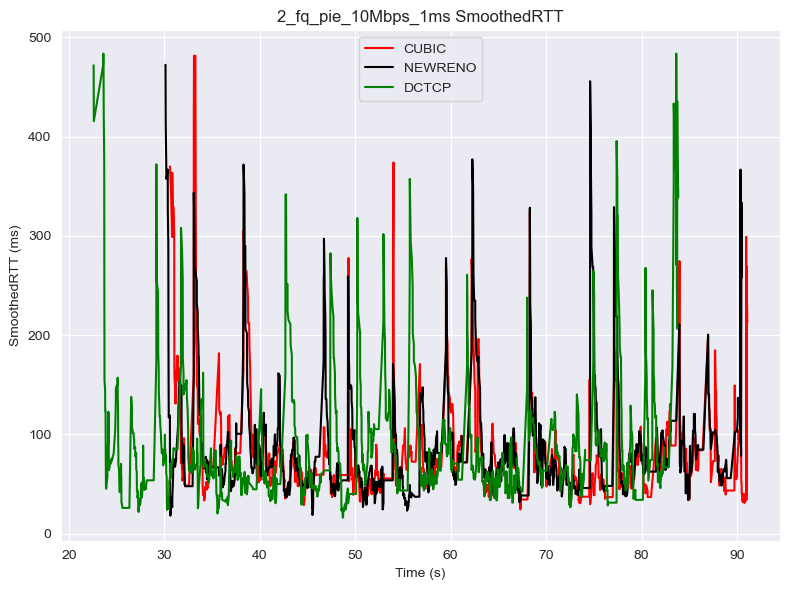

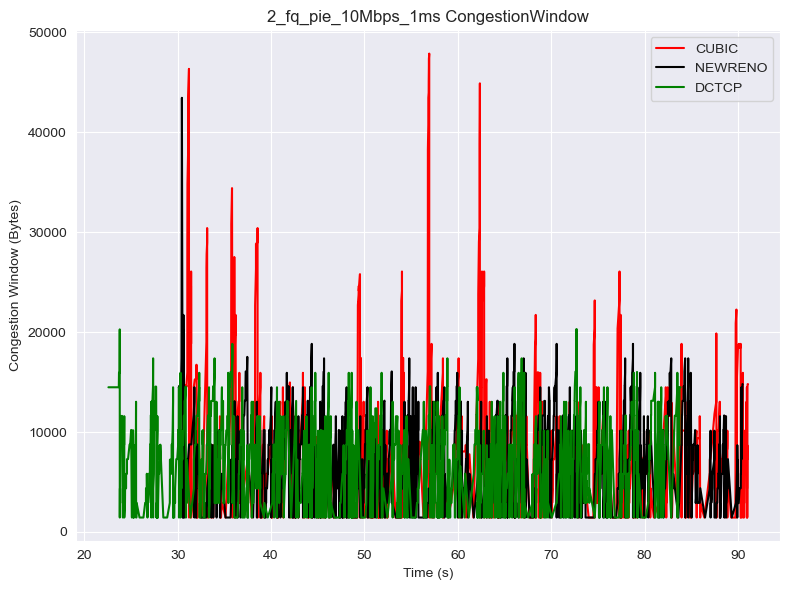


Start New Scenario
2_fq_pie_10Mbps_20ms
./Data./client1_data\2_fq_pie_10Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_10Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_10Mbps_20ms:
Statistics for CUBIC:
Median: 1055.937
Mean: 1094.9745367156208
25th Percentile: 851.25
75th Percentile: 1285.937
Minimum: 218.437
Maximum: 2313.125
Statistics for NEWRENO:
Median: 908.1245
Mean: 949.3218534816247
25th Percentile: 682.187
75th Percentile: 1197.03125
Minimum: 220.625
Maximum: 2088.437
Statistics for DCTCP:
Median: 874.2185
Mean: 949.094756659836
25th Percentile: 614.375
75th Percentile: 1221.953
Minimum: 222.5
Maximum: 2227.5
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_10Mbps_20ms_rtt_stats.txt



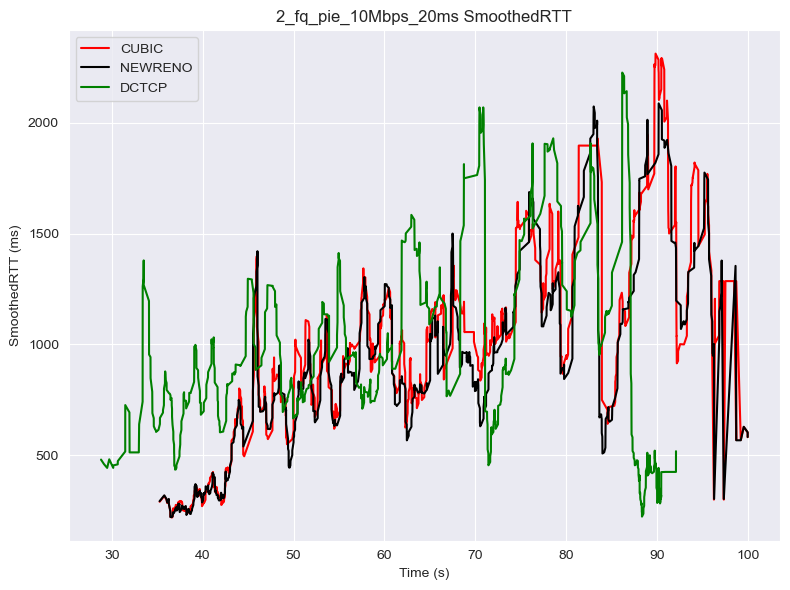

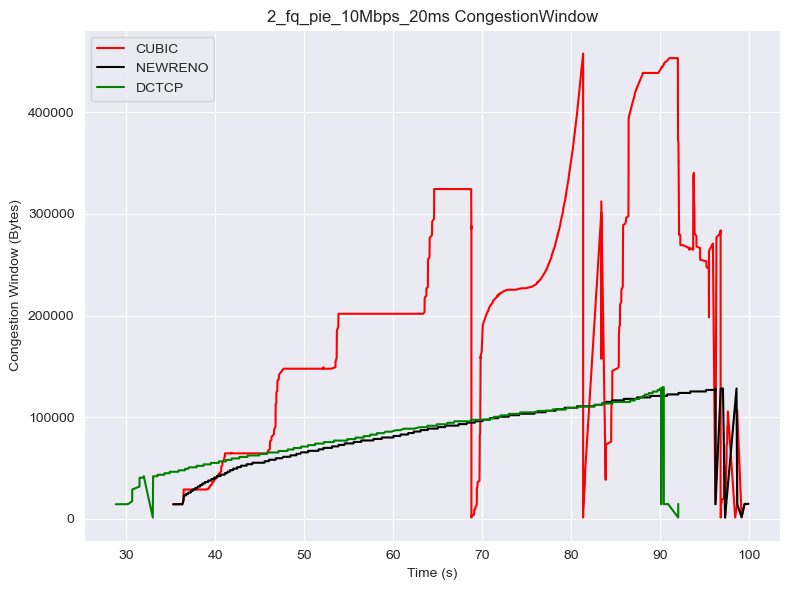


Start New Scenario
2_fq_pie_10Mbps_5ms
./Data./client1_data\2_fq_pie_10Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_10Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_10Mbps_5ms:
Statistics for CUBIC:
Median: 64.062
Mean: 78.14591415384616
25th Percentile: 51.875
75th Percentile: 86.875
Minimum: 24.375
Maximum: 425.937
Statistics for NEWRENO:
Median: 63.437
Mean: 74.35595923913043
25th Percentile: 47.812
75th Percentile: 86.562
Minimum: 20.312
Maximum: 372.812
Statistics for DCTCP:
Median: 61.562
Mean: 76.35174793514837
25th Percentile: 48.75
75th Percentile: 80.0
Minimum: 21.25
Maximum: 523.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_10Mbps_5ms_rtt_stats.txt



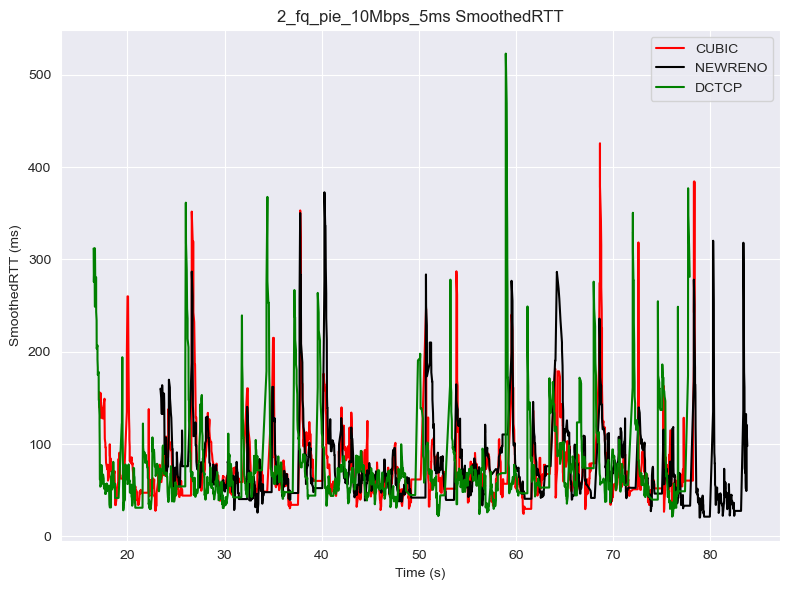

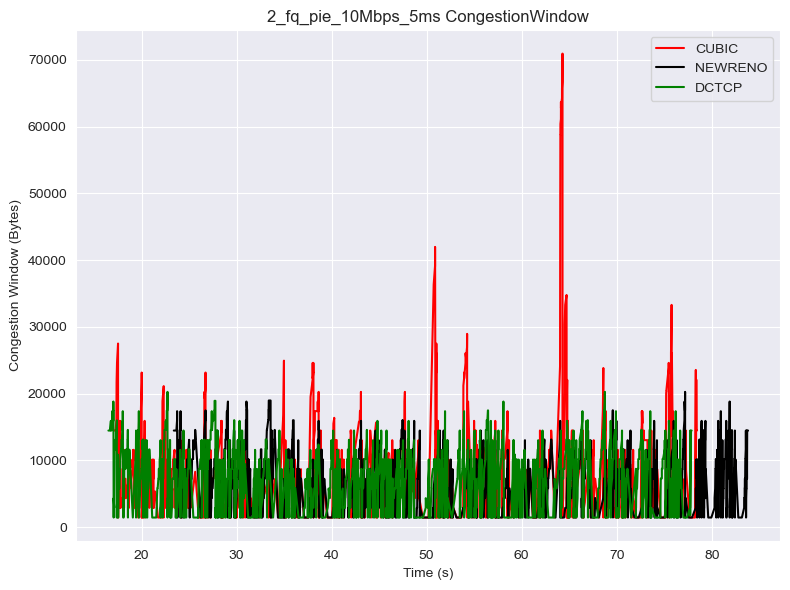


Start New Scenario
2_fq_pie_10Mbps_7ms
./Data./client1_data\2_fq_pie_10Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_10Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_10Mbps_7ms:
Statistics for CUBIC:
Median: 68.75
Mean: 93.01871703114644
25th Percentile: 53.125
75th Percentile: 100.937
Minimum: 23.125
Maximum: 730.0
Statistics for NEWRENO:
Median: 64.375
Mean: 81.1954029441972
25th Percentile: 50.312
75th Percentile: 90.312
Minimum: 25.0
Maximum: 508.125
Statistics for DCTCP:
Median: 63.75
Mean: 82.7286310072416
25th Percentile: 50.0
75th Percentile: 92.109
Minimum: 17.812
Maximum: 498.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_10Mbps_7ms_rtt_stats.txt



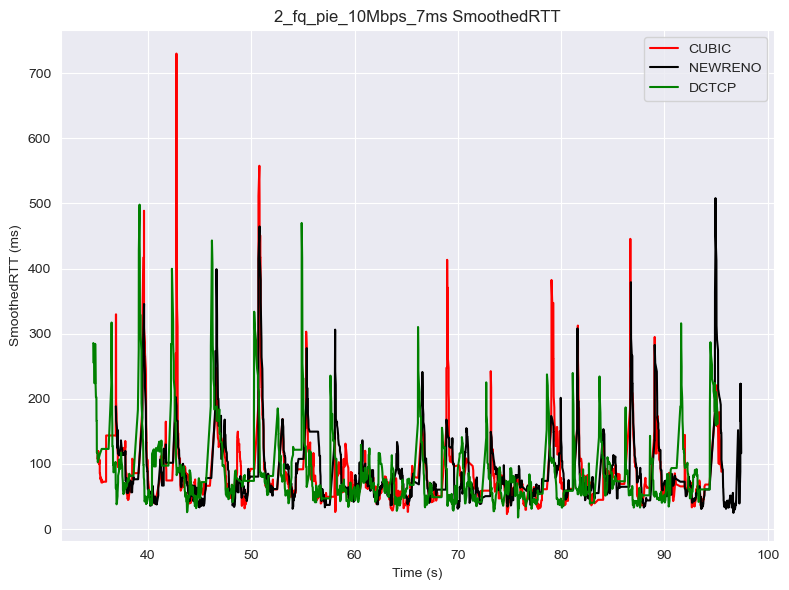

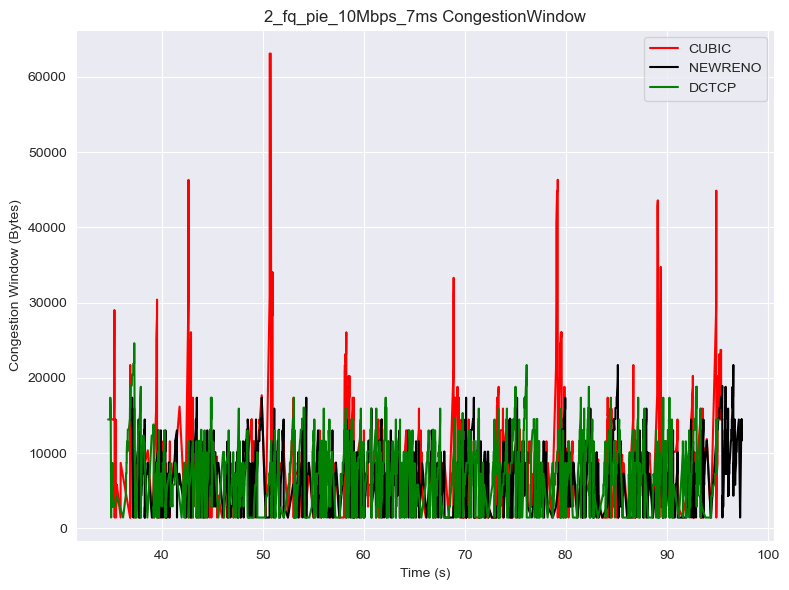


Start New Scenario
2_fq_pie_20Mbps_0ms
./Data./client1_data\2_fq_pie_20Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_20Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_20Mbps_0ms:
Statistics for CUBIC:
Median: 58.125
Mean: 81.31306127235413
25th Percentile: 43.437
75th Percentile: 86.25
Minimum: 16.25
Maximum: 632.187
Statistics for NEWRENO:
Median: 52.812
Mean: 76.46373186440678
25th Percentile: 41.562
75th Percentile: 79.375
Minimum: 20.312
Maximum: 640.937
Statistics for DCTCP:
Median: 46.875
Mean: 67.81604186704384
25th Percentile: 36.875
75th Percentile: 68.75
Minimum: 14.375
Maximum: 820.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_20Mbps_0ms_rtt_stats.txt



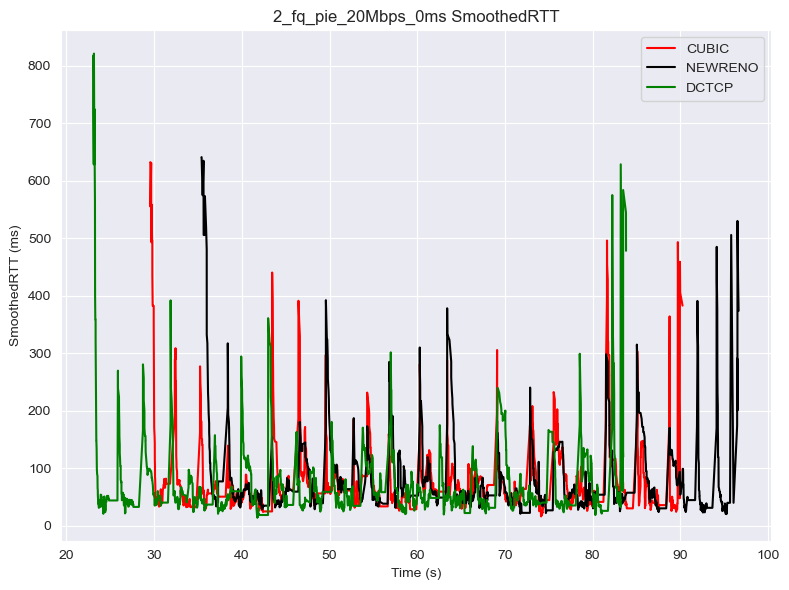

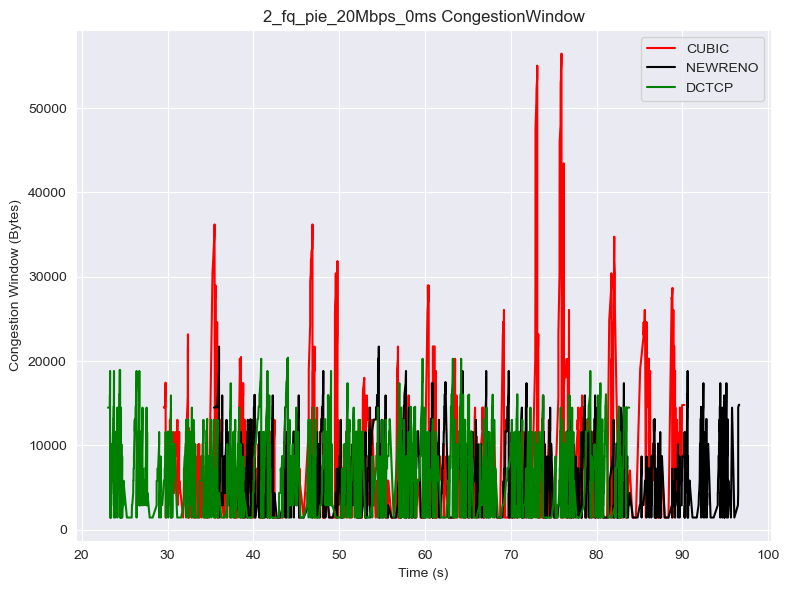


Start New Scenario
2_fq_pie_20Mbps_10ms
./Data./client1_data\2_fq_pie_20Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_20Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_20Mbps_10ms:
Statistics for CUBIC:
Median: 655.0
Mean: 648.2207946103423
25th Percentile: 498.125
75th Percentile: 787.812
Minimum: 119.062
Maximum: 1656.875
Statistics for NEWRENO:
Median: 649.531
Mean: 660.1354045454545
25th Percentile: 529.76525
75th Percentile: 784.3745
Minimum: 119.062
Maximum: 1706.25
Statistics for DCTCP:
Median: 638.125
Mean: 640.6721850152906
25th Percentile: 461.17175
75th Percentile: 786.09325
Minimum: 208.437
Maximum: 1443.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_20Mbps_10ms_rtt_stats.txt



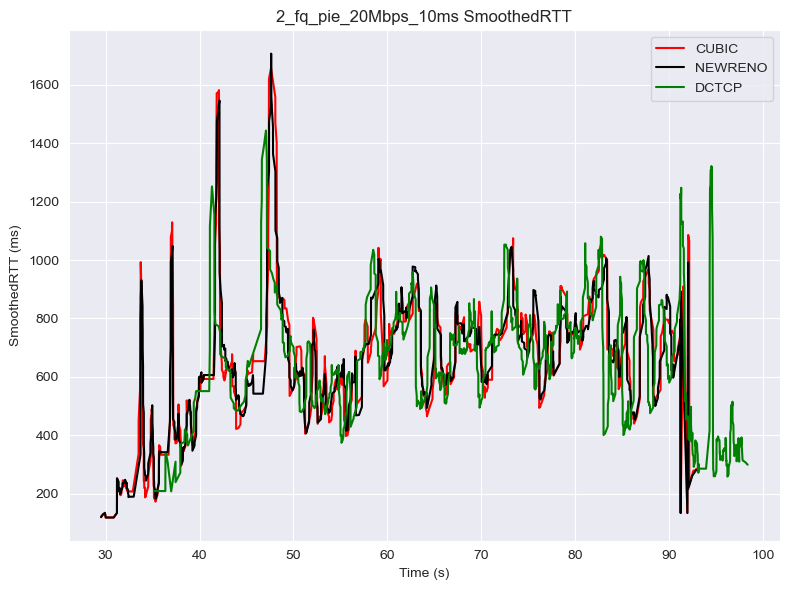

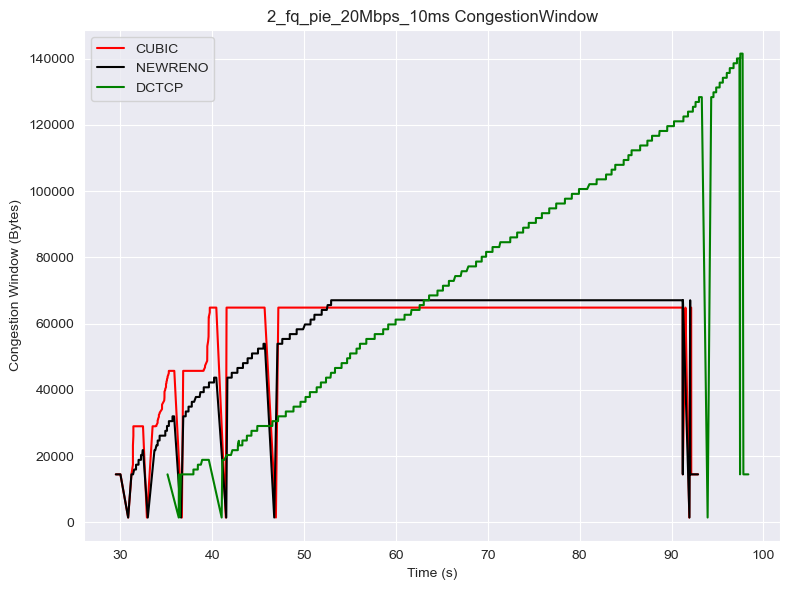


Start New Scenario
2_fq_pie_20Mbps_1ms
./Data./client1_data\2_fq_pie_20Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_20Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_20Mbps_1ms:
Statistics for CUBIC:
Median: 55.312
Mean: 74.44036816246316
25th Percentile: 41.25
75th Percentile: 78.75
Minimum: 10.625
Maximum: 639.687
Statistics for NEWRENO:
Median: 53.437
Mean: 72.77989869385155
25th Percentile: 38.75
75th Percentile: 75.937
Minimum: 13.75
Maximum: 484.375
Statistics for DCTCP:
Median: 48.75
Mean: 68.93585844875346
25th Percentile: 36.25
75th Percentile: 68.125
Minimum: 12.187
Maximum: 504.375
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_20Mbps_1ms_rtt_stats.txt



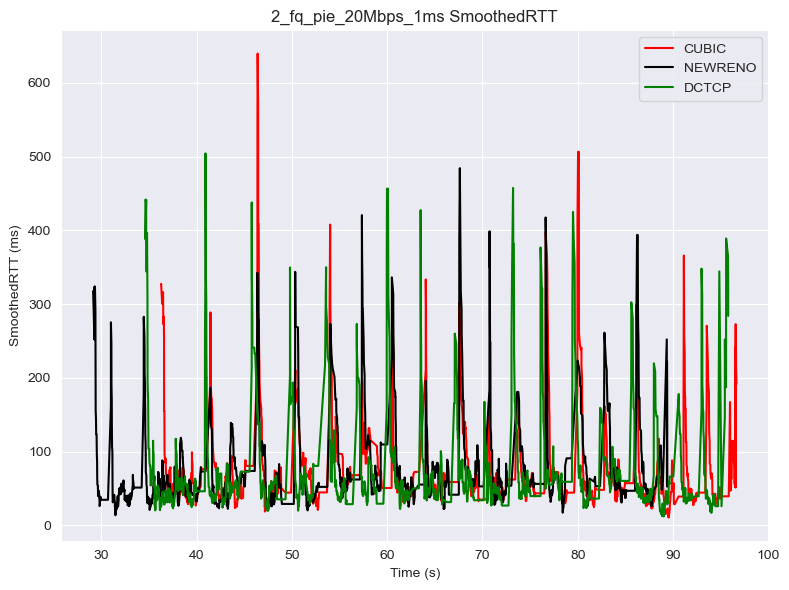

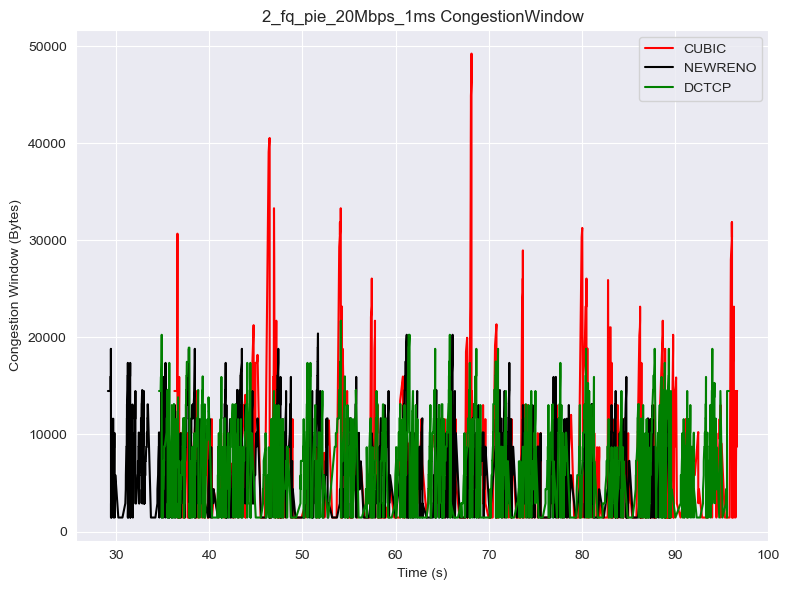


Start New Scenario
2_fq_pie_20Mbps_20ms
./Data./client1_data\2_fq_pie_20Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_20Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_20Mbps_20ms:
Statistics for CUBIC:
Median: 724.375
Mean: 781.5877416502947
25th Percentile: 579.21825
75th Percentile: 904.53125
Minimum: 279.375
Maximum: 2459.062
Statistics for NEWRENO:
Median: 721.25
Mean: 788.5196450094162
25th Percentile: 596.328
75th Percentile: 917.187
Minimum: 285.625
Maximum: 2322.187
Statistics for DCTCP:
Median: 770.312
Mean: 852.3024974772958
25th Percentile: 617.187
75th Percentile: 990.234
Minimum: 245.312
Maximum: 2410.625
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_20Mbps_20ms_rtt_stats.txt



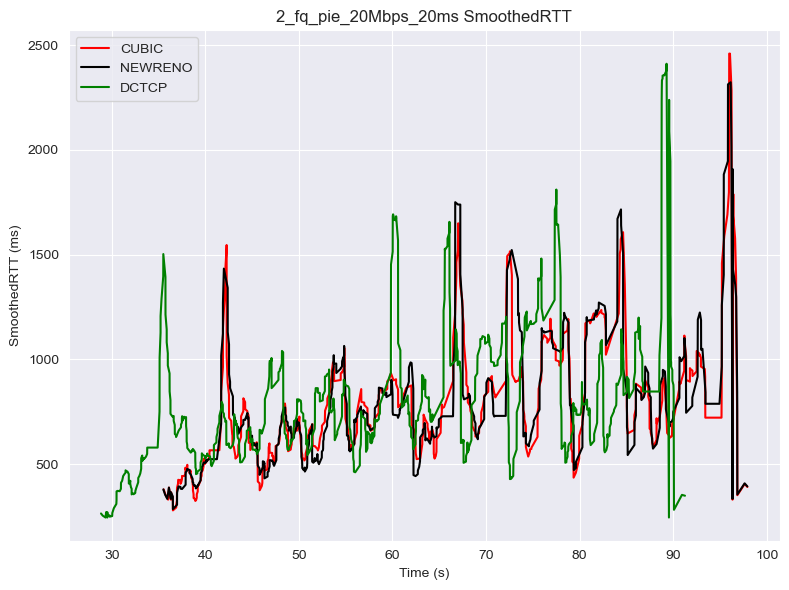

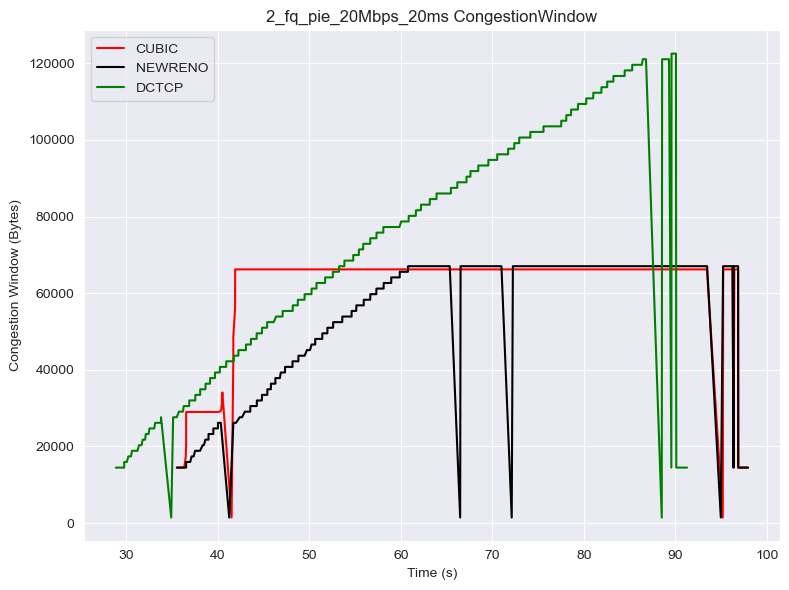


Start New Scenario
2_fq_pie_20Mbps_5ms
./Data./client1_data\2_fq_pie_20Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_20Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_20Mbps_5ms:
Statistics for CUBIC:
Median: 51.25
Mean: 71.9575196049087
25th Percentile: 40.312
75th Percentile: 74.062
Minimum: 17.5
Maximum: 499.375
Statistics for NEWRENO:
Median: 51.562
Mean: 68.35559994180971
25th Percentile: 39.062
75th Percentile: 70.937
Minimum: 14.062
Maximum: 607.5
Statistics for DCTCP:
Median: 45.937
Mean: 62.16028547717843
25th Percentile: 33.75
75th Percentile: 66.25
Minimum: 12.812
Maximum: 560.312
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_20Mbps_5ms_rtt_stats.txt



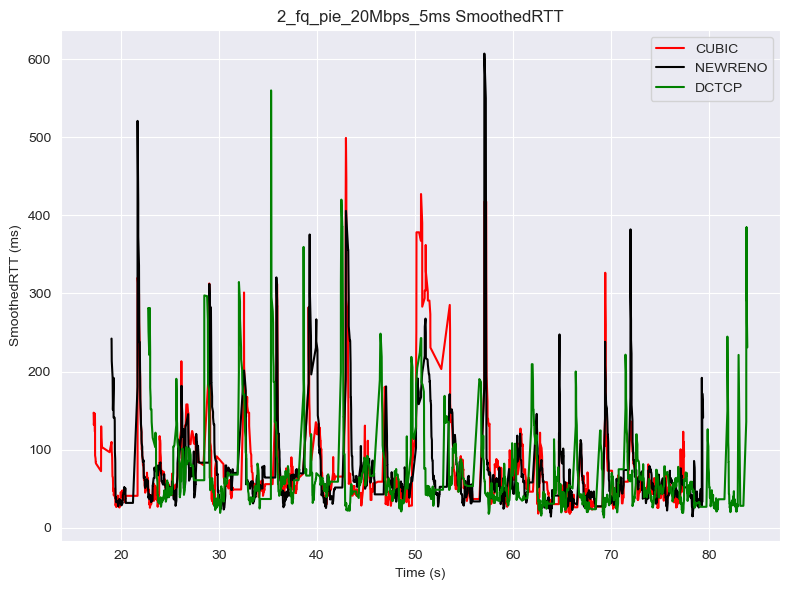

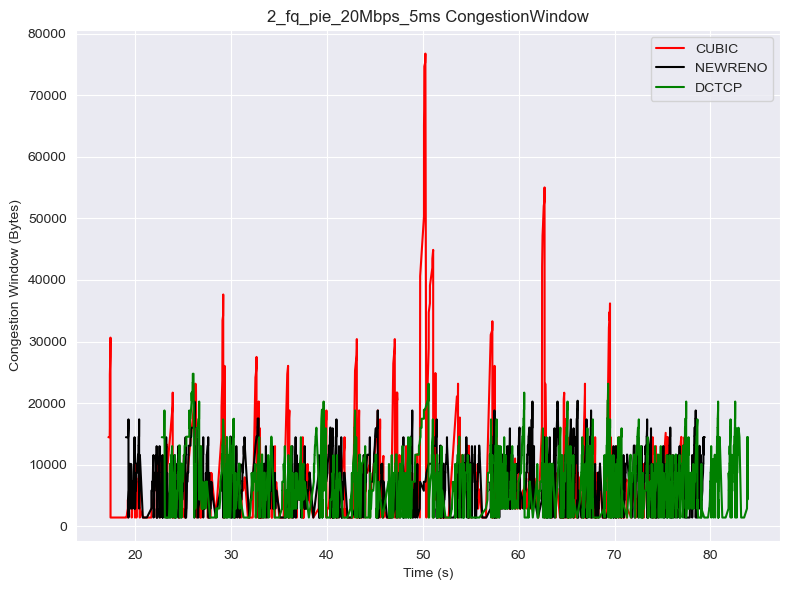


Start New Scenario
2_fq_pie_20Mbps_7ms
./Data./client1_data\2_fq_pie_20Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_20Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_20Mbps_7ms:
Statistics for CUBIC:
Median: 50.937
Mean: 69.18932231962239
25th Percentile: 39.375
75th Percentile: 73.125
Minimum: 12.187
Maximum: 470.625
Statistics for NEWRENO:
Median: 50.625
Mean: 61.028343874954565
25th Percentile: 39.062
75th Percentile: 70.937
Minimum: 16.875
Maximum: 461.875
Statistics for DCTCP:
Median: 52.5
Mean: 72.18571797418073
25th Percentile: 39.062
75th Percentile: 75.0
Minimum: 15.625
Maximum: 593.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_20Mbps_7ms_rtt_stats.txt



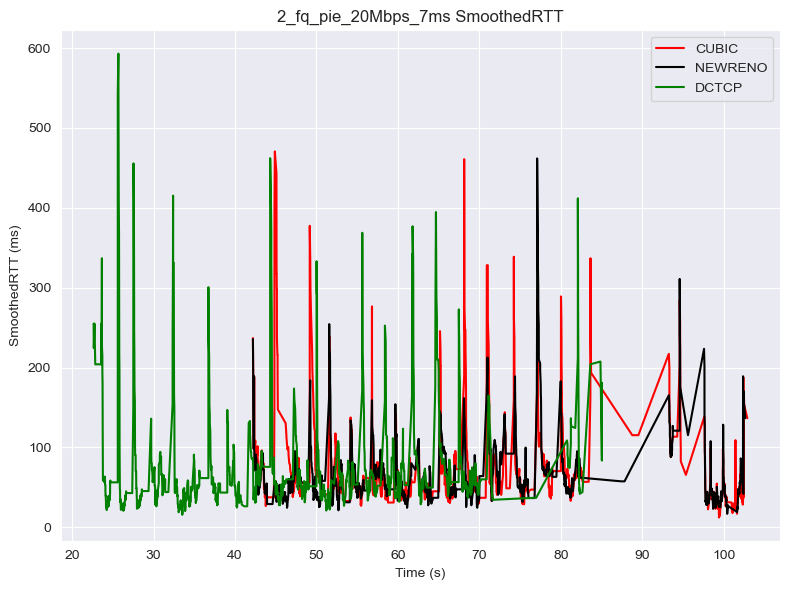

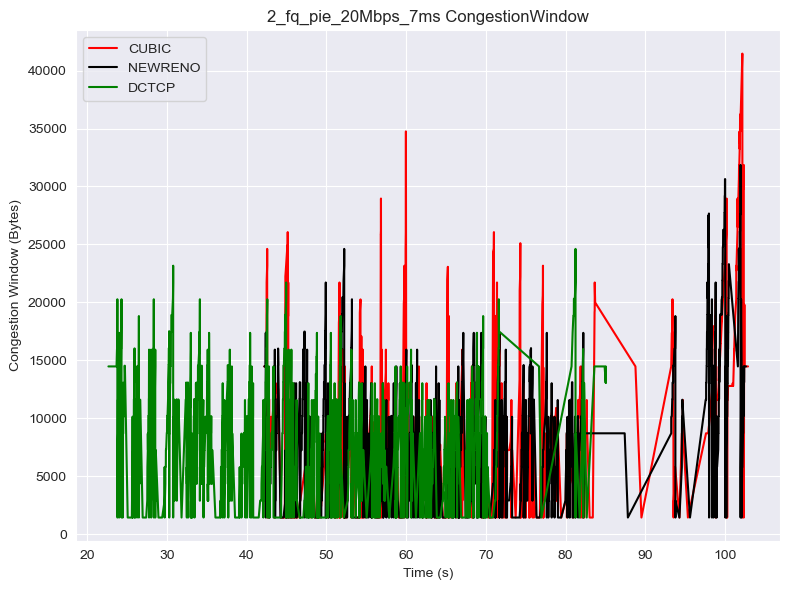


Start New Scenario
2_fq_pie_5Mbps_0ms
./Data./client1_data\2_fq_pie_5Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_5Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_5Mbps_0ms:
Statistics for CUBIC:
Median: 144.062
Mean: 188.13891996442862
25th Percentile: 106.25
75th Percentile: 221.25
Minimum: 41.875
Maximum: 780.625
Statistics for NEWRENO:
Median: 138.437
Mean: 172.57887152941174
25th Percentile: 103.75
75th Percentile: 206.562
Minimum: 34.062
Maximum: 717.187
Statistics for DCTCP:
Median: 124.062
Mean: 144.78974383383817
25th Percentile: 90.937
75th Percentile: 183.281
Minimum: 33.75
Maximum: 670.625
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_5Mbps_0ms_rtt_stats.txt



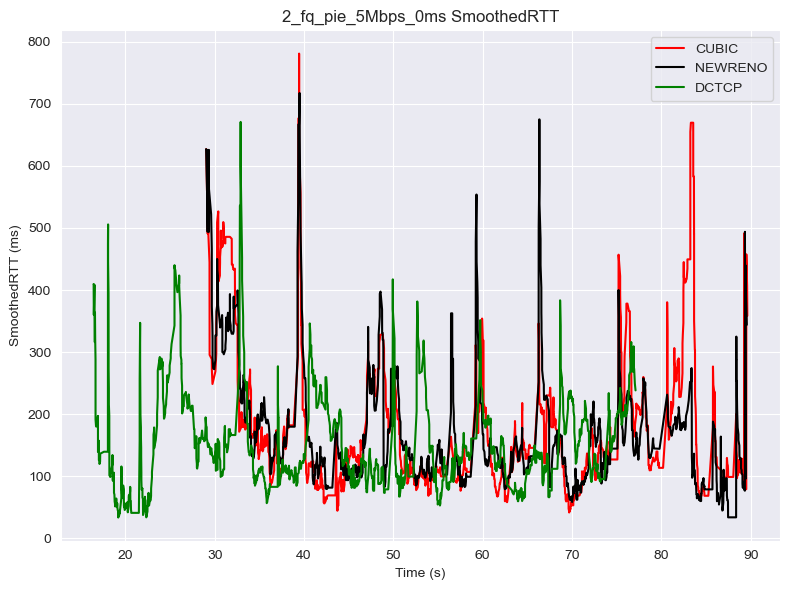

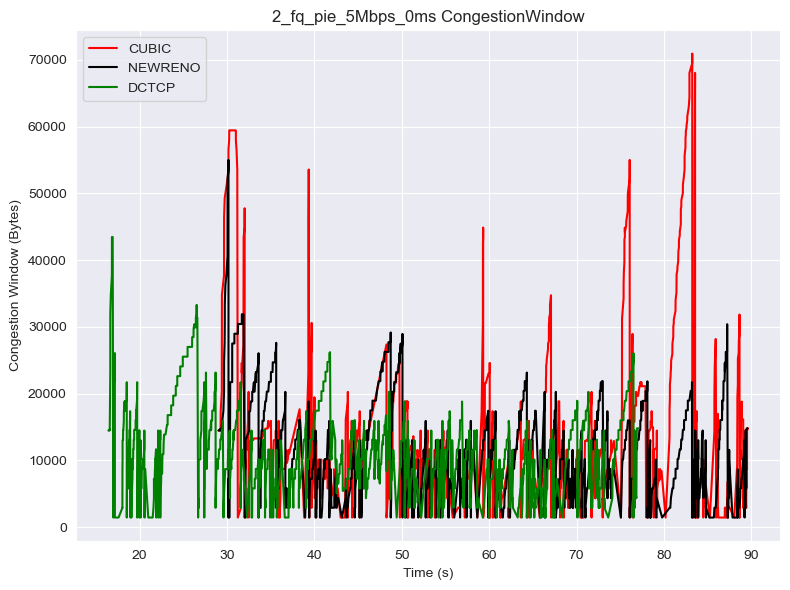


Start New Scenario
2_fq_pie_5Mbps_10ms
./Data./client1_data\2_fq_pie_5Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_5Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_5Mbps_10ms:
Statistics for CUBIC:
Median: 598.906
Mean: 638.6565699643493
25th Percentile: 472.5
75th Percentile: 746.71825
Minimum: 134.375
Maximum: 1580.312
Statistics for NEWRENO:
Median: 535.0
Mean: 547.7402351706036
25th Percentile: 427.5
75th Percentile: 656.562
Minimum: 108.125
Maximum: 1437.187
Statistics for DCTCP:
Median: 591.562
Mean: 581.125335962877
25th Percentile: 464.8435
75th Percentile: 685.625
Minimum: 117.5
Maximum: 1495.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_5Mbps_10ms_rtt_stats.txt



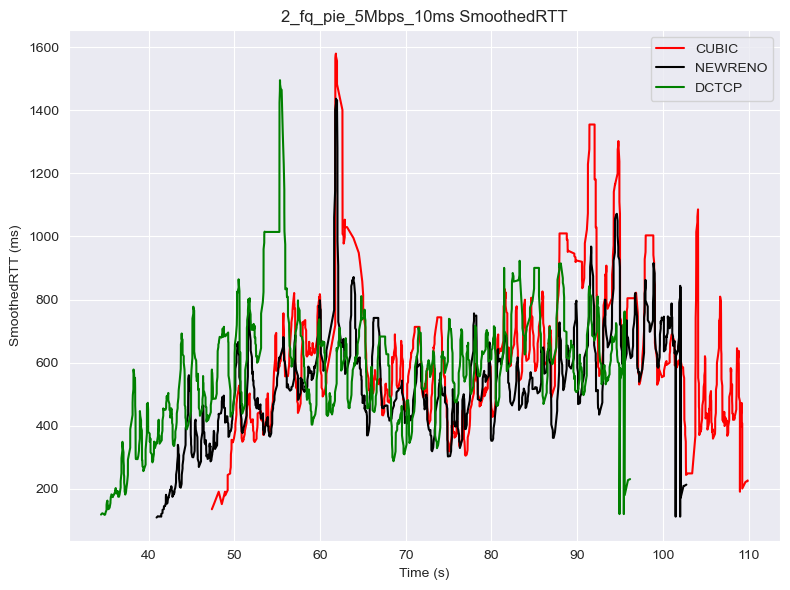

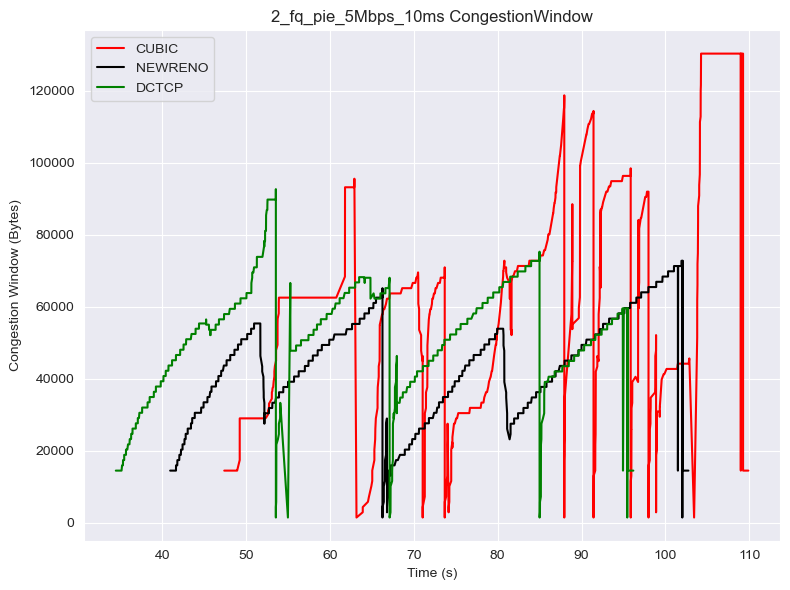


Start New Scenario
2_fq_pie_5Mbps_1ms
./Data./client1_data\2_fq_pie_5Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_5Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_5Mbps_1ms:
Statistics for CUBIC:
Median: 113.125
Mean: 137.84416744402984
25th Percentile: 94.687
75th Percentile: 158.437
Minimum: 33.125
Maximum: 650.0
Statistics for NEWRENO:
Median: 116.25
Mean: 136.26872001957904
25th Percentile: 91.875
75th Percentile: 155.312
Minimum: 50.312
Maximum: 571.562
Statistics for DCTCP:
Median: 124.062
Mean: 146.79019147940073
25th Percentile: 92.187
75th Percentile: 167.5
Minimum: 30.0
Maximum: 853.75
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_5Mbps_1ms_rtt_stats.txt



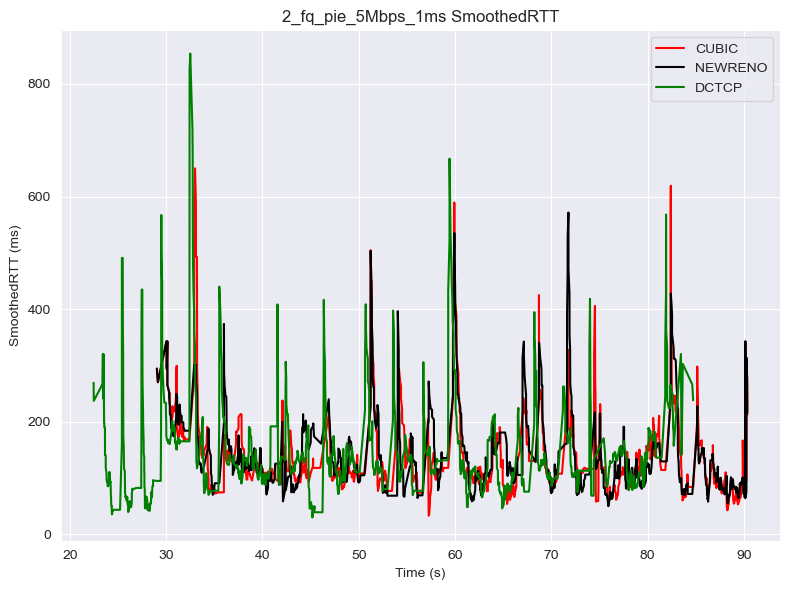

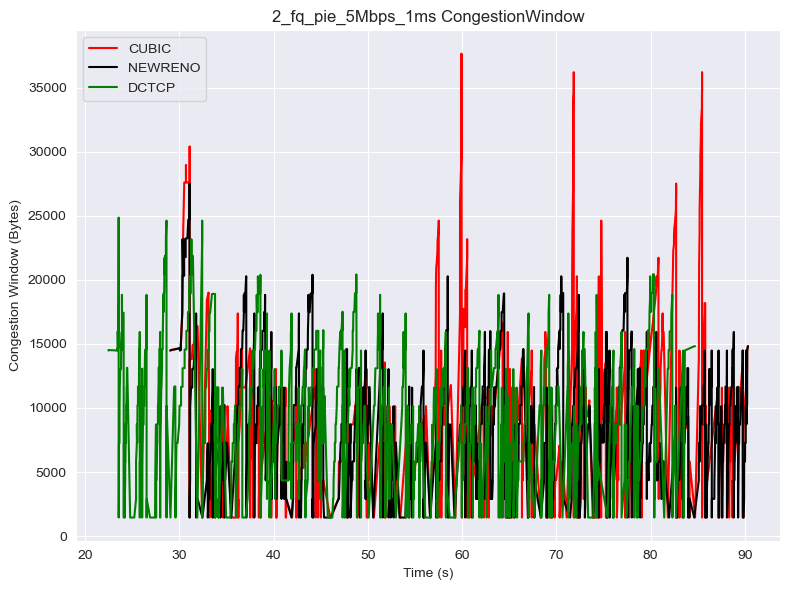


Start New Scenario
2_fq_pie_5Mbps_20ms
./Data./client1_data\2_fq_pie_5Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_5Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_5Mbps_20ms:
Statistics for CUBIC:
Median: 746.875
Mean: 717.4592704527403
25th Percentile: 562.578
75th Percentile: 886.562
Minimum: 170.312
Maximum: 1441.562
Statistics for NEWRENO:
Median: 644.8435
Mean: 646.7574811529933
25th Percentile: 525.859
75th Percentile: 752.34325
Minimum: 264.062
Maximum: 1103.75
Statistics for DCTCP:
Median: 674.375
Mean: 676.5227834394905
25th Percentile: 552.4215
75th Percentile: 774.062
Minimum: 296.562
Maximum: 1233.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_5Mbps_20ms_rtt_stats.txt



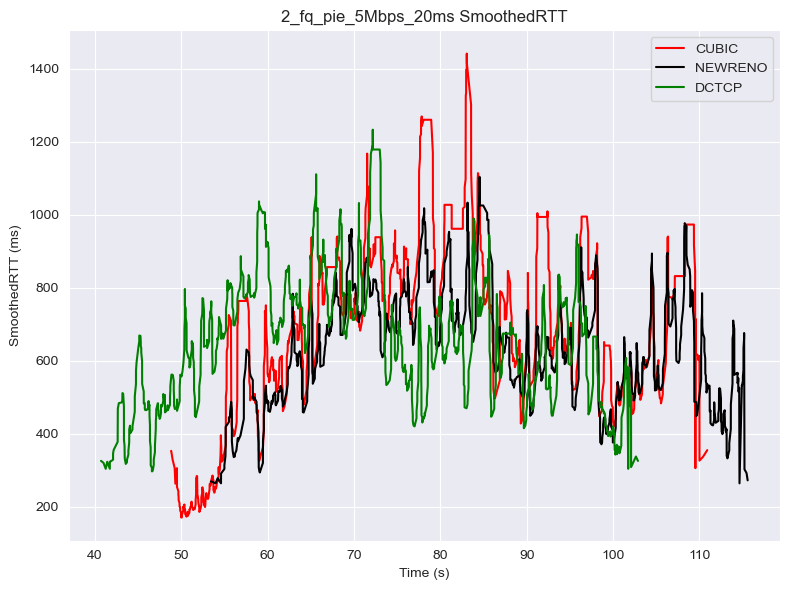

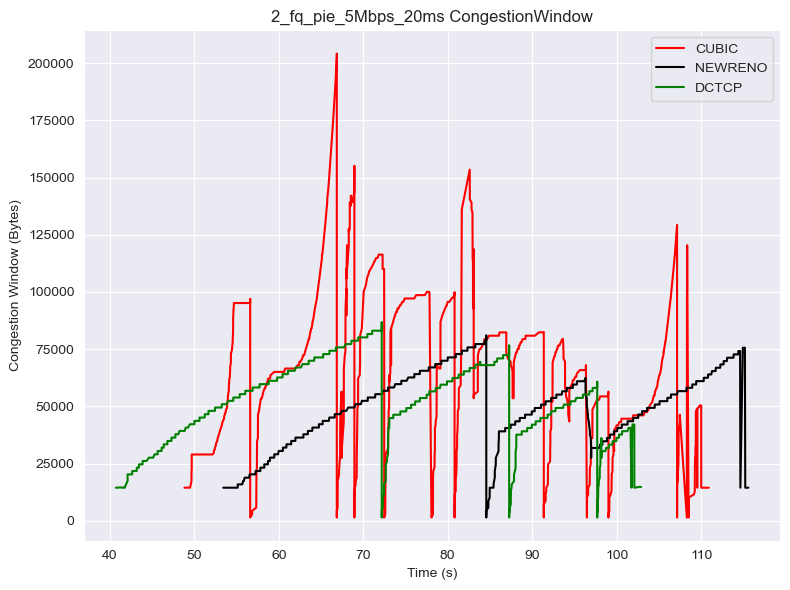


Start New Scenario
2_fq_pie_5Mbps_5ms
./Data./client1_data\2_fq_pie_5Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_5Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_5Mbps_5ms:
Statistics for CUBIC:
Median: 133.437
Mean: 157.3628719543805
25th Percentile: 101.25
75th Percentile: 181.875
Minimum: 30.937
Maximum: 612.187
Statistics for NEWRENO:
Median: 129.687
Mean: 145.21719917227105
25th Percentile: 96.562
75th Percentile: 174.687
Minimum: 40.0
Maximum: 732.5
Statistics for DCTCP:
Median: 133.5935
Mean: 164.58371687370598
25th Percentile: 99.687
75th Percentile: 185.78125
Minimum: 34.062
Maximum: 893.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_5Mbps_5ms_rtt_stats.txt



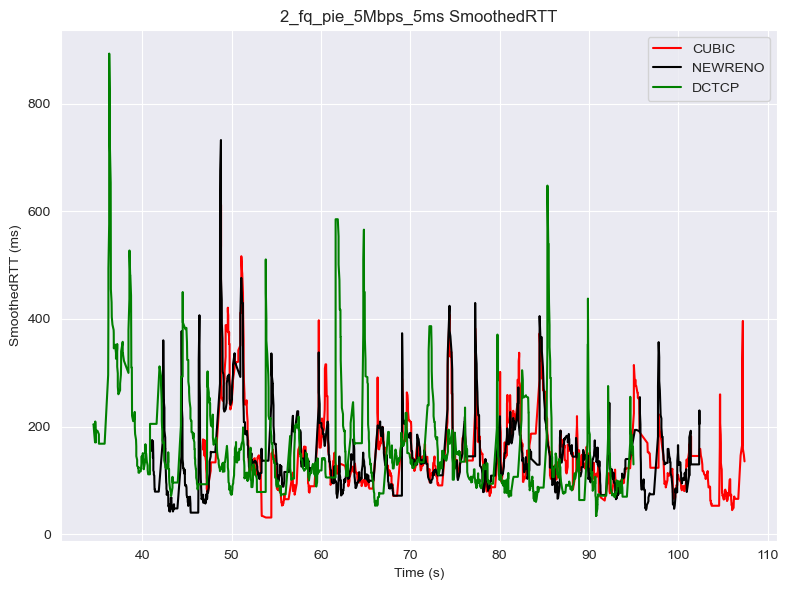

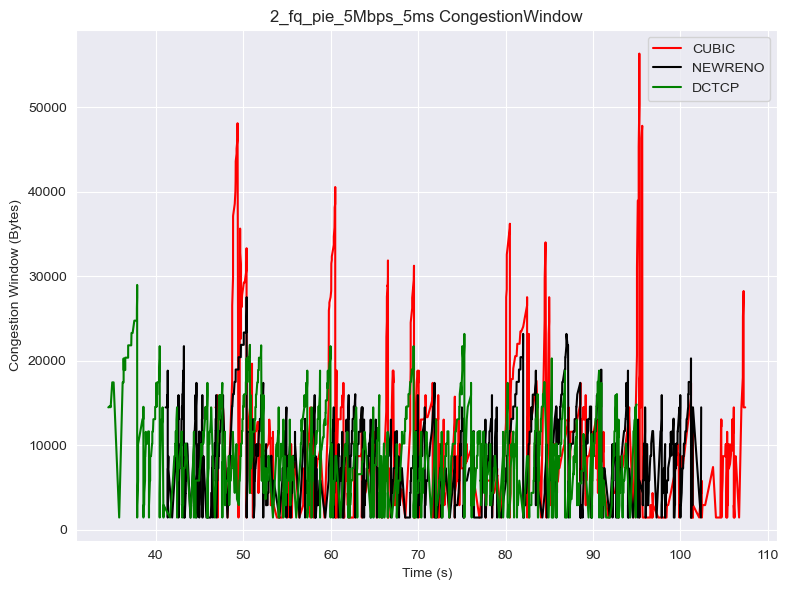


Start New Scenario
2_fq_pie_5Mbps_7ms
./Data./client1_data\2_fq_pie_5Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_5Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_5Mbps_7ms:
Statistics for CUBIC:
Median: 115.625
Mean: 129.82629692832762
25th Percentile: 90.937
75th Percentile: 156.25
Minimum: 24.687
Maximum: 646.562
Statistics for NEWRENO:
Median: 116.875
Mean: 128.04669496544915
25th Percentile: 94.062
75th Percentile: 145.0
Minimum: 31.25
Maximum: 547.812
Statistics for DCTCP:
Median: 111.875
Mean: 126.86732789939447
25th Percentile: 90.312
75th Percentile: 138.281
Minimum: 49.062
Maximum: 568.437
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_5Mbps_7ms_rtt_stats.txt



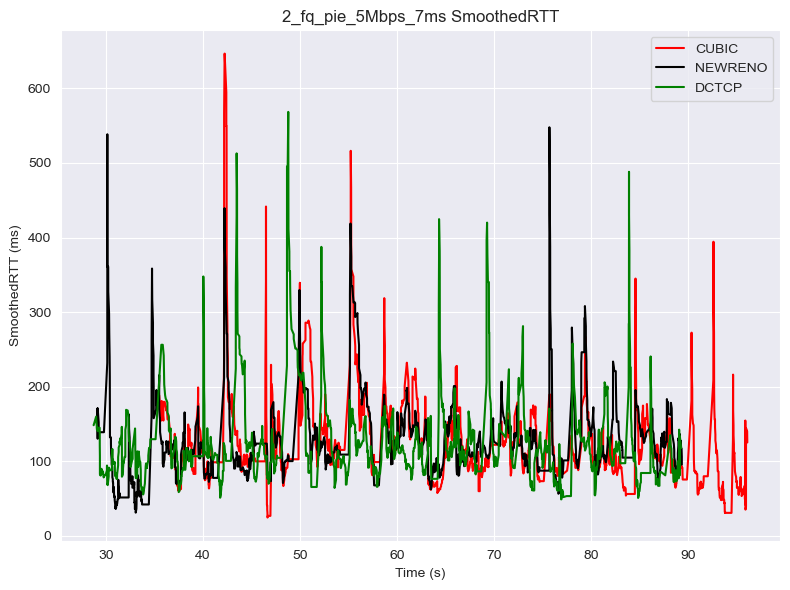

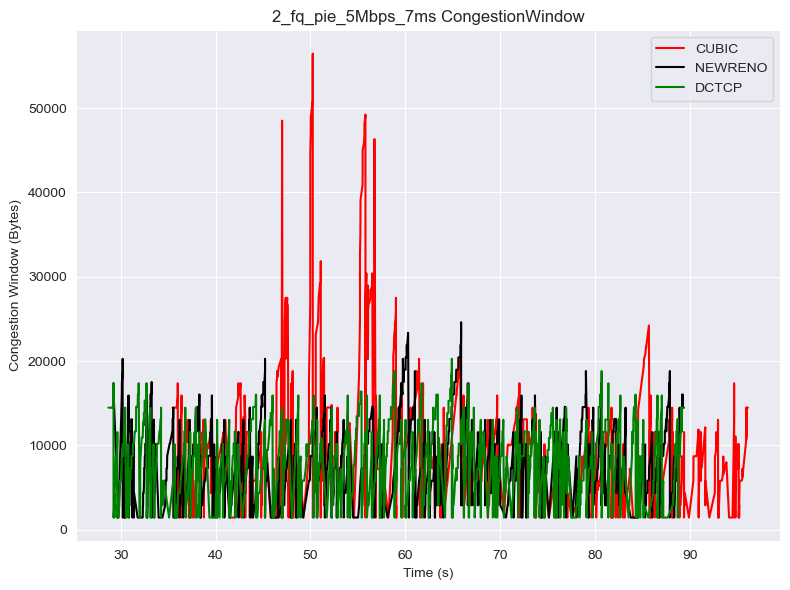


Start New Scenario
2_fq_pie_8Mbps_0ms
./Data./client1_data\2_fq_pie_8Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_8Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_8Mbps_0ms:
Statistics for CUBIC:
Median: 78.125
Mean: 101.28537189805499
25th Percentile: 60.625
75th Percentile: 105.859
Minimum: 29.375
Maximum: 483.437
Statistics for NEWRENO:
Median: 80.312
Mean: 98.23582099890632
25th Percentile: 65.0
75th Percentile: 106.25
Minimum: 31.875
Maximum: 474.687
Statistics for DCTCP:
Median: 74.687
Mean: 92.64190833333333
25th Percentile: 56.79675
75th Percentile: 103.437
Minimum: 18.75
Maximum: 510.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_8Mbps_0ms_rtt_stats.txt



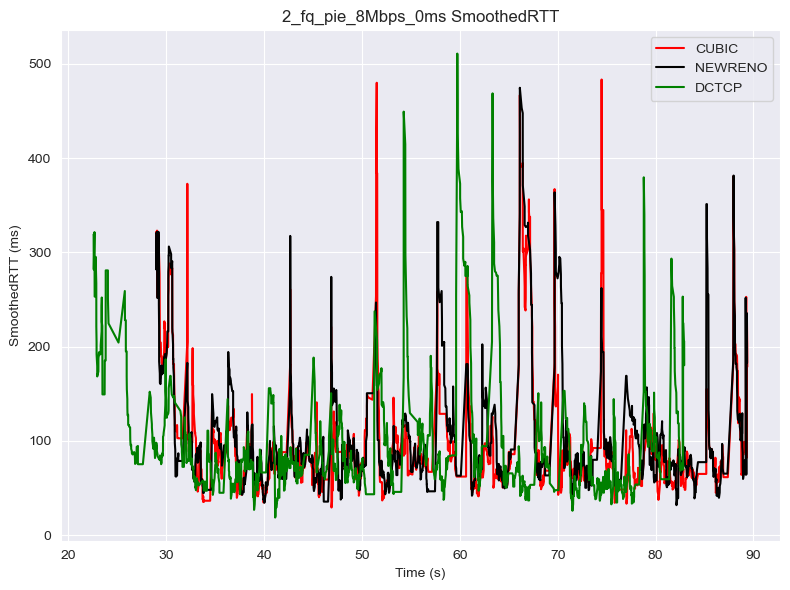

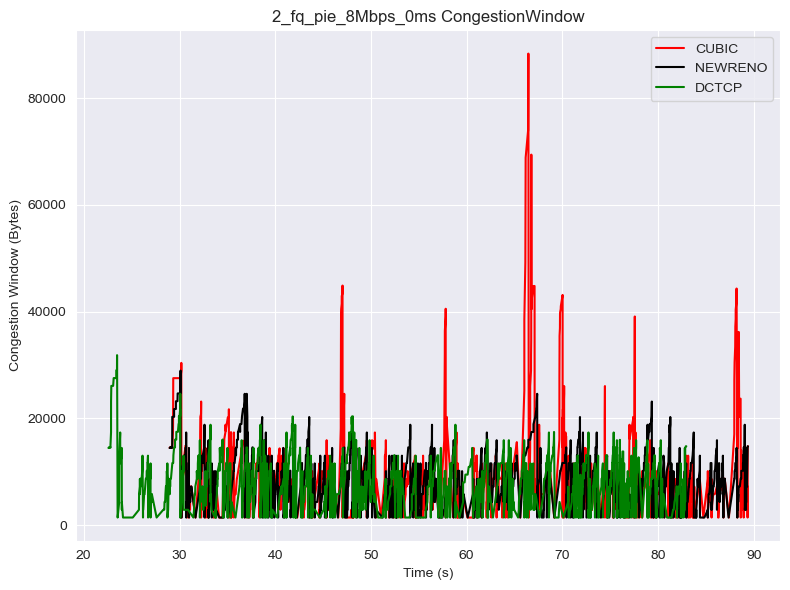


Start New Scenario
2_fq_pie_8Mbps_10ms
./Data./client1_data\2_fq_pie_8Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_8Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_8Mbps_10ms:
Statistics for CUBIC:
Median: 1072.812
Mean: 1210.3838215686276
25th Percentile: 736.875
75th Percentile: 1522.03075
Minimum: 142.5
Maximum: 3708.125
Statistics for NEWRENO:
Median: 751.562
Mean: 856.4772242866621
25th Percentile: 368.437
75th Percentile: 1234.8435
Minimum: 182.5
Maximum: 3592.187
Statistics for DCTCP:
Median: 904.2185
Mean: 1018.1944529816514
25th Percentile: 652.1875
75th Percentile: 1267.812
Minimum: 90.625
Maximum: 3550.312
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_8Mbps_10ms_rtt_stats.txt



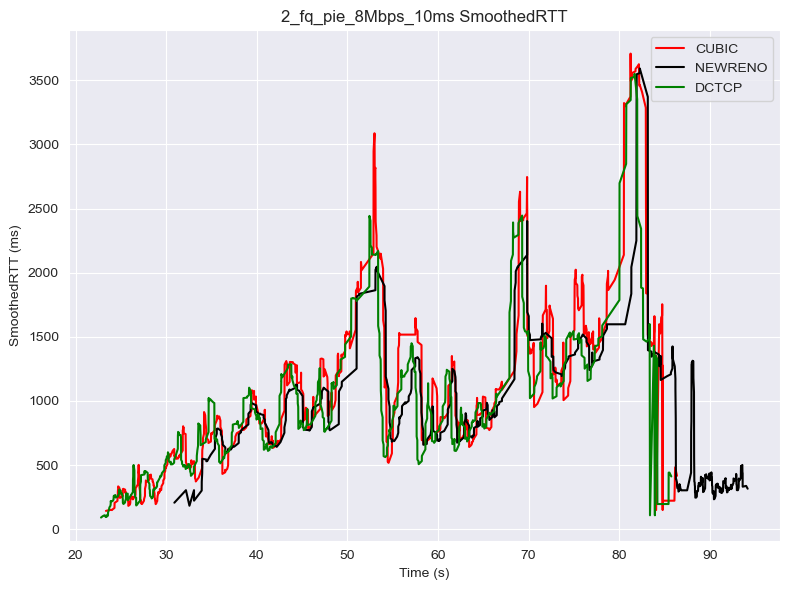

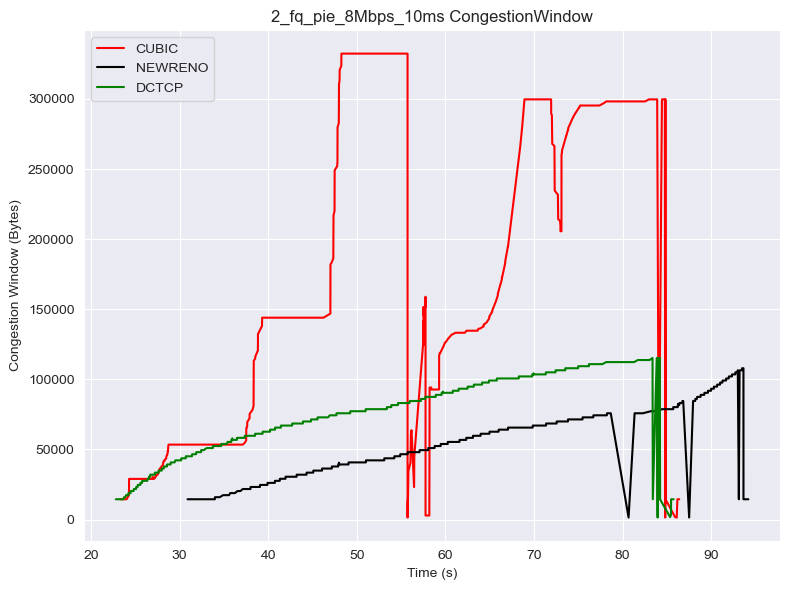


Start New Scenario
2_fq_pie_8Mbps_1ms
./Data./client1_data\2_fq_pie_8Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_8Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_8Mbps_1ms:
Statistics for CUBIC:
Median: 78.437
Mean: 102.48857601166605
25th Percentile: 60.625
75th Percentile: 110.0
Minimum: 30.625
Maximum: 803.125
Statistics for NEWRENO:
Median: 77.812
Mean: 96.0011793499044
25th Percentile: 60.0
75th Percentile: 104.375
Minimum: 25.0
Maximum: 596.875
Statistics for DCTCP:
Median: 73.75
Mean: 85.30450395182537
25th Percentile: 58.437
75th Percentile: 97.187
Minimum: 23.437
Maximum: 407.187
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_8Mbps_1ms_rtt_stats.txt



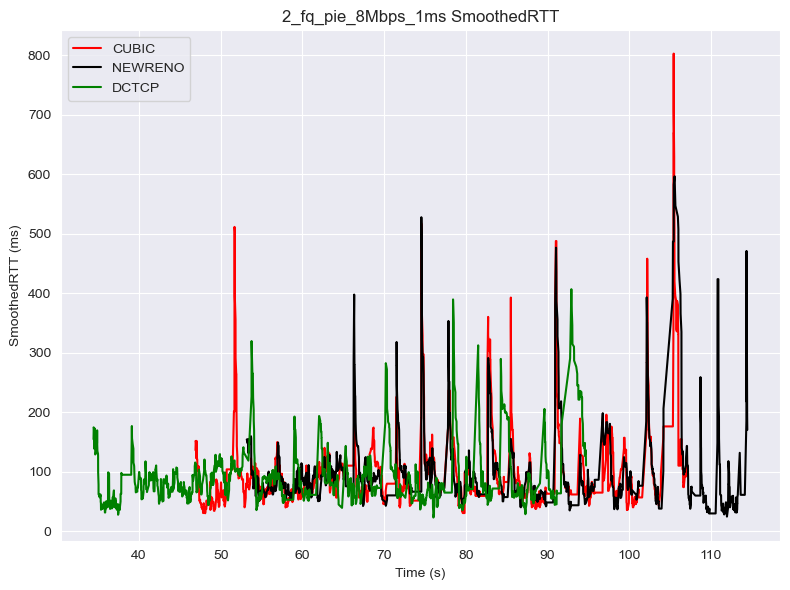

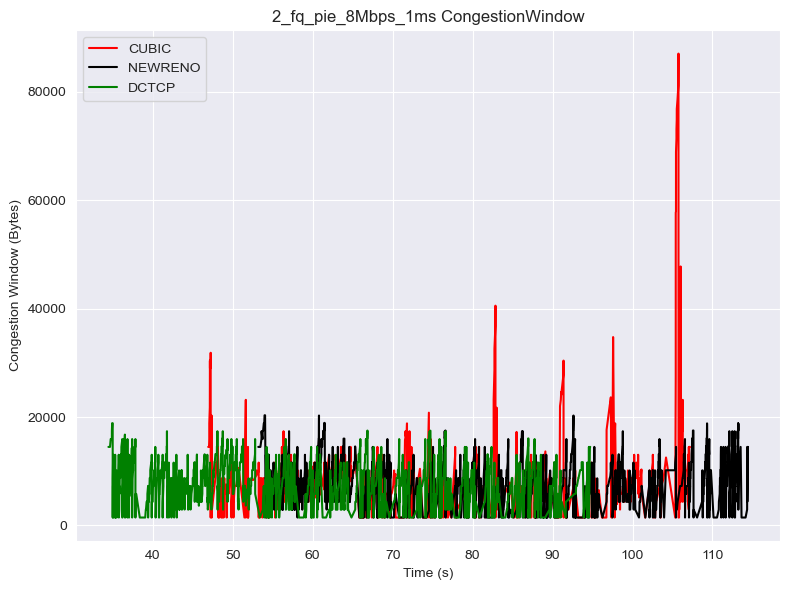


Start New Scenario
2_fq_pie_8Mbps_20ms
./Data./client1_data\2_fq_pie_8Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_8Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_8Mbps_20ms:
Statistics for CUBIC:
Median: 1362.5
Mean: 1506.4278546279004
25th Percentile: 1014.375
75th Percentile: 1990.625
Minimum: 300.0
Maximum: 2827.812
Statistics for NEWRENO:
Median: 1108.437
Mean: 1178.1908313582494
25th Percentile: 582.5
75th Percentile: 1444.687
Minimum: 270.312
Maximum: 3310.312
Statistics for DCTCP:
Median: 1143.125
Mean: 1242.5564409317803
25th Percentile: 815.703
75th Percentile: 1481.0155
Minimum: 318.75
Maximum: 3291.875
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_8Mbps_20ms_rtt_stats.txt



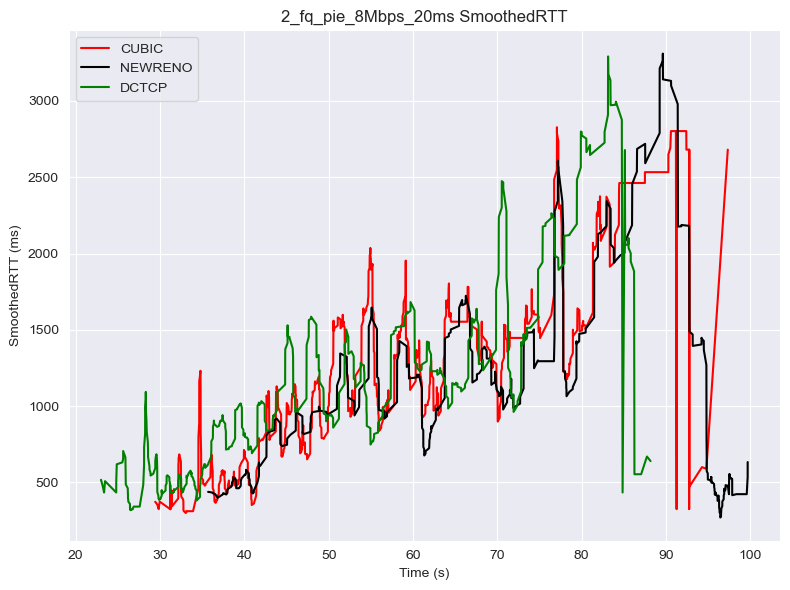

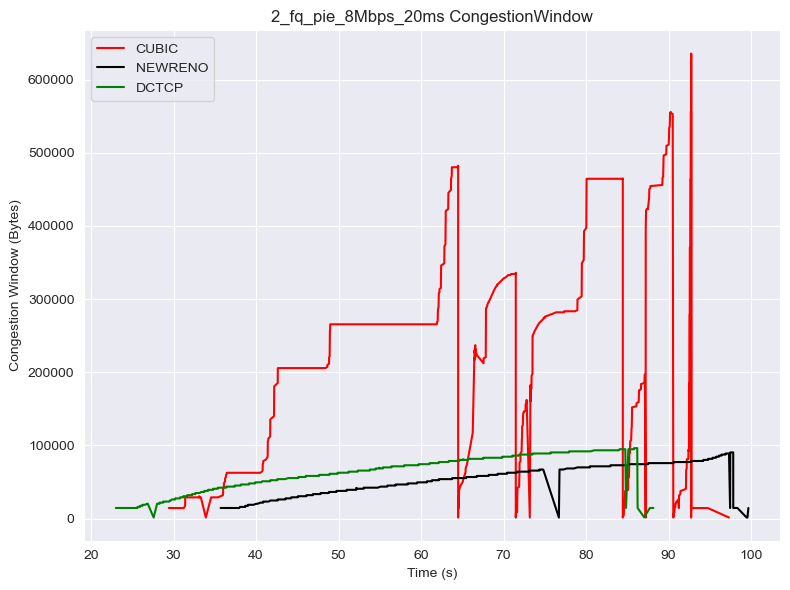


Start New Scenario
2_fq_pie_8Mbps_5ms
./Data./client1_data\2_fq_pie_8Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_8Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_8Mbps_5ms:
Statistics for CUBIC:
Median: 80.625
Mean: 99.72692018196857
25th Percentile: 59.375
75th Percentile: 113.437
Minimum: 20.937
Maximum: 458.437
Statistics for NEWRENO:
Median: 80.625
Mean: 96.30770017793596
25th Percentile: 61.562
75th Percentile: 111.25
Minimum: 25.0
Maximum: 426.25
Statistics for DCTCP:
Median: 80.625
Mean: 99.87721831284443
25th Percentile: 61.25
75th Percentile: 116.562
Minimum: 19.062
Maximum: 445.312
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_8Mbps_5ms_rtt_stats.txt



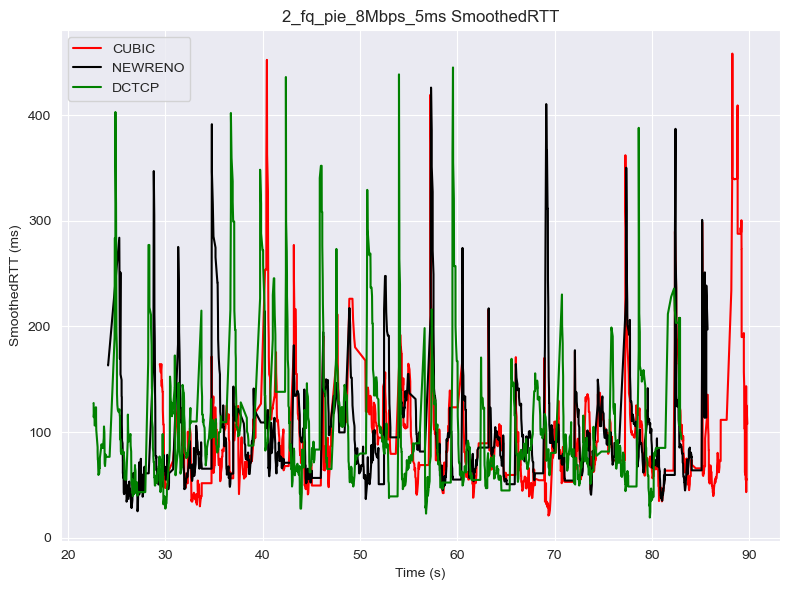

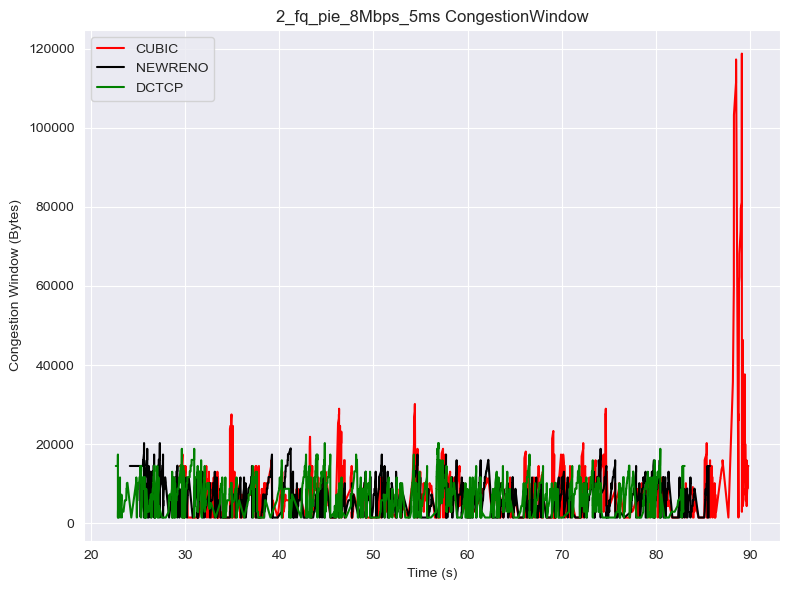


Start New Scenario
2_fq_pie_8Mbps_7ms
./Data./client1_data\2_fq_pie_8Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_fq_pie_8Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_fq_pie_8Mbps_7ms:
Statistics for CUBIC:
Median: 81.25
Mean: 99.13732444959443
25th Percentile: 63.437
75th Percentile: 106.562
Minimum: 25.625
Maximum: 520.312
Statistics for NEWRENO:
Median: 81.875
Mean: 98.49354817708334
25th Percentile: 63.437
75th Percentile: 113.203
Minimum: 27.812
Maximum: 575.0
Statistics for DCTCP:
Median: 71.562
Mean: 86.51049575802287
25th Percentile: 54.062
75th Percentile: 100.0
Minimum: 23.75
Maximum: 456.25
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_fq_pie_8Mbps_7ms_rtt_stats.txt



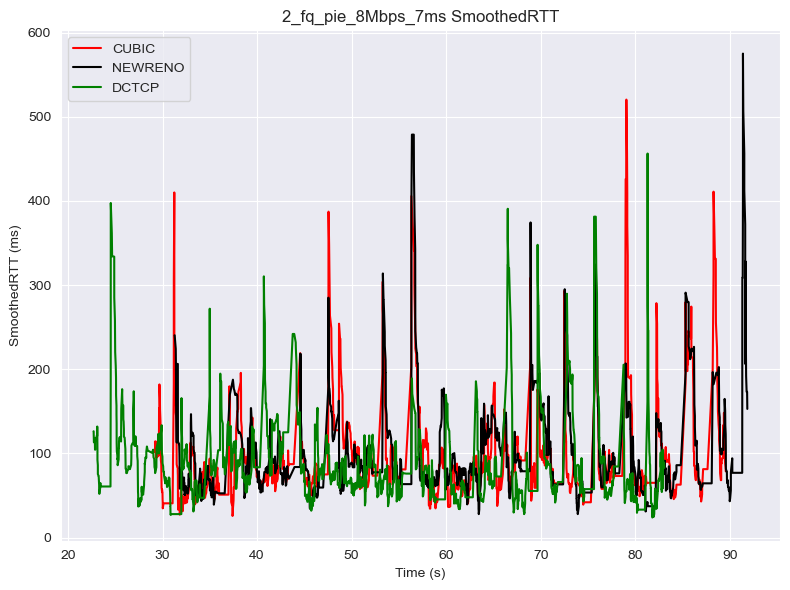

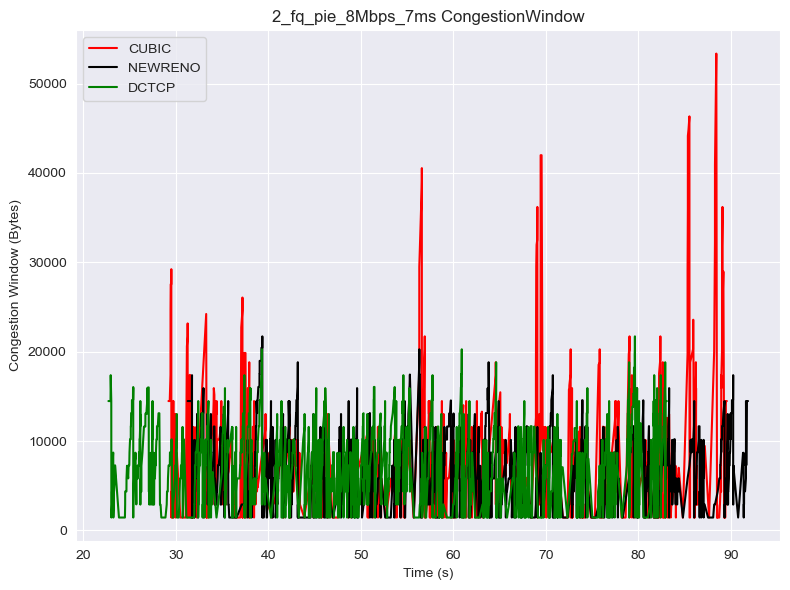


Start New Scenario
2_l4s_10Mbps_0ms
./Data./client1_data\2_l4s_10Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_10Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_10Mbps_0ms:
Statistics for CUBIC:
Median: 65.625
Mean: 74.4376436094506
25th Percentile: 45.937
75th Percentile: 91.875
Minimum: 21.25
Maximum: 284.375
Statistics for NEWRENO:
Median: 76.562
Mean: 83.1826039335368
25th Percentile: 58.75
75th Percentile: 100.0
Minimum: 23.437
Maximum: 280.625
Statistics for DCTCP:
Median: 56.562
Mean: 62.868996345363186
25th Percentile: 43.75
75th Percentile: 71.875
Minimum: 13.125
Maximum: 409.687
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_10Mbps_0ms_rtt_stats.txt



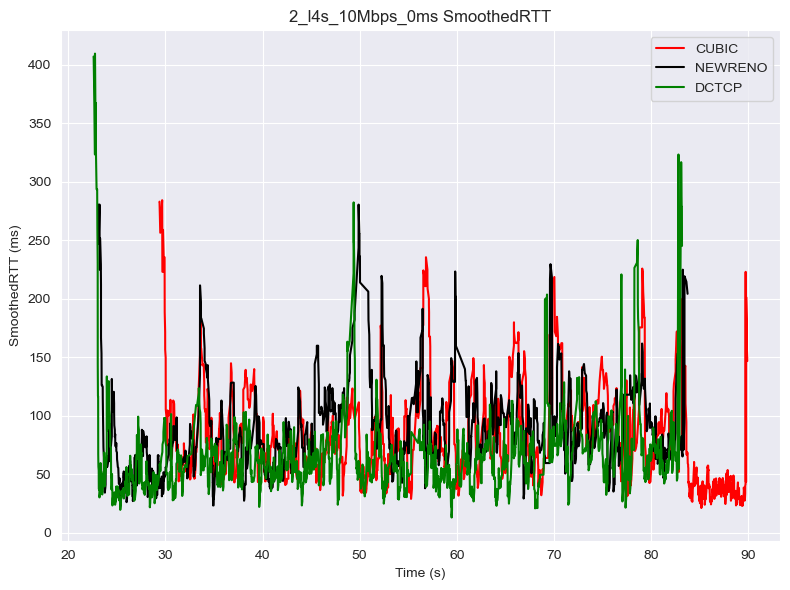

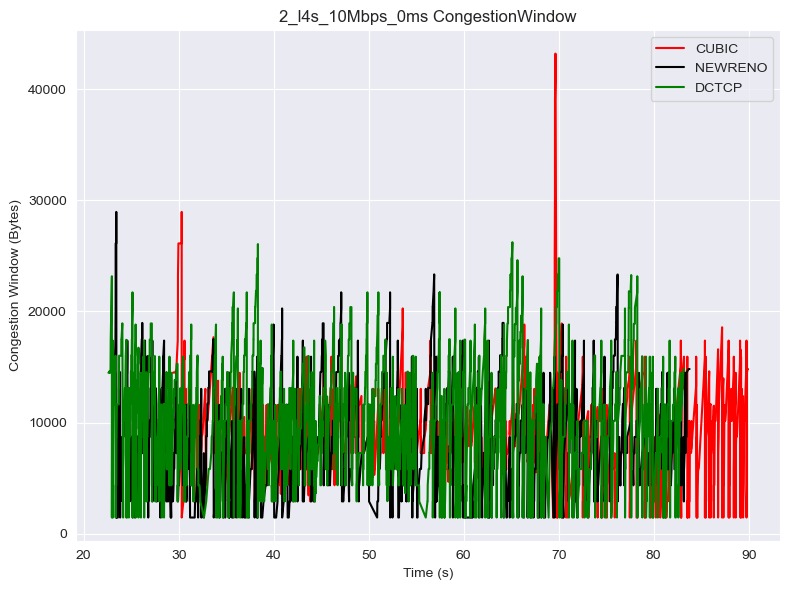


Start New Scenario
2_l4s_10Mbps_10ms
./Data./client1_data\2_l4s_10Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_10Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_10Mbps_10ms:
Statistics for CUBIC:
Median: 1052.812
Mean: 1057.6410787164702
25th Percentile: 836.25
75th Percentile: 1260.312
Minimum: 87.187
Maximum: 1920.312
Statistics for NEWRENO:
Median: 943.5935
Mean: 886.3198494191241
25th Percentile: 588.828
75th Percentile: 1164.687
Minimum: 68.437
Maximum: 1730.312
Statistics for DCTCP:
Median: 845.937
Mean: 808.1045213178295
25th Percentile: 558.125
75th Percentile: 1041.71825
Minimum: 74.687
Maximum: 1607.5
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_10Mbps_10ms_rtt_stats.txt



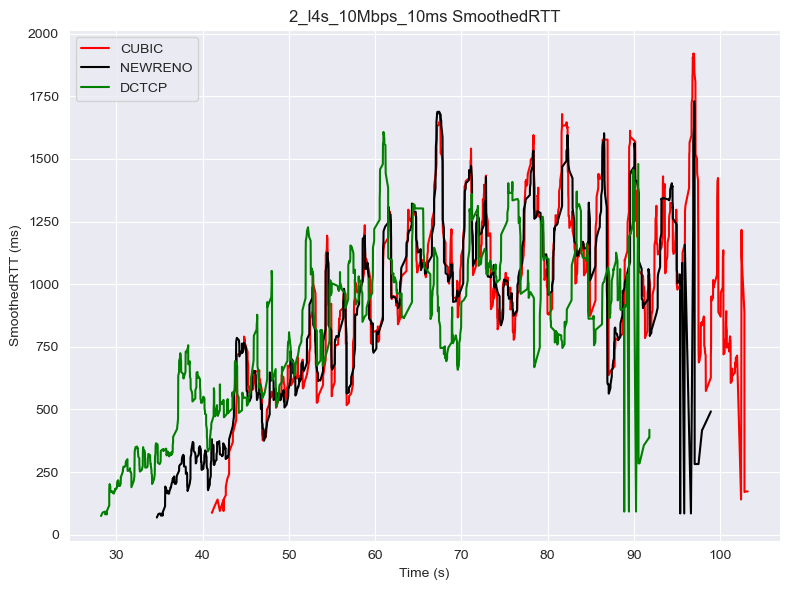

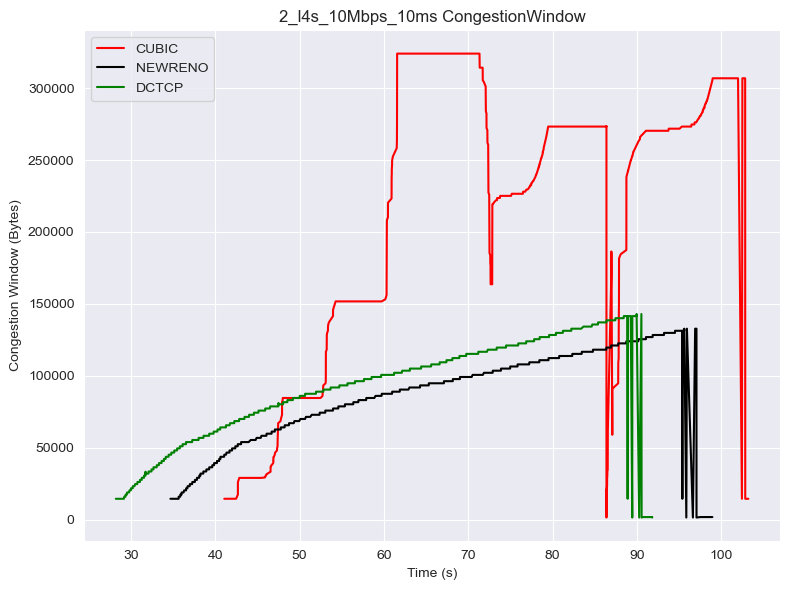


Start New Scenario
2_l4s_10Mbps_1ms
./Data./client1_data\2_l4s_10Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_10Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_10Mbps_1ms:
Statistics for CUBIC:
Median: 70.312
Mean: 75.43107707067477
25th Percentile: 52.812
75th Percentile: 93.125
Minimum: 21.25
Maximum: 222.5
Statistics for NEWRENO:
Median: 67.187
Mean: 74.16486567164179
25th Percentile: 48.75
75th Percentile: 87.578
Minimum: 14.062
Maximum: 403.125
Statistics for DCTCP:
Median: 54.062
Mean: 59.84302819505431
25th Percentile: 41.406
75th Percentile: 71.7185
Minimum: 17.812
Maximum: 235.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_10Mbps_1ms_rtt_stats.txt



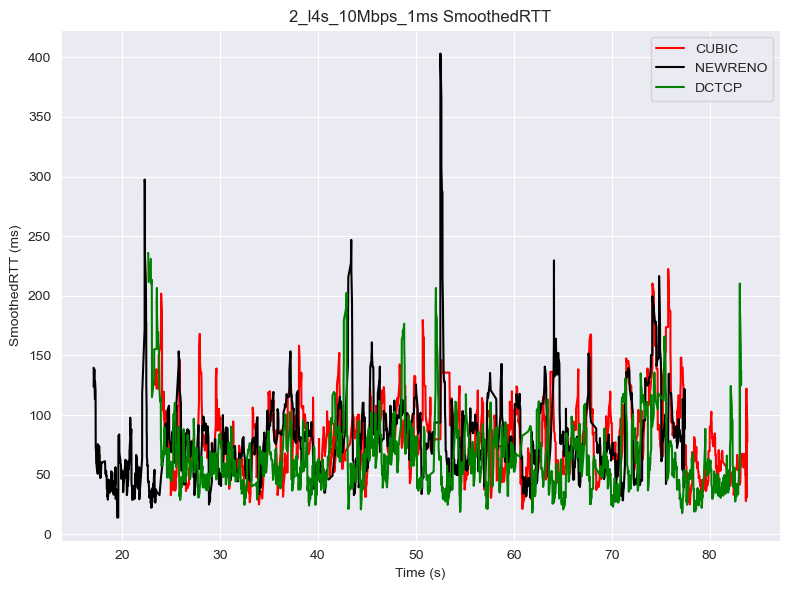

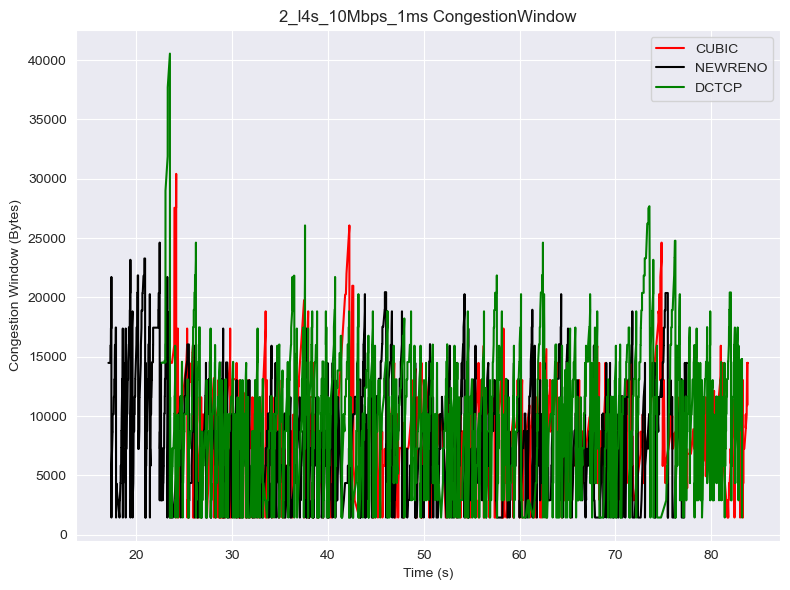


Start New Scenario
2_l4s_10Mbps_20ms
./Data./client1_data\2_l4s_10Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_10Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_10Mbps_20ms:
Statistics for CUBIC:
Median: 1050.937
Mean: 1091.4844903635567
25th Percentile: 769.76525
75th Percentile: 1445.234
Minimum: 232.5
Maximum: 2457.187
Statistics for NEWRENO:
Median: 810.312
Mean: 880.8749613559322
25th Percentile: 412.187
75th Percentile: 1238.4375
Minimum: 207.812
Maximum: 2290.625
Statistics for DCTCP:
Median: 914.375
Mean: 930.3982704402514
25th Percentile: 617.9685
75th Percentile: 1253.75
Minimum: 212.187
Maximum: 2133.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_10Mbps_20ms_rtt_stats.txt



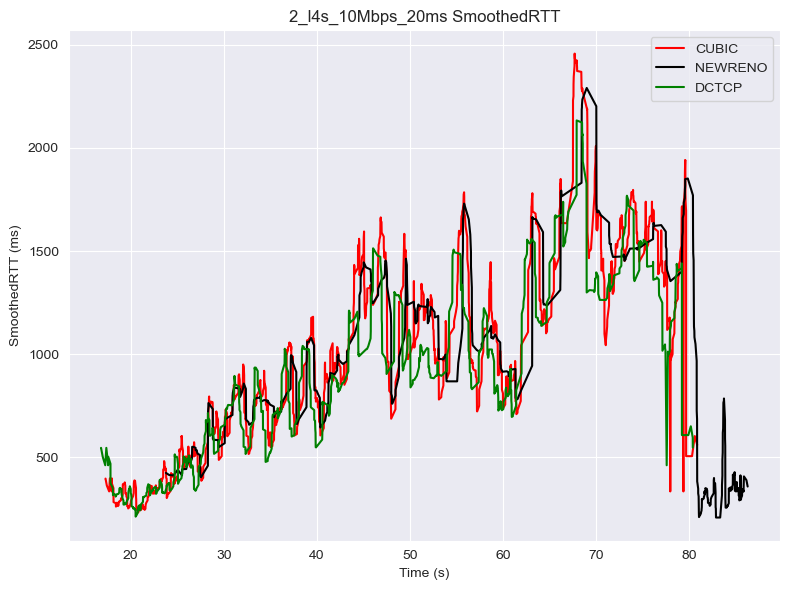

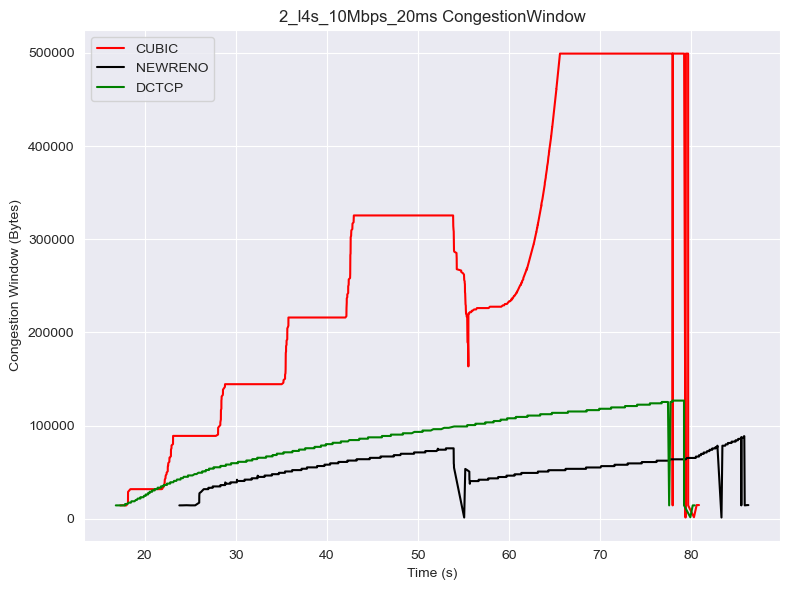


Start New Scenario
2_l4s_10Mbps_5ms
./Data./client1_data\2_l4s_10Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_10Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_10Mbps_5ms:
Statistics for CUBIC:
Median: 77.031
Mean: 84.42937990364763
25th Percentile: 60.312
75th Percentile: 98.75
Minimum: 27.5
Maximum: 343.125
Statistics for NEWRENO:
Median: 65.937
Mean: 71.82857885196374
25th Percentile: 48.75
75th Percentile: 87.187
Minimum: 19.375
Maximum: 271.25
Statistics for DCTCP:
Median: 58.75
Mean: 64.75450168512278
25th Percentile: 44.687
75th Percentile: 75.625
Minimum: 20.312
Maximum: 272.187
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_10Mbps_5ms_rtt_stats.txt



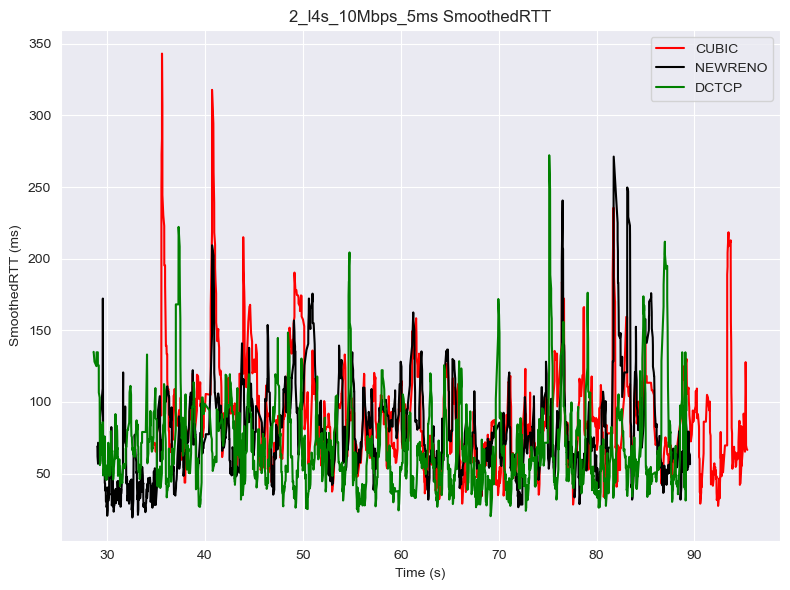

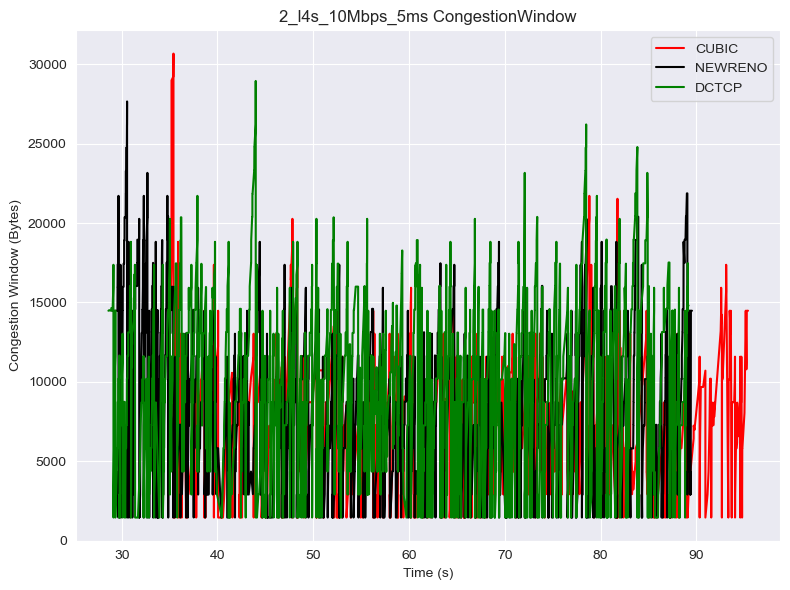


Start New Scenario
2_l4s_10Mbps_7ms
./Data./client1_data\2_l4s_10Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_10Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_10Mbps_7ms:
Statistics for CUBIC:
Median: 76.562
Mean: 81.060875
25th Percentile: 58.75
75th Percentile: 99.14025
Minimum: 25.937
Maximum: 223.125
Statistics for NEWRENO:
Median: 70.937
Mean: 75.24762024111675
25th Percentile: 52.812
75th Percentile: 94.062
Minimum: 20.625
Maximum: 212.812
Statistics for DCTCP:
Median: 58.75
Mean: 64.3033871617088
25th Percentile: 46.875
75th Percentile: 75.937
Minimum: 18.437
Maximum: 208.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_10Mbps_7ms_rtt_stats.txt



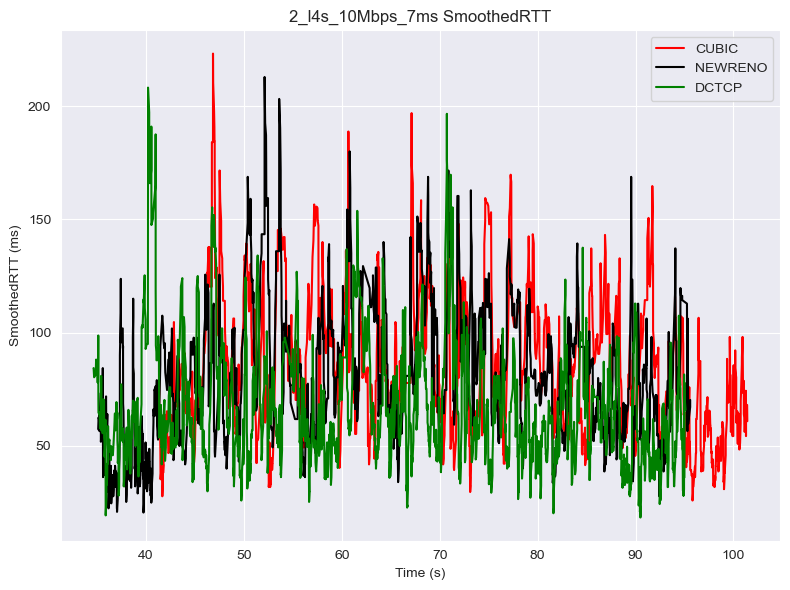

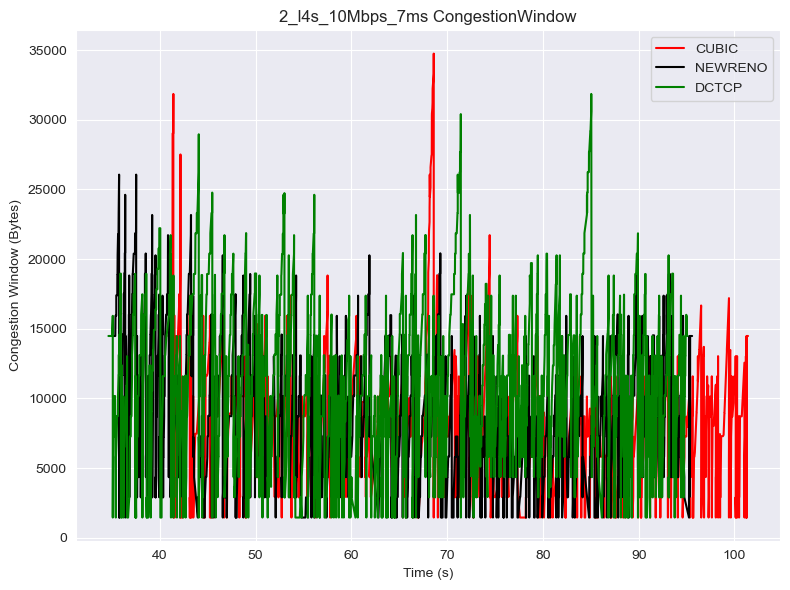


Start New Scenario
2_l4s_20Mbps_0ms
./Data./client1_data\2_l4s_20Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_20Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_20Mbps_0ms:
Statistics for CUBIC:
Median: 54.375
Mean: 62.22123130227001
25th Percentile: 41.562
75th Percentile: 70.0
Minimum: 14.687
Maximum: 585.625
Statistics for NEWRENO:
Median: 55.0
Mean: 65.2629472342595
25th Percentile: 42.5
75th Percentile: 72.812
Minimum: 18.75
Maximum: 585.625
Statistics for DCTCP:
Median: 43.75
Mean: 49.81786524444444
25th Percentile: 34.375
75th Percentile: 56.25
Minimum: 13.125
Maximum: 470.625
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_20Mbps_0ms_rtt_stats.txt



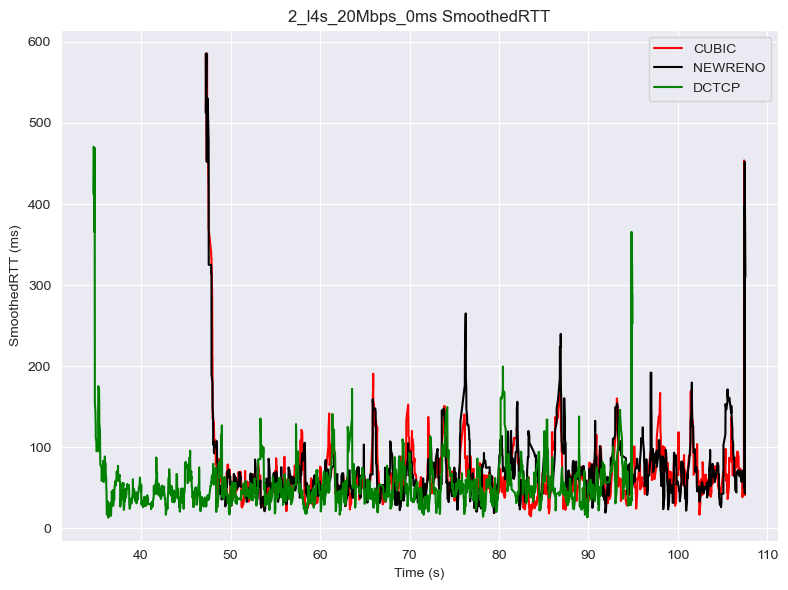

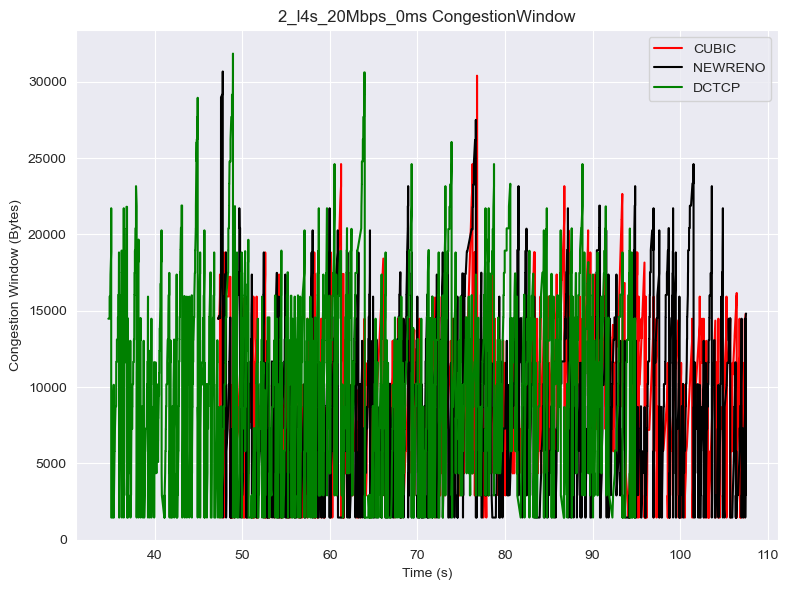


Start New Scenario
2_l4s_20Mbps_10ms
./Data./client1_data\2_l4s_20Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_20Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_20Mbps_10ms:
Statistics for CUBIC:
Median: 738.437
Mean: 709.6447275482534
25th Percentile: 540.0
75th Percentile: 924.062
Minimum: 68.125
Maximum: 1539.375
Statistics for NEWRENO:
Median: 776.562
Mean: 782.5070327790974
25th Percentile: 623.125
75th Percentile: 939.375
Minimum: 78.125
Maximum: 1425.312
Statistics for DCTCP:
Median: 722.187
Mean: 734.8854653383146
25th Percentile: 591.875
75th Percentile: 870.312
Minimum: 93.437
Maximum: 1410.625
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_20Mbps_10ms_rtt_stats.txt



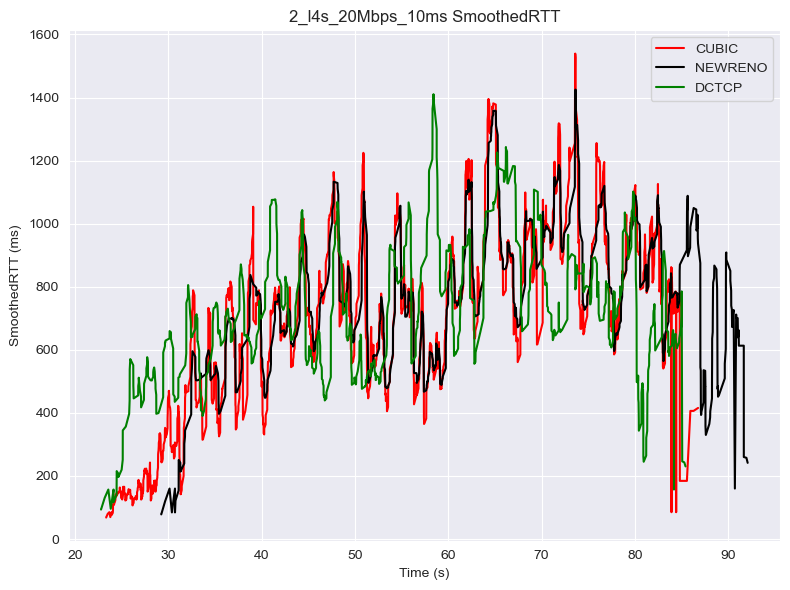

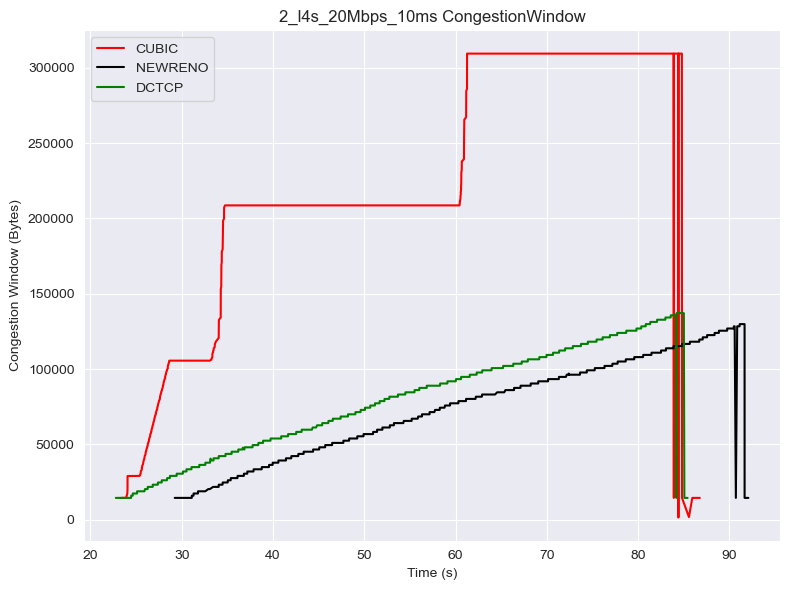


Start New Scenario
2_l4s_20Mbps_1ms
./Data./client1_data\2_l4s_20Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_20Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_20Mbps_1ms:
Statistics for CUBIC:
Median: 53.75
Mean: 60.3678431372549
25th Percentile: 42.187
75th Percentile: 70.0
Minimum: 16.875
Maximum: 310.937
Statistics for NEWRENO:
Median: 52.5
Mean: 58.78208115647984
25th Percentile: 40.937
75th Percentile: 68.437
Minimum: 18.125
Maximum: 242.5
Statistics for DCTCP:
Median: 42.187
Mean: 48.79072329403359
25th Percentile: 34.062
75th Percentile: 54.687
Minimum: 14.062
Maximum: 236.25
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_20Mbps_1ms_rtt_stats.txt



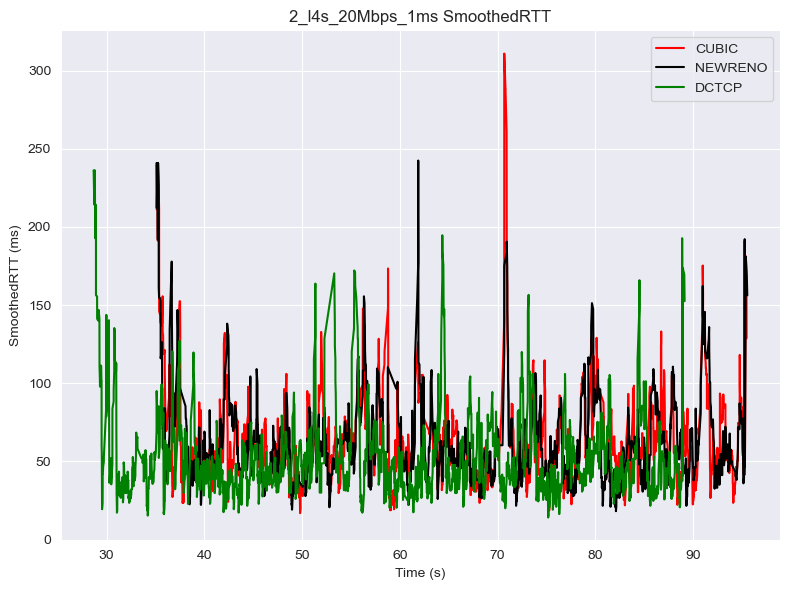

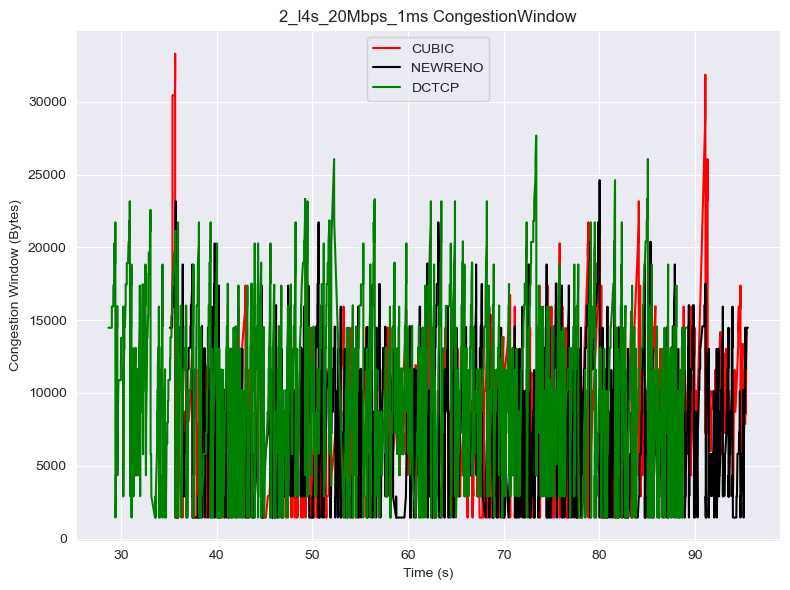


Start New Scenario
2_l4s_20Mbps_20ms
./Data./client1_data\2_l4s_20Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_20Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_20Mbps_20ms:
Statistics for CUBIC:
Median: 1111.562
Mean: 1175.6066195075498
25th Percentile: 875.0
75th Percentile: 1547.812
Minimum: 247.812
Maximum: 2171.25
Statistics for NEWRENO:
Median: 951.25
Mean: 1000.7990839832034
25th Percentile: 742.5
75th Percentile: 1292.1875
Minimum: 239.375
Maximum: 2448.125
Statistics for DCTCP:
Median: 924.375
Mean: 991.4044025085518
25th Percentile: 714.84325
75th Percentile: 1271.17175
Minimum: 225.0
Maximum: 2497.812
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_20Mbps_20ms_rtt_stats.txt



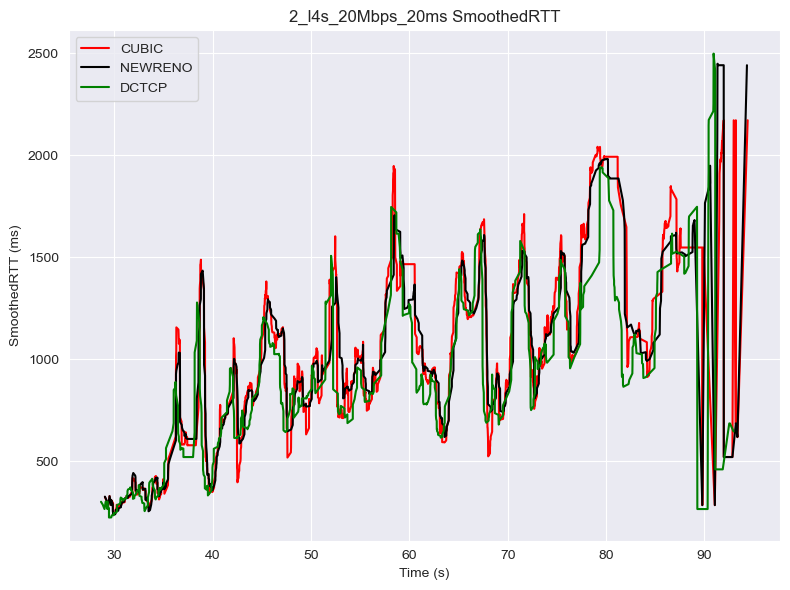

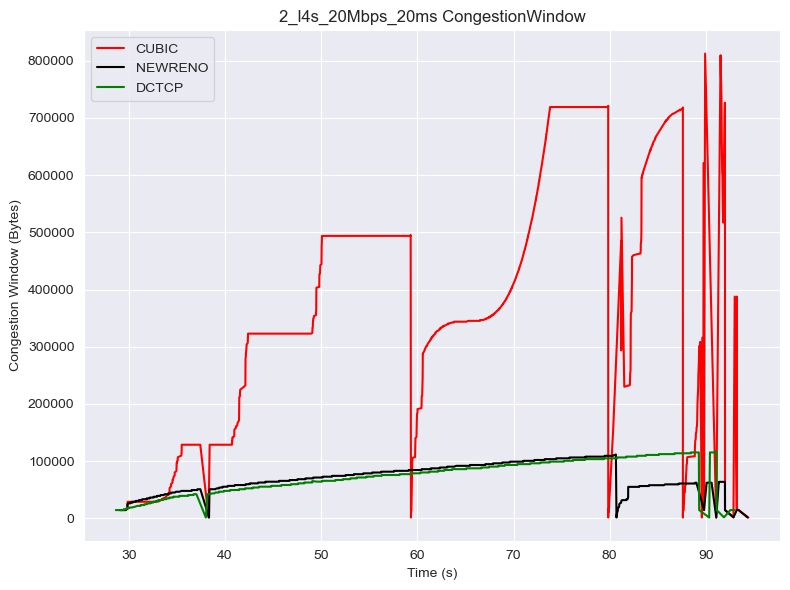


Start New Scenario
2_l4s_20Mbps_5ms
./Data./client1_data\2_l4s_20Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_20Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_20Mbps_5ms:
Statistics for CUBIC:
Median: 53.75
Mean: 60.22071469261808
25th Percentile: 40.625
75th Percentile: 71.562
Minimum: 15.312
Maximum: 317.187
Statistics for NEWRENO:
Median: 52.5
Mean: 61.888108238705
25th Percentile: 38.75
75th Percentile: 72.187
Minimum: 16.562
Maximum: 415.625
Statistics for DCTCP:
Median: 41.875
Mean: 48.403518661293155
25th Percentile: 33.437
75th Percentile: 56.25
Minimum: 9.687
Maximum: 258.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_20Mbps_5ms_rtt_stats.txt



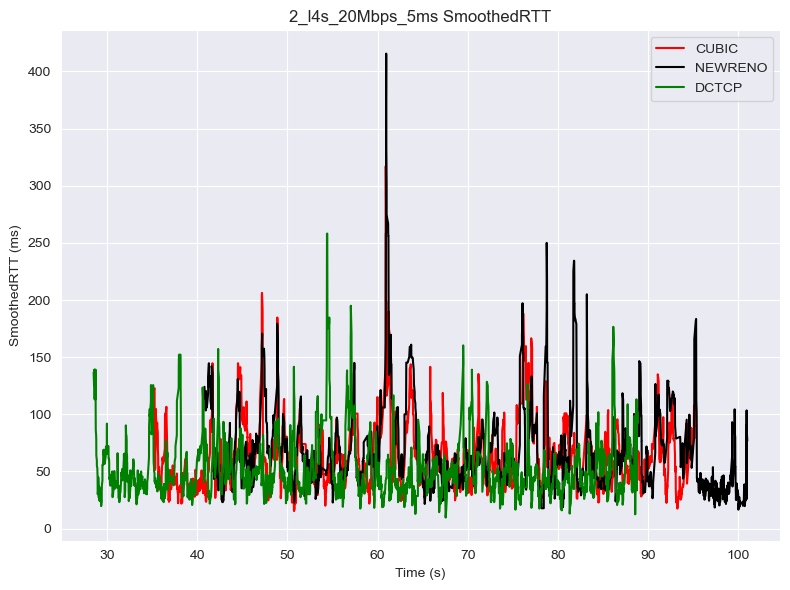

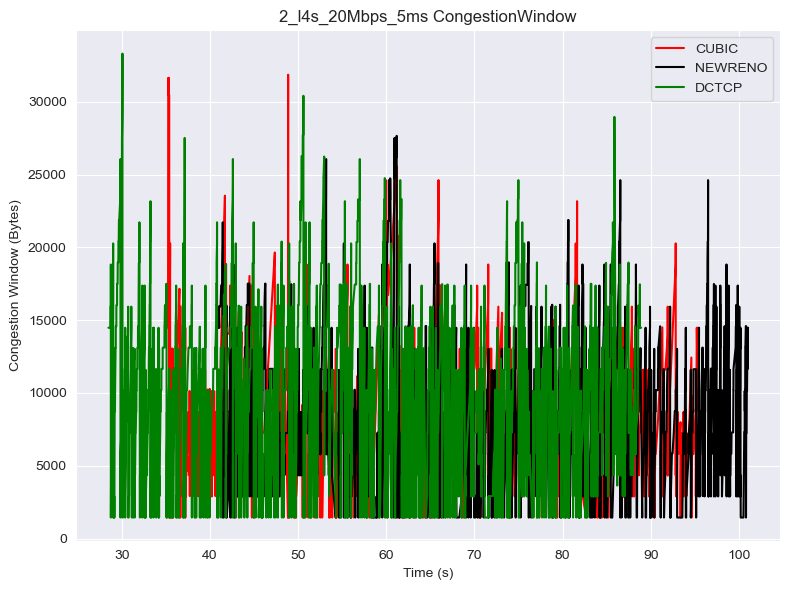


Start New Scenario
2_l4s_20Mbps_7ms
./Data./client1_data\2_l4s_20Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_20Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_20Mbps_7ms:
Statistics for CUBIC:
Median: 67.5
Mean: 71.44443491577336
25th Percentile: 55.0
75th Percentile: 83.125
Minimum: 18.75
Maximum: 242.5
Statistics for NEWRENO:
Median: 67.187
Mean: 72.7322955709551
25th Percentile: 51.25
75th Percentile: 86.562
Minimum: 15.0
Maximum: 305.0
Statistics for DCTCP:
Median: 55.937
Mean: 60.79814405286344
25th Percentile: 43.75
75th Percentile: 69.687
Minimum: 15.312
Maximum: 279.687
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_20Mbps_7ms_rtt_stats.txt



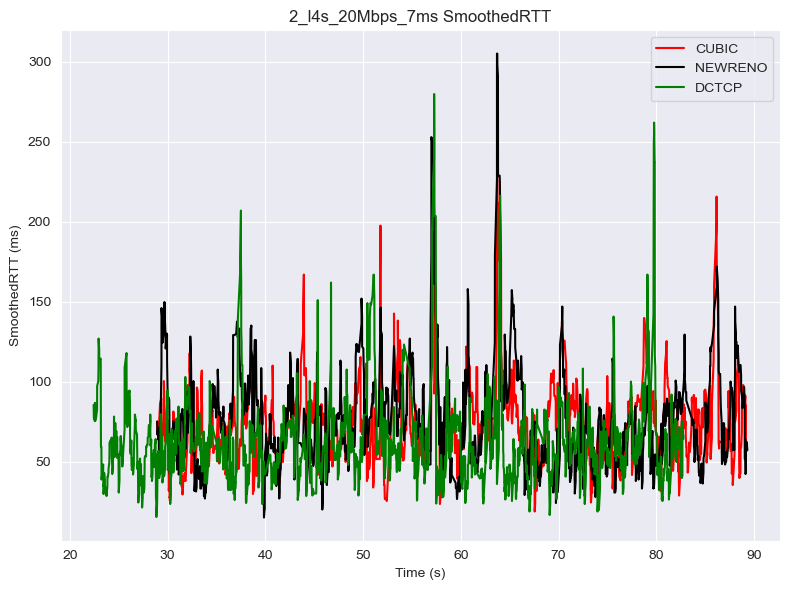

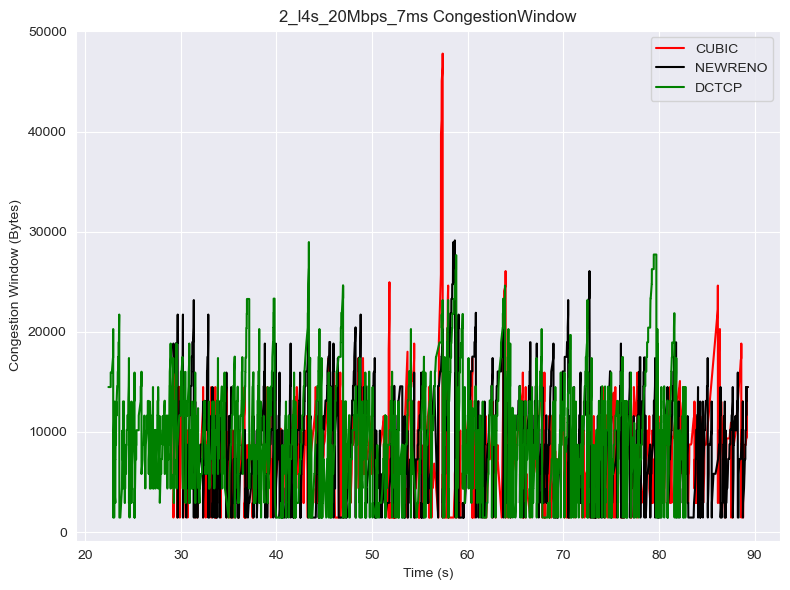


Start New Scenario
2_l4s_5Mbps_0ms
./Data./client1_data\2_l4s_5Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_5Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_5Mbps_0ms:
Statistics for CUBIC:
Median: 134.687
Mean: 158.28255497655027
25th Percentile: 106.25
75th Percentile: 178.5935
Minimum: 42.812
Maximum: 484.062
Statistics for NEWRENO:
Median: 133.125
Mean: 153.79553435114502
25th Percentile: 105.0
75th Percentile: 170.312
Minimum: 34.062
Maximum: 503.75
Statistics for DCTCP:
Median: 106.875
Mean: 129.48756016949153
25th Percentile: 84.375
75th Percentile: 141.562
Minimum: 31.562
Maximum: 685.937
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_5Mbps_0ms_rtt_stats.txt



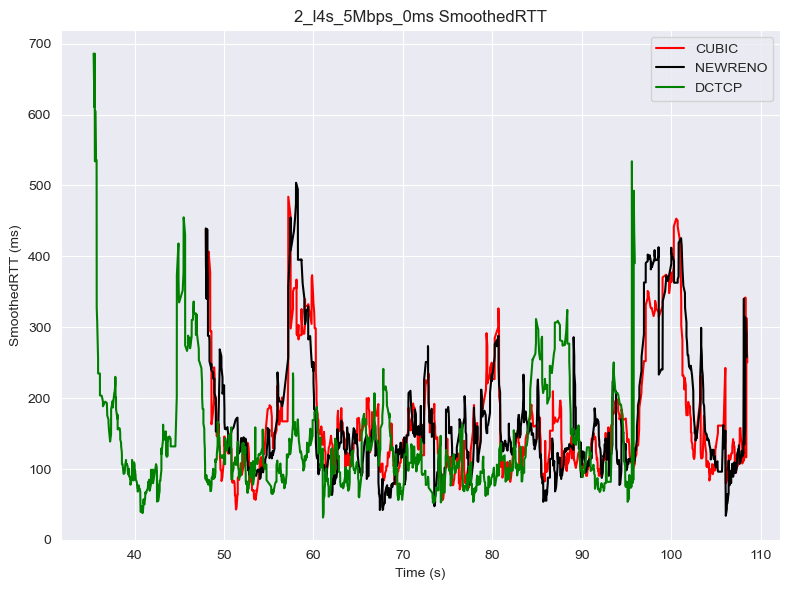

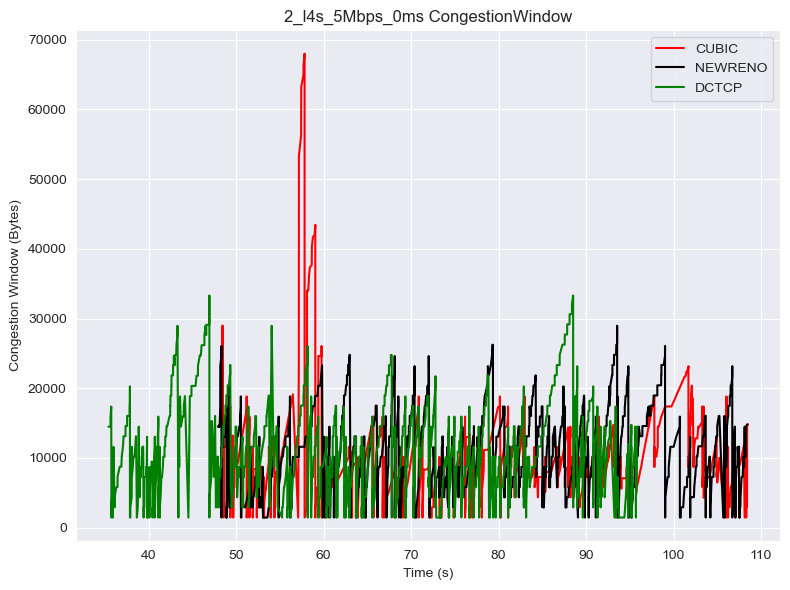


Start New Scenario
2_l4s_5Mbps_10ms
./Data./client1_data\2_l4s_5Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_5Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_5Mbps_10ms:
Statistics for CUBIC:
Median: 1018.281
Mean: 987.9872792079207
25th Percentile: 850.078
75th Percentile: 1130.234
Minimum: 82.187
Maximum: 1734.375
Statistics for NEWRENO:
Median: 945.625
Mean: 901.9266109979633
25th Percentile: 671.79675
75th Percentile: 1148.04675
Minimum: 82.187
Maximum: 1689.687
Statistics for DCTCP:
Median: 747.031
Mean: 738.7100967903709
25th Percentile: 571.953
75th Percentile: 906.79675
Minimum: 167.187
Maximum: 1298.75
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_5Mbps_10ms_rtt_stats.txt



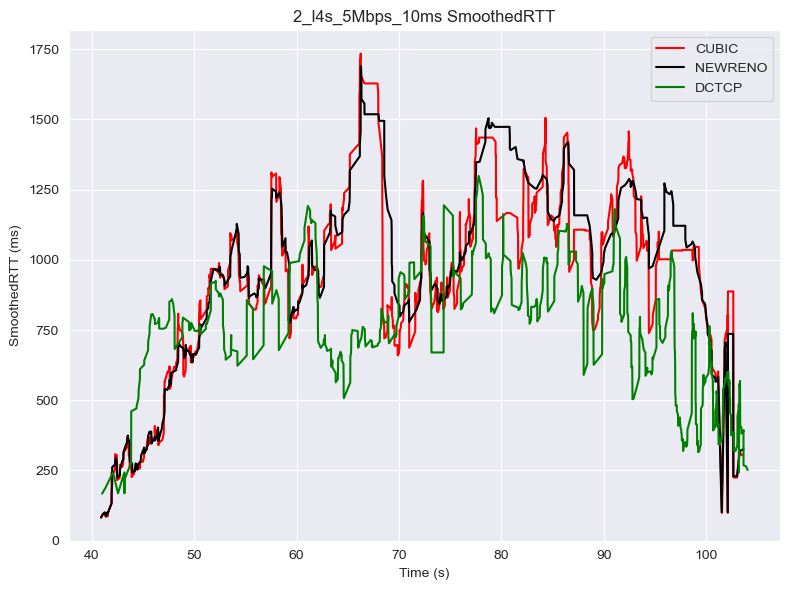

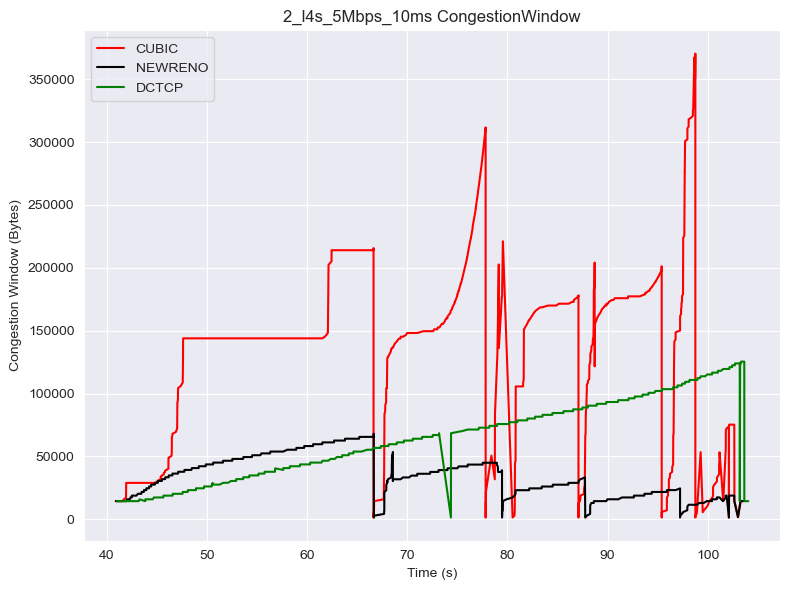


Start New Scenario
2_l4s_5Mbps_1ms
./Data./client1_data\2_l4s_5Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_5Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_5Mbps_1ms:
Statistics for CUBIC:
Median: 137.5
Mean: 141.27926485285948
25th Percentile: 107.187
75th Percentile: 168.75
Minimum: 43.437
Maximum: 325.0
Statistics for NEWRENO:
Median: 130.937
Mean: 126.97123905723903
25th Percentile: 84.062
75th Percentile: 161.562
Minimum: 26.875
Maximum: 296.562
Statistics for DCTCP:
Median: 106.562
Mean: 114.58819761372109
25th Percentile: 85.39025
75th Percentile: 134.375
Minimum: 40.625
Maximum: 371.875
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_5Mbps_1ms_rtt_stats.txt



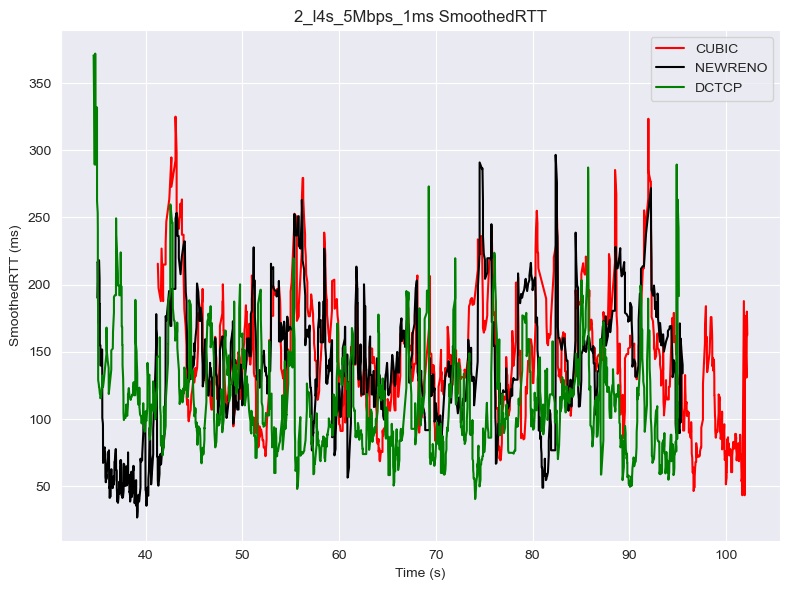

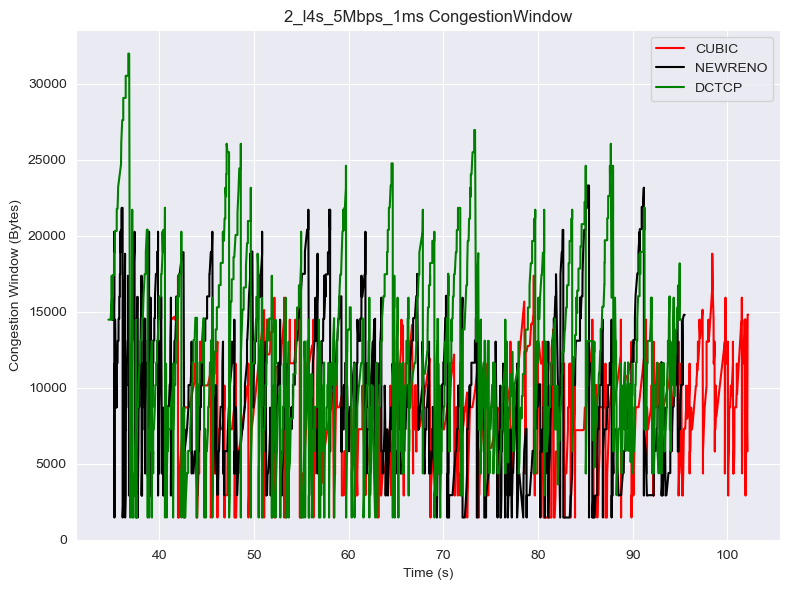


Start New Scenario
2_l4s_5Mbps_20ms
./Data./client1_data\2_l4s_5Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_5Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_5Mbps_20ms:
Statistics for CUBIC:
Median: 992.812
Mean: 959.0751042944786
25th Percentile: 622.812
75th Percentile: 1258.75
Minimum: 149.687
Maximum: 1910.312
Statistics for NEWRENO:
Median: 809.2185
Mean: 833.5123485576922
25th Percentile: 543.7495
75th Percentile: 1040.937
Minimum: 380.625
Maximum: 1570.0
Statistics for DCTCP:
Median: 719.687
Mean: 756.0063095571096
25th Percentile: 587.812
75th Percentile: 900.312
Minimum: 270.0
Maximum: 1545.312
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_5Mbps_20ms_rtt_stats.txt



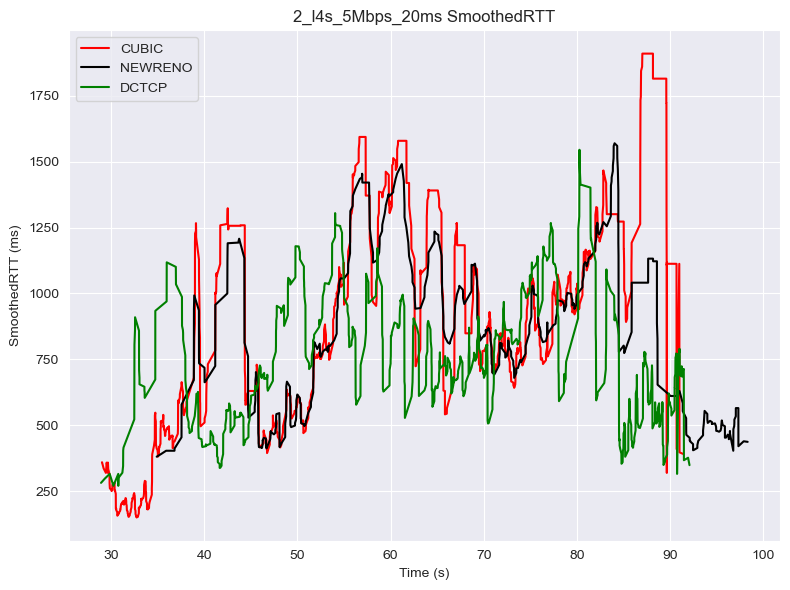

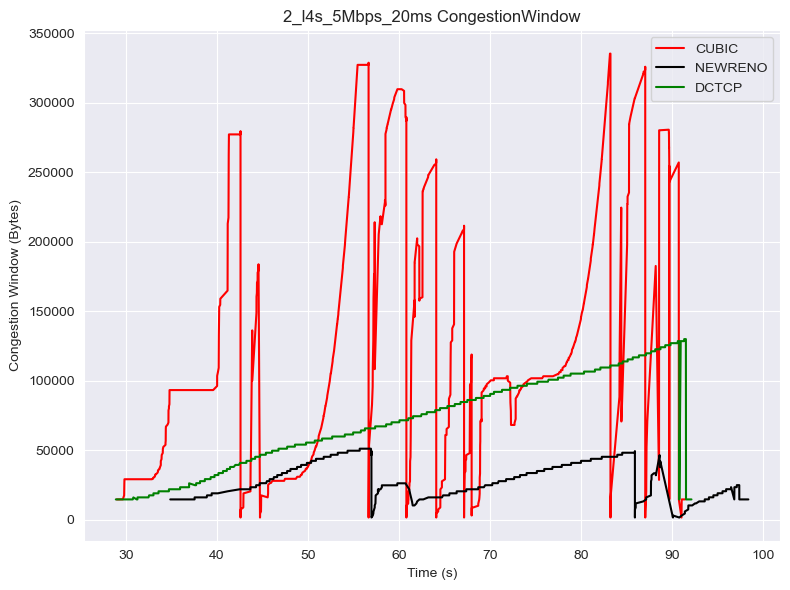


Start New Scenario
2_l4s_5Mbps_5ms
./Data./client1_data\2_l4s_5Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_5Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_5Mbps_5ms:
Statistics for CUBIC:
Median: 123.437
Mean: 135.9896130189646
25th Percentile: 101.25
75th Percentile: 152.3435
Minimum: 48.437
Maximum: 361.875
Statistics for NEWRENO:
Median: 138.437
Mean: 149.67219665271966
25th Percentile: 114.29675
75th Percentile: 172.187
Minimum: 55.625
Maximum: 409.062
Statistics for DCTCP:
Median: 102.5
Mean: 114.46787044374011
25th Percentile: 81.875
75th Percentile: 134.062
Minimum: 37.5
Maximum: 325.0
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_5Mbps_5ms_rtt_stats.txt



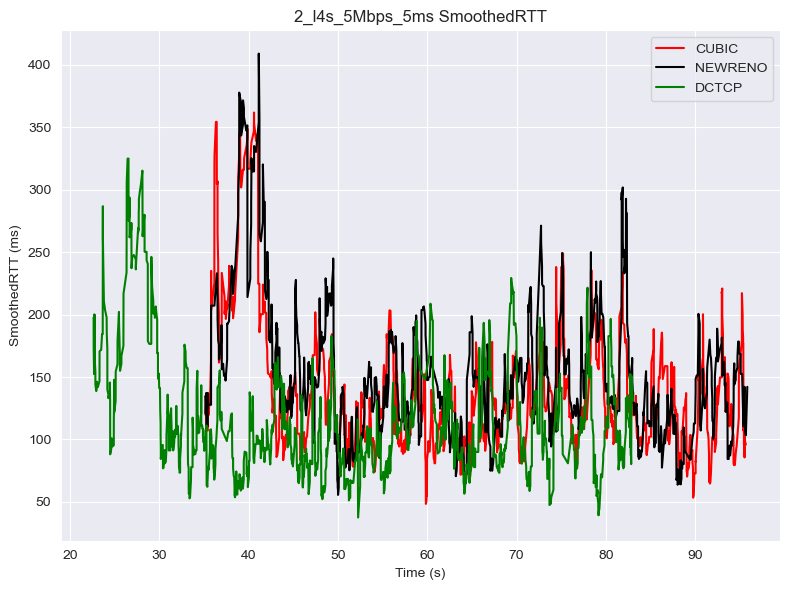

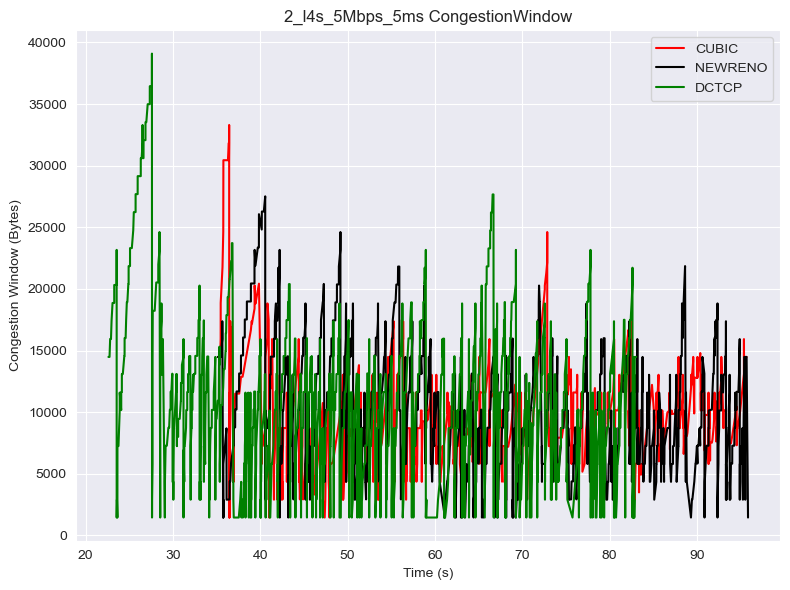


Start New Scenario
2_l4s_5Mbps_7ms
./Data./client1_data\2_l4s_5Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_5Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_5Mbps_7ms:
Statistics for CUBIC:
Median: 139.531
Mean: 146.18300107874865
25th Percentile: 109.062
75th Percentile: 170.859
Minimum: 41.562
Maximum: 348.125
Statistics for NEWRENO:
Median: 137.031
Mean: 144.85473532388662
25th Percentile: 109.687
75th Percentile: 166.875
Minimum: 41.875
Maximum: 349.062
Statistics for DCTCP:
Median: 109.687
Mean: 116.47914453917986
25th Percentile: 88.125
75th Percentile: 135.937
Minimum: 46.25
Maximum: 285.0
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_5Mbps_7ms_rtt_stats.txt



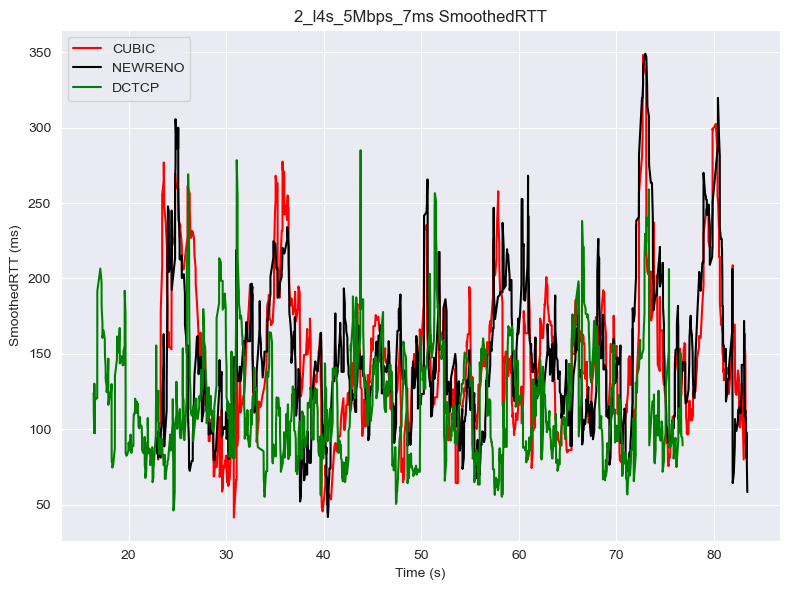

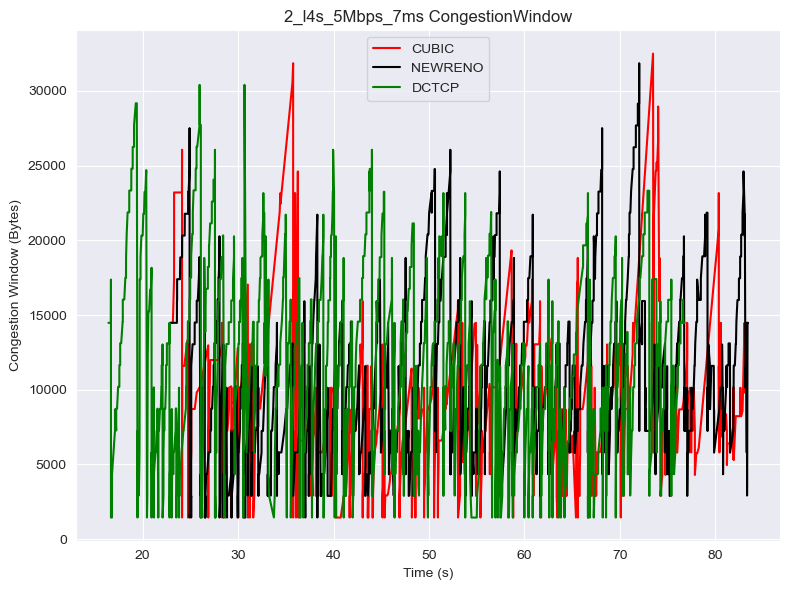


Start New Scenario
2_l4s_8Mbps_0ms
./Data./client1_data\2_l4s_8Mbps_0ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_8Mbps_0ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_8Mbps_0ms:
Statistics for CUBIC:
Median: 89.687
Mean: 98.63939956092209
25th Percentile: 70.625
75th Percentile: 113.75
Minimum: 26.562
Maximum: 422.187
Statistics for NEWRENO:
Median: 93.437
Mean: 102.0803175863438
25th Percentile: 75.625
75th Percentile: 117.812
Minimum: 26.562
Maximum: 423.437
Statistics for DCTCP:
Median: 65.625
Mean: 73.00845693968924
25th Percentile: 50.312
75th Percentile: 85.937
Minimum: 16.875
Maximum: 352.5
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_8Mbps_0ms_rtt_stats.txt



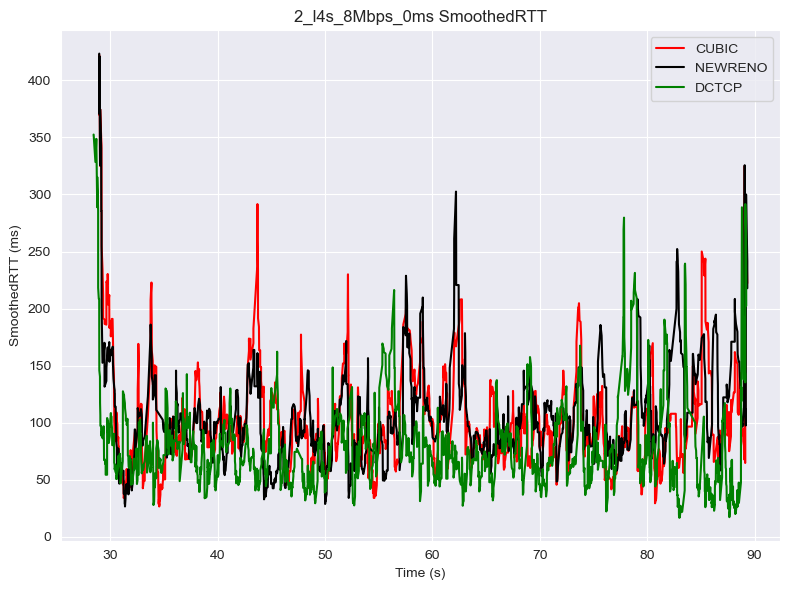

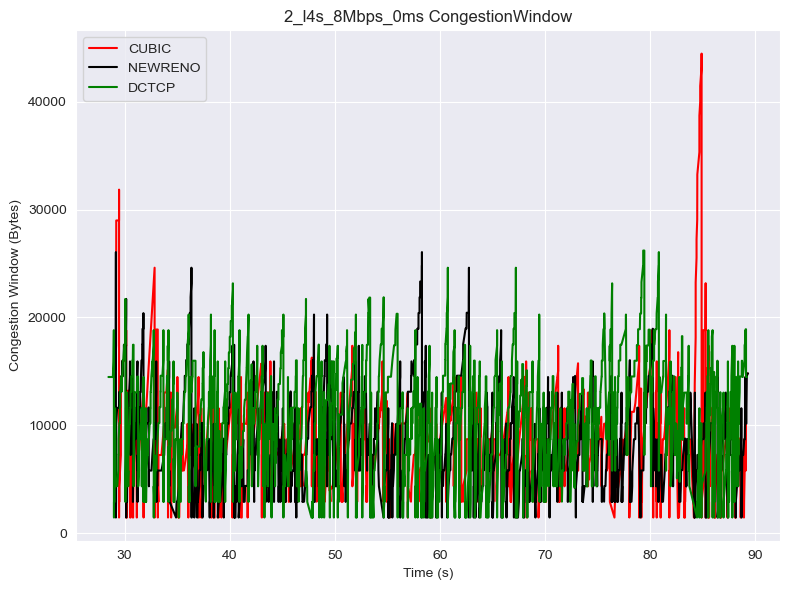


Start New Scenario
2_l4s_8Mbps_10ms
./Data./client1_data\2_l4s_8Mbps_10ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_8Mbps_10ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_8Mbps_10ms:
Statistics for CUBIC:
Median: 769.062
Mean: 750.2503697120512
25th Percentile: 584.062
75th Percentile: 926.25
Minimum: 85.312
Maximum: 1733.437
Statistics for NEWRENO:
Median: 808.125
Mean: 771.6986776119403
25th Percentile: 612.42175
75th Percentile: 928.59325
Minimum: 82.812
Maximum: 1798.125
Statistics for DCTCP:
Median: 663.5935
Mean: 667.6880068051574
25th Percentile: 497.10900000000004
75th Percentile: 809.76525
Minimum: 102.5
Maximum: 1696.25
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_8Mbps_10ms_rtt_stats.txt



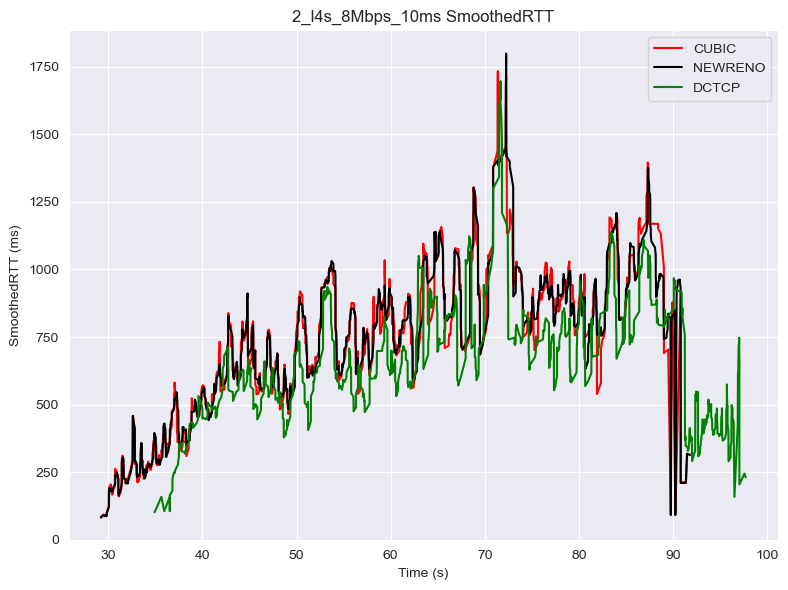

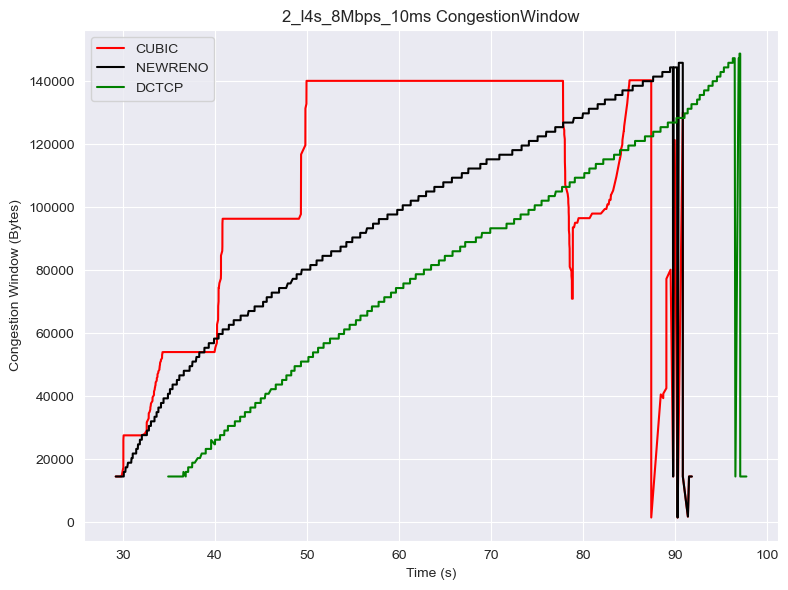


Start New Scenario
2_l4s_8Mbps_1ms
./Data./client1_data\2_l4s_8Mbps_1ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_8Mbps_1ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_8Mbps_1ms:
Statistics for CUBIC:
Median: 78.75
Mean: 85.21170432771721
25th Percentile: 59.375
75th Percentile: 101.562
Minimum: 15.312
Maximum: 400.312
Statistics for NEWRENO:
Median: 85.0
Mean: 93.71380214497042
25th Percentile: 65.0
75th Percentile: 108.437
Minimum: 22.812
Maximum: 445.625
Statistics for DCTCP:
Median: 63.437
Mean: 70.45549756756758
25th Percentile: 50.0
75th Percentile: 83.437
Minimum: 25.312
Maximum: 247.187
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_8Mbps_1ms_rtt_stats.txt



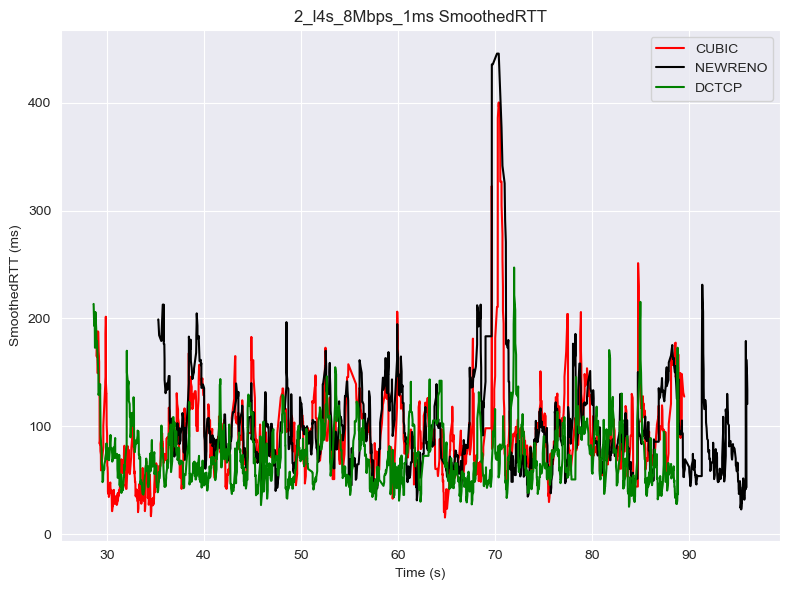

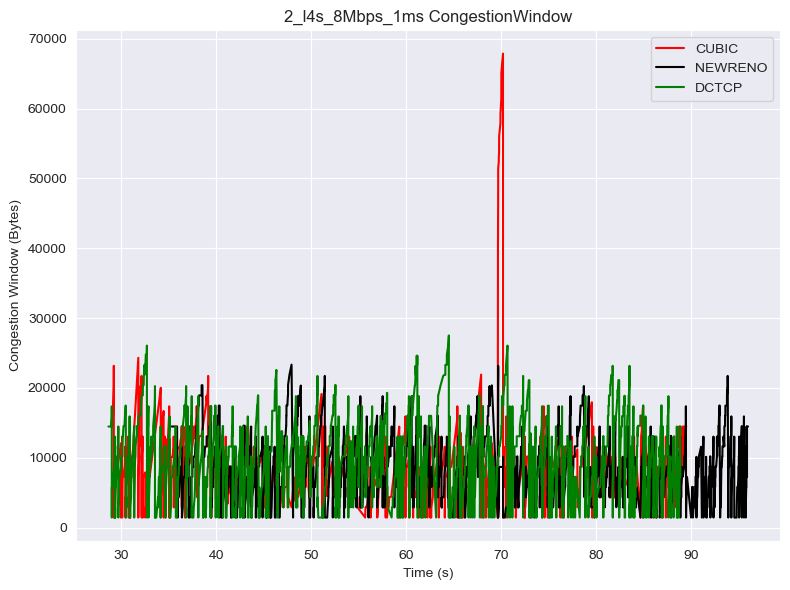


Start New Scenario
2_l4s_8Mbps_20ms
./Data./client1_data\2_l4s_8Mbps_20ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_8Mbps_20ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_8Mbps_20ms:
Statistics for CUBIC:
Median: 1166.875
Mean: 1107.0800280686121
25th Percentile: 921.562
75th Percentile: 1287.187
Minimum: 196.25
Maximum: 1732.5
Statistics for NEWRENO:
Median: 1043.437
Mean: 981.7703203568533
25th Percentile: 736.562
75th Percentile: 1245.312
Minimum: 219.375
Maximum: 1610.937
Statistics for DCTCP:
Median: 898.437
Mean: 870.4406030571992
25th Percentile: 755.234
75th Percentile: 1036.562
Minimum: 204.062
Maximum: 1433.125
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_8Mbps_20ms_rtt_stats.txt



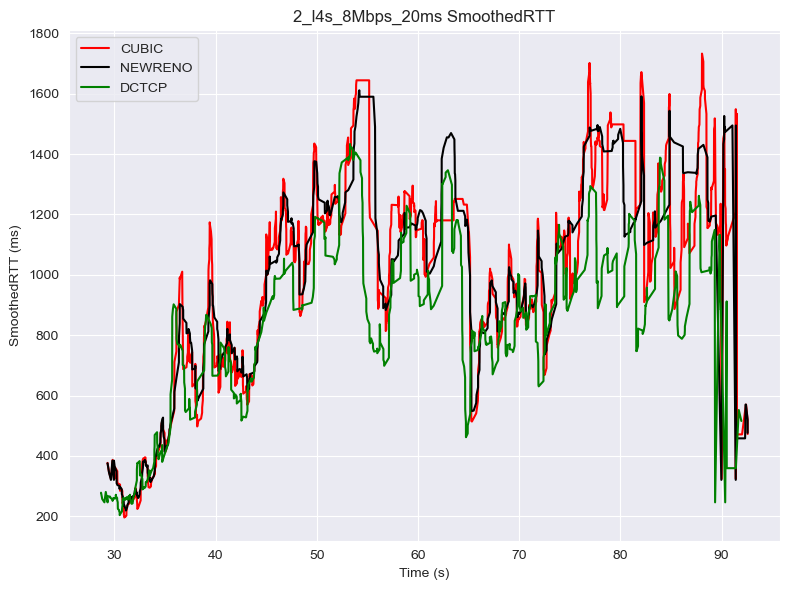

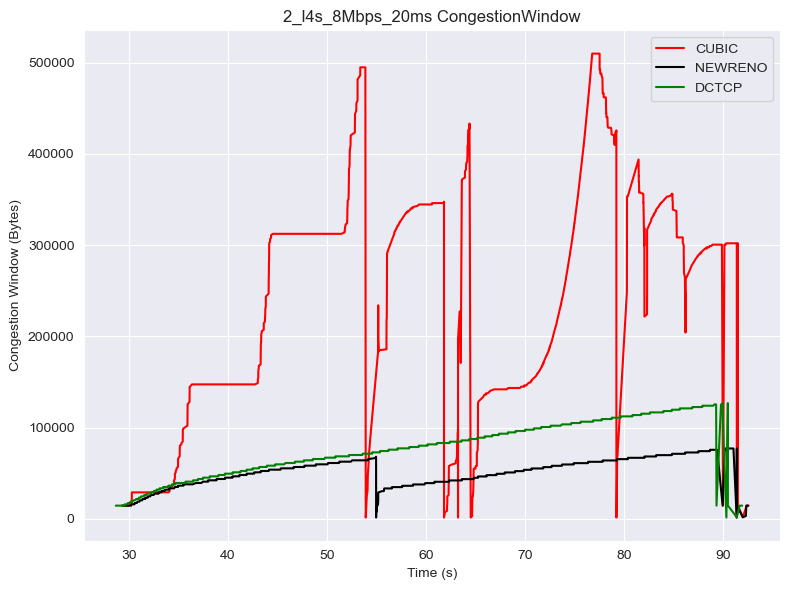


Start New Scenario
2_l4s_8Mbps_5ms
./Data./client1_data\2_l4s_8Mbps_5ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_8Mbps_5ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_8Mbps_5ms:
Statistics for CUBIC:
Median: 87.3435
Mean: 92.70095305514158
25th Percentile: 68.125
75th Percentile: 110.0
Minimum: 30.0
Maximum: 241.875
Statistics for NEWRENO:
Median: 77.812
Mean: 86.89214068716095
25th Percentile: 56.875
75th Percentile: 103.437
Minimum: 24.375
Maximum: 346.562
Statistics for DCTCP:
Median: 65.0
Mean: 74.8601804137931
25th Percentile: 50.937
75th Percentile: 85.625
Minimum: 24.062
Maximum: 373.437
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_8Mbps_5ms_rtt_stats.txt



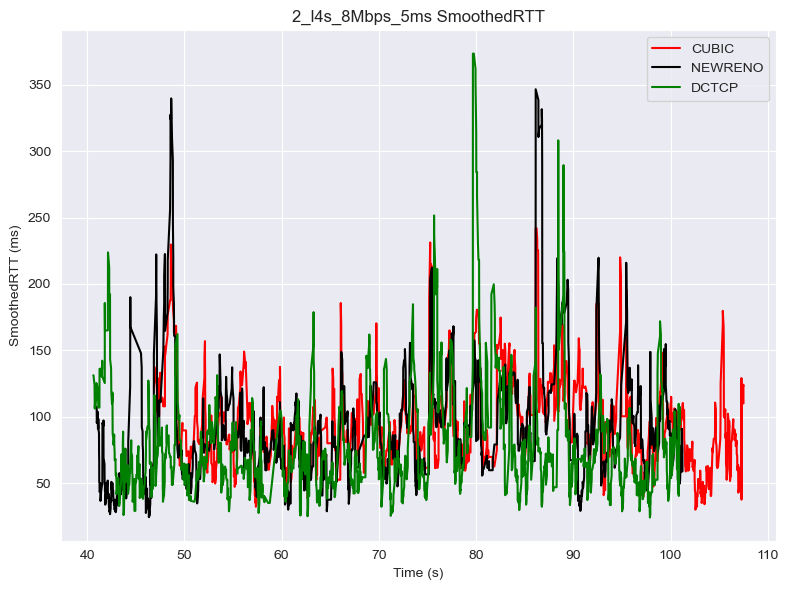

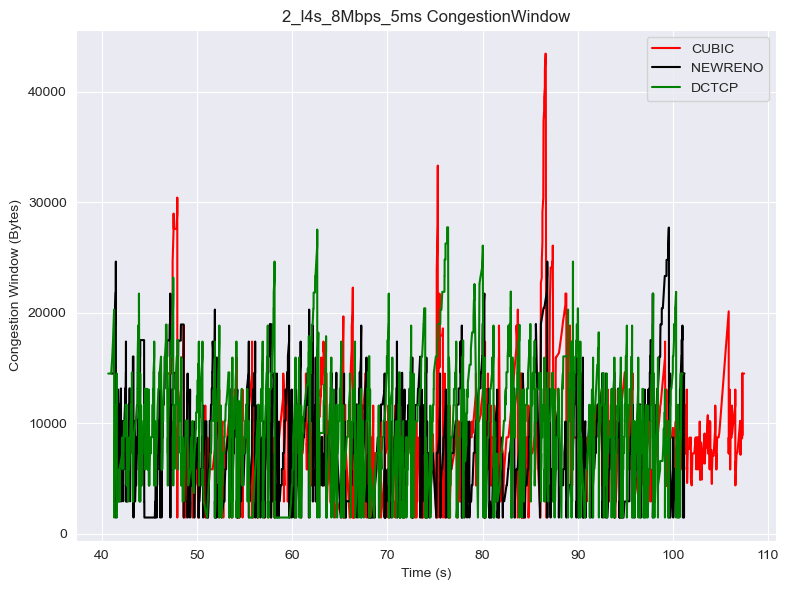


Start New Scenario
2_l4s_8Mbps_7ms
./Data./client1_data\2_l4s_8Mbps_7ms_ecn_newreno_src1.siftr.log
./Data./client2_data\2_l4s_8Mbps_7ms_ecn_dctcp_src2.siftr.log

RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*RTT *-*-*
RTT statistics in millisecond (ms) for scenario 2_l4s_8Mbps_7ms:
Statistics for CUBIC:
Median: 78.75
Mean: 84.2310737125547
25th Percentile: 60.0
75th Percentile: 102.187
Minimum: 20.625
Maximum: 221.562
Statistics for NEWRENO:
Median: 79.062
Mean: 80.85827266881029
25th Percentile: 57.187
75th Percentile: 100.0
Minimum: 18.437
Maximum: 206.562
Statistics for DCTCP:
Median: 62.187
Mean: 67.22277772060716
25th Percentile: 49.687
75th Percentile: 80.312
Minimum: 26.562
Maximum: 262.5
END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*END RTT *-*-*


Saving RTT statistics in millisecond (ms) to ./Data\Stats/scn_2_l4s_8Mbps_7ms_rtt_stats.txt



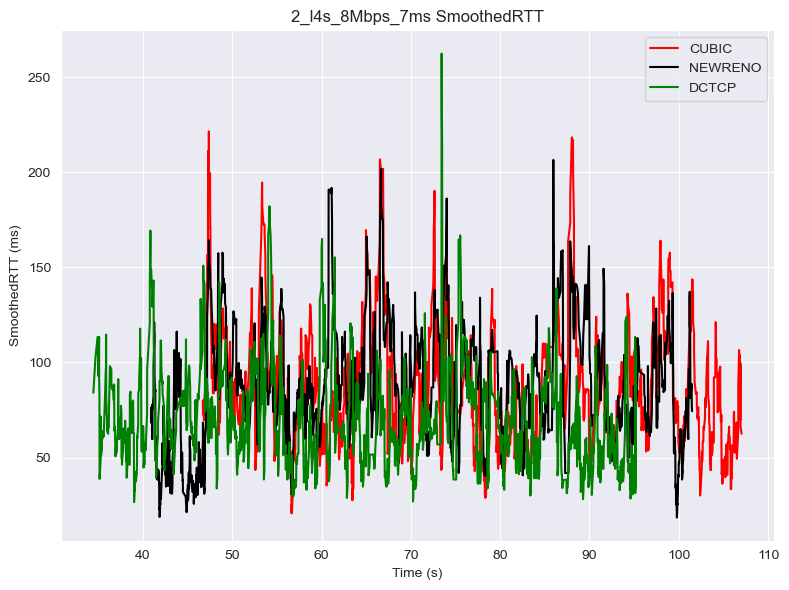

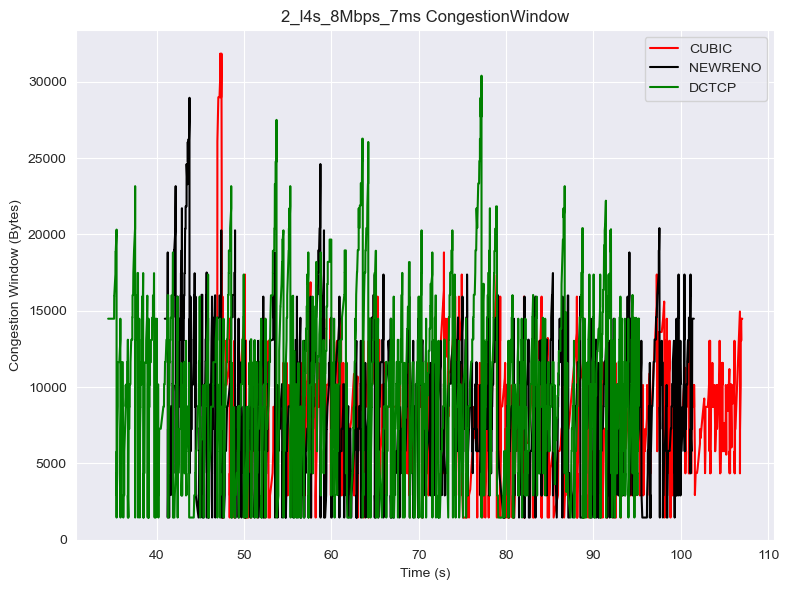

In [11]:
for scenario in unique_scenarios_dict.keys():

    tcp1 = "CUBIC"
    tcp2 = "NEWRENO"
    tcp3 = "DCTCP"
    print()
    print("Start New Scenario")
    print(scenario)

    classif_traffic = unique_scenarios_dict[scenario][0]
    l4s_traffic = unique_scenarios_dict[scenario][1]

    ctf = get_dataframe_from_filepath(classif_traffic)
    ltf = get_dataframe_from_filepath(l4s_traffic)

    ctf1 = ctf[ctf['ForeignPort'] == "5101"]
    ctf2 = ctf[ctf['ForeignPort'] == "5102"]
    ltf =  ltf[ltf['ForeignPort'] == "5103"]

    # Define paths
    paths = {
        tcp1: ctf1,
        tcp2: ctf2,
        tcp3: ltf,
    }

    print_rtt_stats(paths=paths,scenario=scenario)
    save_rtt_stats(paths=paths,scenario=scenario,stats_directory=stats_directory)



    plot_siftr_graph(paths=paths,
                    ycolumn="SmoothedRTT",
                    title=f"{scenario} SmoothedRTT",
                    xlabel="Time (s)",
                    ylabel="SmoothedRTT (ms)",
                    filename=f'{scenario}_SmoothedRTT',
                    graph_directory=graph_directory,
    )




    plot_siftr_graph(paths=paths,
                    ycolumn="CongestionWindow",
                    title=f"{scenario} CongestionWindow",
                    xlabel="Time (s)",
                    ylabel="Congestion Window (Bytes)",
                    filename=f'{scenario}_CWND',
                    graph_directory=graph_directory,
    )
